In [1]:
import numpy as np
import matplotlib.pyplot as plt
import math
import pandas as pd
#import uproot
import uproot3
from scipy import optimize as op

*Bin Conversions*
Available Functions:
Note: All functions return new arrays rather than altering the previous array
	New_Merged_Size(array_,merge_size_) returns what the size of the new merged array will be
	Merge_Bin_Edges(edges_,merge_size) merges the bin edges 
	Merge_Bins(array_,merge_size_) adds together every <merge_size_> values in an array
	Merge_Vals(yarray_,merge_size_) adds together every <merge_size_> ybin together in an array
	Merge_Bins(xarray_,merge_size_) averages every <merge_size_> xbins together in an array
	Count_Non_Zero(array_) counts the number of nonzero values in an array
	Count_Zero(array_) counts the number of zeros in an array
	Remove_Zeros(array_) remove zeros from an array
	Remove_Zeros_Y(yarray_) removes zero values from yarray
	Remove_Zeros_X(xarray_,yarray_) removes xbins where the corresponding y value was zero
	Count_InBounds(yarray_,low_,high_) counts the number of values that fall between bounds (or equal to)
	Count_OutBounds(yarray_,low_,high_) co

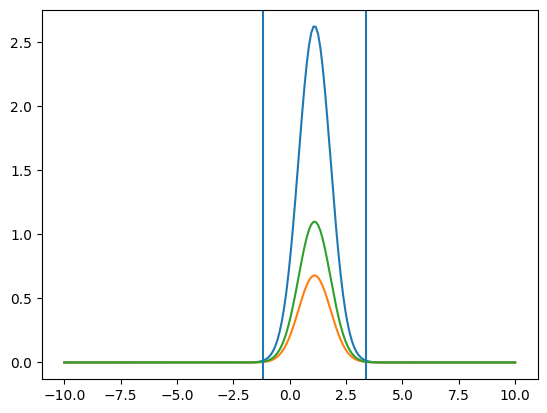

*Extracting Pieces for TH2*
Available Functions:
	Num_Xbins(TH2_) returns number of X bins for a TH2
	Num_Ybins(TH2_) returns number of Y bins for a TH2
	XEdges_2d(TH2_) returns edges of x bins for a TH2
	YEdges_2d(TH2_) returns edges of y bins for a TH2
	Center_Xbins(TH2_) returns center values for x bins for a TH2
	Center_Ybins(TH2_) returns center value for y bins for a TH2
	XY_Values(TH2_) returns a 2D np.array for z values arranged [x][y] for a TH2
	YX_Values(TH2_) returns a 2D np.array for z values arranged [y][x] for a TH2
Enjoy using TH2s



In [2]:
#Gain access to functions used to change some of the aspects regarding arrays and the things in them
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/Bin\ Conversions.ipynb

#Gain Access to functions used to work with momentum binning
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/Momentum\ Bins.ipynb

#Gain Access to functions used to work with Fitting Functions
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/Fitting\ Functions.ipynb

#Gain Access to functions used for TH2s 
#uproot or uproo4
#%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/TH2\ Functions.ipynb
#uproot3
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/TH2\ Functions-uproot3.ipynb

In [30]:
Particle = ['Electron','Proton',"$\u03C0^+$","$\u03C0^-$"]
Momentum = ['$p_{e}$','$p_{P}$','$p_{\u03C0^+}$','$p_{\u03C0^-}$']
Theta = ['$\u03B8_{e}$',"$\u03B8_{P}$", "$\u03B8_{\u03C0^+}$", "$\u03B8_{\u03C0^-}$"]

In [3]:
sim="exp"
run="e16"
cut_perf="delta"
species = "pim"

date = "08-04-2024"
dir="/Users/cmc/analysis_phd/root_files/cut_determination/cut_det_"+run+"/"+date
#dir="/Users/cmc/analysis_phd/root_files/cut_determination/cut_det_e16/06-13-2022"

root_file=dir+"/"+sim+"_"+run+"_clas6_"+cut_perf+"_"+species+"_"+date+".root"
file=uproot3.open(root_file)
#selection 0-> pid in experimental W range, 1->event selection in full W range
selection = 1
# 0 => full range 1=> Experimental W range
W_range = 0

rel_top=['mnone','mall']

W_bits=['all','in_range']

In [4]:
#The Various layers of TDirectories to get to the histograms
layer1='Delta'
layer2=cut_perf+"_"+species
layer3=[layer2+"_pid",layer2+"_event"]
layer4=[[layer3[sel]+"_sec"+str(sec+1) for sel in range(2)] for sec in range(6)]
layer5=[[layer4[sec][sel]+"_cut" for sel in range(2)] for sec in range(6)]
layer6=[[layer5[sec][0]+"_mnone",layer5[sec][1]+"_mall"] for sec in range(6)]
layer7=[[layer6[sec][sel]+"_in_range" for sel in range(2)] for sec in range(6)]
layer8=[[layer3[sel]+"_cut_"+rel_top[sel]+"_sec"+str(sec+1)+"_"+W_bits[W_range] for sel in range(2)] for sec in range(6)]
dir_loc0= [layer1+"/"+layer2+"/"+layer3[selection]+"/"+layer4[sec][selection]+"/"+layer5[sec][selection]+"/"+layer6[sec][selection]+"/"+layer7[sec][selection] for sec in range(6)]
dir_loc = [layer1+"/"+layer2+"/"+layer3[selection]+"/"+layer4[sec][selection]+"/"+layer5[sec][selection]+"/"+layer6[sec][selection]+"/"+layer7[sec][selection]+"/"+layer8[sec][selection] for sec in range(6)]

hist = [file[dir_loc[sec]] for sec in range(6)]

print(layer8[0][selection])

delta_pim_event_cut_mall_sec1_all


In [5]:
print(layer8[0])
file[dir_loc0[0]].keys()


['delta_pim_pid_cut_mnone_sec1_all', 'delta_pim_event_cut_mall_sec1_all']


[b'delta_pim_event_cut_mall_sec1_in_range;1',
 b'delta_pim_event_cut_mall_sec1_all;1']

In [6]:
cut_cols = ['b','g','r']
cut_name= ["tight","mid","loose"]
data_cols = ['m',"c",'y']

In [7]:
#Extracting X and Y bins
#X and Y binning is the same for all sectors
xbins=Center_Xbins(hist[0])
ybins=Center_Ybins(hist[0])

In [8]:
#Extracting Zvals for 2d histograms
zvals_xy=[XY_Values(hist[sec]) for sec in range(6)]
zvals_yx=[YX_Values(hist[sec]) for sec in range(6)]

In [9]:
#Determining Cell Merging 
xmerge=3
ymerge=3
xname="p(GeV)"
yname="\u0394t"
#Merge -> No Zeros
x = Merge_Bins(xbins,xmerge)
y = Merge_Bins(ybins,ymerge)
xedges = Merge_Bin_Edges(XEdges_2d(hist[0]),xmerge)
yedges = Merge_Bin_Edges(YEdges_2d(hist[0]),ymerge)
z_xy=[Merge_Z(zvals_xy[i],xmerge,ymerge) for i in range(6)]
z_yx=[Merge_Z(zvals_yx[i],ymerge,xmerge) for i in range(6)]
fit_x = [[Remove_Zeros_X(y,z_xy[sec][xbin]) for xbin in range(len(x))] for sec in range(6)]
fit_y = [[Remove_Zeros_Y(z_xy[sec][xbin]) for xbin in range(len(x))] for sec in range(6)]



In [10]:
#dumb_x= np.zeros((6,len(x)*len(y)))
#dumb_y= np.zeros((6,len(x)*len(y)))
#dense2 = np.zeros((6,len(x)*len(y)))
dumb_x= np.zeros((6,len(xbins)*len(ybins)))
dumb_y= np.zeros((6,len(xbins)*len(ybins)))
dense2 = np.zeros((6,len(xbins)*len(ybins)))
for sec in range(6):
    #for i in range(len(x)):
    for i in range(len(xbins)):
        #for j in range(len(y)):
        for j in range(len(ybins)):
            #dumb_x[sec][i+j*len(x)]+=x[i]
            #dumb_y[sec][i+j*len(x)]+=y[j]
            #dense2[sec][i+j*len(x)]+=zvals_xy[sec][i][j]
            dumb_x[sec][i+j*len(xbins)]+=xbins[i]
            dumb_y[sec][i+j*len(xbins)]+=ybins[j]
            dense2[sec][i+j*len(xbins)]+=zvals_xy[sec][i][j]


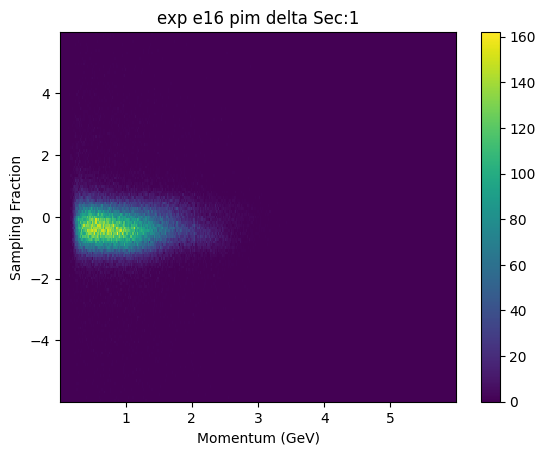

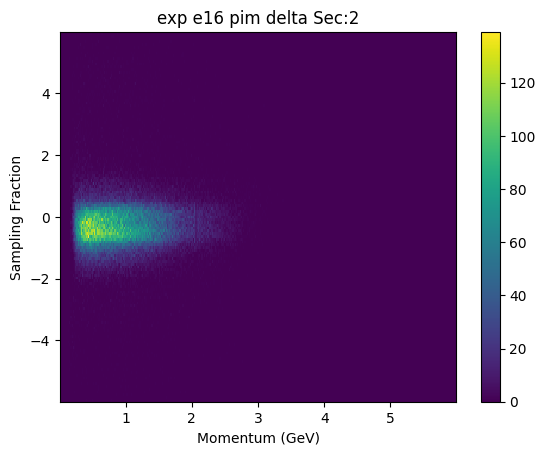

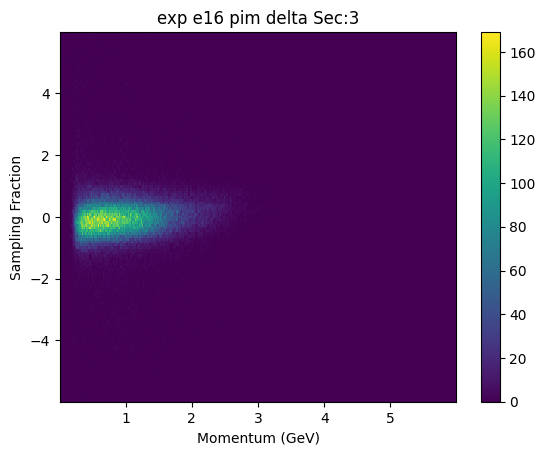

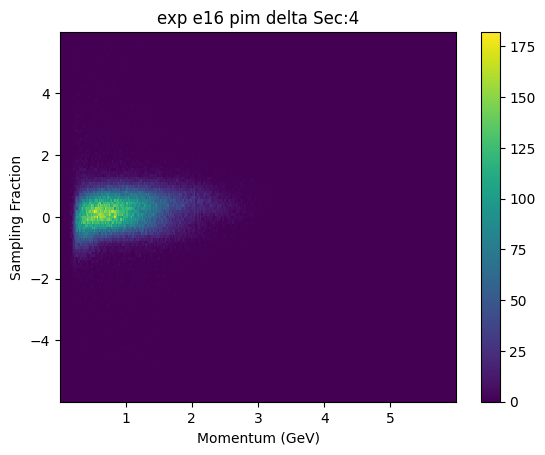

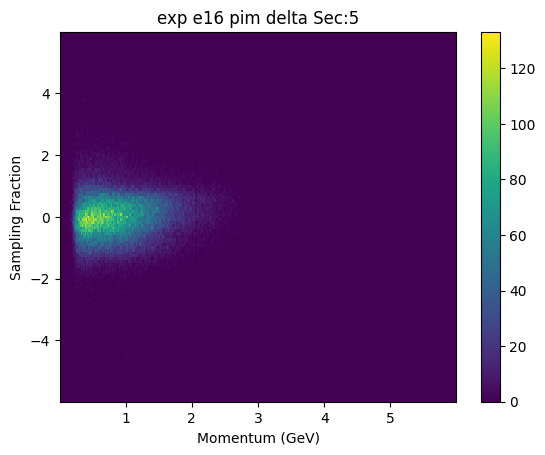

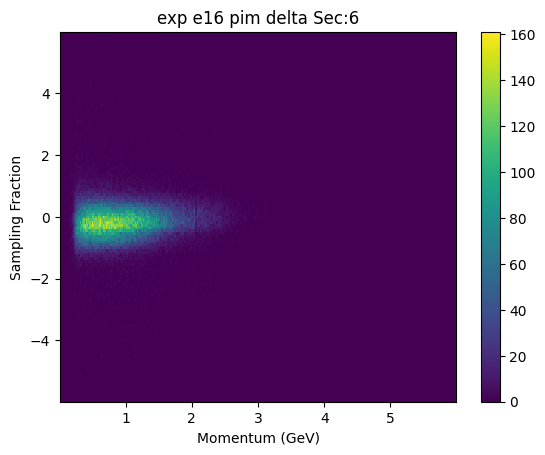

In [13]:
for sec in range(6):
    plt.hist2d(dumb_x[sec], dumb_y[sec], bins=(len(x), len(y)), weights=dense2[sec])
    plt.title("{} {} {} {} Sec:{}".format(sim,run,species,cut_perf,sec+1))
    plt.xlabel("Momentum (GeV)")
    plt.ylabel("Sampling Fraction")
    plt.colorbar()
    plt.show()
    
    
    

In [14]:
def Pbin_low(xbin_):
    return round(xedges[xbin_],3)
def Pbin_top(xbin_):
    return round(xedges[xbin_+1],3)

In [15]:
print(np.argmax(z_xy[0][10]))
print(np.max(z_xy[0][10]))
print(z_xy[0][10][np.argmax(z_xy[0][10])])

63
12.0
12.0


In [16]:
# _me_ = 0.511
# _sig_e_ = 0.02

# width=[3,2]


# def Z_XY_ele_sub(xvals_,yvals_,z_xy_):
#     output=np.zeros((len(xvals_),len(yvals_)))
#     for x in range(len(xvals_)):
#         for y in range(len(yvals_)):
#             if y <= np.argmax(z_xy_[x])-width[0] or y > np.argmax(z_xy_[x])+width[1]:
#                 output[x][y] = z_xy_[x][y]
#     return output

# def Z_YX_ele_sub(xvals_,yvals_,z_yx_):
#     output=np.zeros((len(yvals_),len(xvals_)))
#     for x in range(len(xvals_)):
#         for y in range(len(yvals_)):
#             if x <= np.argmax(z_yx_[y])-width[0] or x > np.argmax(z_yx_[y])+width[1]:
#                 output[y][x] = z_yx_[y][x]  
#     return output

In [17]:
# n_zvals_xy = [Z_XY_ele_sub(x,y,z_xy[sec]) for sec in range(6)] 
# n_zvals_yx = [Z_YX_ele_sub(x,y,z_yx[sec]) for sec in range(6)] 
# nfit_x2 = [[Remove_Zeros_X(y,n_zvals_xy[sec][xbin]) for xbin in range(len(x))] for sec in range(6)]
# nfit_y2 = [[Remove_Zeros_Y(n_zvals_xy[sec][xbin]) for xbin in range(len(x))] for sec in range(6)]


In [18]:
# dumb_x2= np.zeros((6,len(x)*len(y)))
# dumb_y2= np.zeros((6,len(x)*len(y)))
# dense22 = np.zeros((6,len(x)*len(y)))
# for sec in range(6):
#     for i in range(len(x)):
#     #for i in range(len(xbins)):
#         for j in range(len(y)):
#         #for j in range(len(ybins)):
#             dumb_x2[sec][i+j*len(x)]+=x[i]
#             dumb_y2[sec][i+j*len(x)]+=y[j]
#             dense22[sec][i+j*len(x)]+=n_zvals_xy[sec][i][j]
            

In [19]:
# for sec in range(6):
#     plt.hist2d(dumb_x2[sec], dumb_y2[sec], bins=(len(x), len(y)), weights=dense22[sec])
#     plt.title("{} {} {} {} With Cut Ele Subtracted Sec:{}".format(sim,run,species,cut_perf,sec+1))
#     plt.xlabel("Momentum (GeV)")
#     plt.ylabel("Delta T")
#     plt.show()
    

-1.6357606251710481 1.059215012866915
-1.9052581889748443 1.3287125766707113
-2.1747557527786405 1.5982101404745075


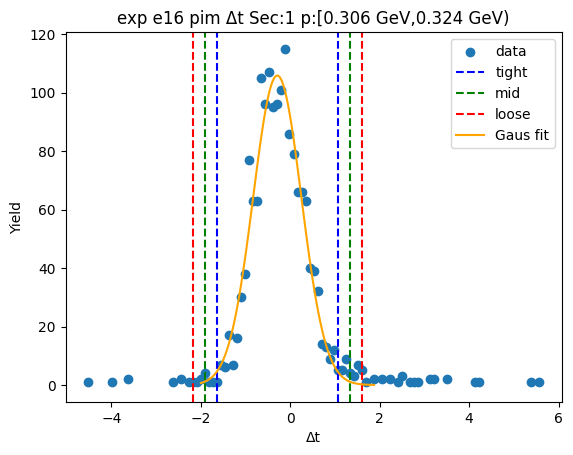

-1.626478169921379 1.0154295765506614
-1.890668944568583 1.2796203511978652
-2.154859719215787 1.5438111258450693


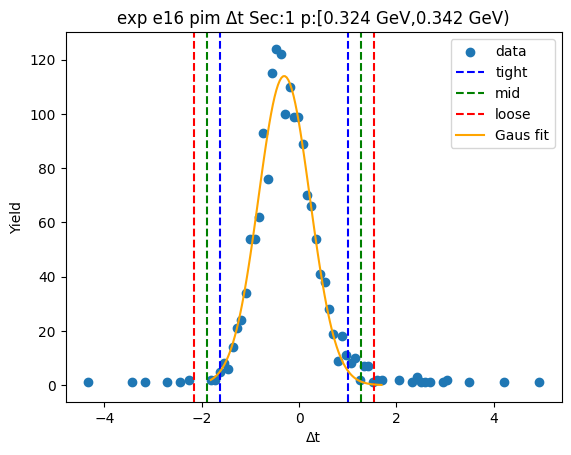

-1.658448284684879 1.058456428481249
-1.9301387560014915 1.3301468997978616
-2.2018292273181044 1.6018373711144744


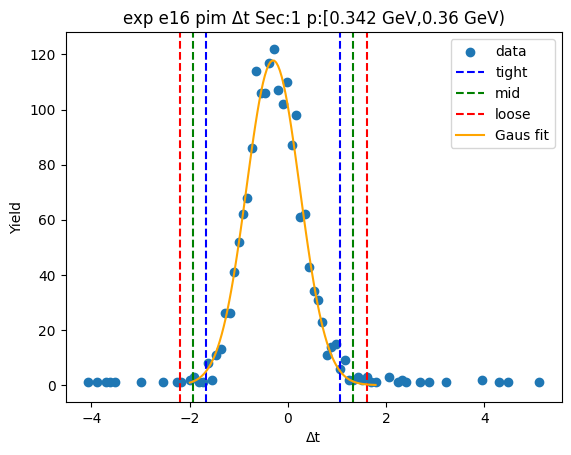

-1.5669758314123616 1.0073611730489473
-1.8244095318584925 1.2647948734950782
-2.0818432323046236 1.5222285739412091


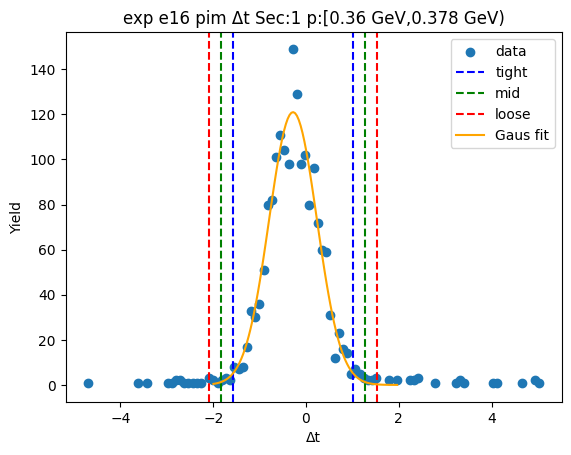

-1.6482380252332 1.0122720417775684
-1.914289031934277 1.2783230484786452
-2.1803400386353537 1.544374055179722


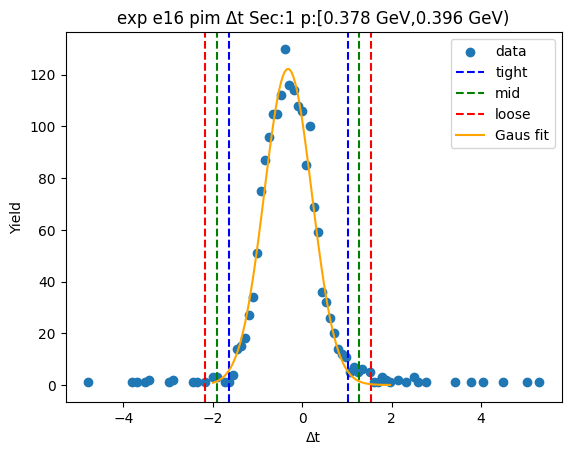

-1.6221323939639392 0.9928695471467501
-1.8836325880750082 1.2543697412578192
-2.145132782186077 1.5158699353688883


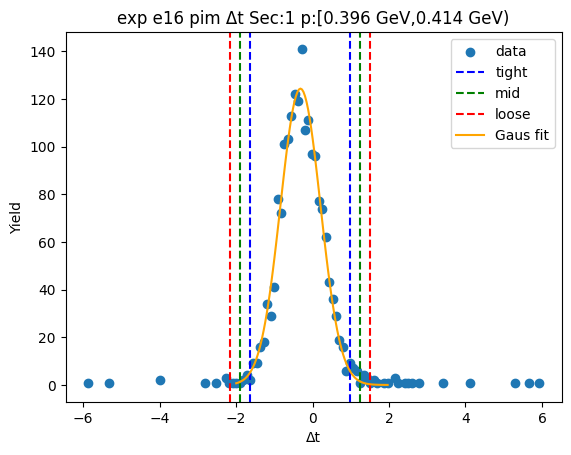

-1.590225486466431 0.9525009455458502
-1.844498129667659 1.2067735887470783
-2.098770772868887 1.4610462319483064


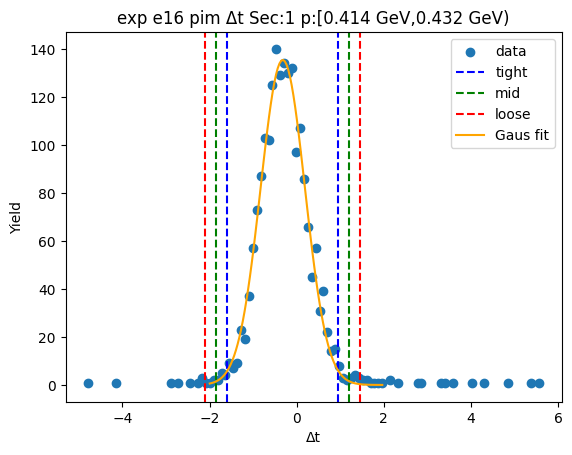

-1.6203127113510813 0.9714826627284698
-1.8794922487590366 1.2306622001364251
-2.1386717861669915 1.4898417375443802


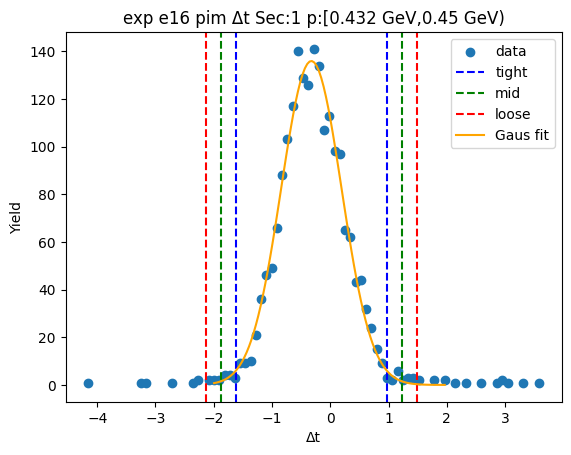

-1.6170391011686394 1.0102143649816848
-1.8797644477836717 1.2729397115967176
-2.1424897943987045 1.53566505821175


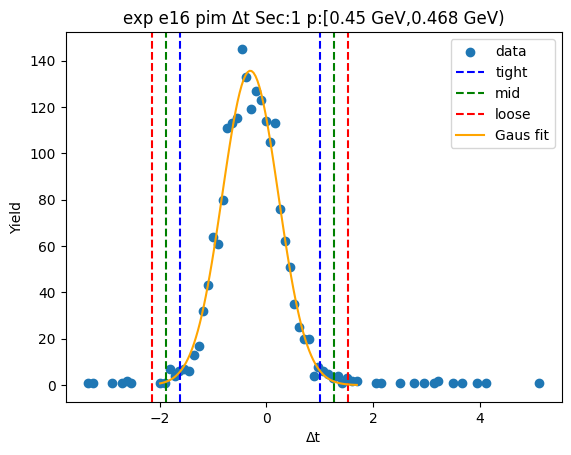

-1.6242594885203885 0.9888547915905302
-1.8855709165314805 1.2501662196016219
-2.146882344542572 1.5114776476127139


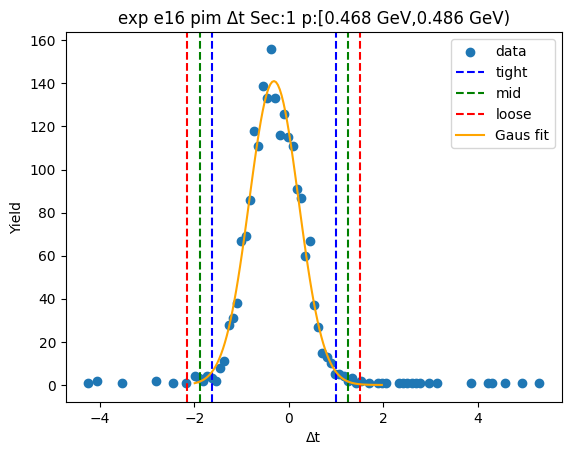

-1.5377909139961754 0.9387545110598454
-1.7854454565017777 1.1864090535654477
-2.0330999990073795 1.4340635960710497


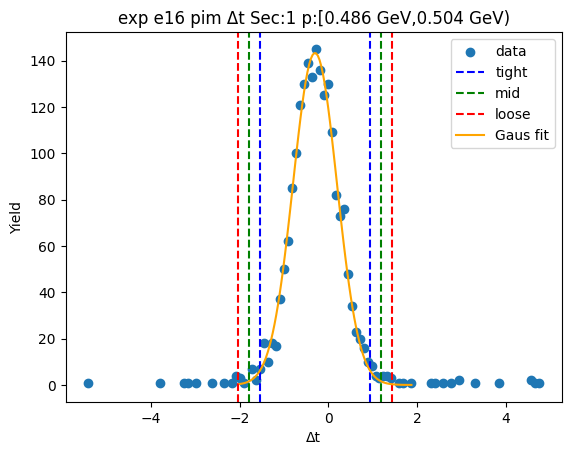

-1.6079250673628582 0.9418836859251871
-1.8629059426916628 1.1968645612539917
-2.1178868180204673 1.4518454365827962


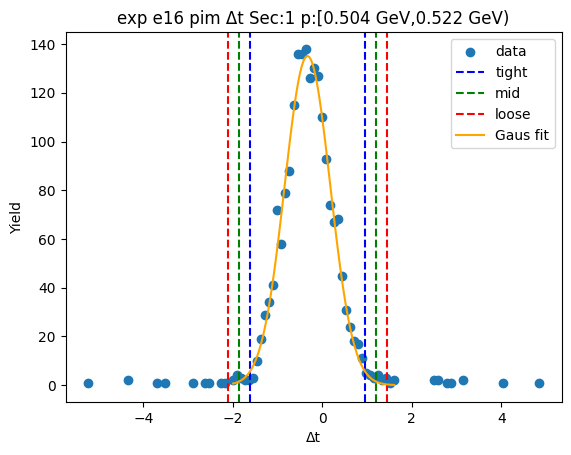

-1.5851243061301368 0.932083278903824
-1.836845064633533 1.1838040374072203
-2.088565823136929 1.4355247959106163


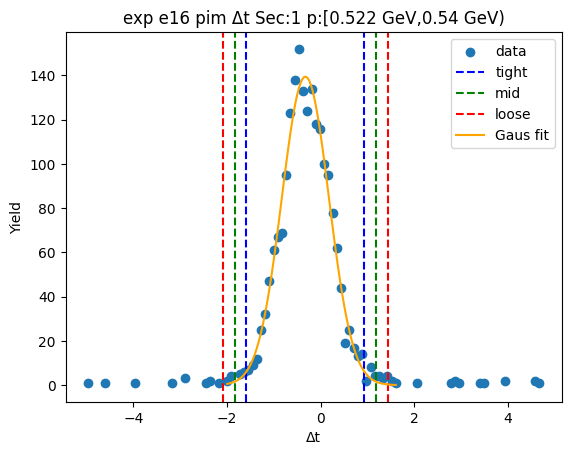

-1.5791642662913534 0.89997477174802
-1.827078170095291 1.1478886755519575
-2.0749920738992285 1.3958025793558948


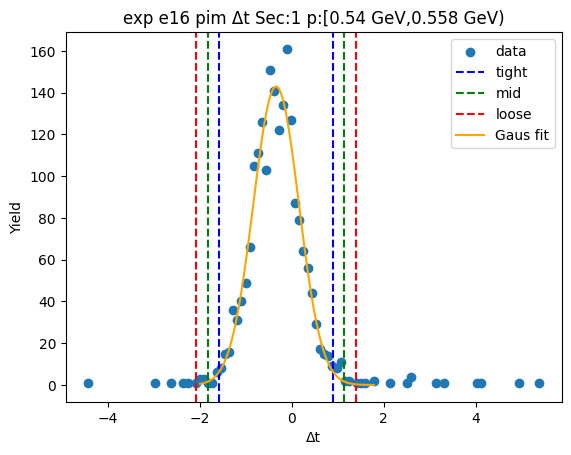

-1.6140108824446533 0.948525691909652
-1.8702645398800835 1.2047793493450825
-2.126518197315514 1.4610330067805126


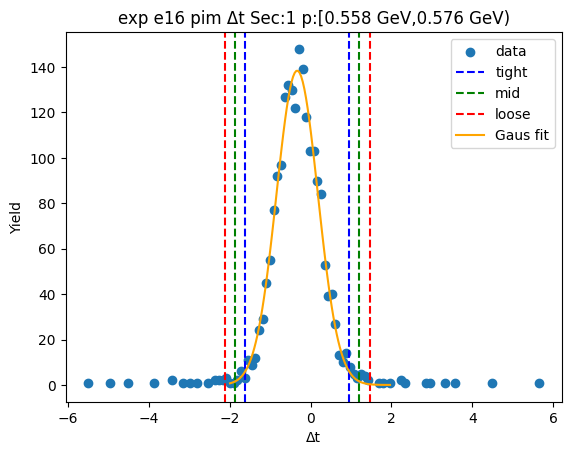

-1.5918153685650993 0.9453746655791369
-1.8455343719795227 1.1990936689935603
-2.099253375393946 1.452812672407984


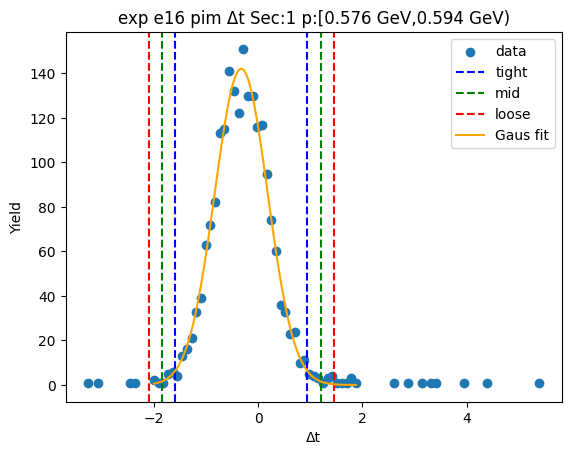

-1.62553056775761 0.9605746150412655
-1.8841410860374976 1.2191851333211532
-2.142751604317385 1.4777956516010409


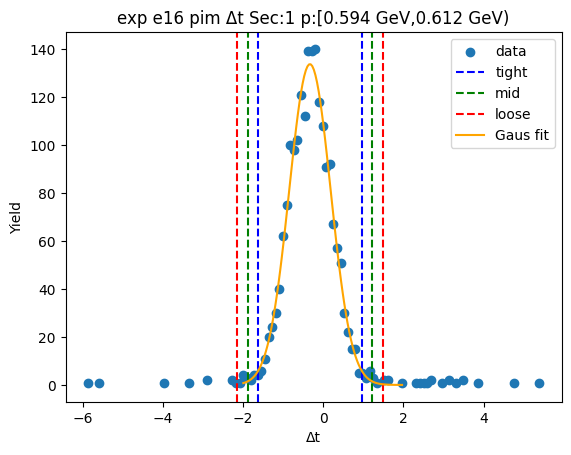

-1.589433609109273 0.9153218455519269
-1.8399091545753925 1.1657973910180468
-2.0903847000415126 1.4162729364841664


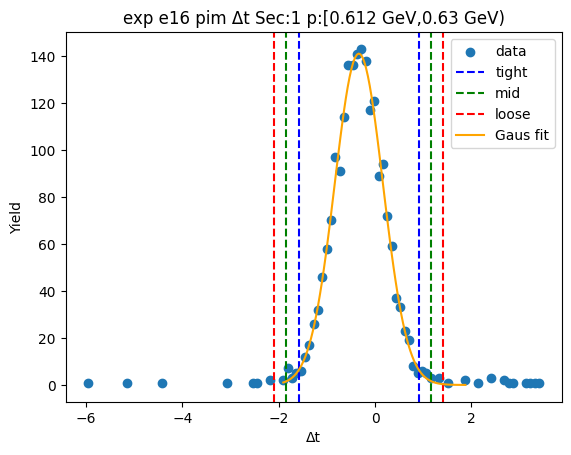

-1.6409114366184934 0.9739519812878594
-1.9023977784091288 1.2354383230784949
-2.1638841201997643 1.4969246648691301


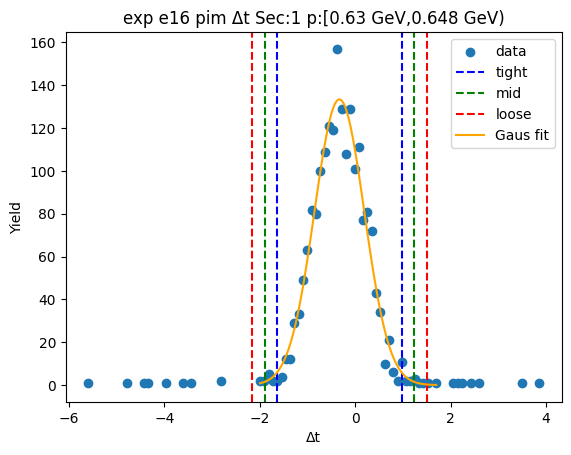

-1.5435251614715475 0.8407566606131325
-1.7819533436800157 1.0791848428216007
-2.020381525888484 1.3176130250300686


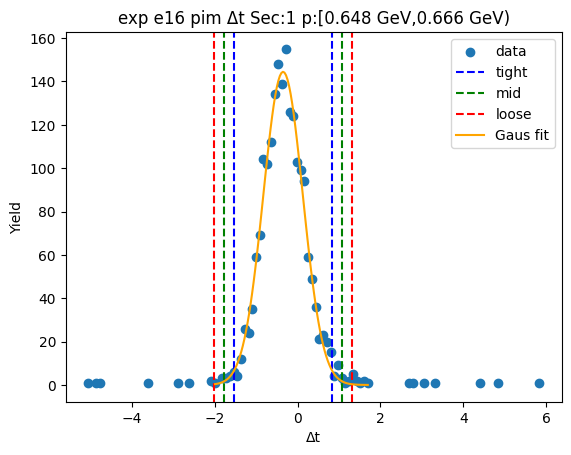

-1.5727422297546227 0.9037381454166193
-1.820390267271747 1.1513861829337435
-2.068038304788871 1.3990342204508677


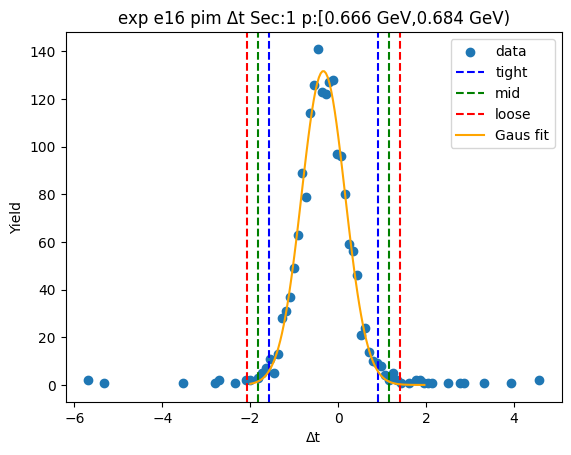

-1.6009616408561933 0.902847052109501
-1.851342510152763 1.1532279214060703
-2.101723379449332 1.40360879070264


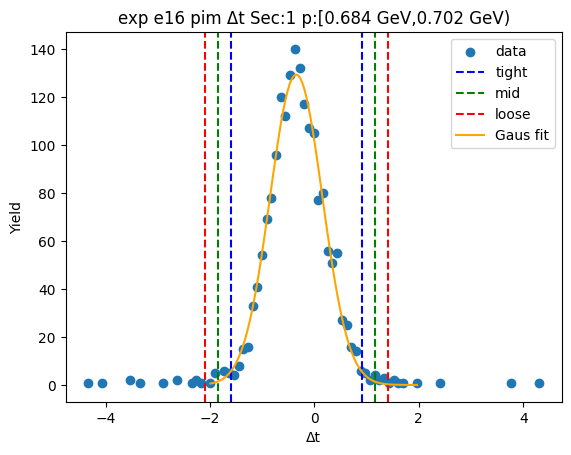

-1.59563504041999 0.8728059089718683
-1.8424791353591758 1.1196500039110542
-2.0893232302983615 1.3664940988502399


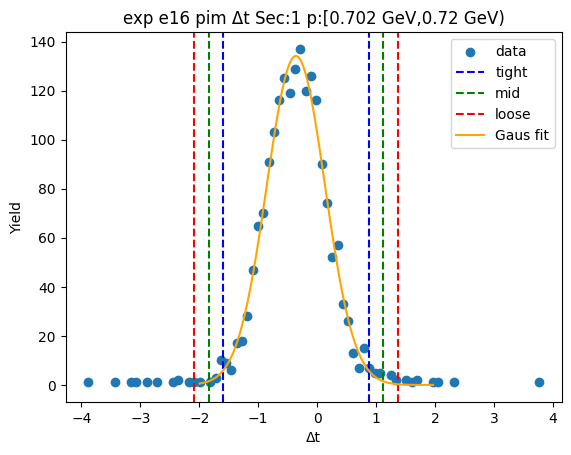

-1.6287541159053027 0.884228029624256
-1.8800523304582586 1.1355262441772118
-2.1313505450112142 1.3868244587301677


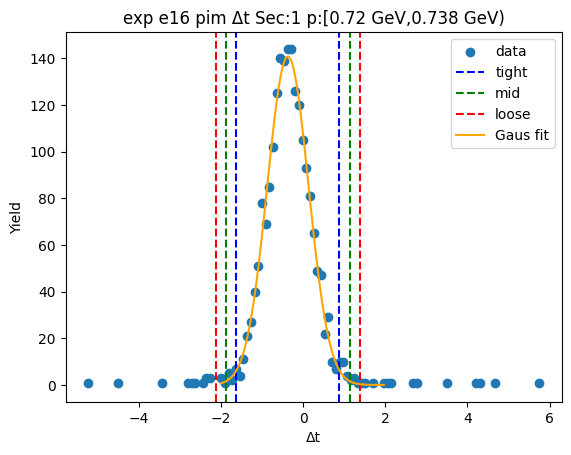

-1.5964322205368948 0.8460795745586525
-1.8406834000464494 1.090330754068207
-2.084934579556004 1.3345819335777618


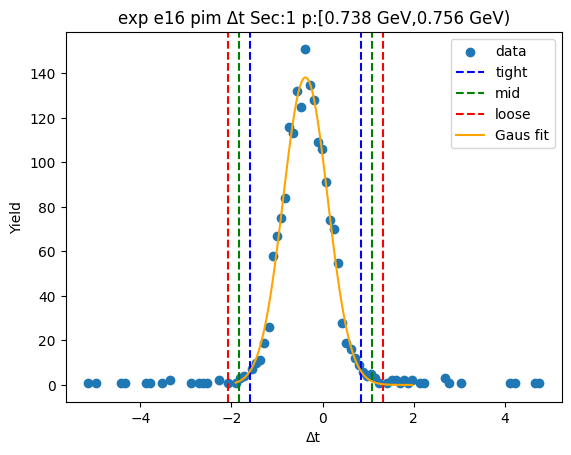

-1.6284792885640287 0.9114783013588479
-1.8824750475563163 1.1654740603511355
-2.136470806548604 1.4194698193434232


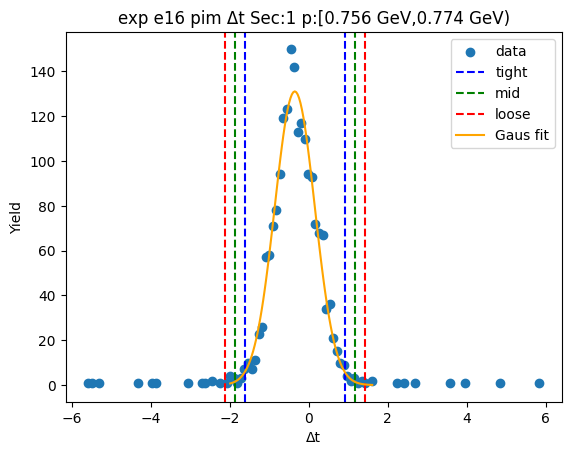

-1.6080679358988075 0.8269482801433252
-1.8515695575030207 1.0704499017475384
-2.0950711791072343 1.3139515233517518


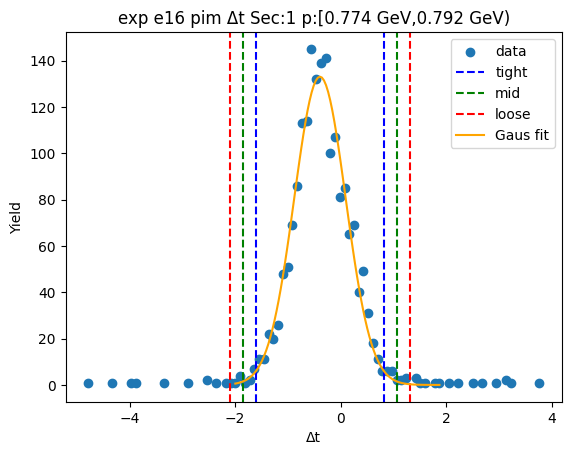

-1.5982842429490445 0.8984845193108972
-1.8479611191750385 1.1481613955368912
-2.0976379954010325 1.3978382717628854


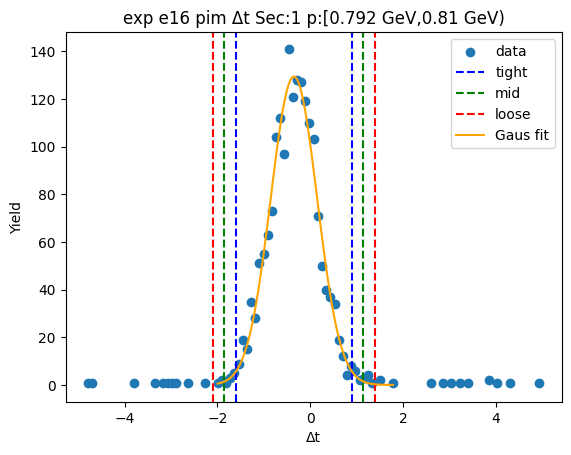

-1.61668519369771 0.8470289007158136
-1.8630566031390623 1.0934003101571659
-2.109428012580415 1.3397717195985184


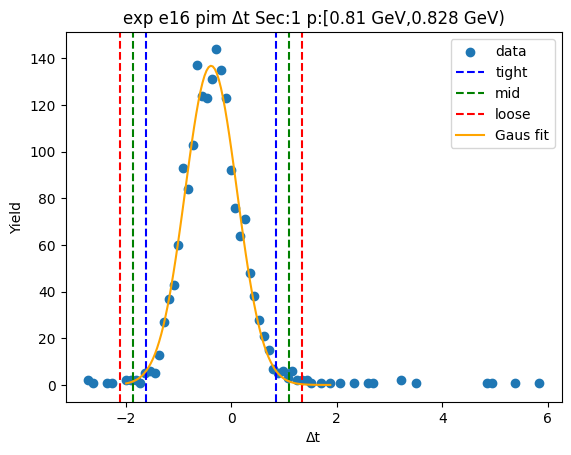

-1.678597674810843 0.8919013312942973
-1.9356475754213571 1.1489512319048112
-2.192697476031871 1.4060011325153252


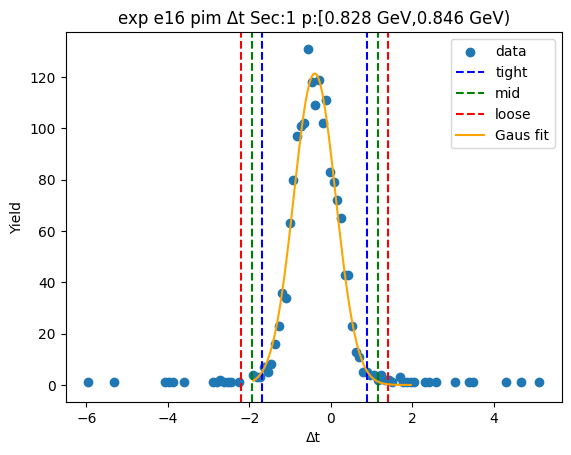

-1.6484336634705914 0.8061945428668198
-1.8938964841043324 1.0516573635005608
-2.1393593047380737 1.297120184134302


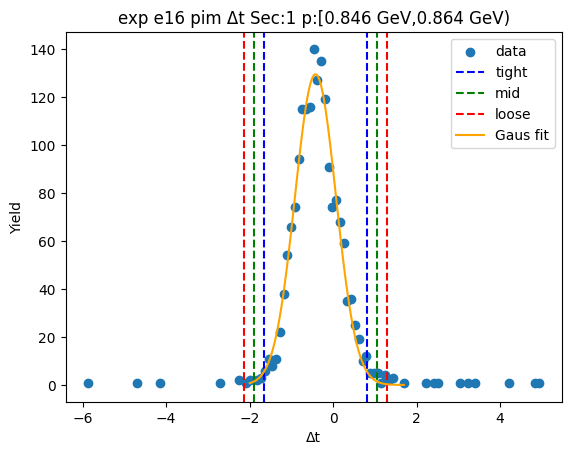

-1.5896700677771372 0.7893512841225169
-1.8275722029671027 1.0272534193124825
-2.065474338157068 1.2651555545024475


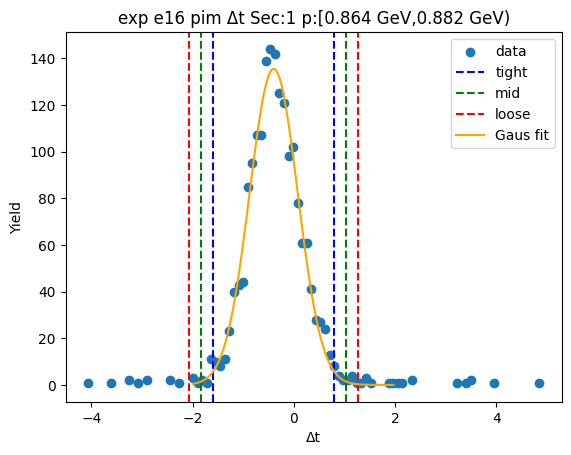

-1.584735734354565 0.8468876811396563
-1.827898075903987 1.0900500226890784
-2.0710604174534093 1.3332123642385003


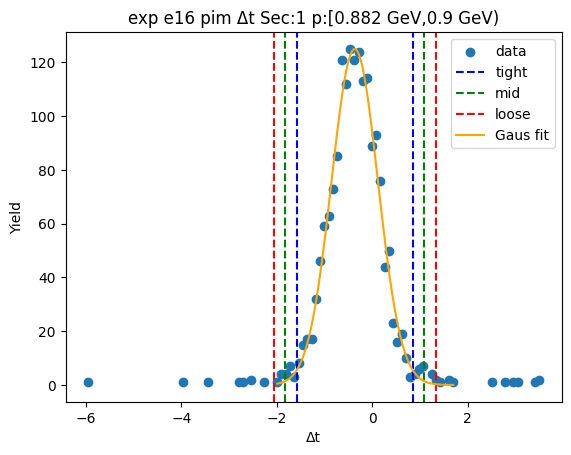

-1.656005557831574 0.8757404143912677
-1.9091801550538583 1.128915011613552
-2.1623547522761424 1.3820896088358363


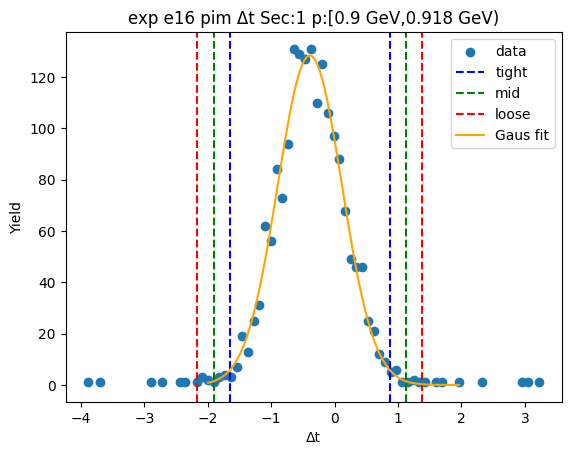

-1.6069386537908754 0.8119869615997091
-1.8488312153299338 1.0538795231387674
-2.0907237768689924 1.295772084677826


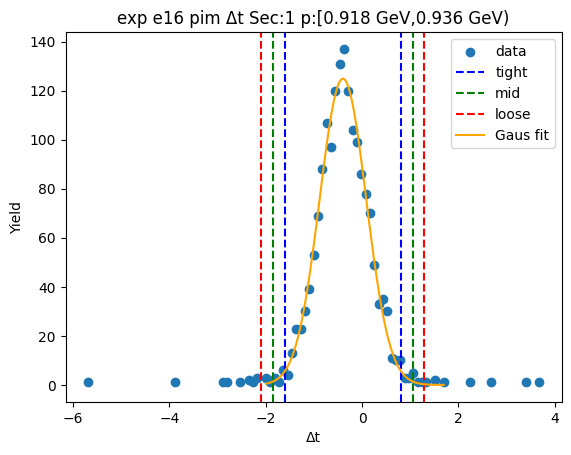

-1.6594745033949914 0.8458266484146414
-1.9100046185759543 1.0963567635956046
-2.1605347337569176 1.3468868787765675


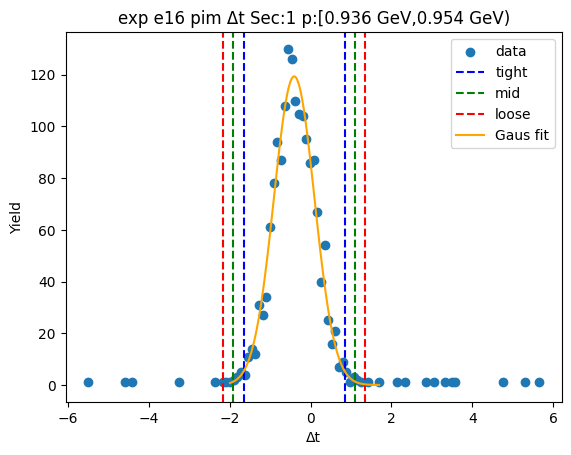

-1.6249297017692976 0.7998769567362443
-1.867410367619852 1.0423576225867985
-2.109891033470406 1.2848382884373526


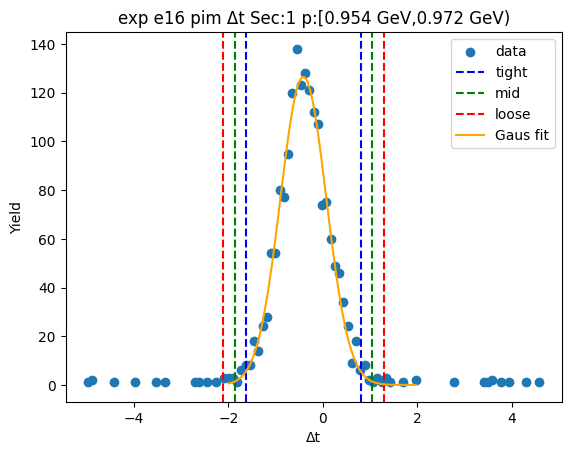

-1.696499360589378 0.8839948075115063
-1.9545487773994663 1.1420442243215947
-2.212598194209555 1.400093641131683


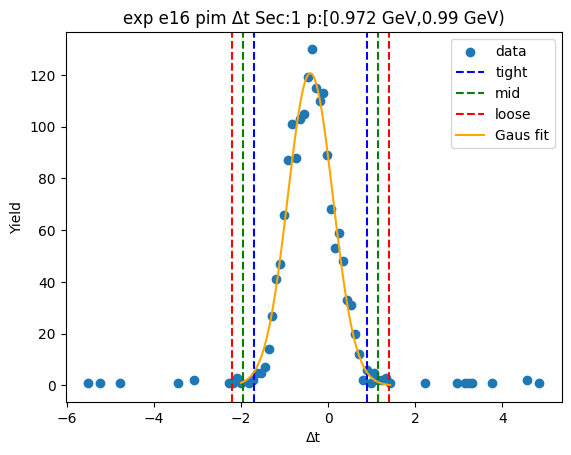

-1.6914728362241973 0.8752527634532765
-1.9481453961919448 1.131925323421024
-2.204817956159692 1.3885978833887715


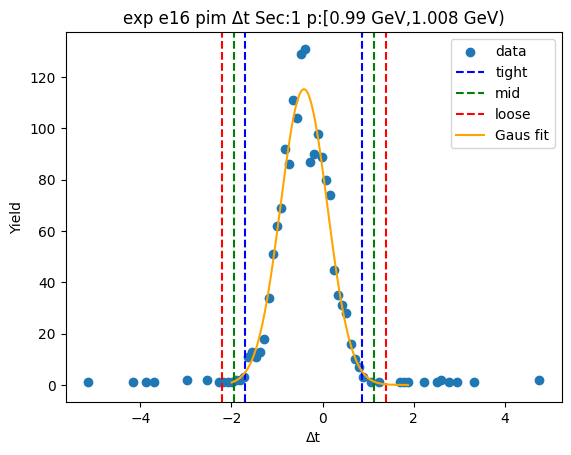

-1.7320380743122397 0.8731205851524777
-1.9925539402587116 1.1336364510989496
-2.2530698062051835 1.3941523170454213


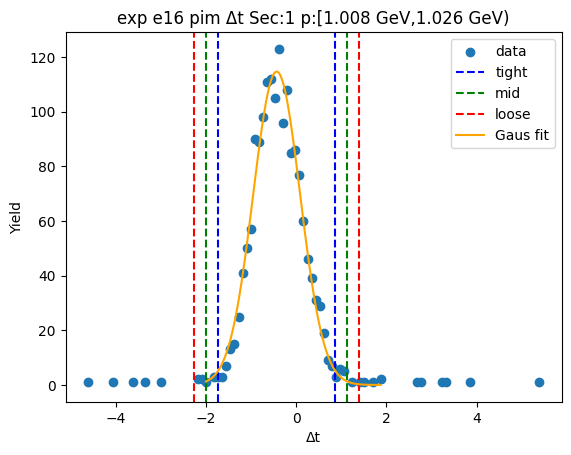

-1.6938856172672998 0.8816461636227464
-1.9514387953563046 1.1391993417117512
-2.2089919734453094 1.3967525198007558


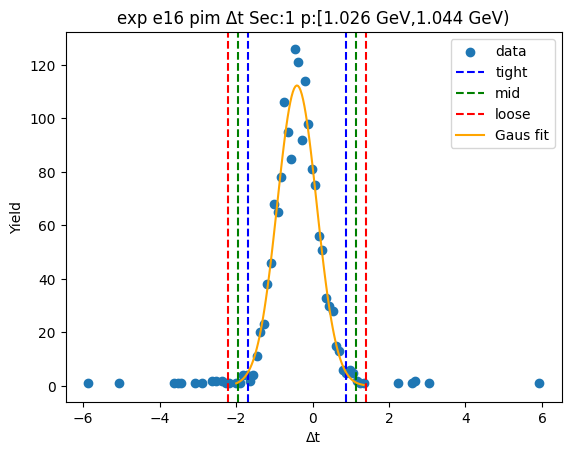

-1.754058104144567 0.8913972547797793
-2.0186036400370013 1.1559427906722137
-2.2831491759294362 1.4204883265646484


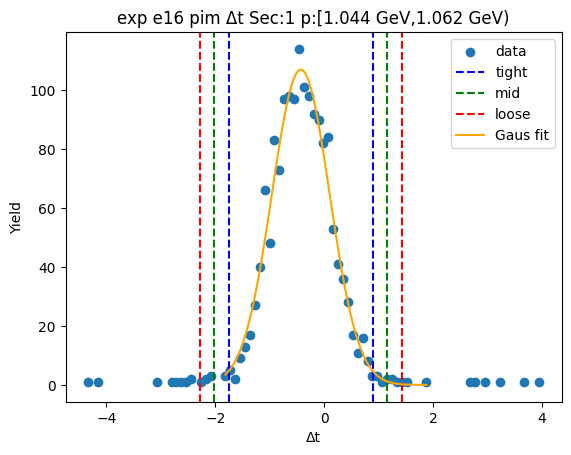

-1.674218191693725 0.82845952474791
-1.9244859633378888 1.0787272963920738
-2.1747537349820525 1.328995068036237


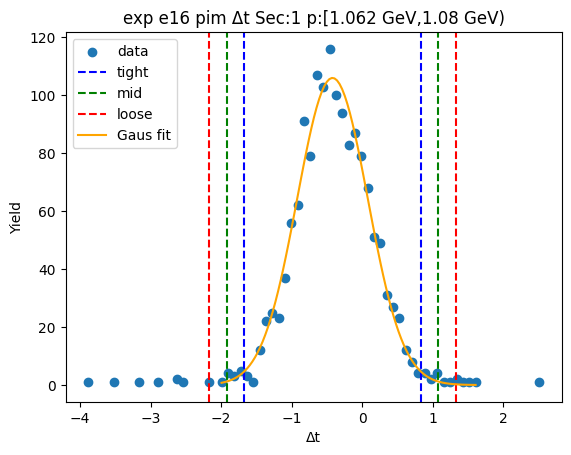

-1.714290805691501 0.8991124396347507
-1.9756311302241263 1.160452764167376
-2.2369714547567514 1.4217930887000012


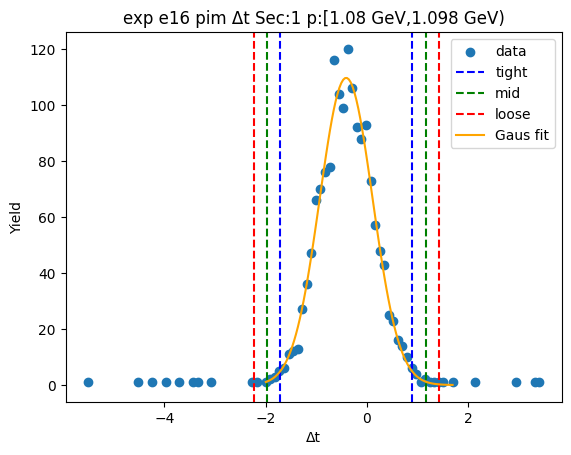

-1.654856661143418 0.8611529444899267
-1.9064576217067524 1.1127539050532613
-2.158058582270087 1.3643548656165958


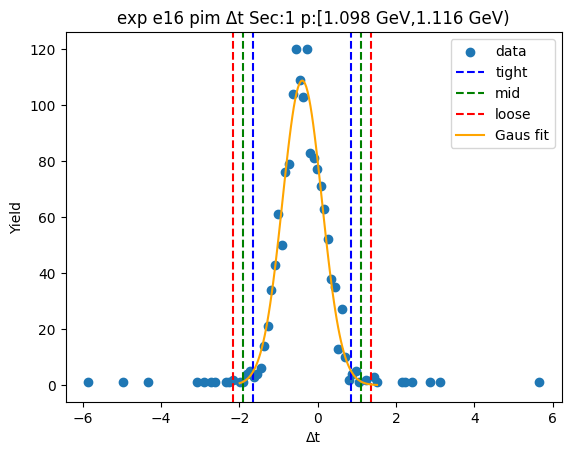

-1.5923668253833798 0.7949387043675269
-1.8310973783584703 1.0336692573426174
-2.069827931333561 1.272399810317708


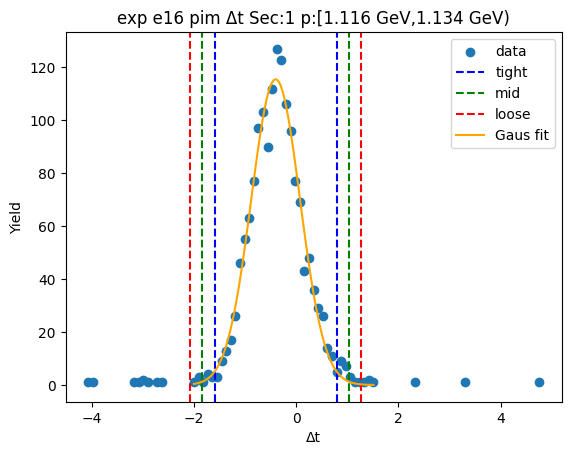

-1.6738127624922468 0.9021194096577856
-1.9314059797072498 1.1597126268727886
-2.188999196922253 1.417305844087792


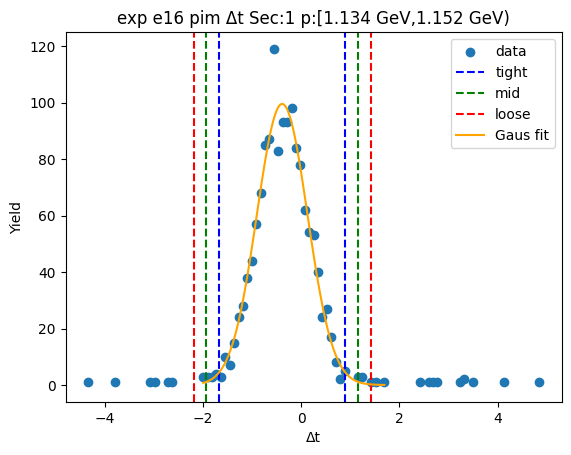

-1.6619798366761163 0.8535658413574165
-1.9135344044794695 1.1051204091607698
-2.165088972282823 1.356674976964123


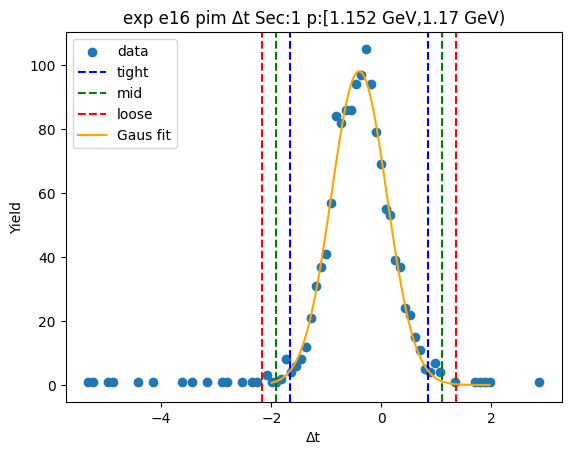

-1.667980483819619 0.8373044859605239
-1.9185089807976332 1.087832982938538
-2.1690374777756474 1.3383614799165522


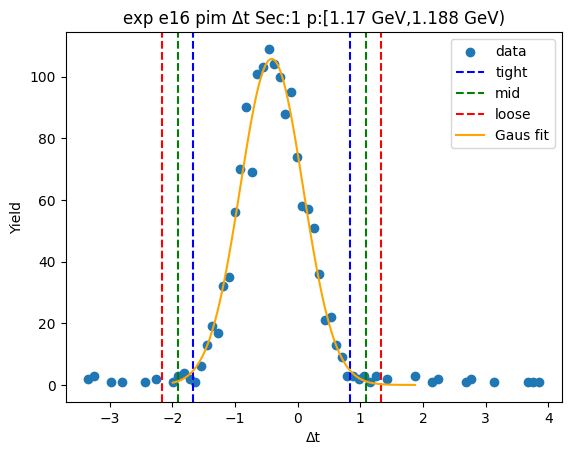

-1.6768226562397293 0.8693476152151081
-1.931439683385213 1.1239646423605918
-2.1860567105306967 1.3785816695060755


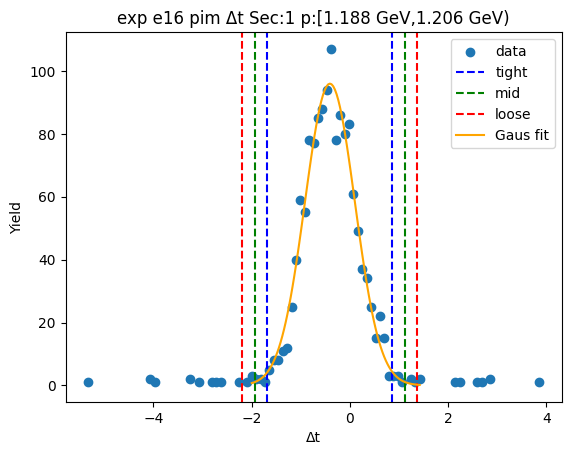

-1.7005990437844876 0.8903988365068267
-1.9596988318136188 1.149498624535958
-2.21879861984275 1.4085984125650894


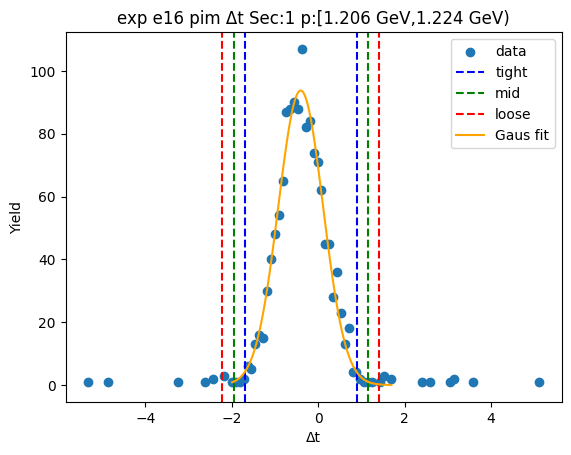

-1.640391930432774 0.8275296106999699
-1.8871840845460486 1.0743217648132444
-2.1339762386593226 1.3211139189265186


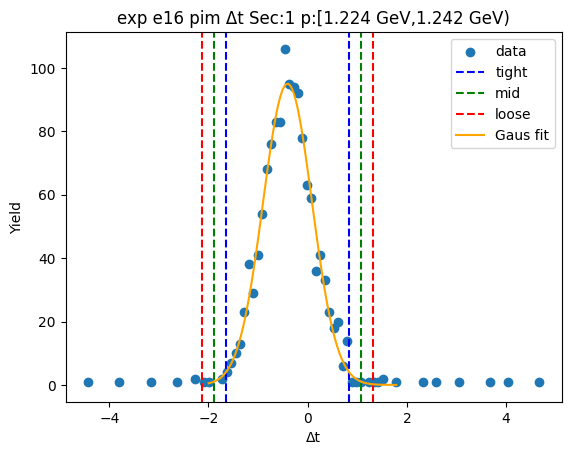

-1.6635685712697157 0.8890396661989786
-1.9188293950165851 1.144300489945848
-2.1740902187634545 1.3995613136927174


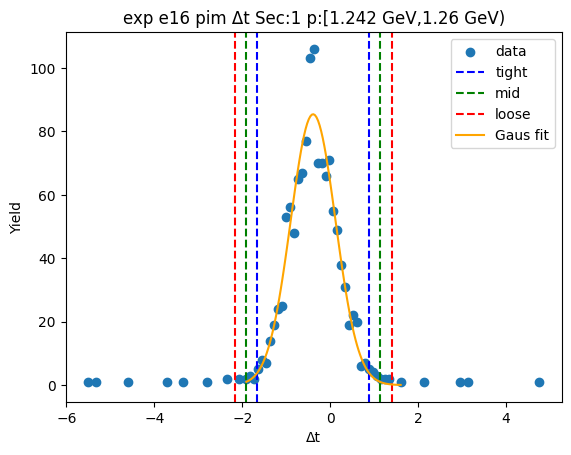

-1.5889142667698868 0.8346732983675633
-1.8312730232836316 1.0770320548813082
-2.0736317797973767 1.3193908113950532


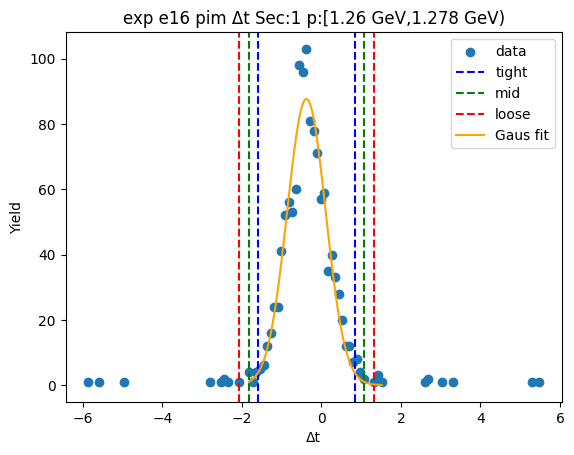

-1.6566625395300028 0.8735833643274119
-1.9096871299157439 1.1266079547131533
-2.1627117203014854 1.3796325450988944


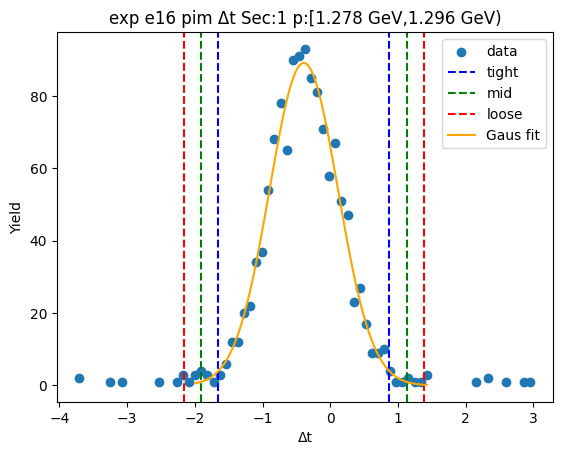

-1.654369674028146 0.9079612489402751
-1.910602766324988 1.1641943412371172
-2.1668358586218304 1.4204274335339593


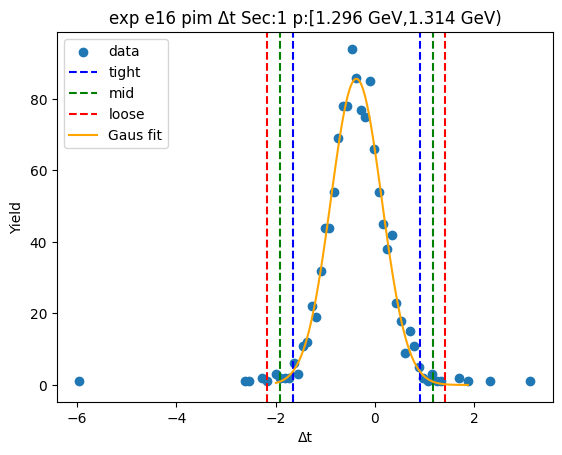

-1.611330287387148 0.8940758173762942
-1.8618708978634924 1.1446164278526385
-2.1124115083398367 1.3951570383289829


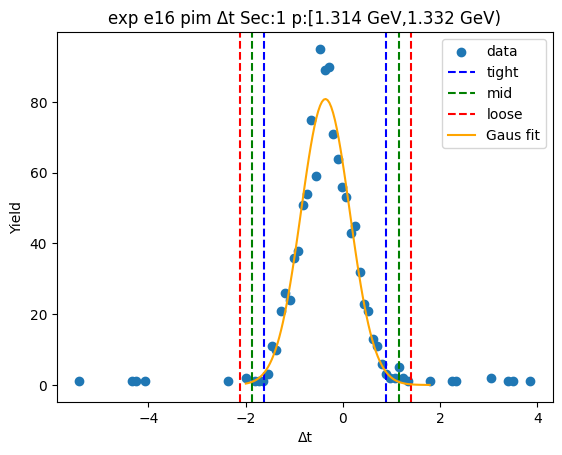

-1.6658457784613652 0.9201169645558491
-1.9244420527630868 1.1787132388575707
-2.183038327064808 1.4373095131592921


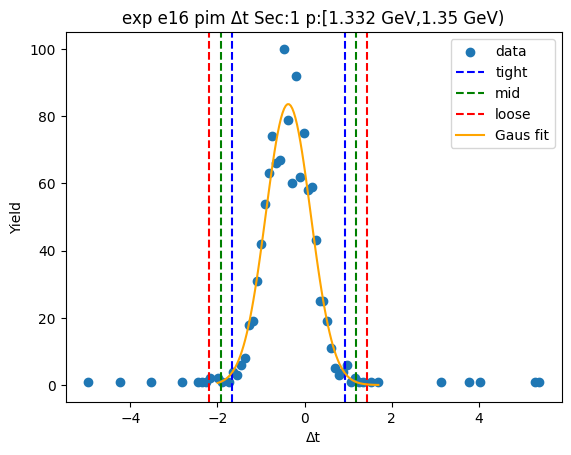

-1.609410547329313 0.89620578372325
-1.8599721804345695 1.1467674168285065
-2.110533813539826 1.3973290499337627


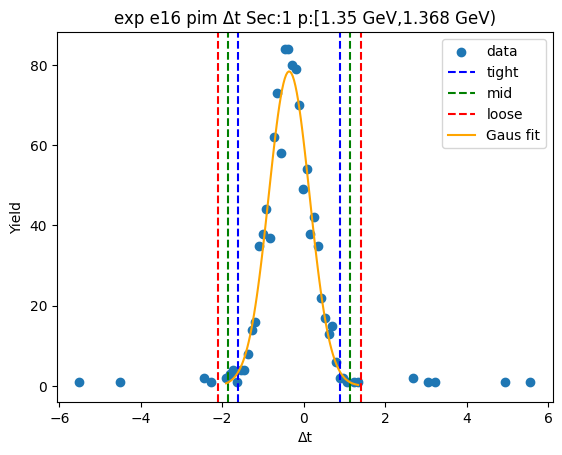

-1.6357855822200127 0.8613987039206481
-1.8855040108340786 1.111117132534714
-2.1352224394481447 1.3608355611487801


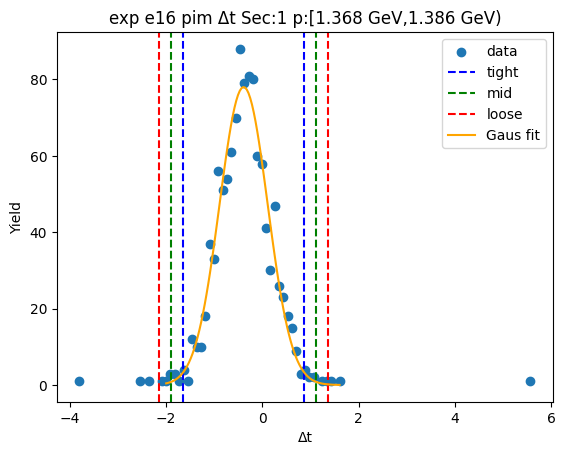

-1.6694361399034725 0.9294328726281199
-1.9293230411566316 1.1893197738812789
-2.1892099424097906 1.4492066751344383


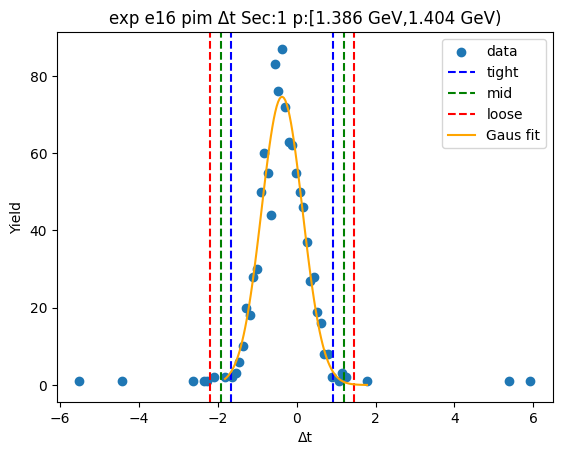

-1.6228428777149049 0.8853158763370856
-1.873658753120104 1.1361317517422849
-2.124474628525303 1.3869476271474839


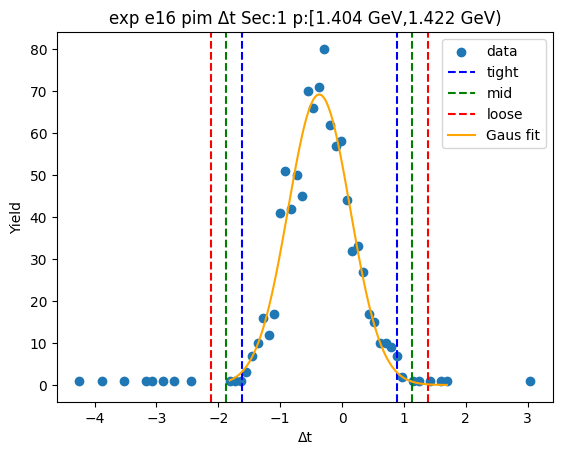

-1.618839211143028 0.8763573545775769
-1.8683588677150886 1.1258770111496375
-2.117878524287149 1.375396667721698


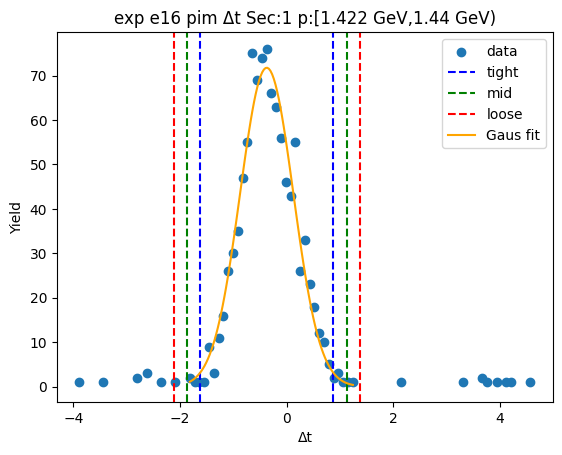

-1.6772341625002287 1.0178595838815472
-1.9467435371384063 1.2873689585197248
-2.216252911776584 1.5568783331579024


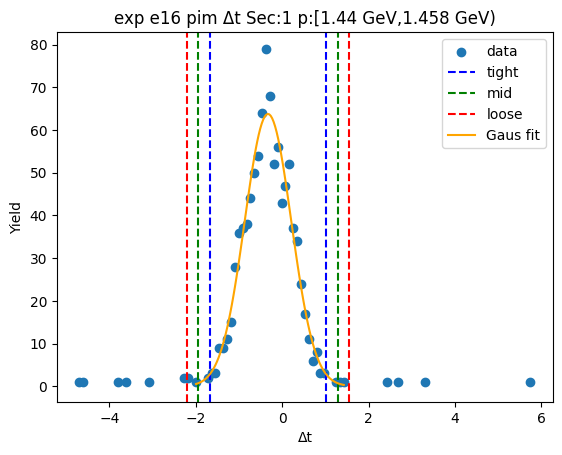

-1.596372847030981 0.8670074645264666
-1.8427108781867259 1.1133454956822115
-2.0890489093424707 1.3596835268379563


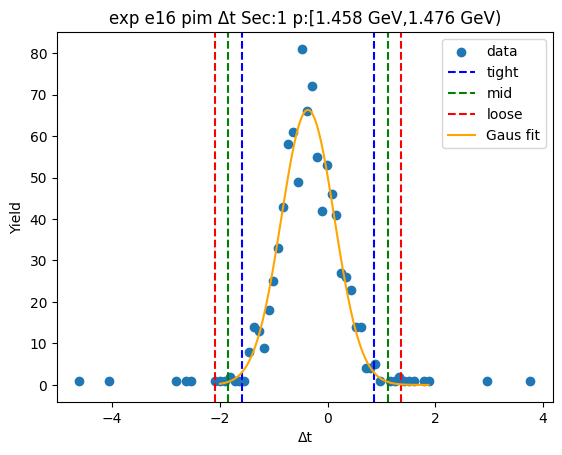

-1.5938942285965576 0.9088722969650591
-1.844170881152719 1.1591489495212206
-2.094447533708881 1.4094256020773823


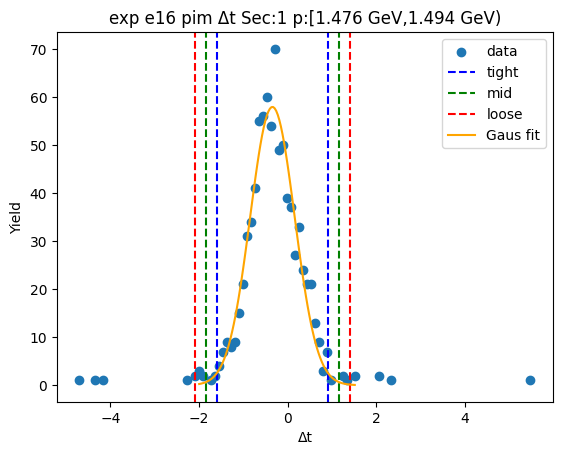

-1.6301144043745668 0.9540282553940036
-1.8885286703514237 1.2124425213708605
-2.1469429363282804 1.4708567873477174


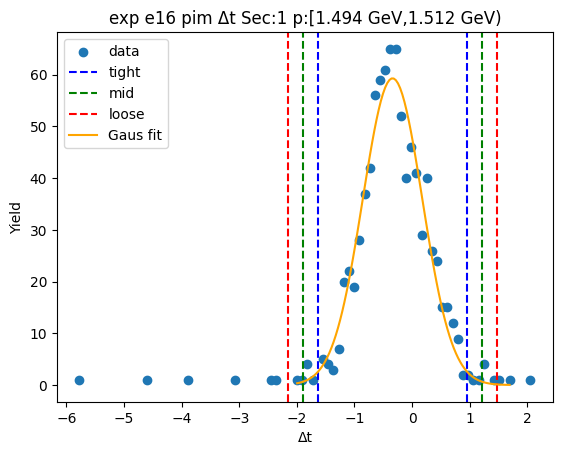

-1.6820854255108086 0.967325126342542
-1.9470264806961437 1.232266181527877
-2.2119675358814788 1.497207236713212


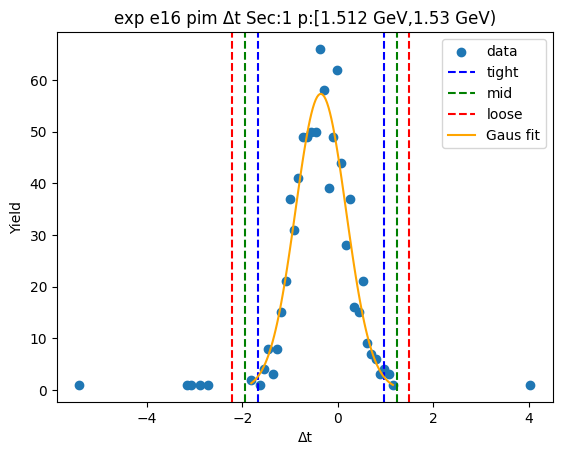

-1.5586956028296404 0.8138626574566177
-1.795951428858266 1.0511184834852434
-2.033207254886892 1.2883743095138693


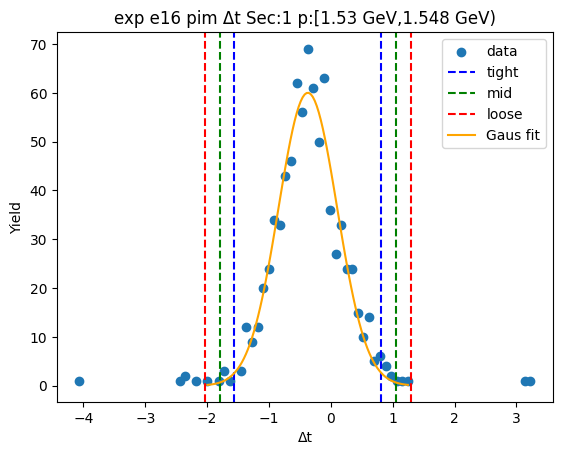

-1.4955919399860103 0.8958592845174225
-1.7347370624363536 1.1350044069677658
-1.9738821848866968 1.374149529418109


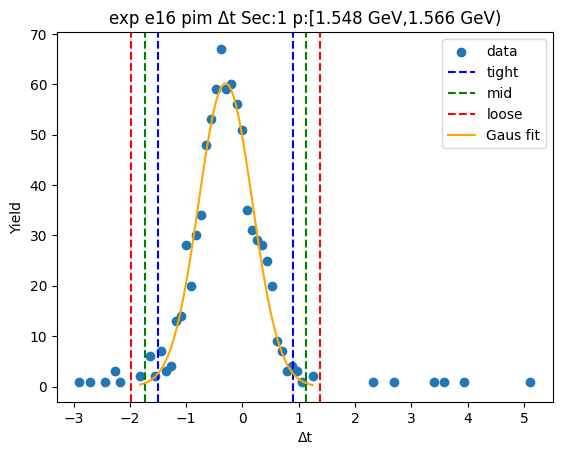

-1.5920595698952777 0.9066886478263665
-1.841934391667442 1.1565634695985307
-2.0918092134396065 1.4064382913706952


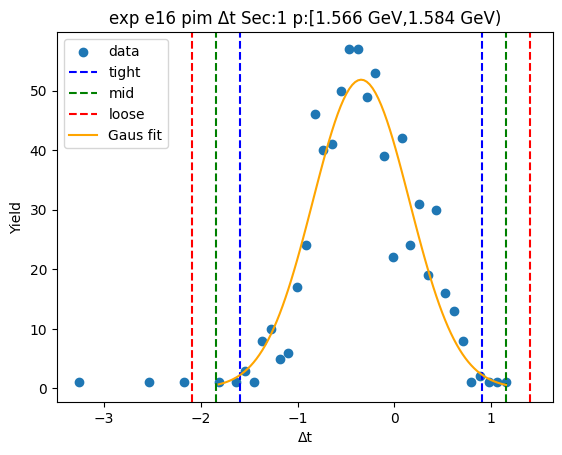

-1.5798795874621523 0.8246414545873235
-1.8203316916671 1.0650935587922712
-2.060783795872047 1.3055456629972186


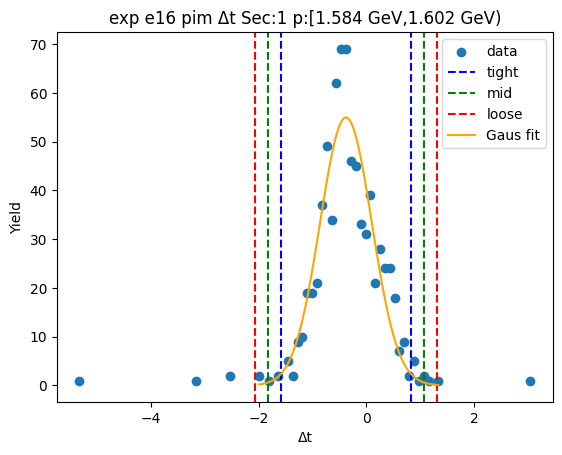

-1.5066551640018224 0.9441740683874602
-1.7517380872407506 1.1892569916263884
-1.9968210104796789 1.4343399148653166


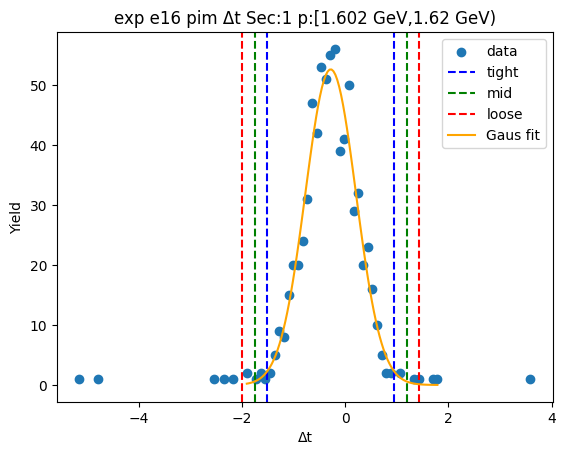

-1.5582563114471089 1.0224367408108181
-1.8163256166729014 1.2805060460366107
-2.074394921898694 1.5385753512624034


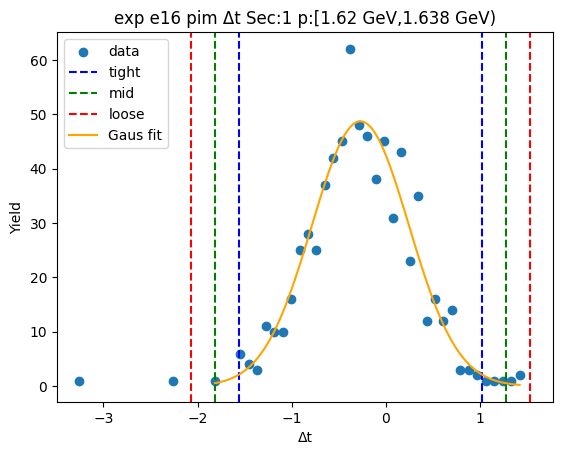

-1.6443274620867872 1.0096491819513984
-1.9097251264906059 1.2750468463552171
-2.175122790894424 1.5404445107590359


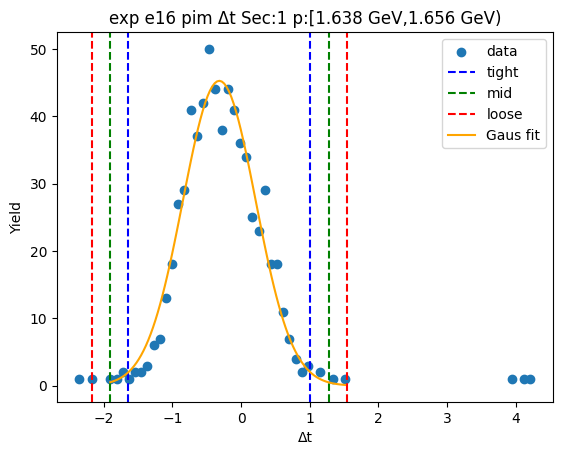

-1.5466977534572002 0.8921241648381035
-1.7905799452867304 1.1360063566676337
-2.034462137116261 1.3798885484971641


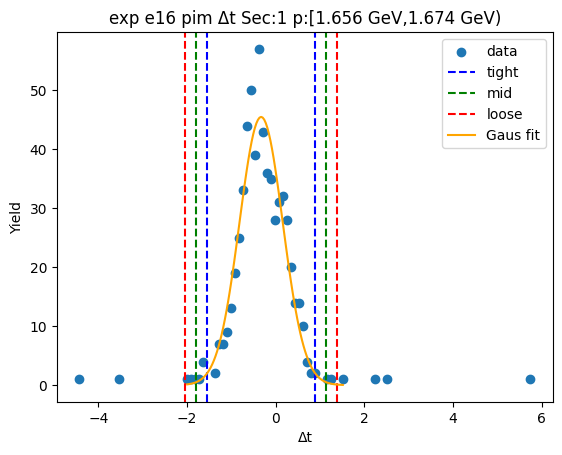

-1.5797405290719206 0.9999922183092806
-1.837713803810041 1.257965493047401
-2.095687078548161 1.5159387677855212


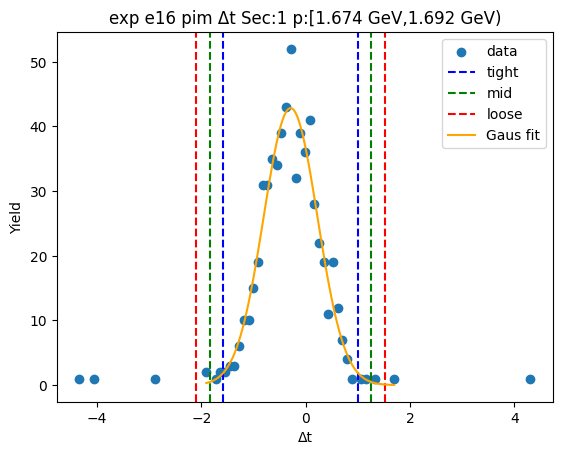

-1.5872762723698721 0.9601827952234202
-1.8420221791292013 1.2149287019827497
-2.0967680858885305 1.469674608742079


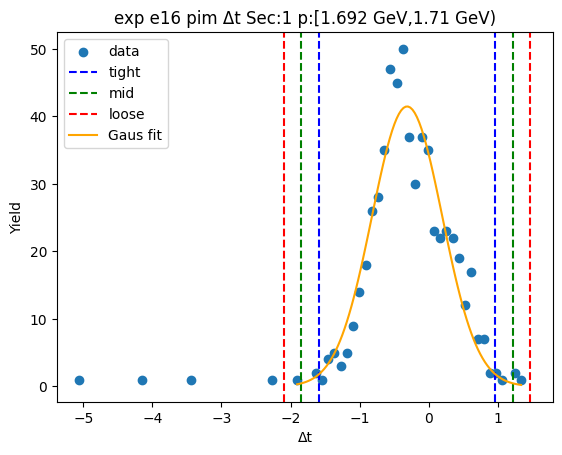

-1.455202045754488 0.8316526621360967
-1.6838875165435467 1.0603381329251553
-1.9125729873326052 1.2890236037142138


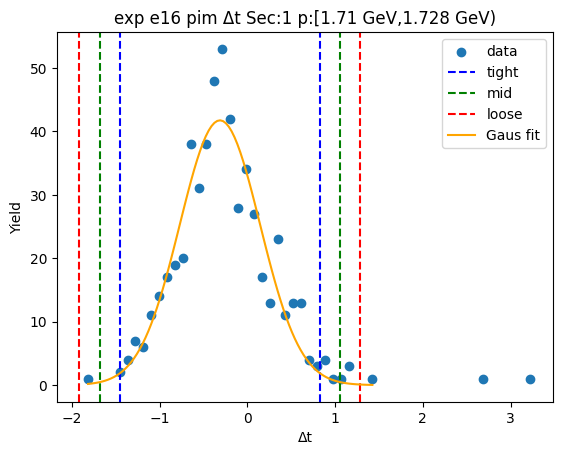

-1.5473527769770419 0.9542166894091881
-1.7975097236156647 1.204373636047811
-2.0476666702542876 1.4545305826864339


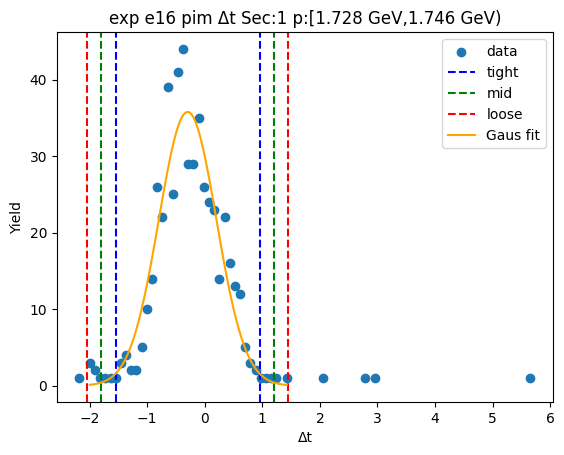

-1.6812600822449892 1.09109820401029
-1.9584959108705173 1.368334032635818
-2.235731739496045 1.6455698612613459


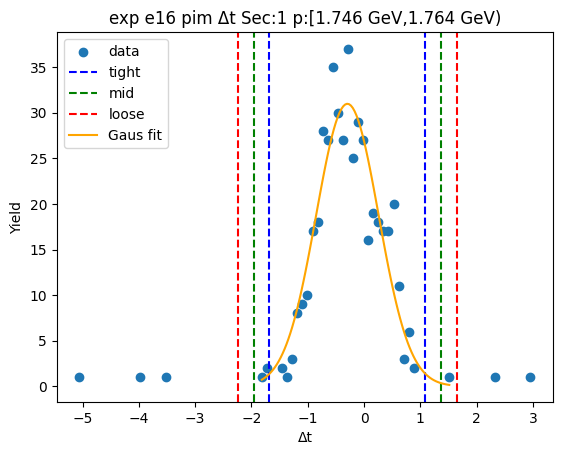

-1.4624637715062367 0.9512468852939505
-1.703834837186255 1.1926179509739692
-1.9452059028662738 1.433989016653988


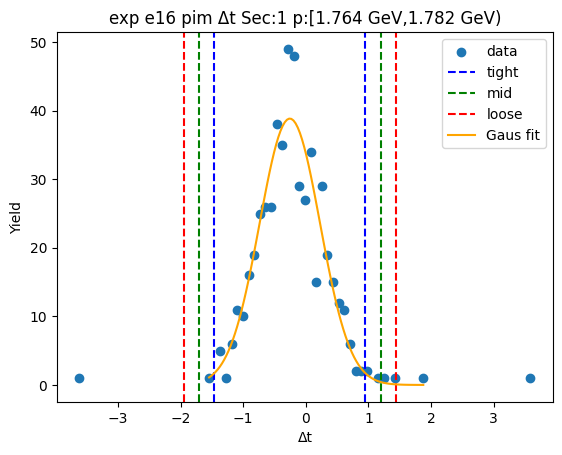

-1.50962753039636 0.9606456863162205
-1.756654852067618 1.2076730079874785
-2.003682173738876 1.4547003296587366


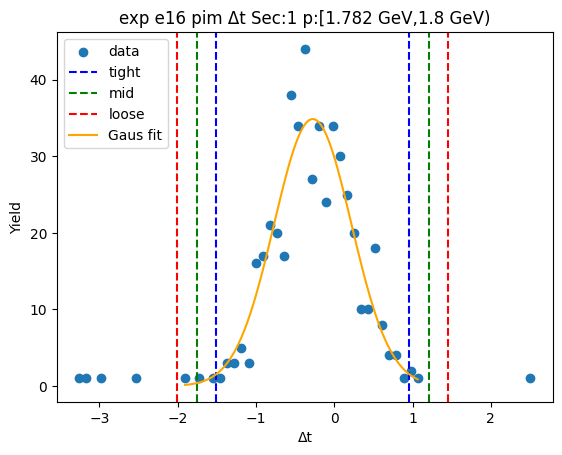

-1.4068260251473779 0.7238083731185185
-1.6198894649739675 0.9368718129451081
-1.832952904800557 1.1499352527716977


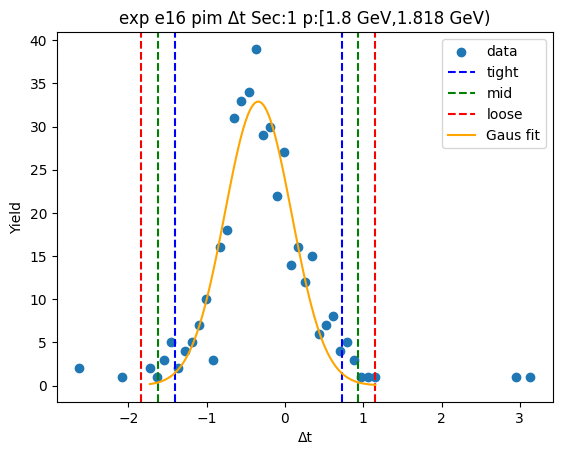

-1.4866839754589598 0.8431339021491386
-1.7196657632197698 1.0761156899099487
-1.9526475509805796 1.3090974776707585


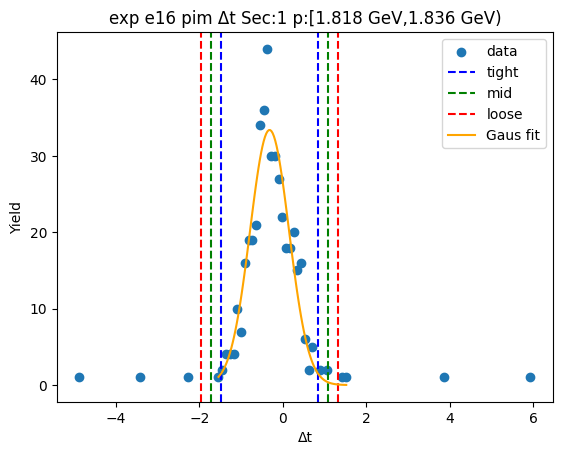

-1.4780661545070601 0.8255985751807261
-1.7084326274758386 1.0559650481495044
-1.938799100444617 1.2863315211182833


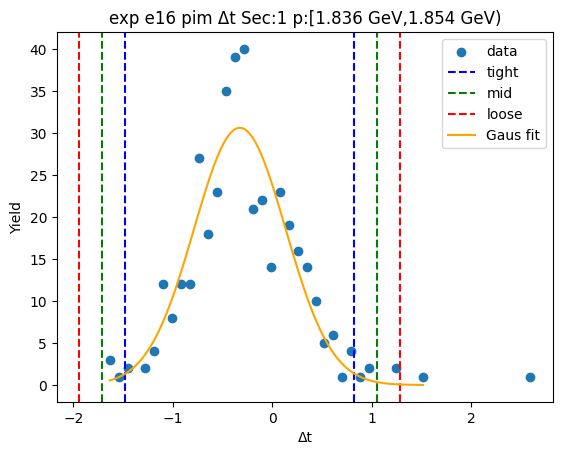

-1.5108131165512906 0.9081221488978595
-1.7527066430962057 1.1500156754427746
-1.9946001696411209 1.3919092019876897


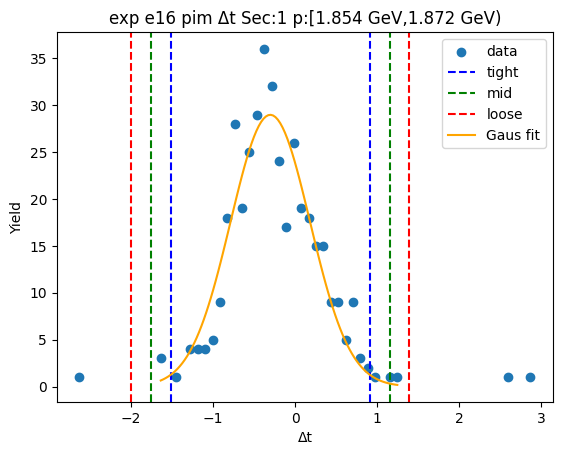

-1.5501401651431541 0.7797303116990317
-1.7831272128273727 1.0127173593832504
-2.0161142605115914 1.245704407067469


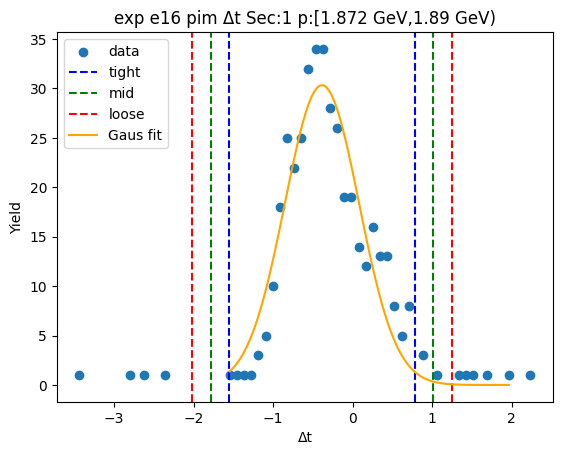

-1.6157318244423697 0.8875261381299525
-1.866057620699602 1.1378519343871845
-2.1163834169568343 1.3881777306444167


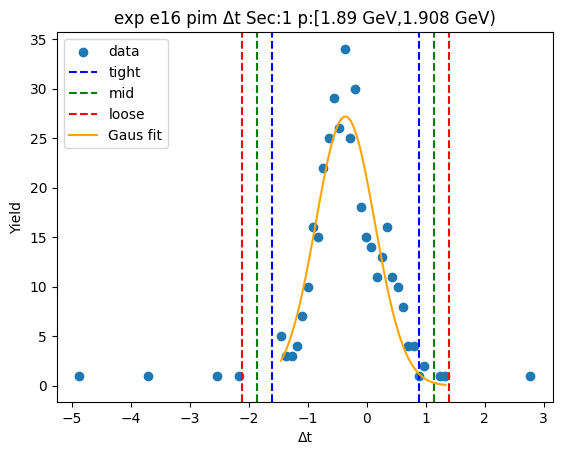

-1.490545369119016 0.8247924901392032
-1.7220791550448378 1.056326276065025
-1.9536129409706597 1.287860061990847


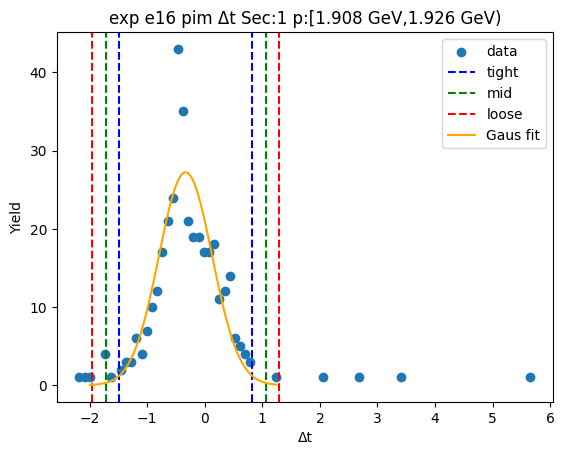

-1.5061335704647476 0.8991471013257812
-1.7466616376438004 1.139675168504834
-1.9871897048228533 1.380203235683887


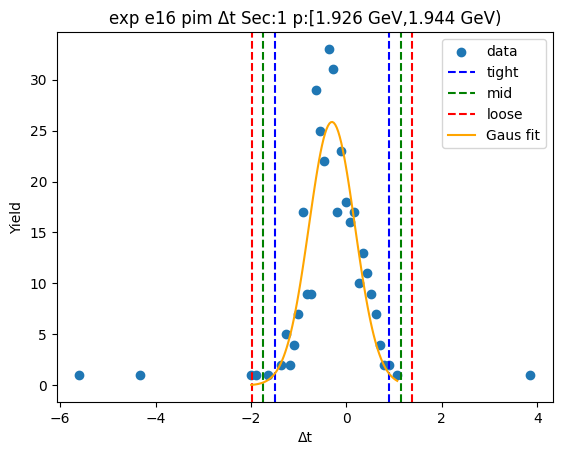

-1.711179529968001 0.994127798562447
-1.9817102628210457 1.2646585314154917
-2.2522409956740903 1.5351892642685365


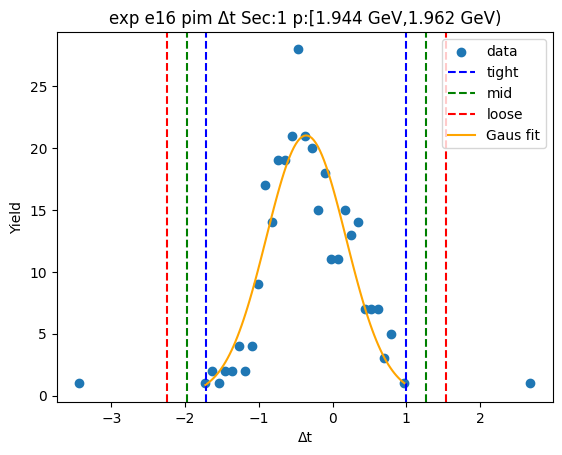

-1.5682720079879253 0.8125580950767034
-1.8063550182943886 1.0506411053831664
-2.0444380286008514 1.2887241156896292


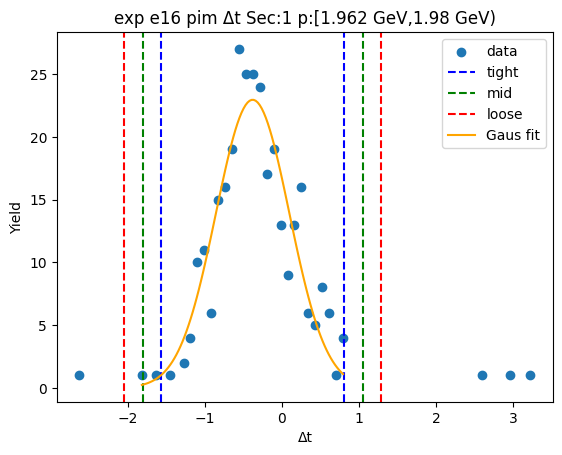

-1.529668304108211 0.7636632195176158
-1.7590014564707939 0.9929963718801986
-1.9883346088333764 1.2223295242427812


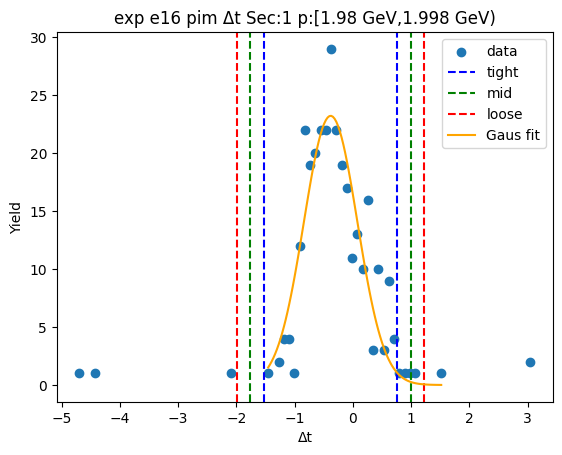

-1.4835822542673014 0.6557720073930422
-1.6975176804333358 0.8697074335590766
-1.91145310659937 1.0836428597251109


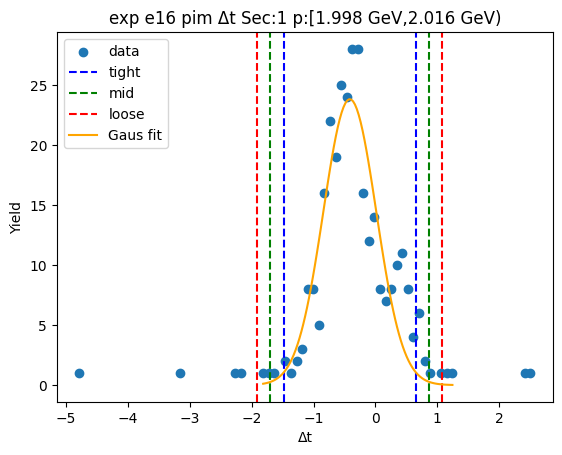

-1.557393803962676 0.8325077336579259
-1.7963839577247362 1.071497887419986
-2.0353741114867967 1.3104880411820463


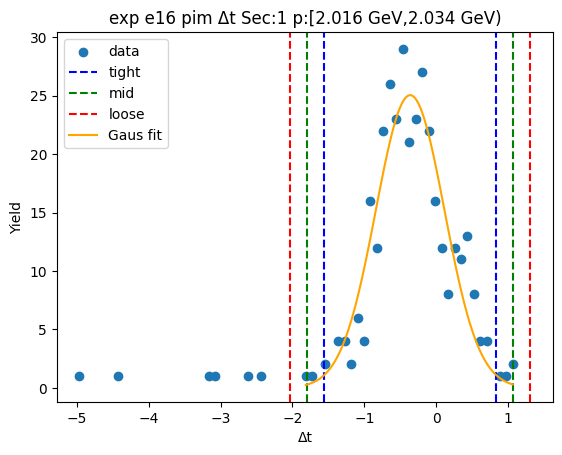

-1.5624476405324252 0.7827776987876425
-1.796970174464432 1.0173002327196492
-2.0314927083964385 1.251822766651656


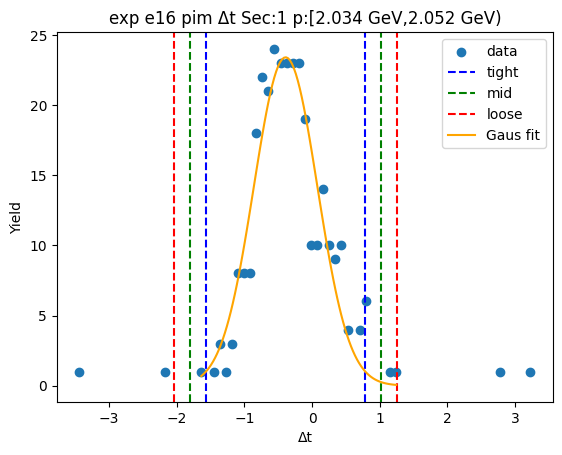

-1.4768676737374986 0.6837765631247836
-1.692932097423727 0.899840986811012
-1.9089965211099553 1.1159054104972403


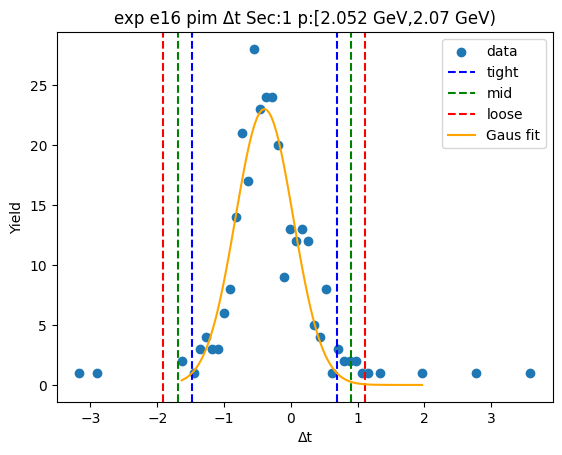

-1.547904312598822 0.8331287163344119
-1.7860076154921454 1.0712320192277351
-2.024110918385469 1.3093353221210584


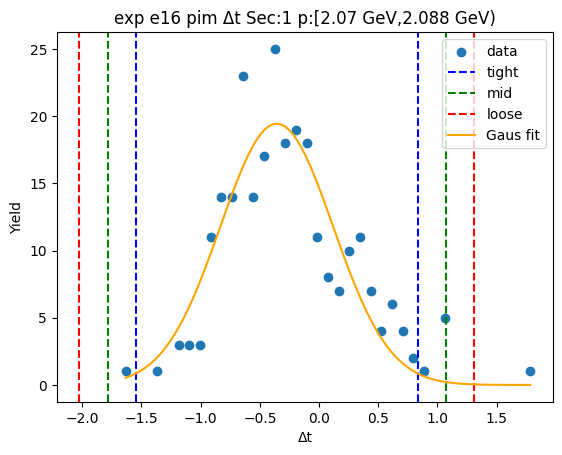

-1.6526497914147842 0.8454121086030999
-1.9024559814165725 1.0952182986048882
-2.1522621714183607 1.3450244886066764


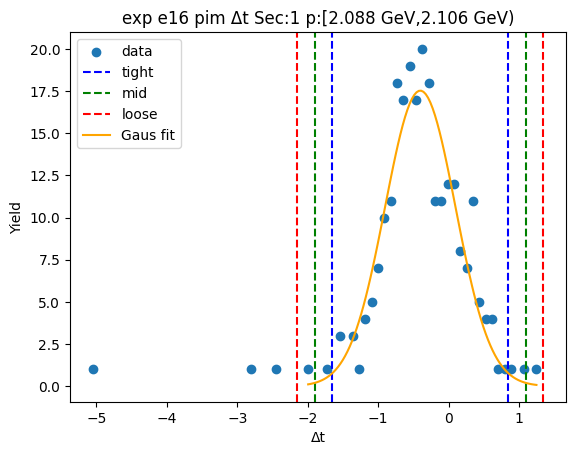

-1.4441609373812114 0.5817930062722426
-1.6467563317465568 0.784388400637588
-1.8493517261119021 0.9869837950029333


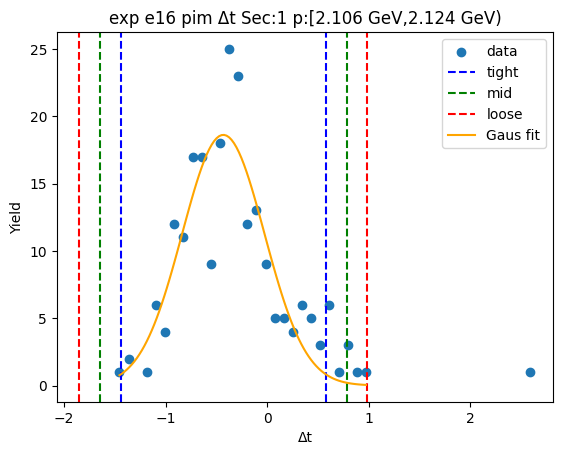

-1.551880920656858 0.5624770363778051
-1.7633167163603245 0.7739128320812716
-1.9747525120637908 0.9853486277847379


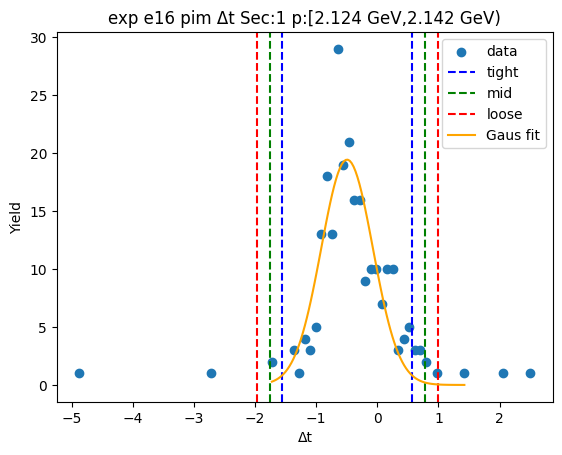

-1.533181411795717 0.6877951844154881
-1.7552790714168376 0.9098928440366088
-1.977376731037958 1.1319905036577291


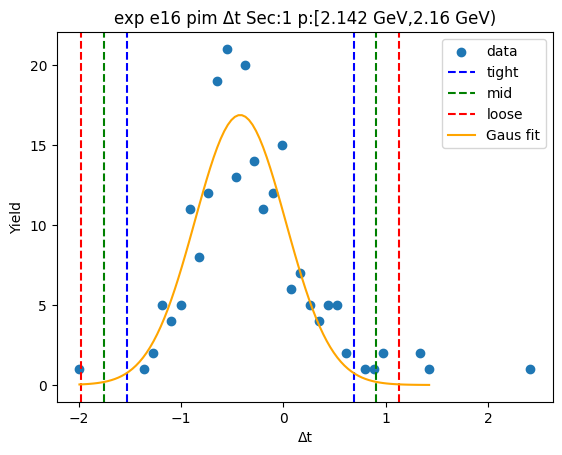

-1.5847179376717424 0.6452347962225327
-1.8077132110611698 0.86823006961196
-2.030708484450597 1.0912253430013874


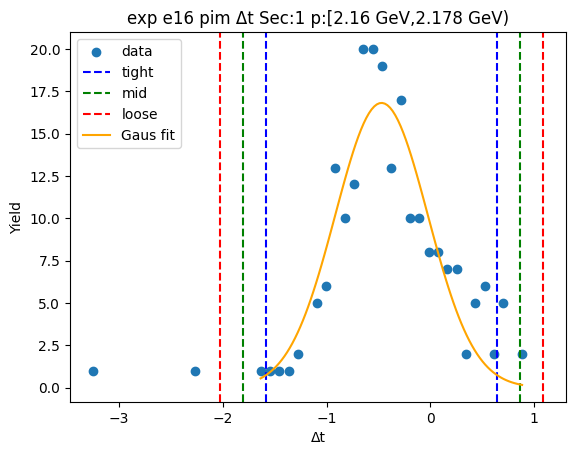

-1.5907371396711676 0.6182600591784435
-1.8116368595561285 0.8391597790634044
-2.0325365794410897 1.0600594989483656


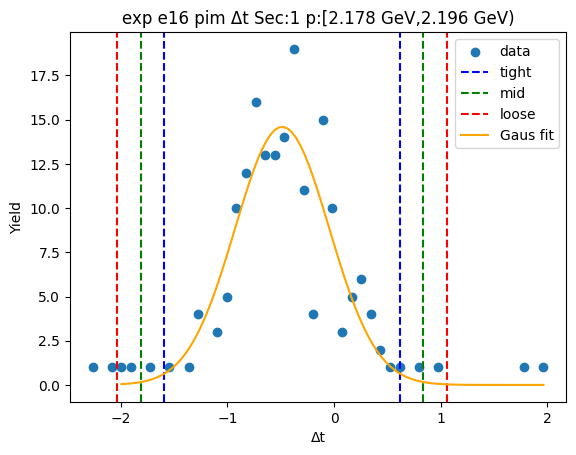

-1.6410684297544618 0.6745907302007346
-1.8726343457499814 0.9061566461962542
-2.104200261745501 1.137722562191774


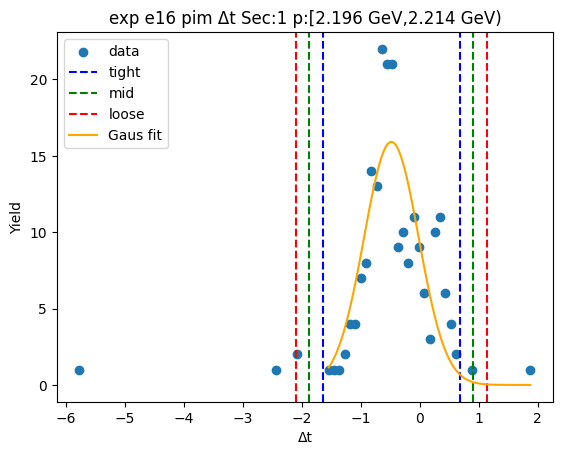

-1.4055316407005525 0.3735042921118811
-1.5834352339817959 0.5514078853931244
-1.7613388272630393 0.7293114786743677


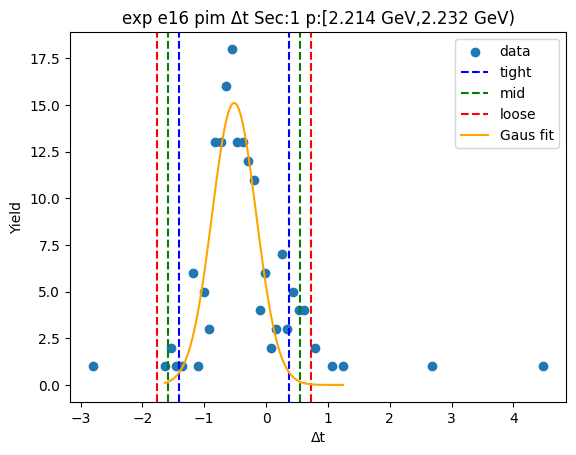

-1.518471542771187 0.5205393044805197
-1.722372627496358 0.7244403892056904
-1.9262737122215285 0.928341473930861


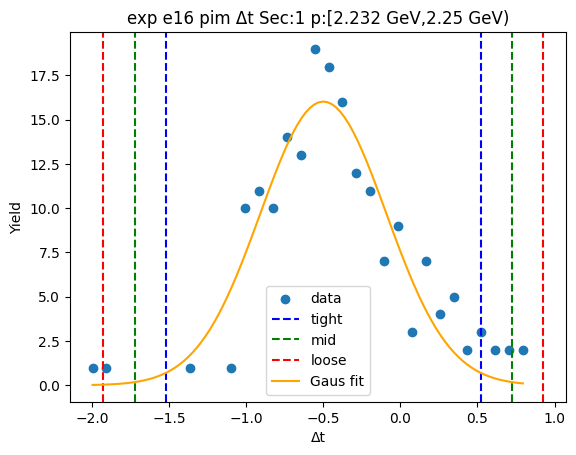

-1.622049896708011 0.5925760724653285
-1.843512493625345 0.8140386693826626
-2.064975090542679 1.0355012662999963


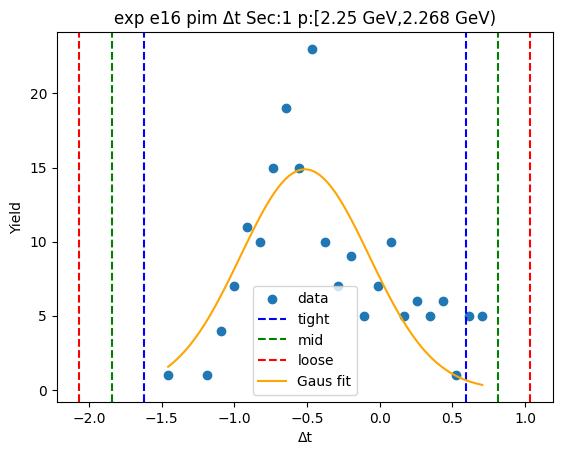

-1.8719484081193674 0.9144522386530004
-2.150588472796604 1.1930923033302374
-2.429228537473841 1.471732368007474


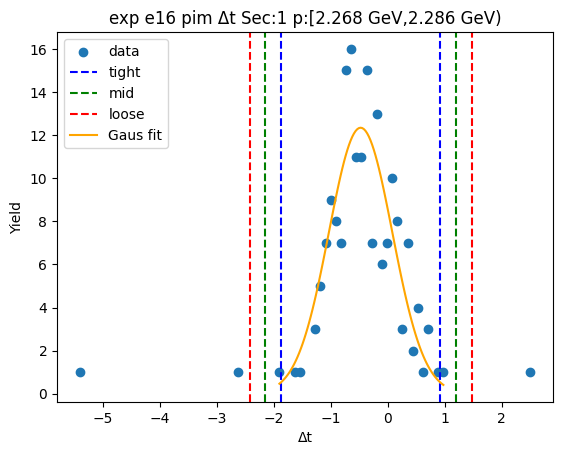

-1.7658451298188553 0.7567219866213172
-2.0181018414628724 1.0089786982653344
-2.27035855310689 1.2612354099093515


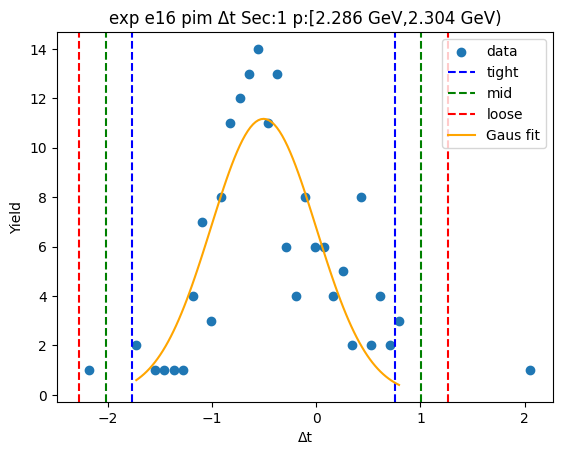

-1.5929178098133372 0.6641459901078974
-1.8186241898054605 0.8898523701000207
-2.0443305697975838 1.1155587500921442


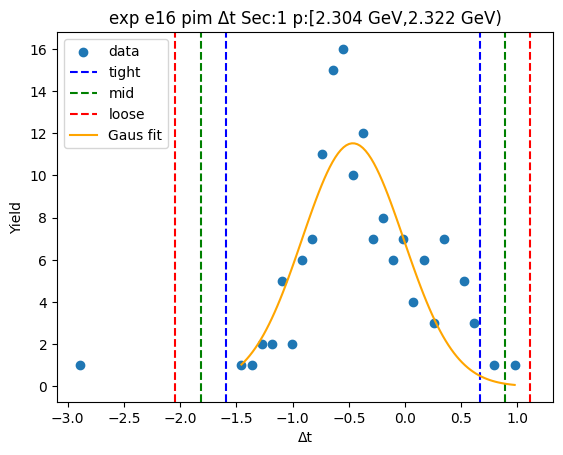

-1.7399939344604656 0.6773983686757182
-1.981733164774084 0.9191375989893368
-2.2234723950877022 1.1608768293029552


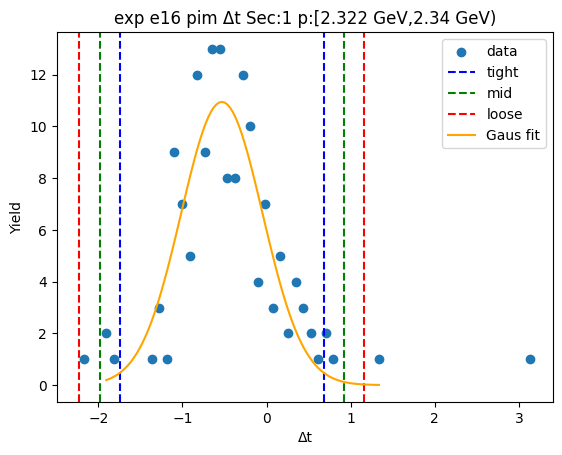

-1.6926399908715761 0.6598748135418012
-1.9278914713129138 0.8951262939831389
-2.1631429517542515 1.1303777744244767


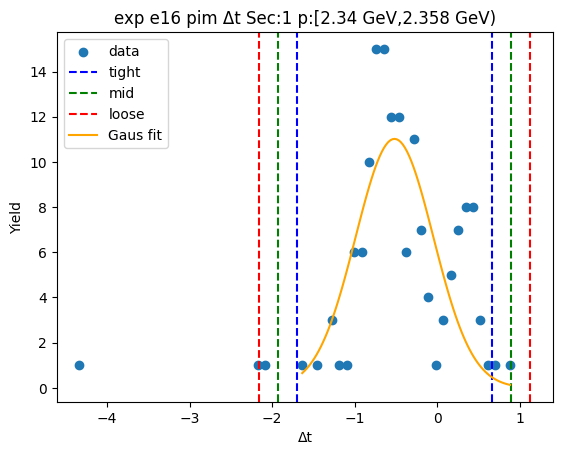

-1.6877890920454193 0.7934217131703836
-1.9359101725669994 1.0415427936919637
-2.1840312530885795 1.289663874213544


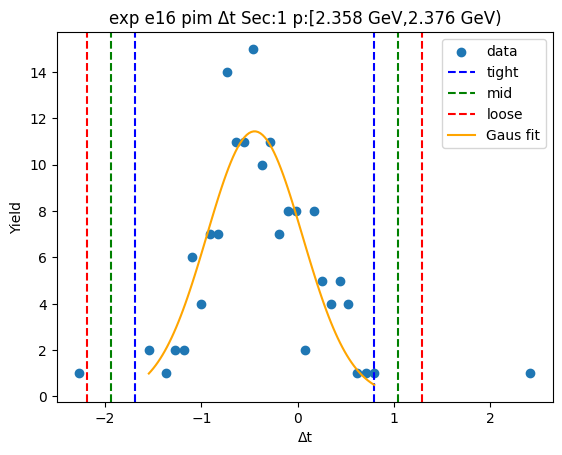

-1.7594109459444698 1.0257297893202773
-2.037925019470945 1.3042438628467519
-2.3164390929974195 1.582757936373227


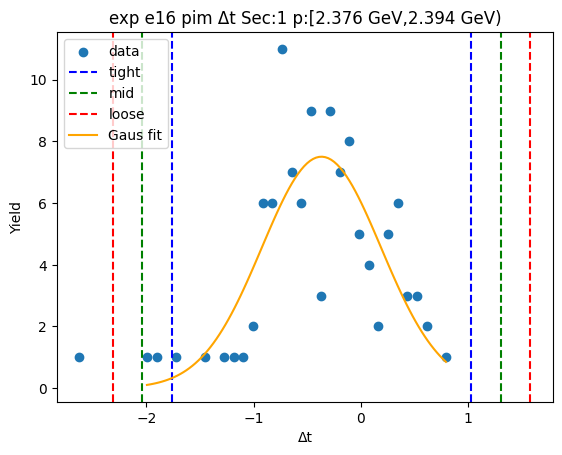

-1.6205179571372963 1.0178511534912327
-1.8843548682001492 1.2816880645540856
-2.1481917792630023 1.5455249756169385


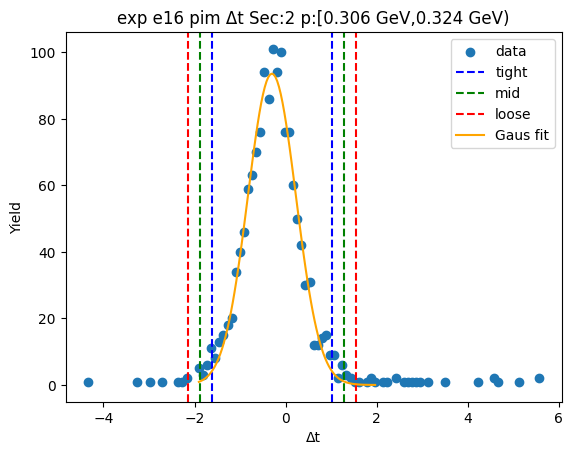

-1.6370609446606932 0.9773559429896764
-1.8985026334257298 1.2387976317547134
-2.159944322190767 1.50023932051975


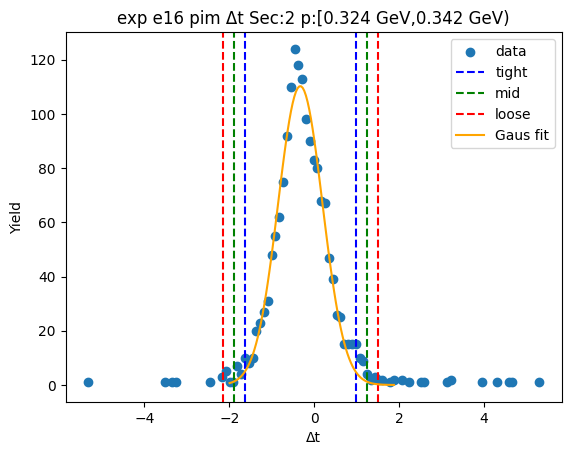

-1.6739155291796313 0.9905311383645318
-1.9403601959340477 1.2569758051189481
-2.2068048626884638 1.5234204718733646


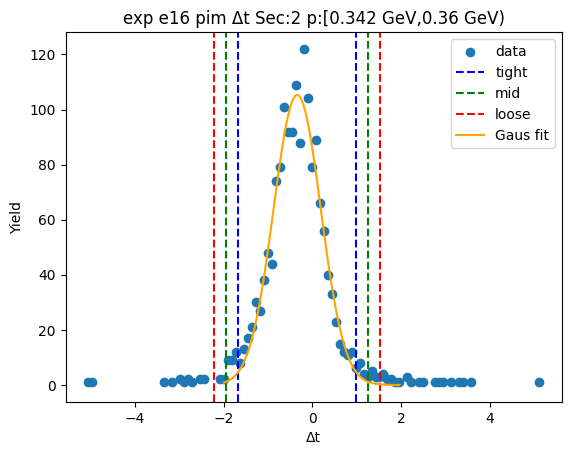

-1.6846743445747427 1.0023298734708757
-1.9533747663793044 1.2710302952754373
-2.222075188183866 1.5397307170799992


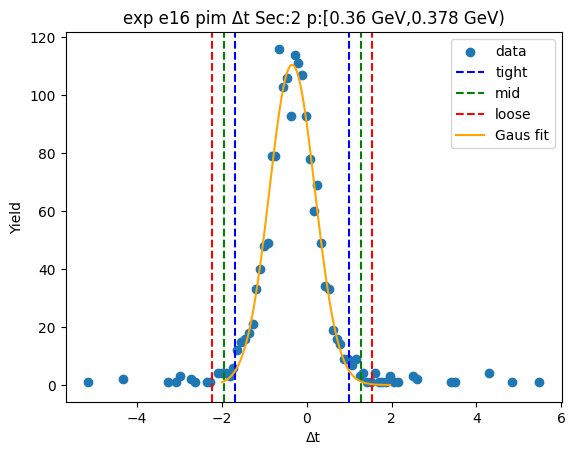

-1.585928712785605 0.9586818348043253
-1.8403897675445982 1.2131428895633185
-2.0948508223035915 1.4676039443223117


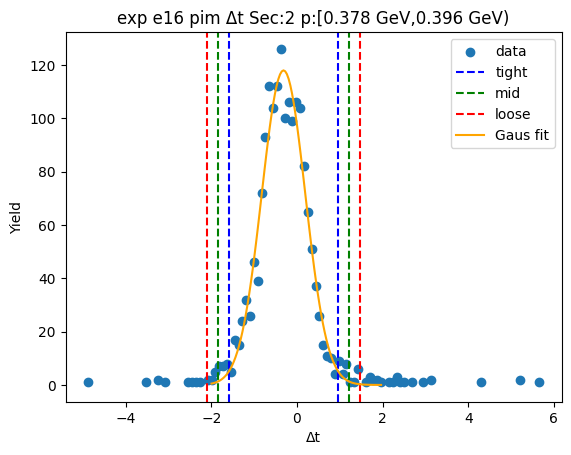

-1.632669242947212 0.9674640847856747
-1.8926825757205004 1.2274774175589633
-2.152695908493789 1.4874907503322516


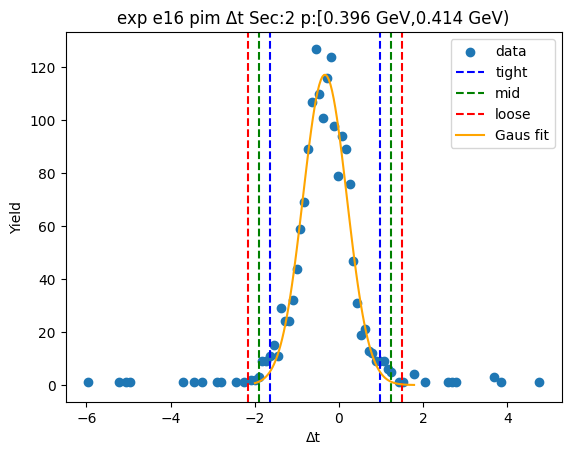

-1.6179792582667147 0.9745244902355732
-1.8772296331169434 1.2337748650858018
-2.1364800079671724 1.4930252399360306


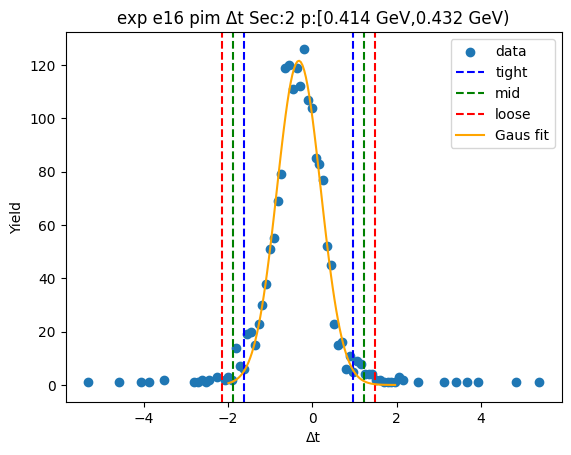

-1.6099727806967183 0.9344462467275797
-1.864414683439148 1.1888881494700092
-2.1188565861815776 1.4433300522124393


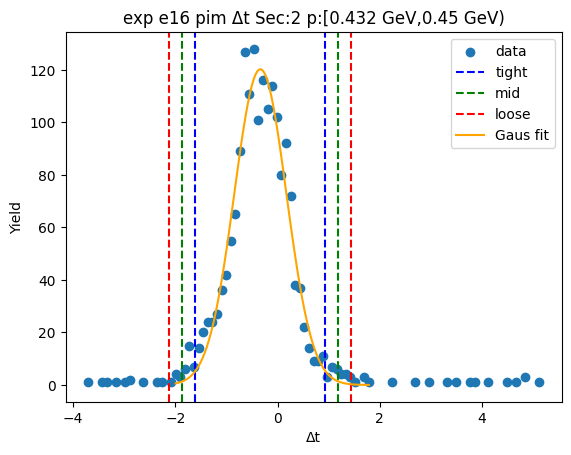

-1.6836576456028045 1.0018429486217368
-1.9522077050252586 1.270393008044191
-2.2207577644477126 1.538943067466645


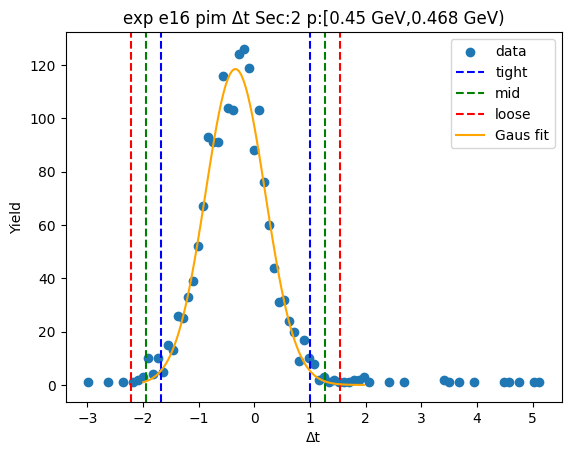

-1.7189923830416307 1.0510710802428254
-1.9959987293700765 1.3280774265712711
-2.273005075698522 1.6050837728997167


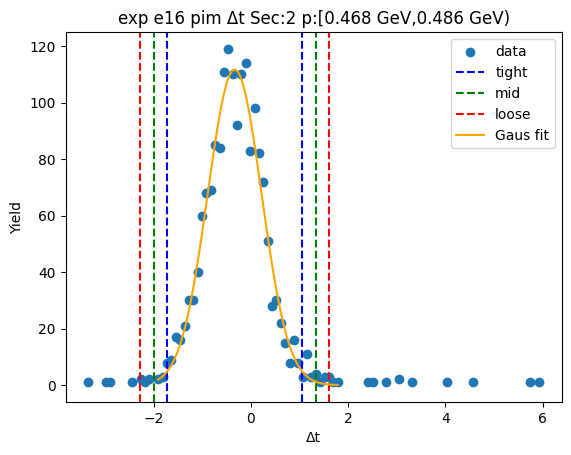

-1.7011291870041367 1.0089710225808297
-1.9721392079626332 1.2799810435393262
-2.24314922892113 1.5509910644978229


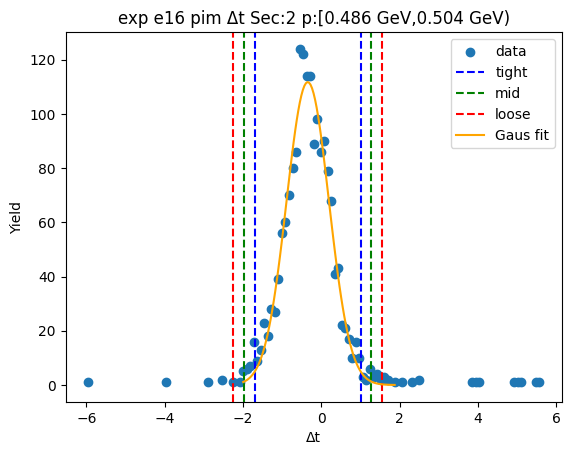

-1.6333087484720759 0.9617095910057922
-1.8928105824198627 1.221211424953579
-2.1523124163676495 1.4807132589013658


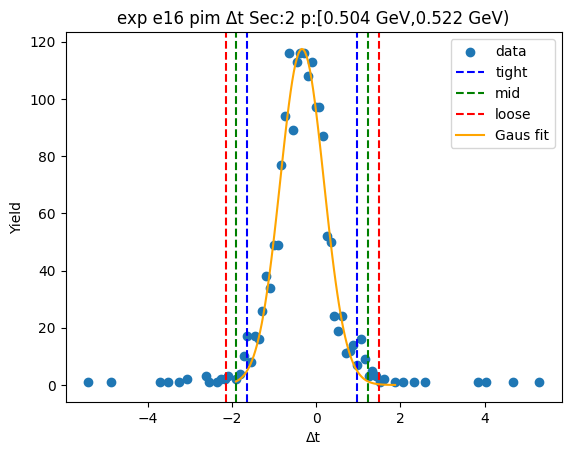

-1.631851185170644 1.0229249254031136
-1.8973287962280199 1.2884025364604894
-2.1628064072853954 1.5538801475178652


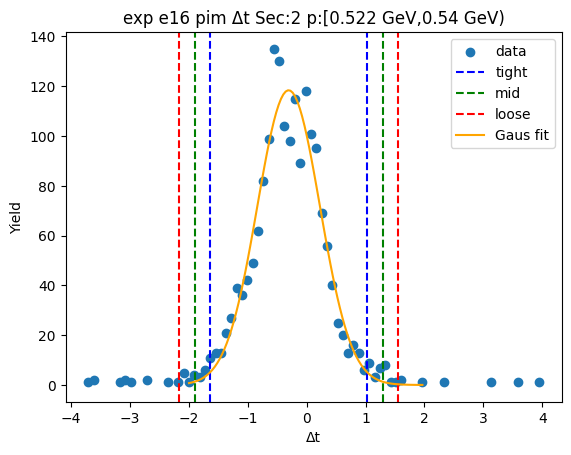

-1.7765253524682139 1.0978667551090944
-2.0639645632259445 1.3853059658668252
-2.3514037739836757 1.672745176624556


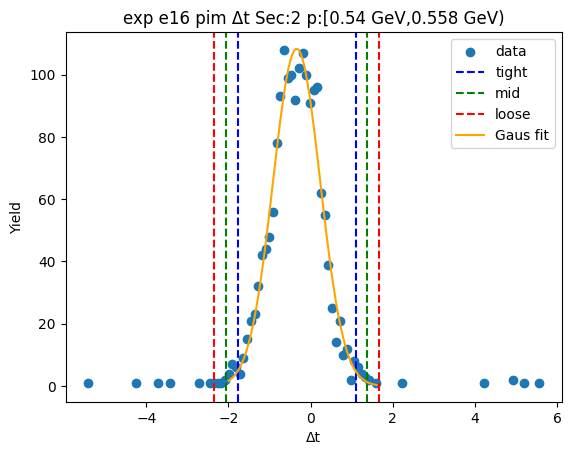

-1.6783588504139126 1.0186831880005556
-1.9480630542553596 1.2883873918420026
-2.2177672580968064 1.5580915956834493


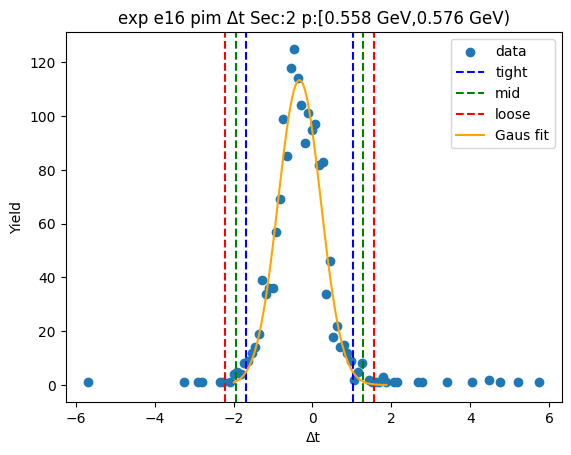

-1.6621369397043992 1.0101089837434525
-1.9293615320491846 1.2773335760882378
-2.1965861243939697 1.544558168433023


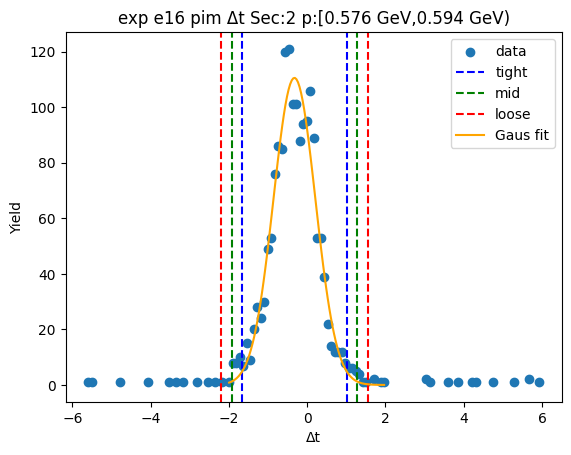

-1.6632865518183668 1.0422575553181797
-1.9338409625320216 1.3128119660318345
-2.204395373245676 1.583366376745489


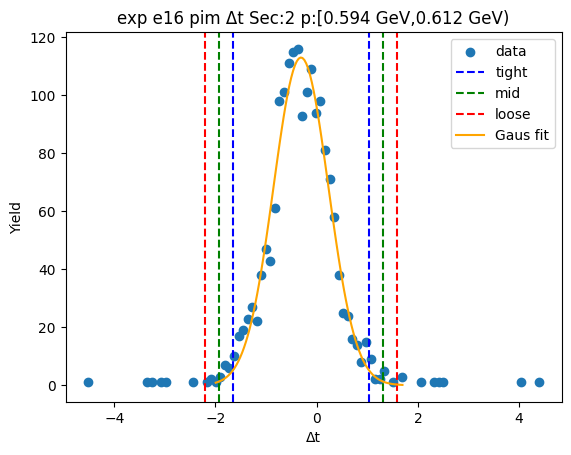

-1.678367961187684 1.0271174537737464
-1.948916502683827 1.2976659952698895
-2.21946504417997 1.5682145367660325


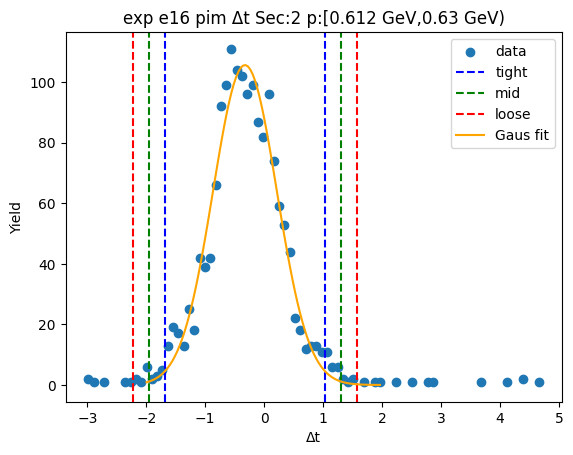

-1.629709276995796 1.0092858984543265
-1.893608794540808 1.2731854159993385
-2.1575083120858203 1.5370849335443508


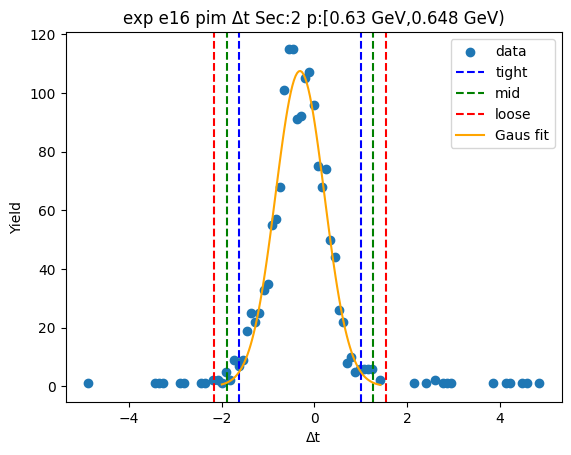

-1.6990685608407397 1.0645714588674693
-1.9754325628115605 1.3409354608382902
-2.2517965647823814 1.617299462809111


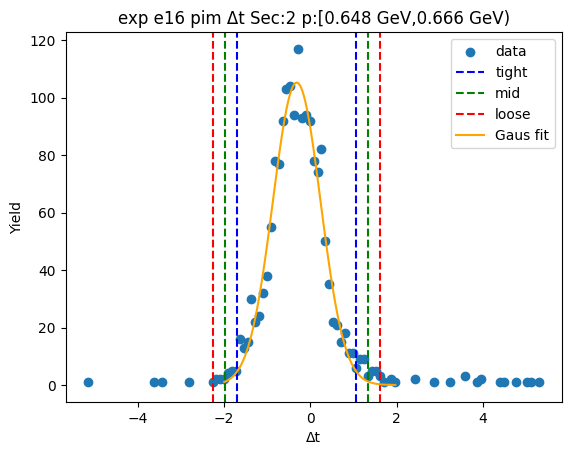

-1.622812380866244 1.01017008246281
-1.8861106271991492 1.2734683287957151
-2.149408873532055 1.5367665751286206


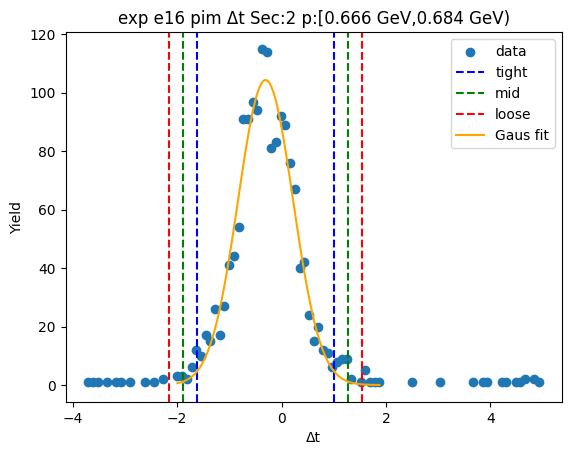

-1.6918189974533544 1.091172297582237
-1.9701181269569137 1.3694714270857964
-2.248417256460473 1.6477705565893557


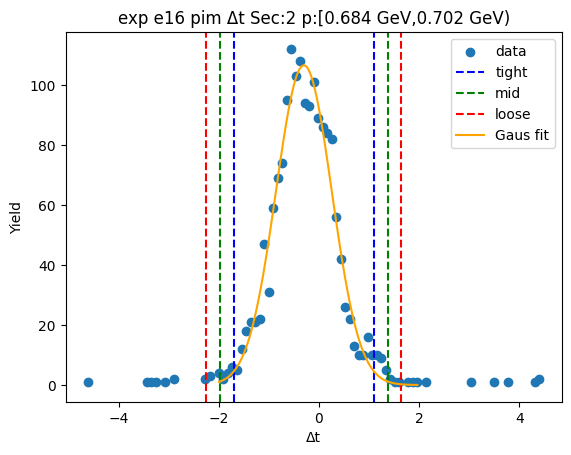

-1.746699137921874 1.1358841124967758
-2.034957462963739 1.424142437538641
-2.323215788005604 1.712400762580506


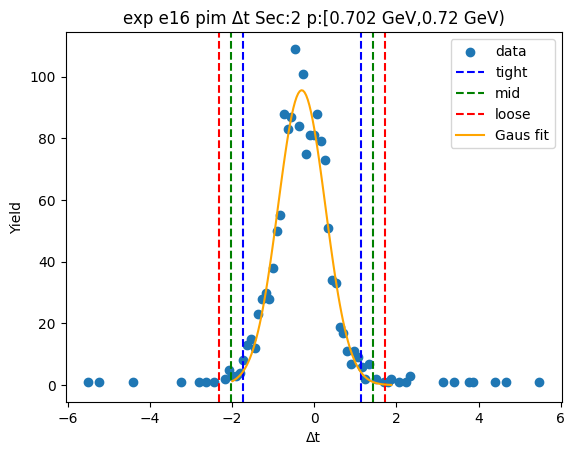

-1.7401901743655324 1.0851328895747367
-2.022722480759559 1.3676651959687638
-2.3052547871535864 1.6501975023627908


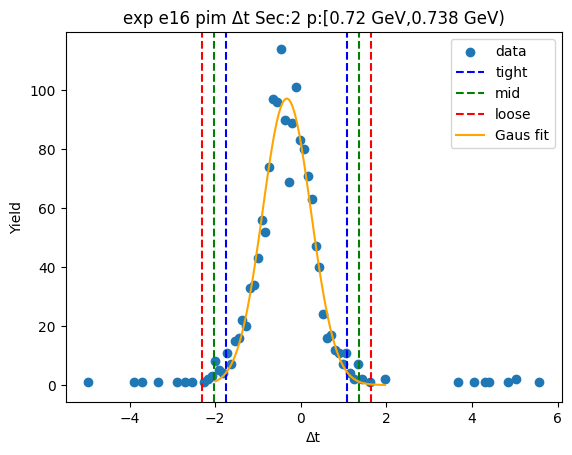

-1.7398734794839592 1.1270667092430344
-2.0265674983566586 1.4137607281157336
-2.3132615172293582 1.7004547469884332


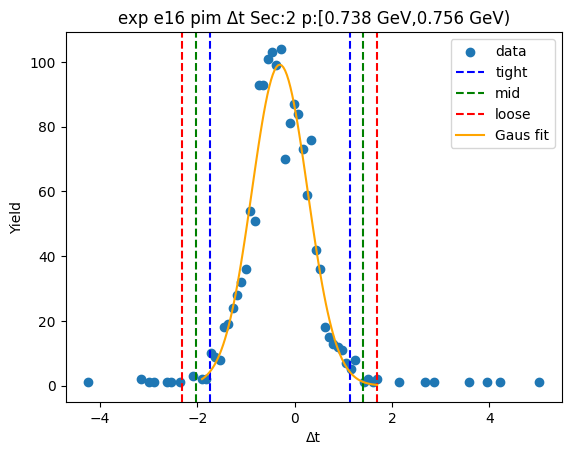

-1.7230300903050826 1.0956457169873035
-2.0048976710343216 1.3775132977165423
-2.28676525176356 1.6593808784457809


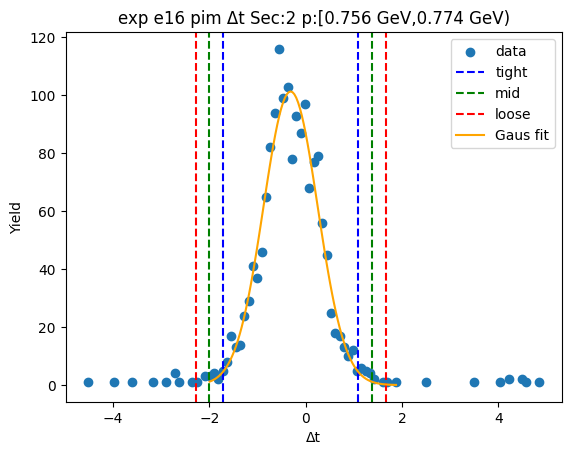

-1.6503048247459855 1.0414044977832955
-1.9194757569989136 1.3105754300362236
-2.1886466892518417 1.5797463622891517


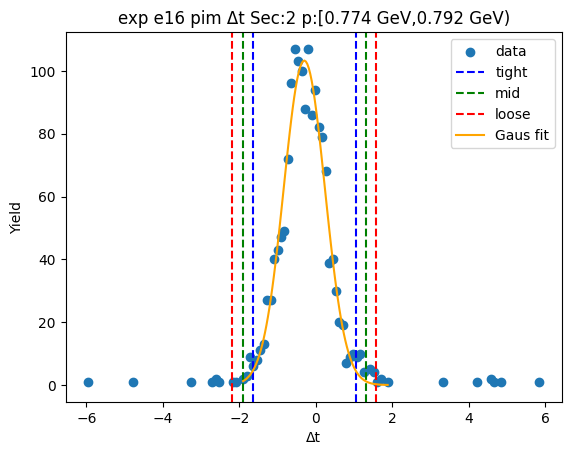

-1.667471624981922 1.0879133987416714
-1.9430101273542812 1.3634519011140307
-2.218548629726641 1.63899040348639


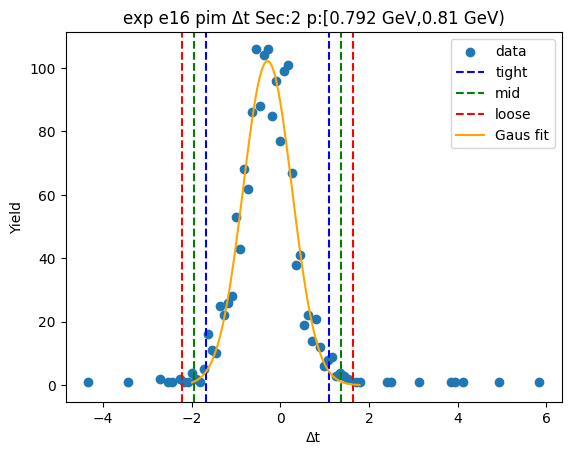

-1.7274610492337281 1.1431901047097757
-2.0145261646280783 1.4302552201041259
-2.301591280022429 1.7173203354984765


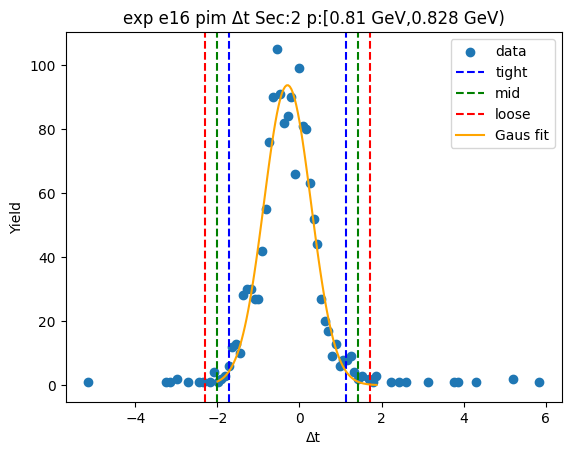

-1.6586296957129074 1.0170489403216691
-1.926197559316365 1.2846168039251267
-2.1937654229198222 1.5521846675285842


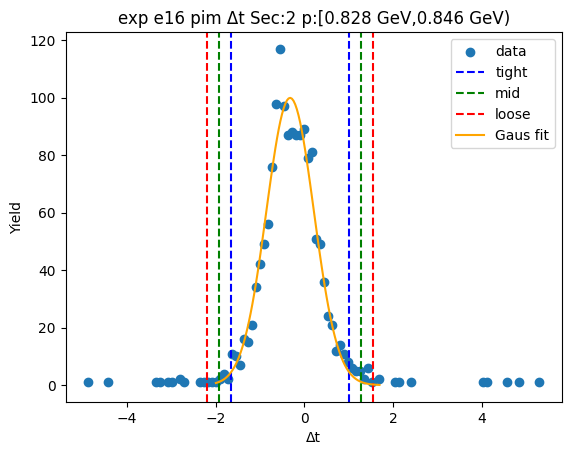

-1.7088688267330805 1.1033042189954116
-1.9900861313059295 1.384521523568261
-2.271303435878779 1.66573882814111


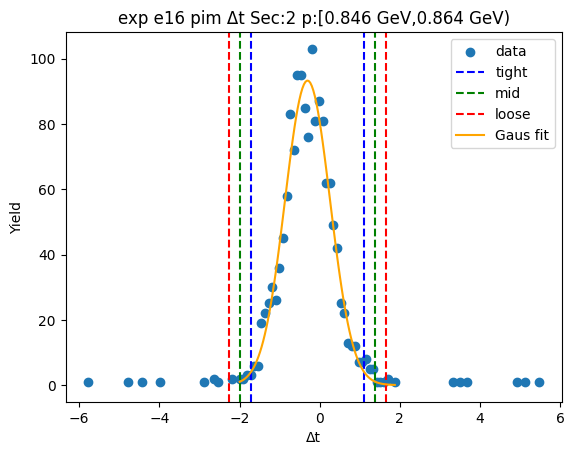

-1.6958084913984994 1.110438145701042
-1.9764331551084537 1.3910628094109962
-2.257057818818408 1.6716874731209503


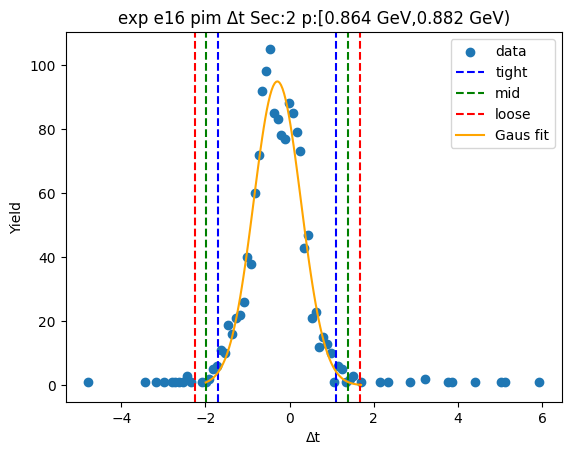

-1.6935465456657712 1.0751601488725417
-1.9704172151196027 1.3520308183263732
-2.247287884573434 1.6289014877802046


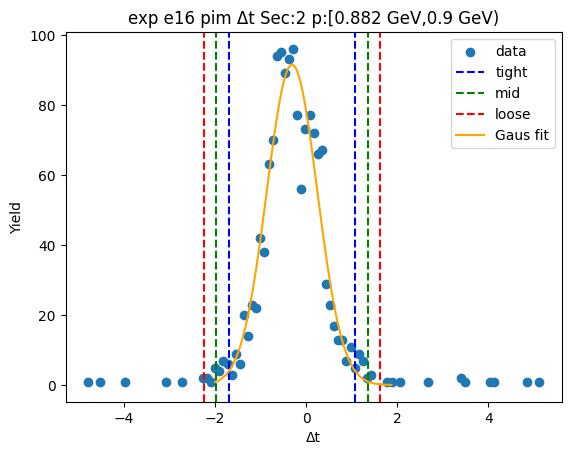

-1.7499342656232935 1.1426711164494832
-2.039194803830571 1.4319316546567606
-2.3284553420378487 1.7211921928640386


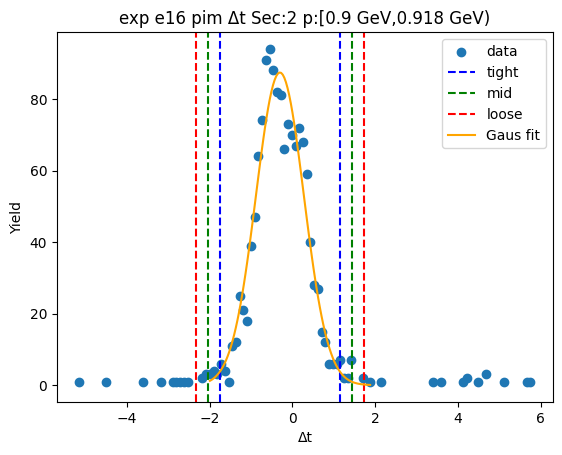

-1.6504419099403715 1.0173236187701893
-1.9172184628114275 1.2841001716412452
-2.183995015682483 1.5508767245123012


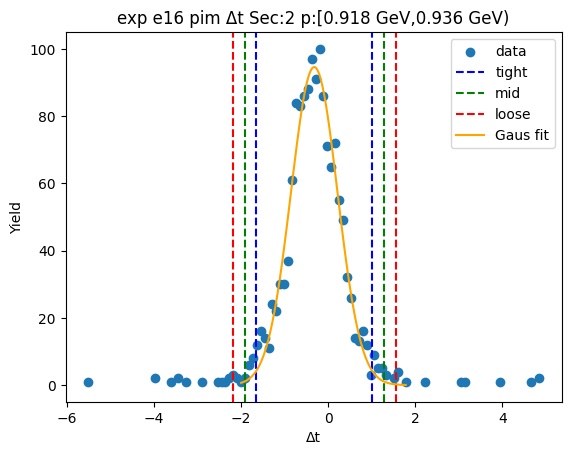

-1.6424647190977049 1.0163289121704895
-1.9083440822245241 1.2822082752973087
-2.174223445351344 1.548087638424128


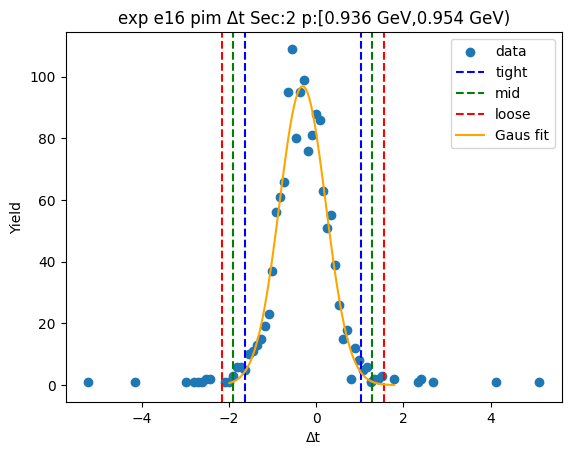

-1.7437866916579305 1.111604442920962
-2.02932580511582 1.3971435563788508
-2.314864918573709 1.68268266983674


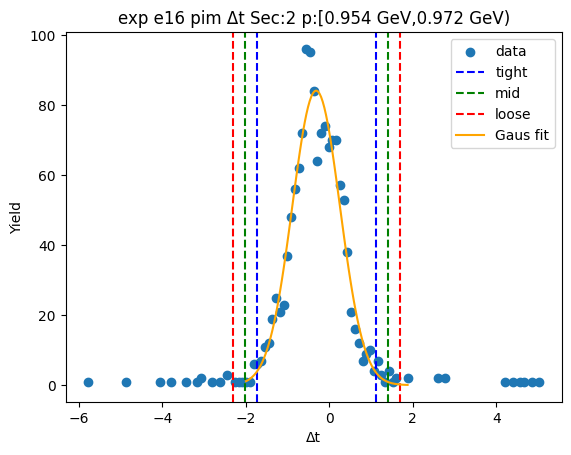

-1.7177082161154946 1.0948739724086793
-1.9989664349679122 1.3761321912610969
-2.28022465382033 1.6573904101135144


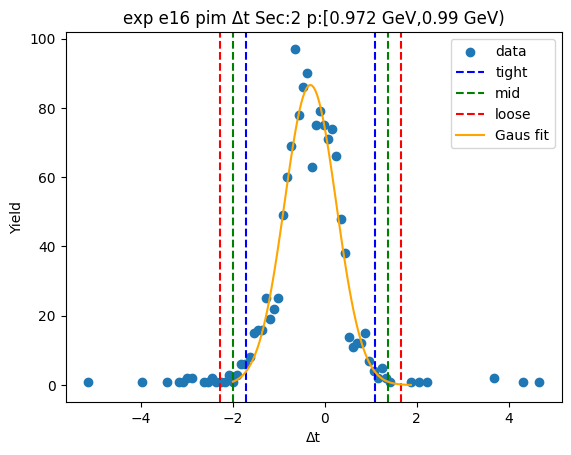

-1.6535698136760528 1.0437680869750983
-1.923303603741168 1.3135018770402134
-2.193037393806283 1.5832356671053285


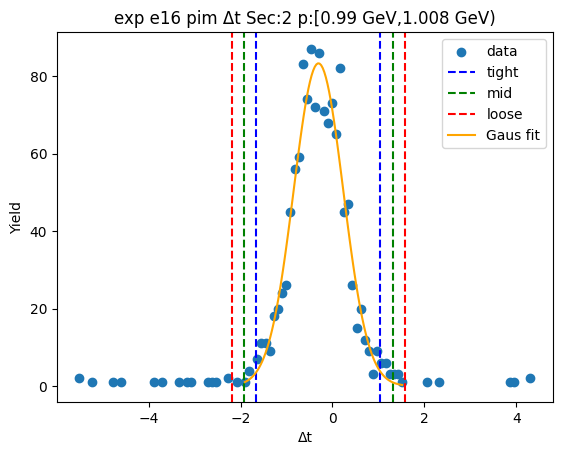

-1.6901660872424251 1.1198238206424749
-1.9711650780309151 1.4008228114309649
-2.252164068819405 1.6818218022194549


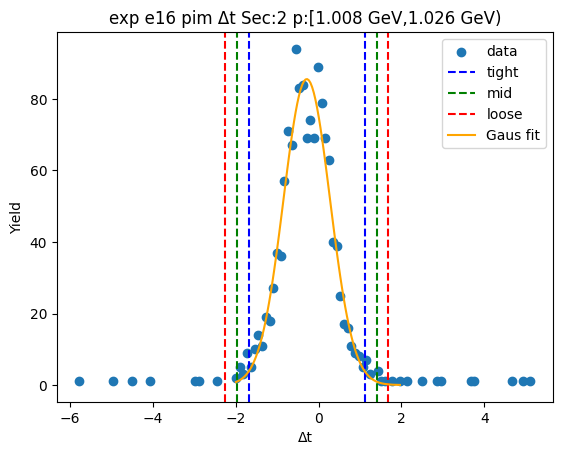

-1.6739006295681271 1.1145259083975465
-1.9527432833646943 1.393368562194114
-2.231585937161262 1.6722112159906812


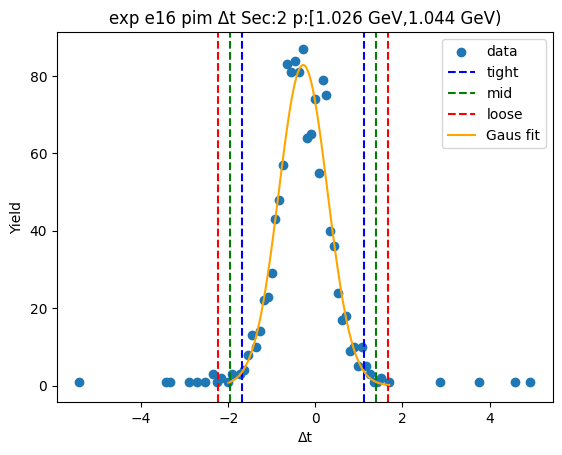

-1.759270647232857 1.1243897122947941
-2.047636683185622 1.4127557482475592
-2.336002719138387 1.7011217842003243


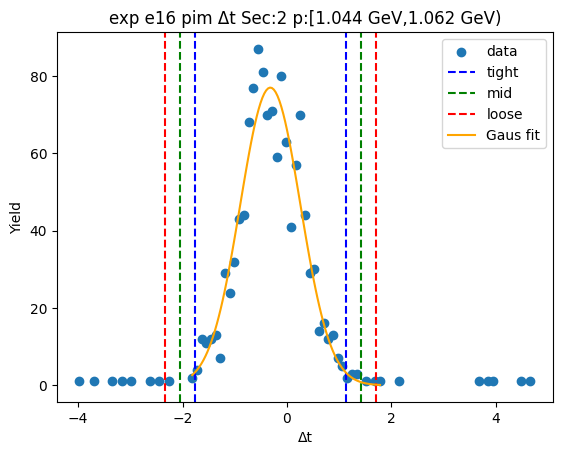

-1.6947031458853328 1.1530839675722069
-1.9794818572310866 1.4378626789179607
-2.2642605685768404 1.7226413902637145


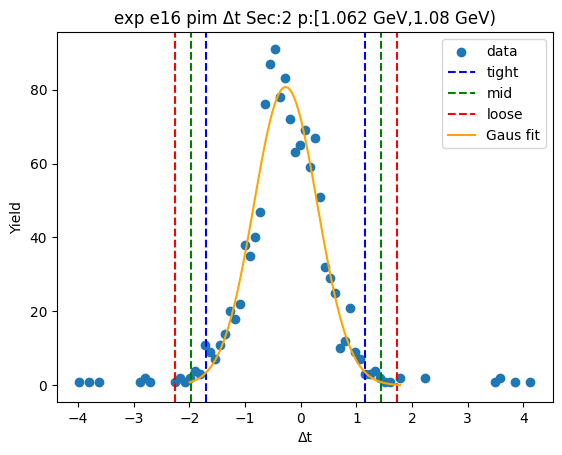

-1.7555182953494406 1.1687197511105591
-2.0479420999954407 1.4611435557565593
-2.3403659046414407 1.7535673604025592


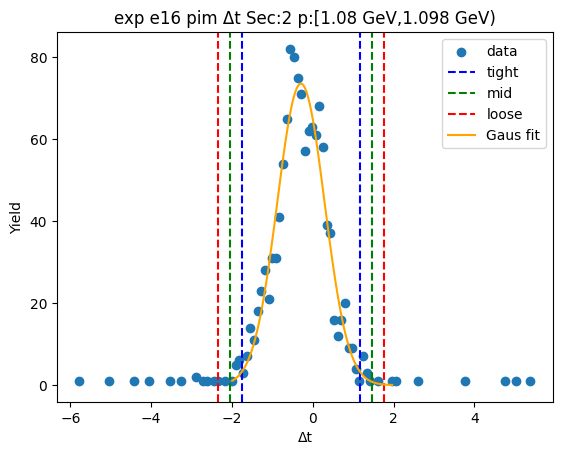

-1.6801711707033085 1.062181514746352
-1.9544064392482745 1.336416783291318
-2.2286417077932406 1.6106520518362841


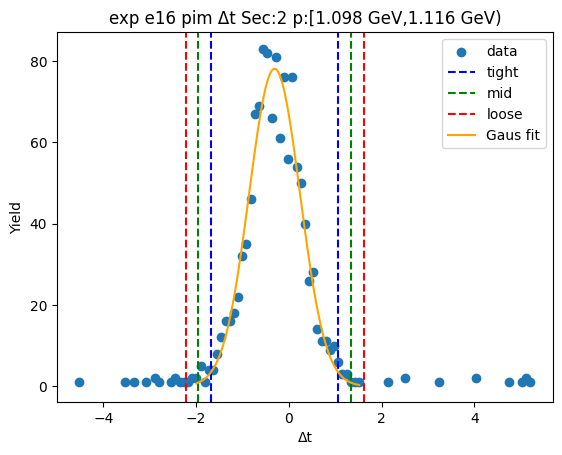

-1.682650376924002 1.0846831936871548
-1.9593837339851177 1.3614165507482705
-2.2361170910462334 1.6381499078093862


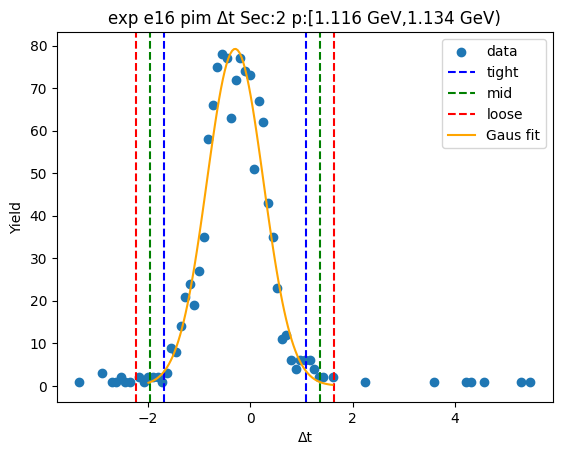

-1.7096743171339077 1.0844059535291755
-1.9890823442002157 1.3638139805954839
-2.268490371266524 1.6432220076617918


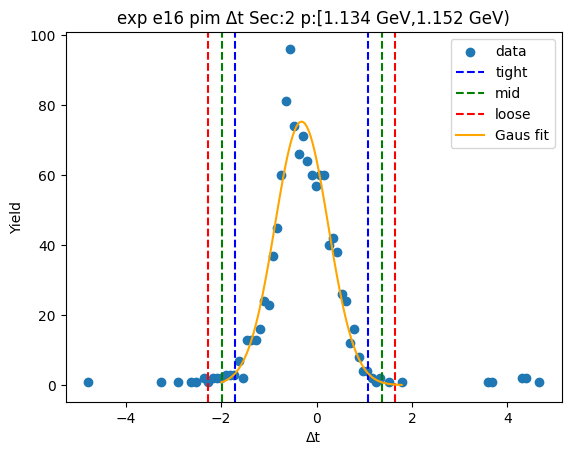

-1.702720036454793 1.1371031844250583
-1.986702358542778 1.4210855065130434
-2.2706846806307635 1.7050678286010286


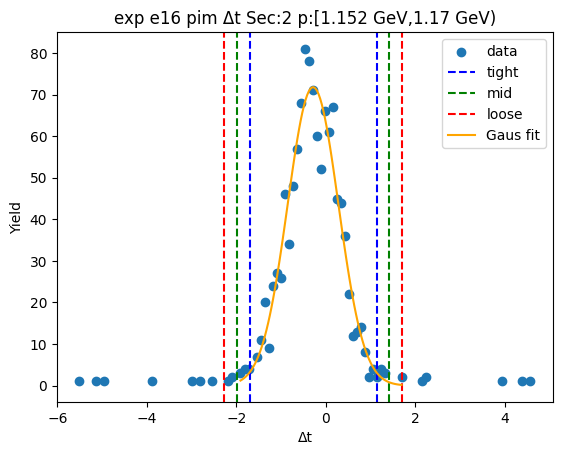

-1.6855487712901465 1.100365368236637
-1.9641401852428246 1.3789567821893152
-2.242731599195503 1.6575481961419936


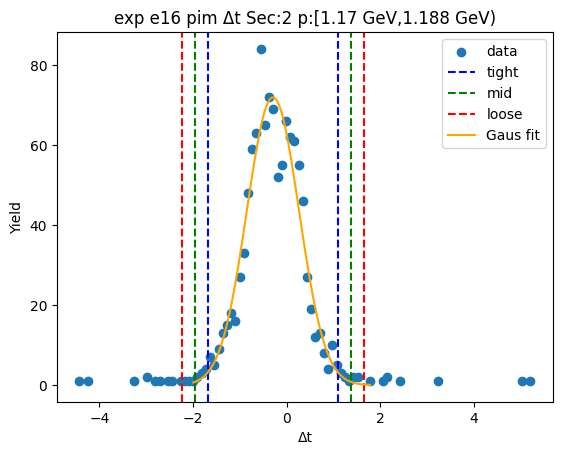

-1.682673560459489 1.0665084780154381
-1.9575917643069818 1.341426681862931
-2.2325099681544742 1.6163448857104237


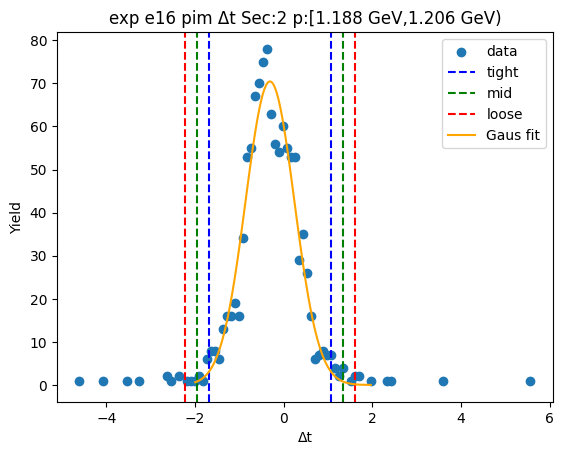

-1.6774917799045506 1.0734042962603998
-1.9525813875210456 1.3484939038768948
-2.2276709951375406 1.6235835114933899


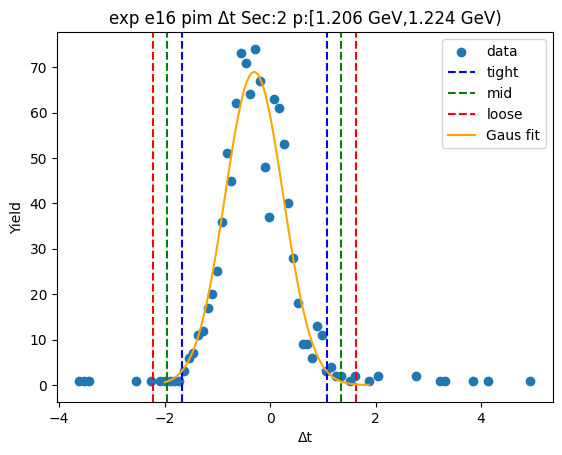

-1.6764659187394035 1.1596237111761534
-1.960074881730959 1.4432326741677093
-2.243683844722515 1.7268416371592648


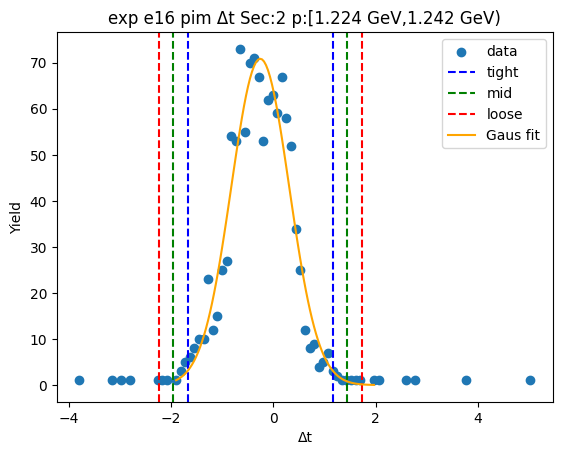

-1.6134917801937378 1.040463503117853
-1.878887308524897 1.3058590314490122
-2.144282836856056 1.5712545597801713


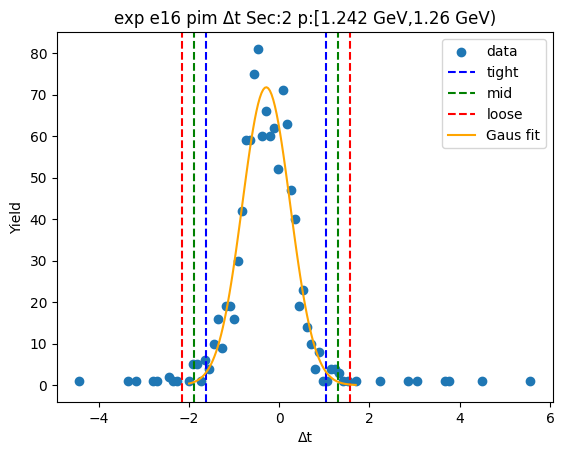

-1.6765711817320579 1.0798440694602829
-1.9522127068512918 1.3554855945795168
-2.227854231970526 1.631127119698751


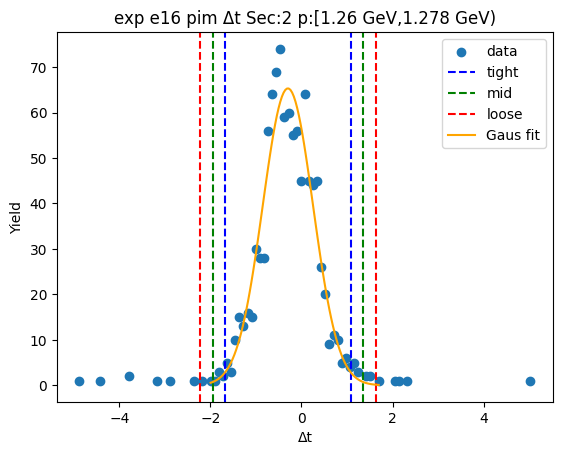

-1.6367116860092774 1.000216751434159
-1.9004045297536212 1.2639095951785027
-2.164097373497965 1.5276024389228464


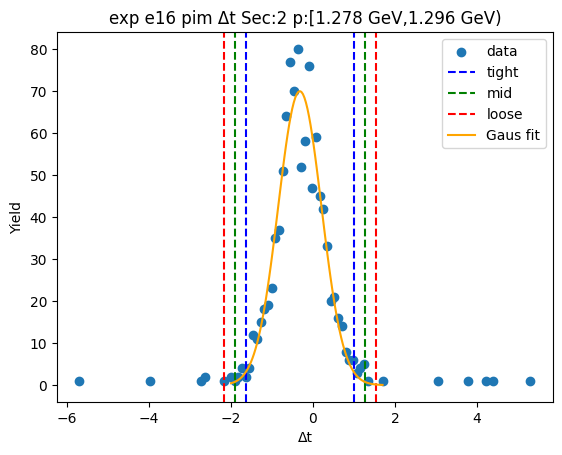

-1.6265545325379829 0.997701970280098
-1.888980182819791 1.260127620561906
-2.151405833101599 1.5225532708437142


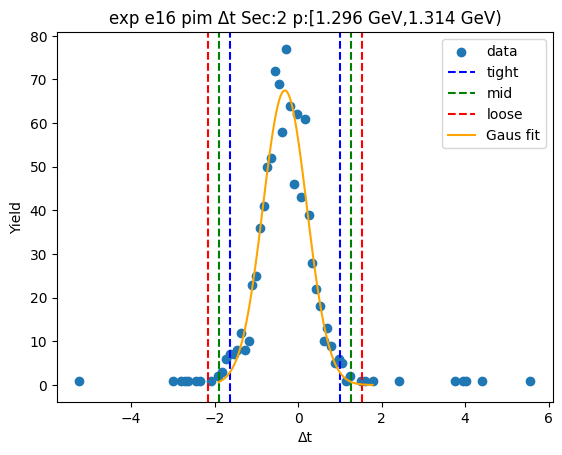

-1.5934760202032825 0.981415881493318
-1.8509652103729424 1.238905071662978
-2.1084544005426027 1.496394261832638


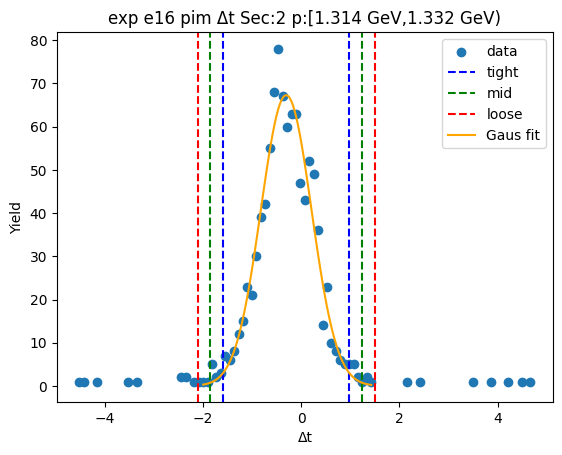

-1.7083159716197016 1.0739739577711231
-1.9865449645587843 1.3522029507102058
-2.2647739574978667 1.6304319436492882


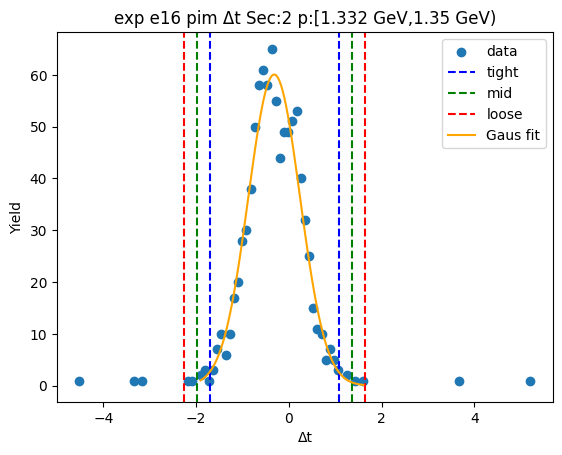

-1.6056711505141201 0.9852921607754179
-1.864767481643074 1.2443884919043717
-2.1238638127720275 1.5034848230333255


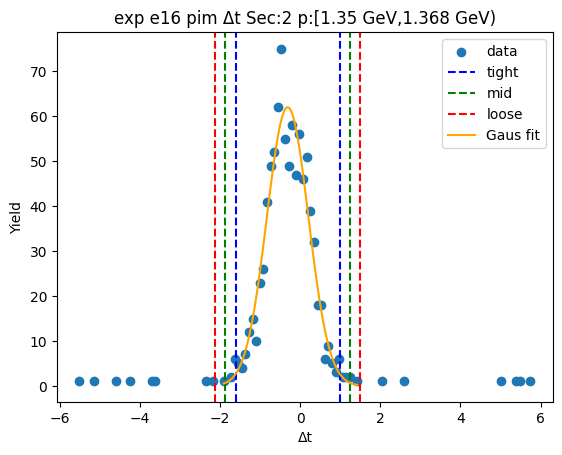

-1.6572230293806038 1.018163395465923
-1.9247616718652565 1.2857020379505761
-2.192300314349909 1.5532406804352288


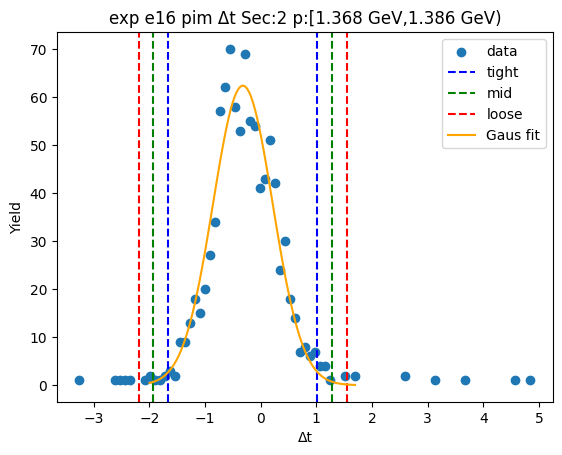

-1.6999452132976387 1.1501350963607946
-1.9849532442634819 1.4351431273266377
-2.269961275229325 1.7201511582924813


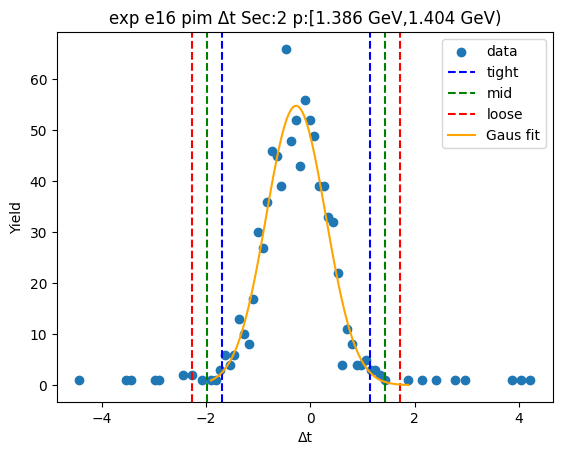

-1.5902870476538369 1.0721383346698166
-1.856529585886202 1.3383808729021818
-2.1227721241185673 1.604623411134547


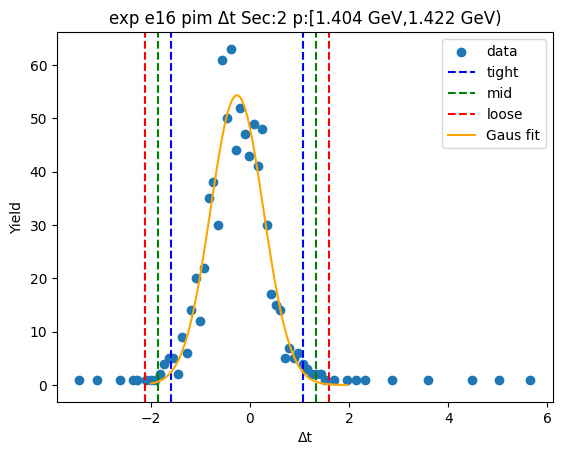

-1.7940805939802404 1.1726124631080694
-2.0907498996890714 1.4692817688169004
-2.387419205397902 1.7659510745257312


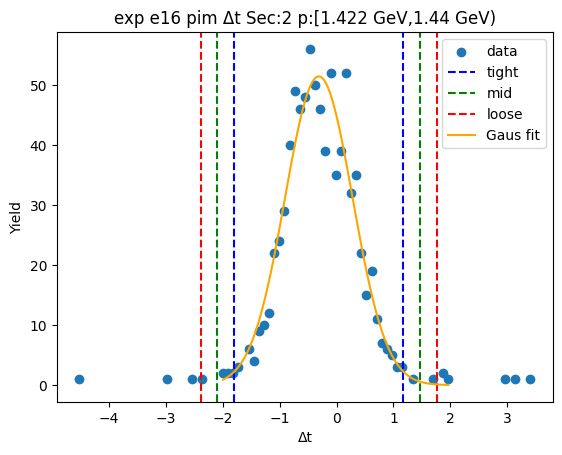

-1.6441785020711466 1.0585734621149667
-1.9144536984897578 1.328848658533578
-2.184728894908369 1.5991238549521891


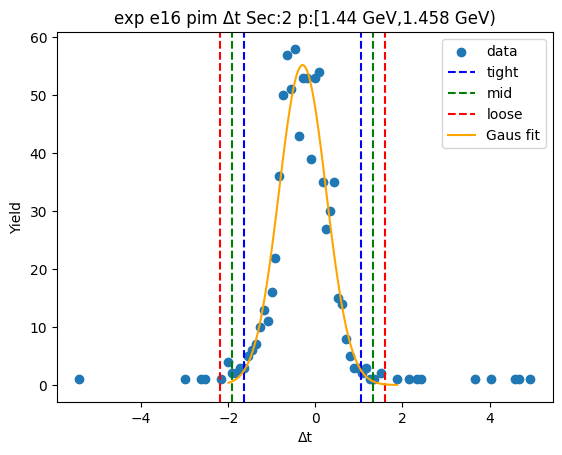

-1.6518379236906569 1.1037780456508601
-1.9273995206248087 1.379339642585012
-2.2029611175589605 1.6549012395191638


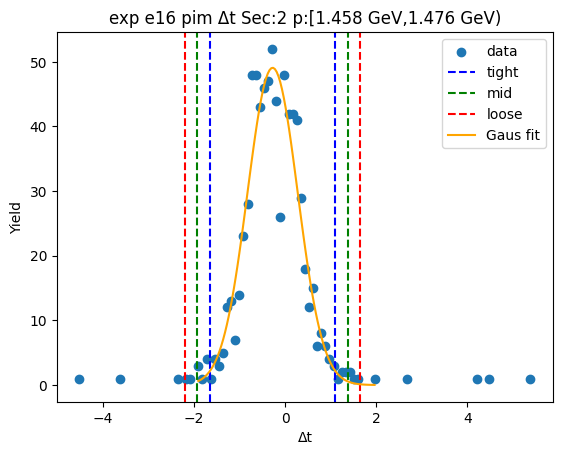

-1.5869050310617654 1.0307172869322931
-1.8486672628611713 1.2924795187316986
-2.110429494660577 1.5542417505311046


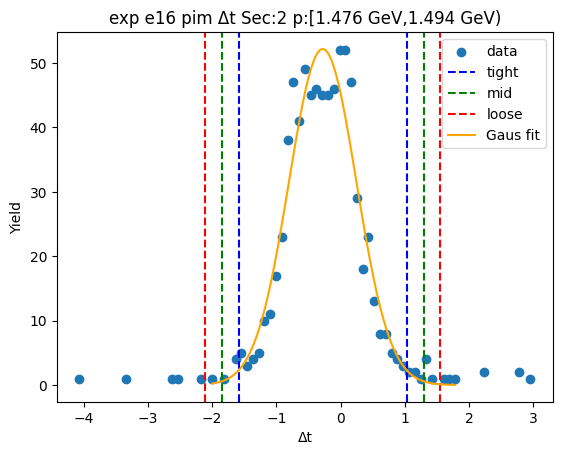

-1.7096721076854604 1.1223265224289163
-1.9928719706968985 1.405526385440354
-2.276071833708336 1.6887262484517915


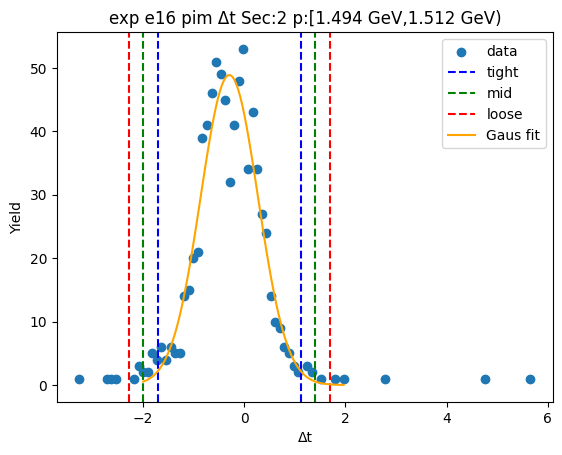

-1.7379860623621073 1.1882063460313237
-2.03060530320145 1.4808255868706668
-2.323224544040793 1.7734448277100097


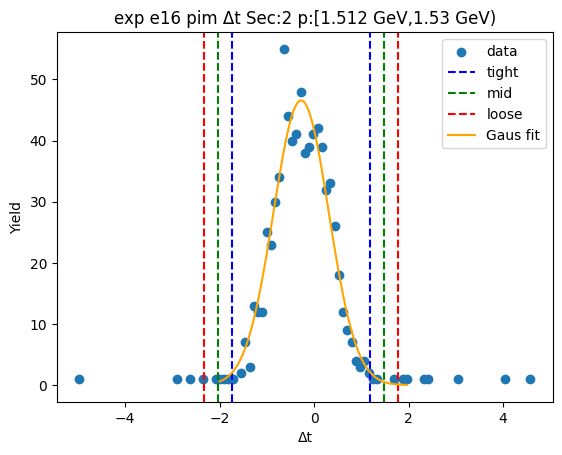

-1.6358573533637946 1.1201617891592195
-1.911459267616096 1.395763703411521
-2.1870611818683976 1.6713656176638223


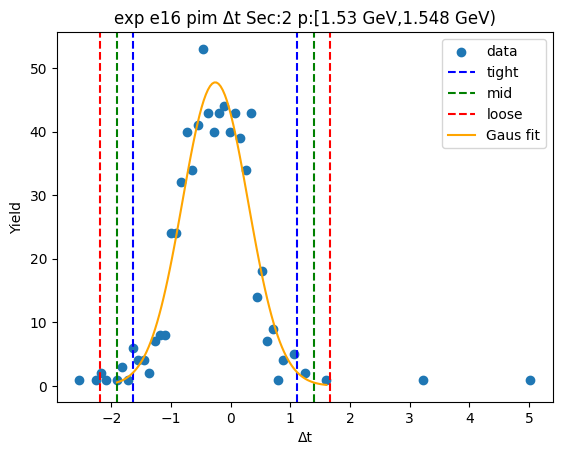

-1.610295296700214 1.0708961188002228
-1.8784144382502577 1.3390152603502665
-2.1465335798003014 1.6071344019003102


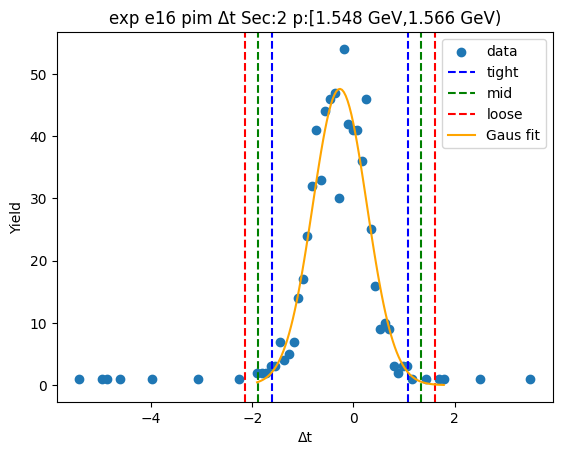

-1.5219303592536741 0.9947535767583141
-1.7735987528548733 1.246421970359513
-2.025267146456072 1.4980903639607122


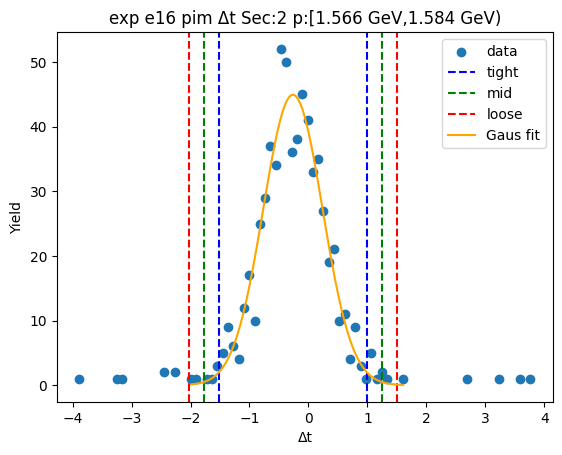

-1.6045063242991555 1.1733506046240259
-1.8822920171914737 1.451136297516344
-2.1600777100837916 1.7289219904086621


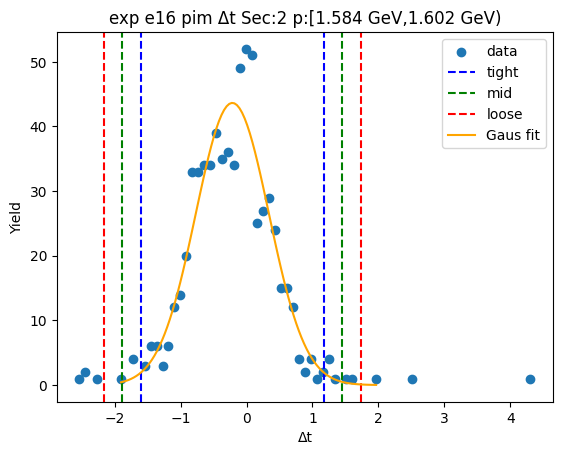

-1.560972036574093 1.0334814654871967
-1.820417386780222 1.2929268156933258
-2.079862736986351 1.5523721658994547


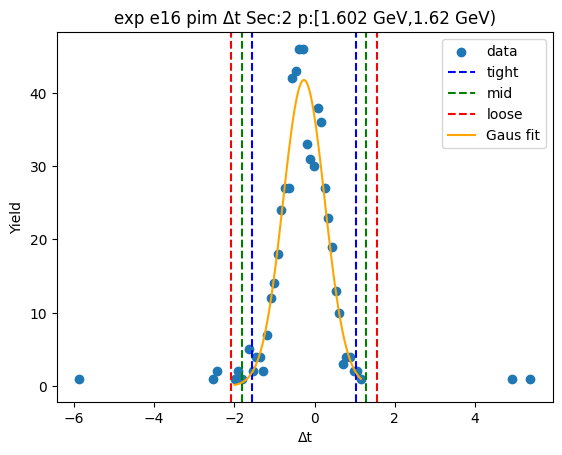

-1.6743000705589837 1.1179672167593298
-1.9535267992908154 1.397193945491161
-2.2327535280226467 1.6764206742229923


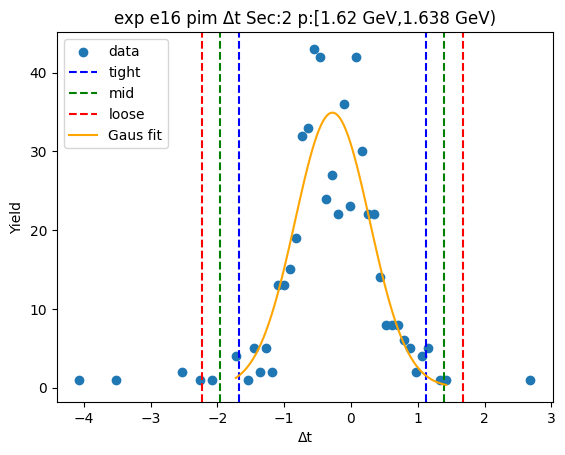

-1.565931556423475 1.035888728782495
-1.8261135849440722 1.296070757303092
-2.086295613464669 1.5562527858236892


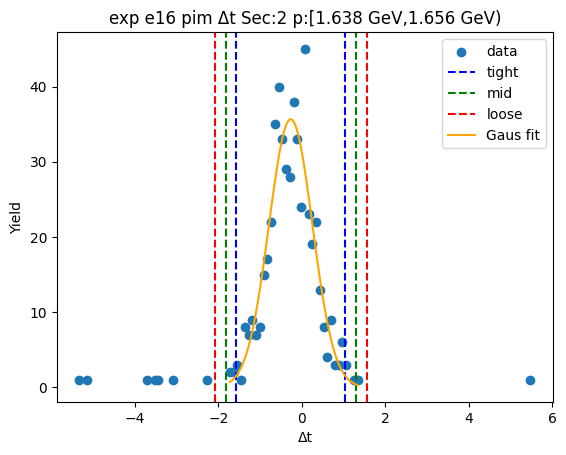

-1.5880708150042921 1.0533819531307107
-1.8522160918177923 1.3175272299442113
-2.116361368631293 1.5816725067577115


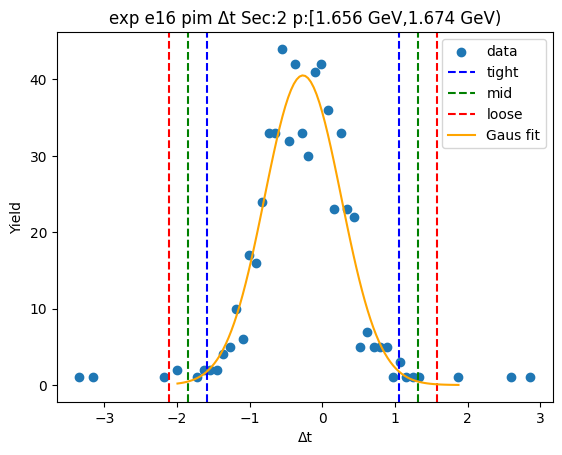

-1.5234740644254636 0.9945995303755437
-1.7752814239055645 1.2464068898556446
-2.0270887833856652 1.4982142493357453


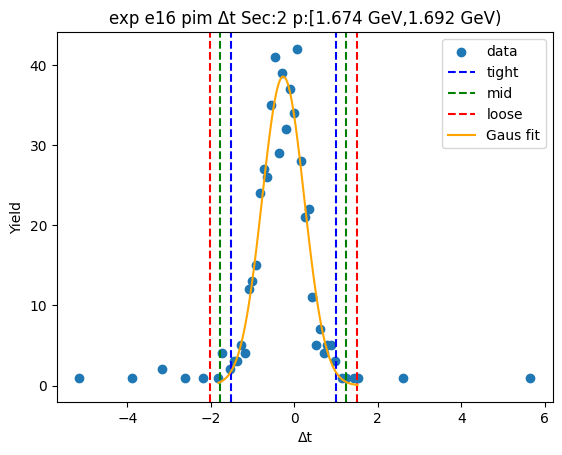

-1.636159668725887 1.1485281082386962
-1.9146284464223455 1.4269968859351547
-2.193097224118804 1.705465663631613


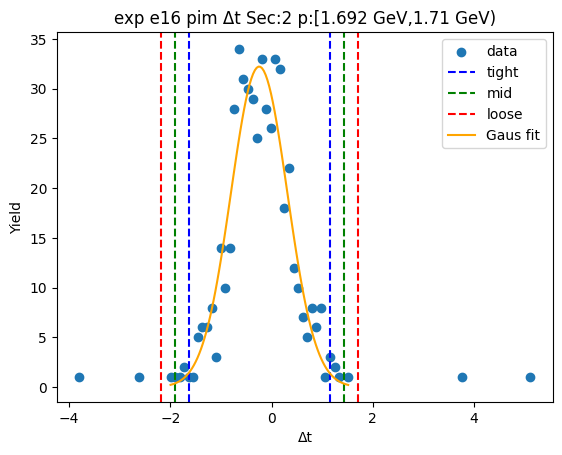

-1.533358762258652 1.0719076010693054
-1.7938853985914476 1.332434237402101
-2.054412034924243 1.5929608737348966


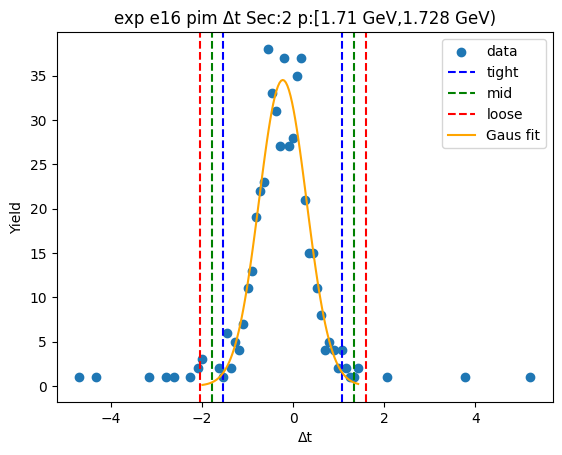

-1.51439398484576 0.9570505011259283
-1.761538433442929 1.2041949497230973
-2.0086828820400977 1.451339398320266


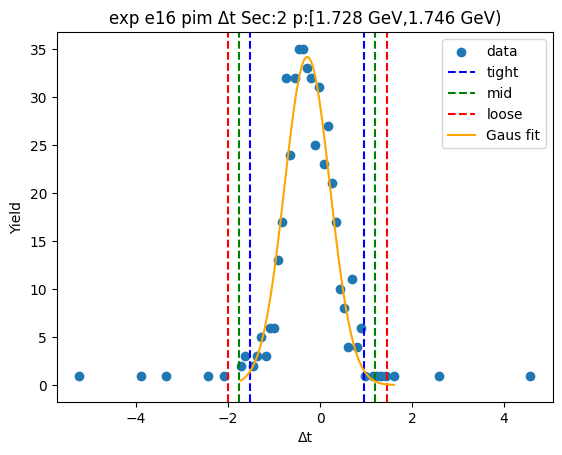

-1.6349799170797 1.0853428928618885
-1.9070121980738586 1.3573751738560471
-2.1790444790680175 1.629407454850206


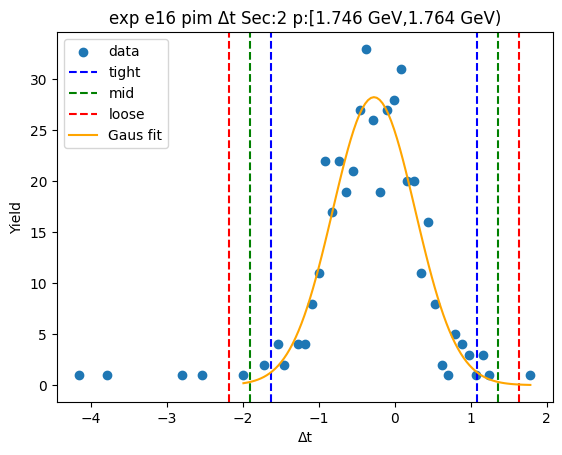

-1.568985668077004 1.03881938462158
-1.8297661733468624 1.2995998898914385
-2.090546678616721 1.560380395161297


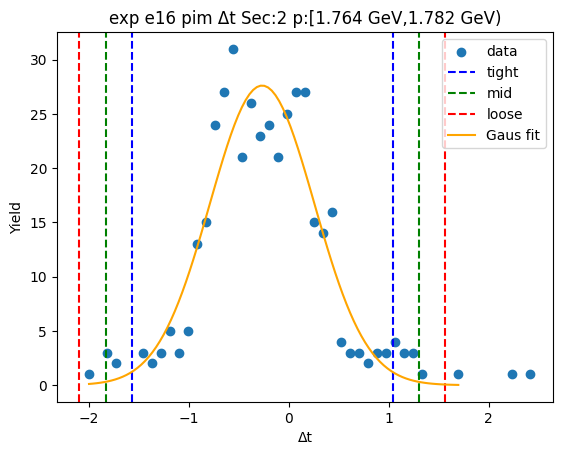

-1.5626663941804309 1.0604409287052972
-1.8249771264690038 1.32275166099387
-2.087287858757577 1.585062393282443


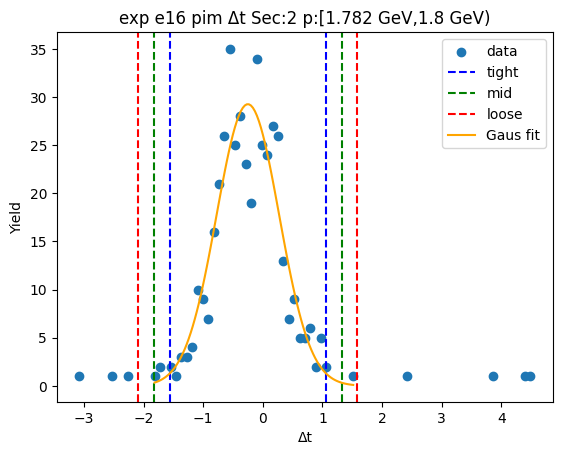

-1.5703974445857536 1.1571514870322994
-1.8431523377475587 1.4299063801941045
-2.115907230909364 1.7026612733559099


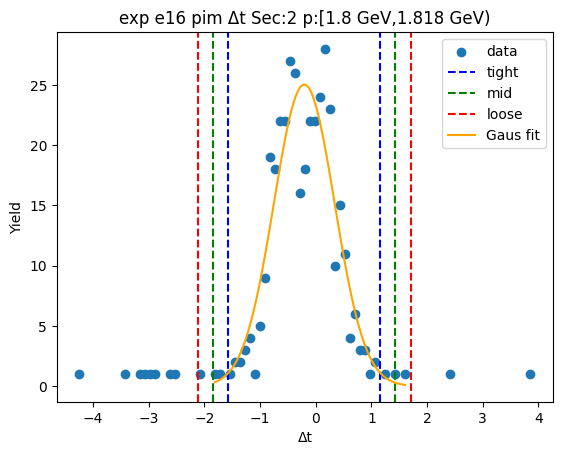

-1.5917915044725388 1.0599948598079234
-1.8569701409005852 1.3251734962359698
-2.1221487773286314 1.590352132664016


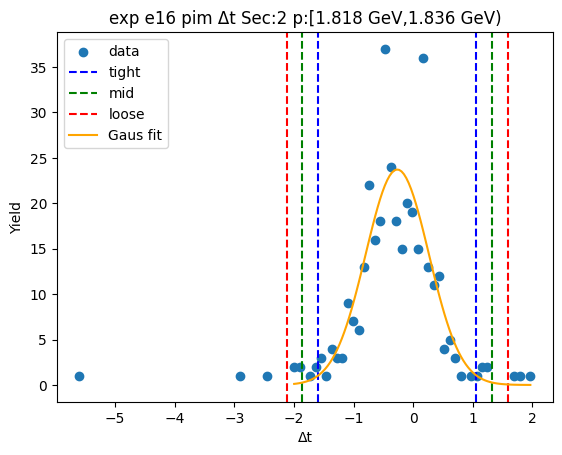

-1.5498576949280911 1.1512717604695595
-1.8199706404678562 1.4213847060093245
-2.0900835860076215 1.6914976515490896


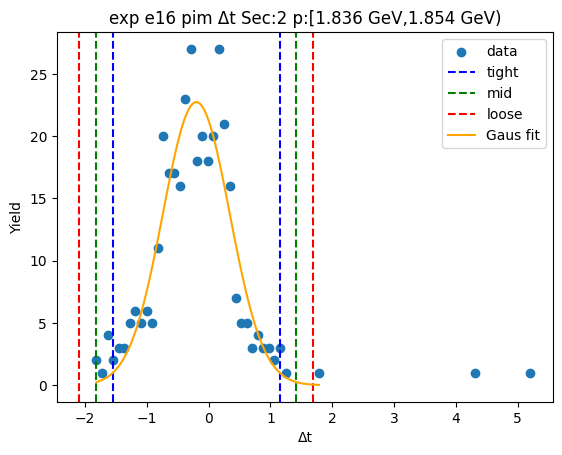

-1.4744041622541793 1.0390344978751709
-1.7257480282671143 1.290378363888106
-1.9770918942800493 1.541722229901041


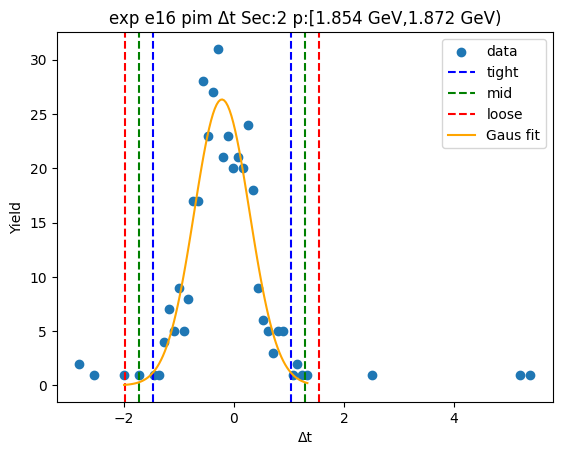

-1.5116407945631876 1.1006408299245534
-1.7728689570119618 1.3618689923733276
-2.034097119460736 1.6230971548221018


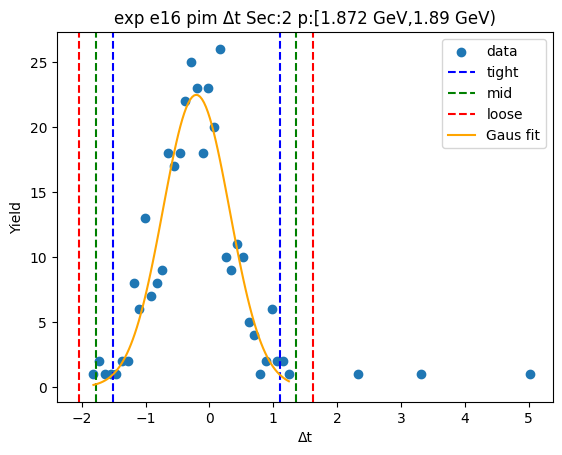

-1.5092053240794272 0.9966018354452693
-1.759786040031897 1.247182551397739
-2.010366755984367 1.4977632673502088


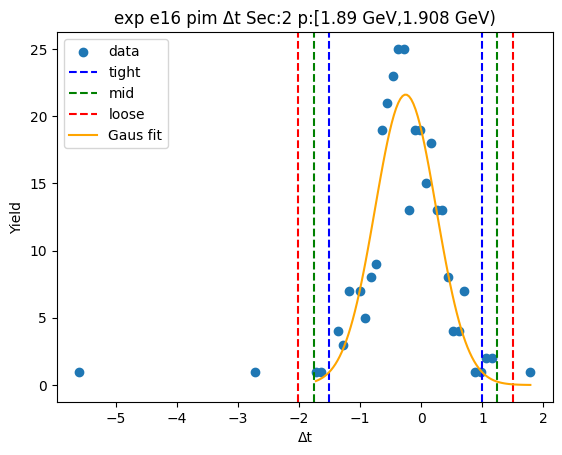

-1.703390806798995 1.3033018021434422
-2.0040600676932385 1.603971063037686
-2.3047293285874826 1.9046403239319298


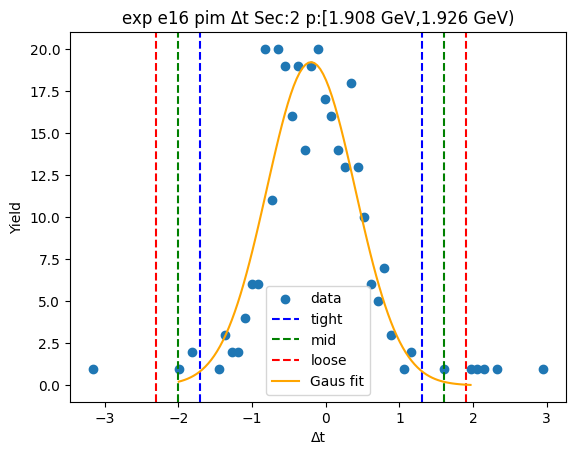

-1.5165795022803197 1.099615457170437
-1.7781989982253952 1.3612349531155126
-2.039818494170471 1.6228544490605883


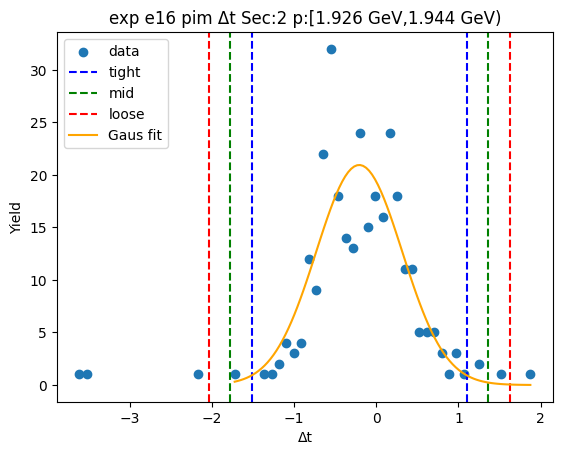

-1.431871344410986 0.9179940633634143
-1.6668578851884261 1.1529806041408543
-1.9018444259658662 1.3879671449182944


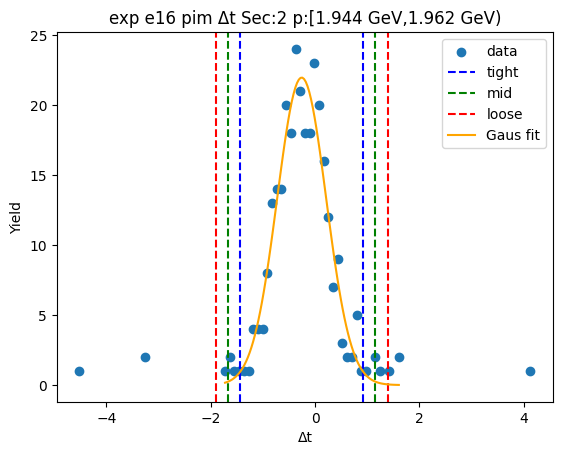

-1.4553654566290228 1.0858742549631961
-1.7094894277882449 1.3399982261224181
-1.963613398947467 1.5941221972816402


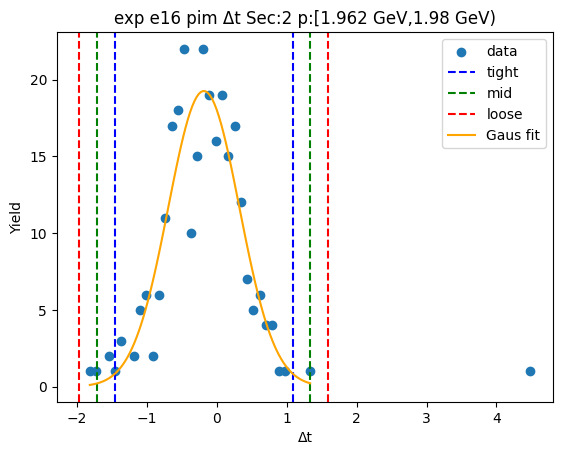

-1.4566325097168045 1.0759540687982898
-1.7098911675683137 1.329212726649799
-1.9631498254198232 1.5824713845013085


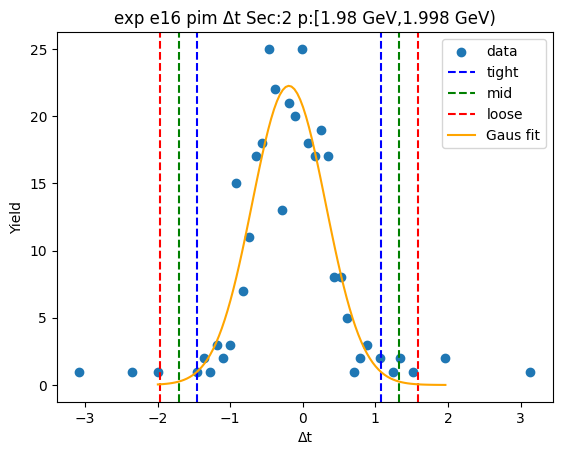

-1.6028829922363297 1.0713291836340995
-1.8703042098233724 1.3387504012211422
-2.137725427410415 1.6061716188081852


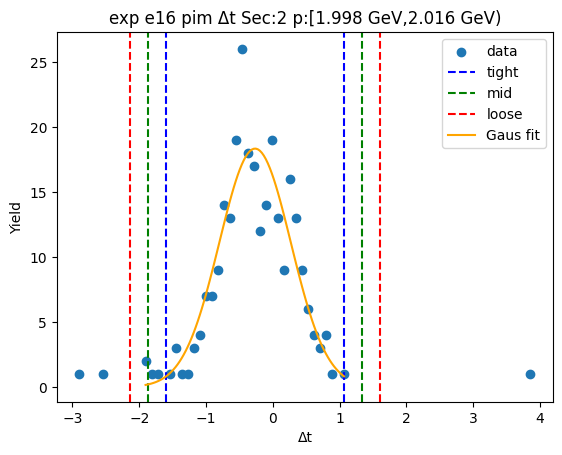

-1.384789768690275 0.9435528171552677
-1.6176240272748292 1.176387075739822
-1.8504582858593837 1.4092213343243765


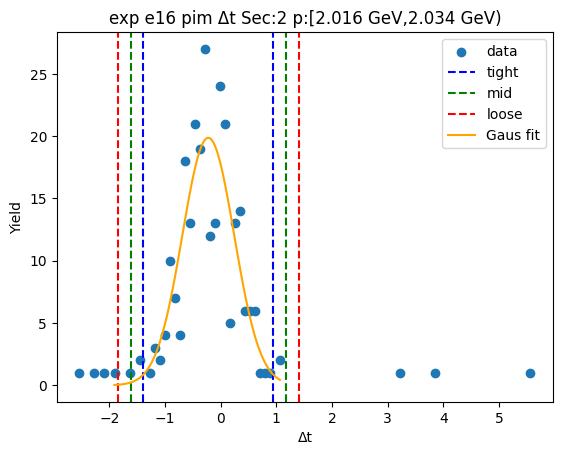

-1.7196570328878618 1.376695691787223
-2.02929230535537 1.6863309642547317
-2.3389275778228784 1.99596623672224


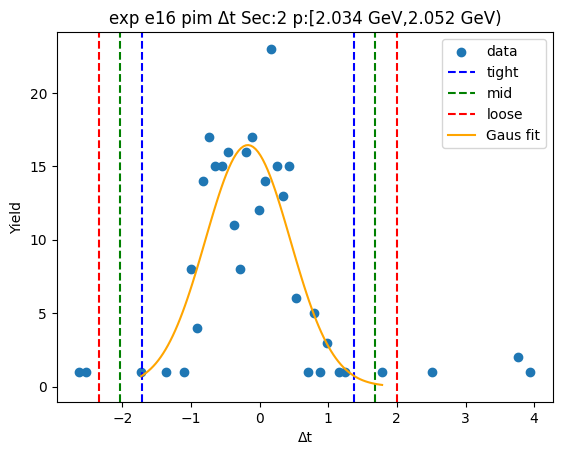

-1.7152403257295858 1.2898920440907726
-2.015753562711622 1.5904052810728087
-2.3162667996936577 1.8909185180548445


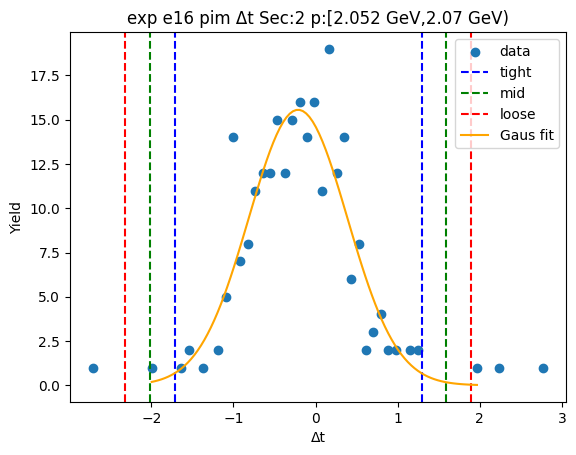

-1.5979894630718994 1.1830112678138776
-1.8760895361604772 1.4611113409024554
-2.154189609249055 1.739211413991033


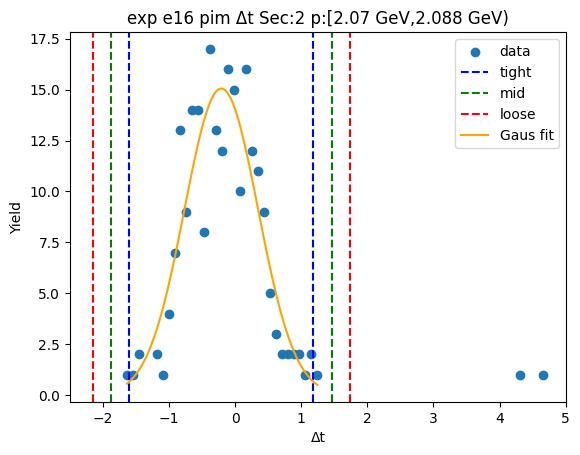

-1.2809394174501412 0.8204578180828896
-1.491079141003444 1.0305975416361925
-1.7012188645567472 1.2407372651894957


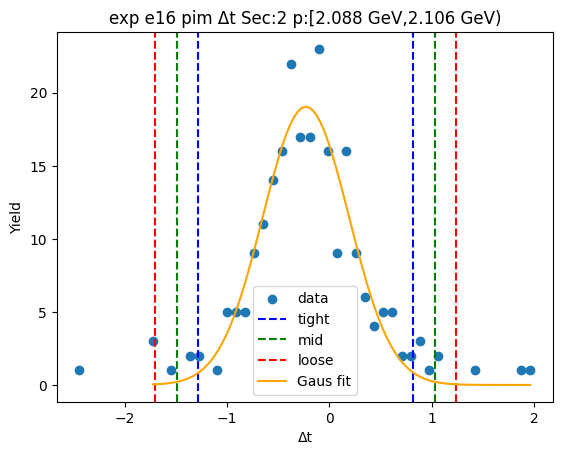

-1.6434363684056945 1.1952386335642047
-1.9273038686026844 1.4791061337611946
-2.2111713687996746 1.7629736339581845


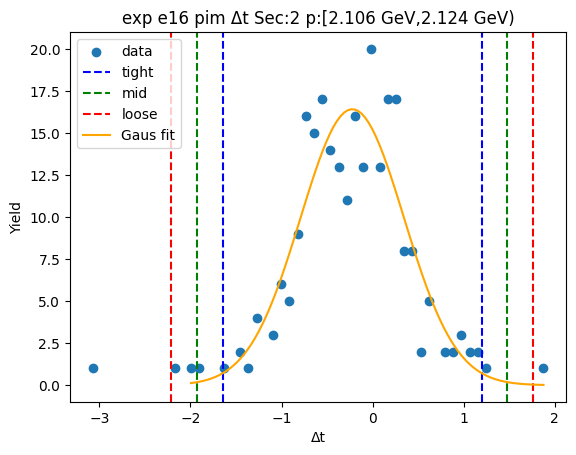

-1.4518366175813737 1.0844036973276658
-1.7054606490722777 1.3380277288185698
-1.9590846805631816 1.5916517603094738


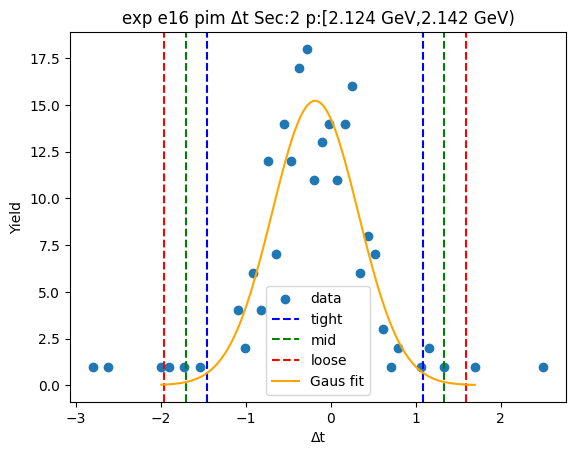

-1.493909820527896 1.0138273152267165
-1.744683534103357 1.2646010288021776
-1.9954572476788184 1.515374742377639


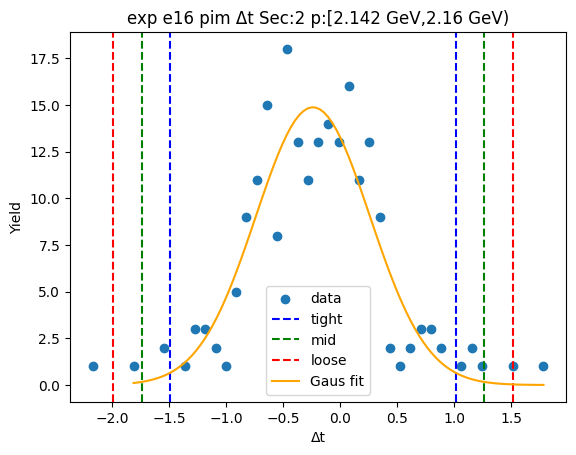

-1.696449970142706 1.1677687599214188
-1.9828718431491184 1.4541906329278311
-2.269293716155531 1.7406125059342439


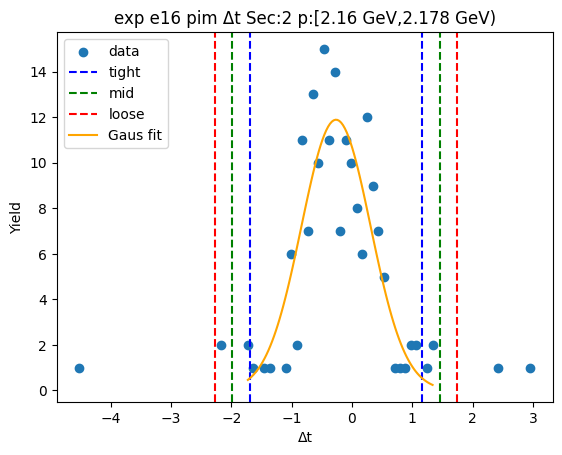

-1.467481715951193 1.0058579795518006
-1.7148156855014924 1.2531919491021
-1.9621496550517918 1.5005259186523994


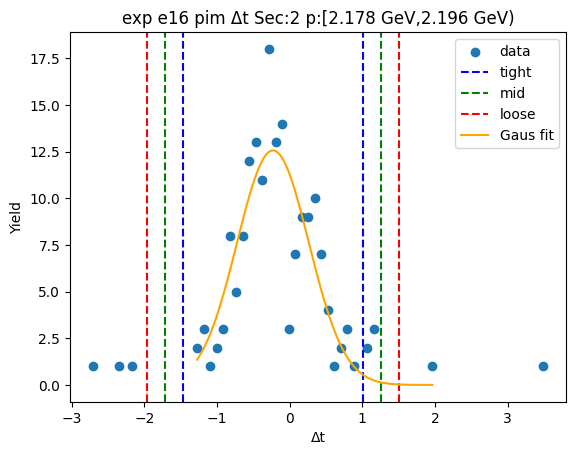

-1.4544275387880943 1.1292368142856197
-1.7127939740954659 1.3876032495929913
-1.9711604094028372 1.6459696849003627


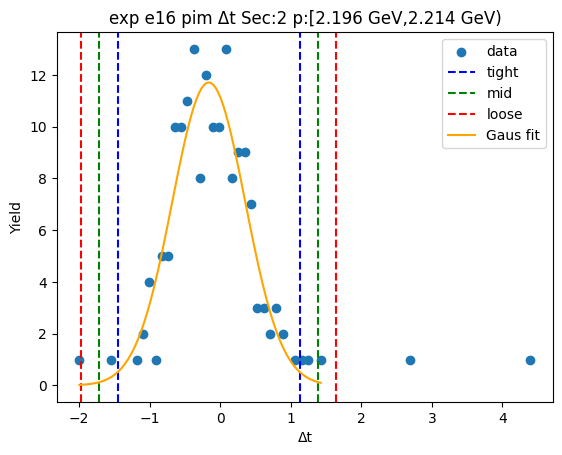

-1.572961027387621 1.061203997092532
-1.836377529835636 1.3246204995405475
-2.0997940322836515 1.5880370019885626


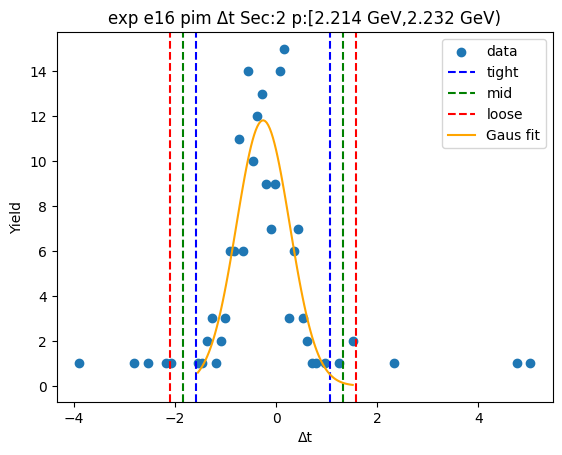

-1.5584998821508167 1.0817355369840205
-1.8225234240643002 1.345759078897504
-2.086546965977784 1.6097826208109878


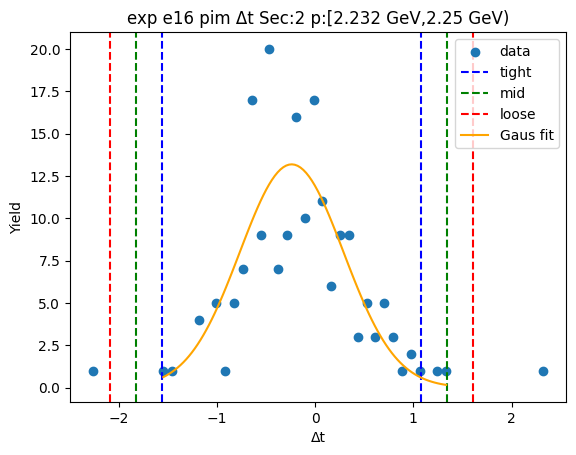

-1.5302957425316939 1.1025304552712256
-1.7935783623119856 1.3658130750515174
-2.0568609820922776 1.6290956948318094


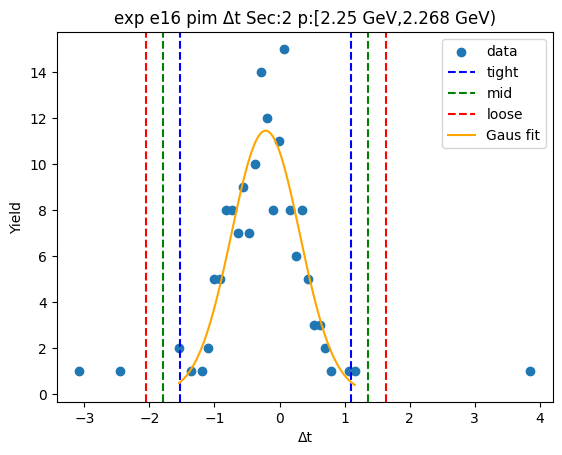

-1.3210811353009357 1.0200554687196997
-1.5551947957029992 1.2541691291217631
-1.7893084561050627 1.4882827895238266


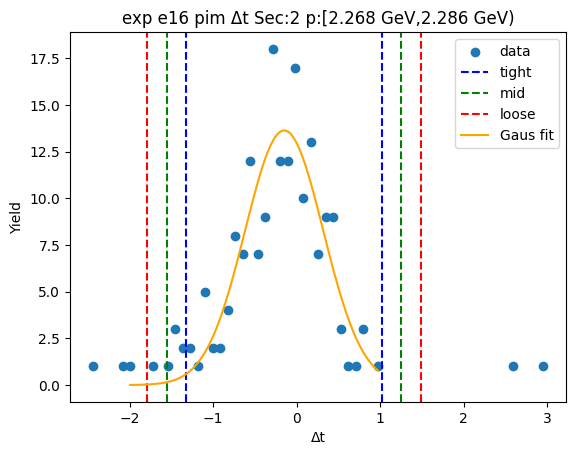

-1.5116084028538552 1.1649763365435362
-1.7792668767935942 1.4326348104832751
-2.0469253507333334 1.7002932844230143


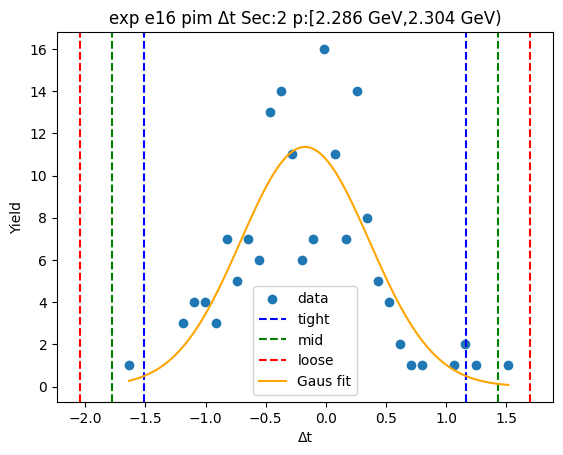

-1.6058514929156738 1.1987065978254512
-1.8863073019897862 1.4791624068995637
-2.1667631110638985 1.7596182159736762


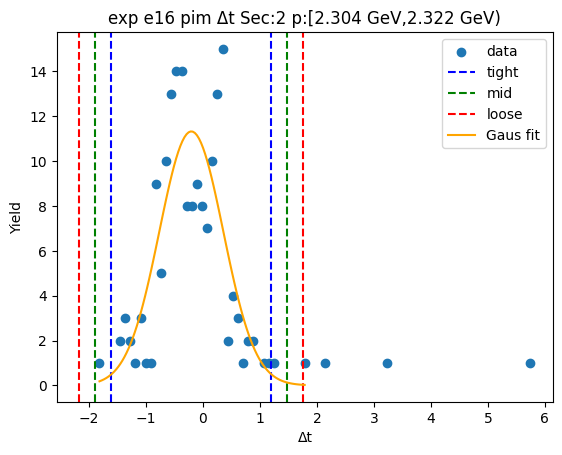

-1.5118071908103383 1.1356395154292813
-1.7765518614343 1.400384186053243
-2.0412965320582623 1.6651288566772051


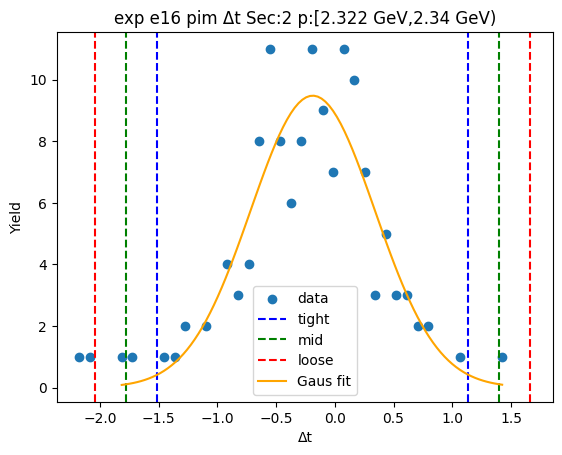

-1.603523936958501 1.27673952485979
-1.8915502831403301 1.564765871041619
-2.179576629322159 1.852792217223448


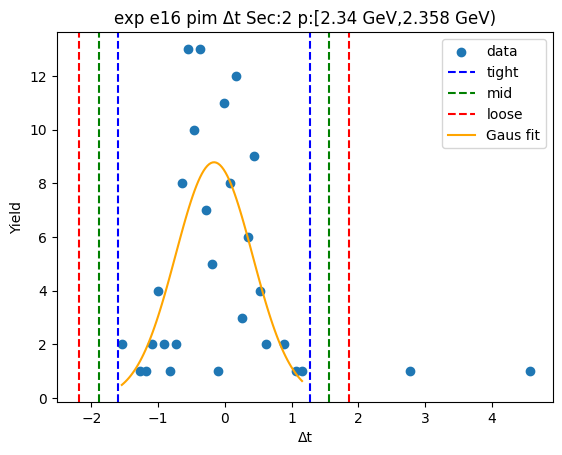

-1.7484854667136134 1.3578677374386137
-2.059120787128836 1.6685030578538362
-2.3697561075440583 1.9791383782690588


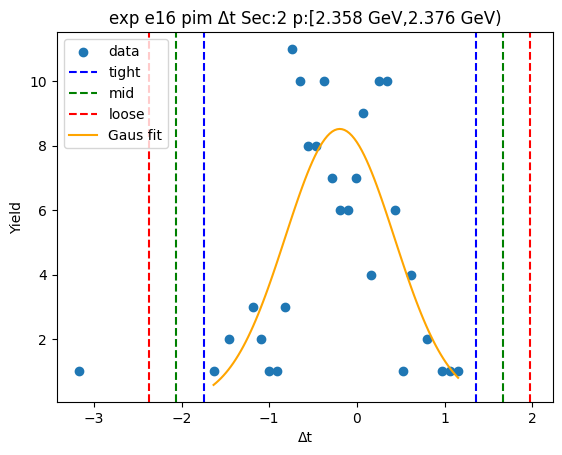

-1.820922061511129 1.4840502750400644
-2.1514192951662485 1.8145475086951839
-2.4819165288213676 2.145044742350303


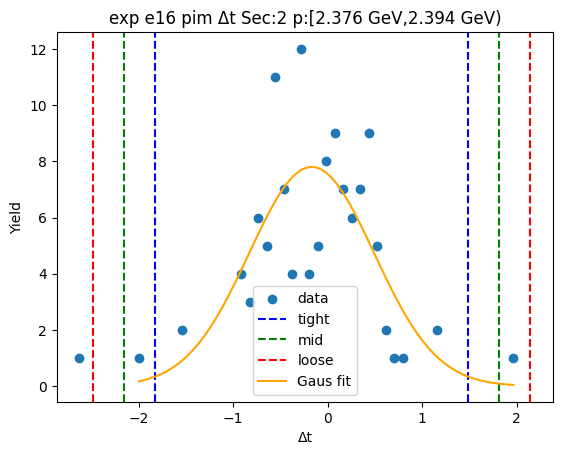

-1.3233238567086136 0.970495103592019
-1.5527057527386772 1.1998769996220822
-1.7820876487687403 1.4292588956521457


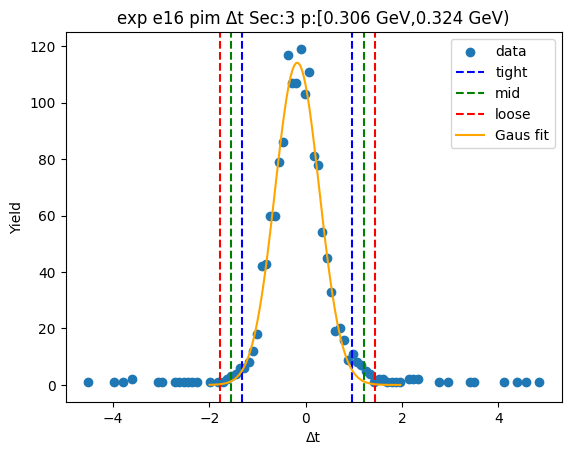

-1.330001398583059 0.9685168822330124
-1.559853226664666 1.1983687103146194
-1.7897050547462732 1.4282205383962265


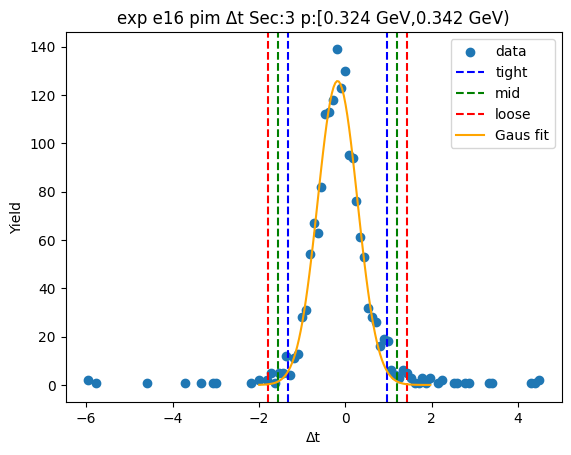

-1.2650118735692497 0.8716518988978871
-1.4786782508159635 1.0853182761446005
-1.6923446280626768 1.2989846533913143


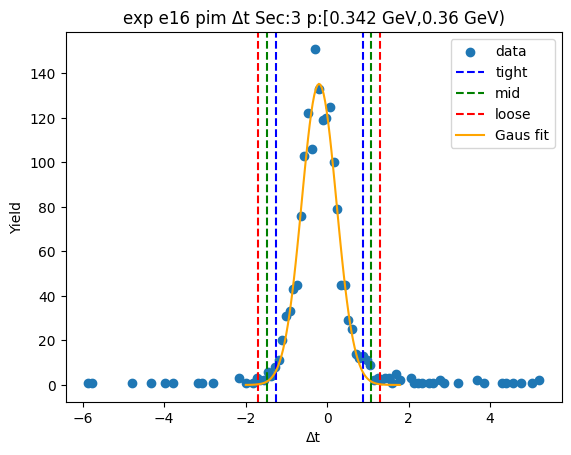

-1.28846646468638 0.9893579091844253
-1.5162489020734606 1.217140346571506
-1.7440313394605411 1.4449227839585865


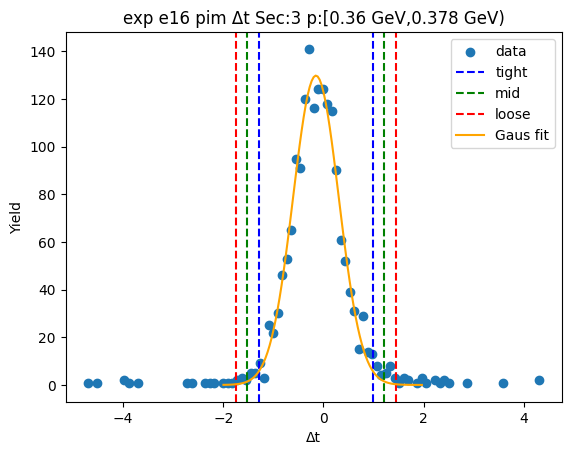

-1.2784598895448551 1.0007963108953357
-1.5063855095888743 1.228721930939355
-1.7343111296328932 1.4566475509833738


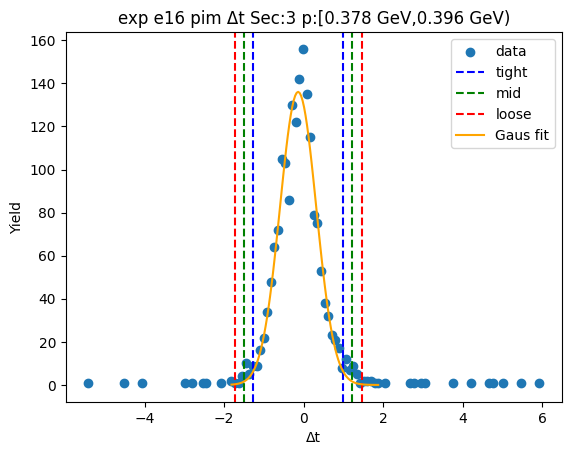

-1.2774746124072522 0.9410088552074555
-1.4993229591687234 1.1628572019689263
-1.721171305930194 1.3847055487303974


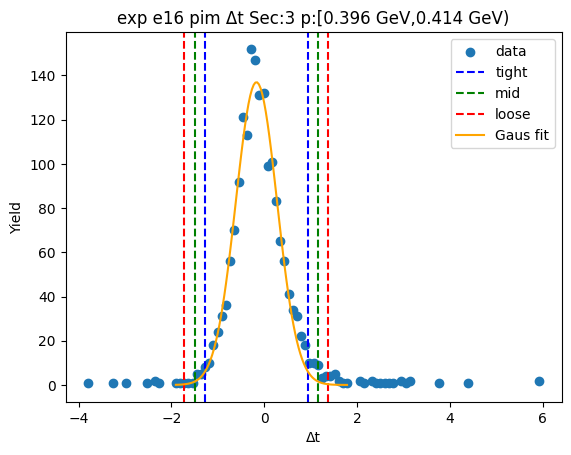

-1.239820025494596 0.9988698983844875
-1.4636890178825042 1.2227388907723957
-1.6875580102704126 1.4466078831603042


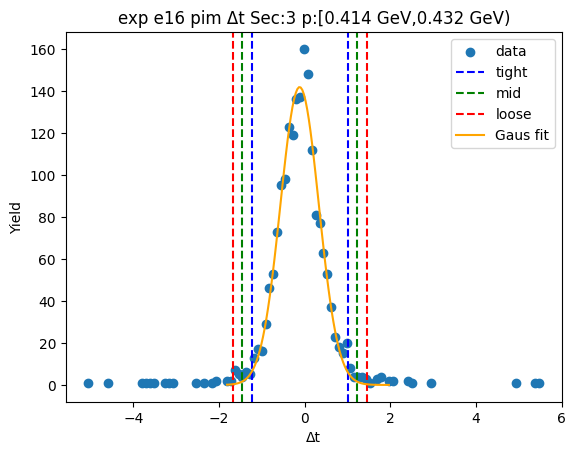

-1.2369017124357855 0.9811207195698106
-1.458703955636345 1.2029229627703701
-1.6805061988369048 1.4247252059709299


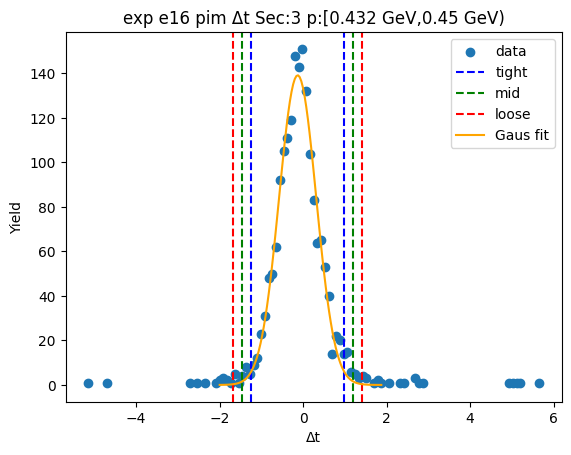

-1.2273449025320033 0.9511214957250211
-1.4451915423577057 1.1689681355507235
-1.6630381821834082 1.386814775376426


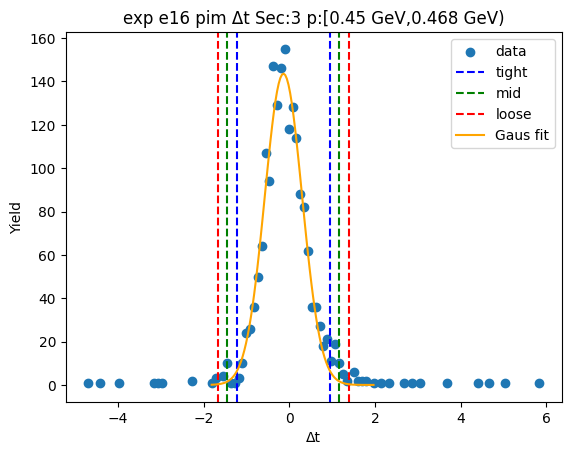

-1.2996618064782346 1.0259523676422677
-1.5322232238902846 1.2585137850543178
-1.764784641302335 1.491075202466368


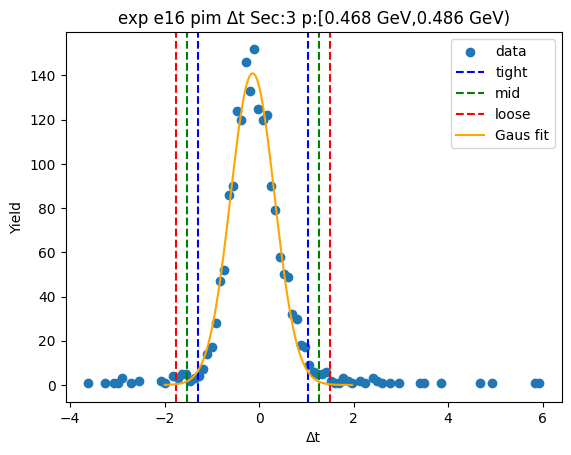

-1.2709121454935035 1.0379445717039246
-1.5017978172132465 1.2688302434236676
-1.7326834889329894 1.4997159151434105


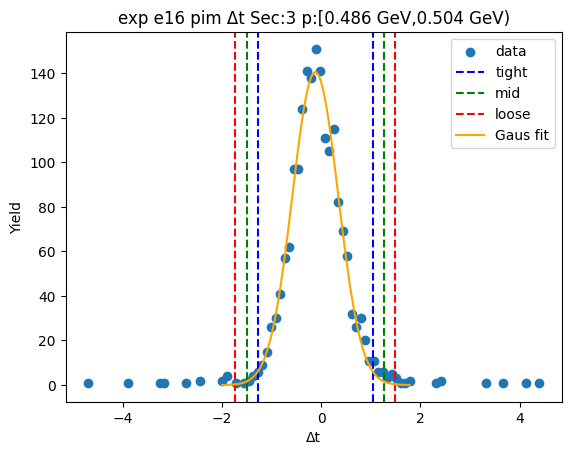

-1.263913248385777 1.0645234503683918
-1.4967569182611942 1.2973671202438086
-1.729600588136611 1.5302107901192255


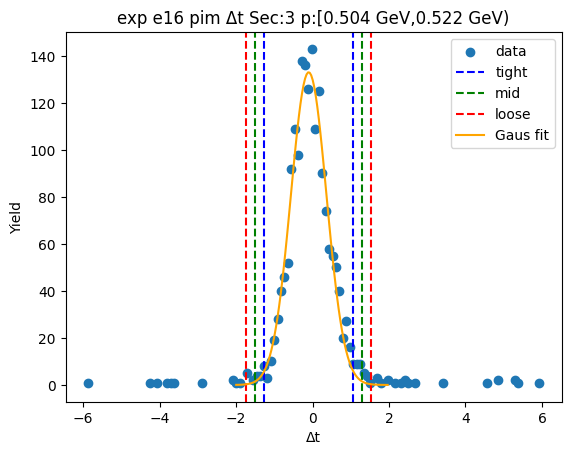

-1.2473597662533737 1.0261148559063324
-1.4747072284693443 1.253462318122303
-1.702054690685315 1.4808097803382736


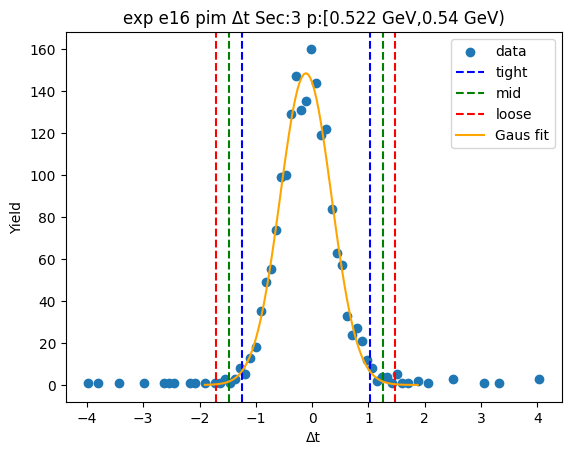

-1.2990564579858823 1.0727538690021543
-1.5362374906846858 1.3099349017009578
-1.7734185233834894 1.5471159343997614


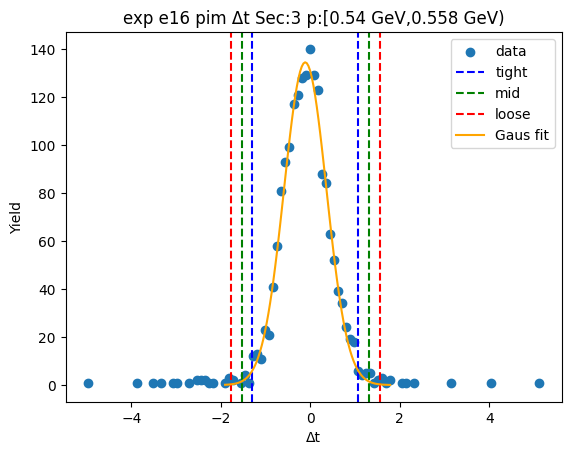

-1.2289549133613178 1.027144438714463
-1.454564848568896 1.2527543739220413
-1.6801747837764742 1.4783643091296195


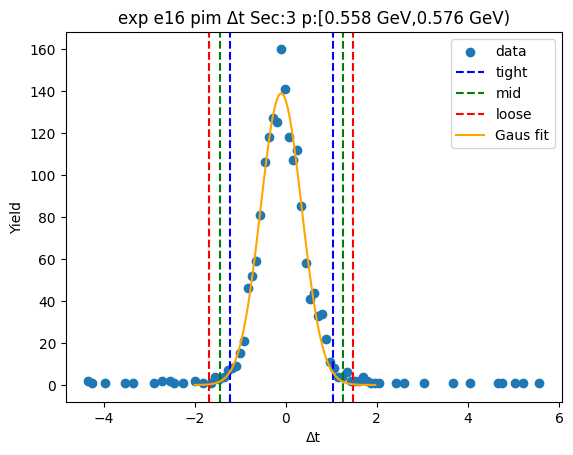

-1.197668321150777 0.9655903641622811
-1.4139941896820827 1.1819162326935868
-1.6303200582133885 1.3982421012248927


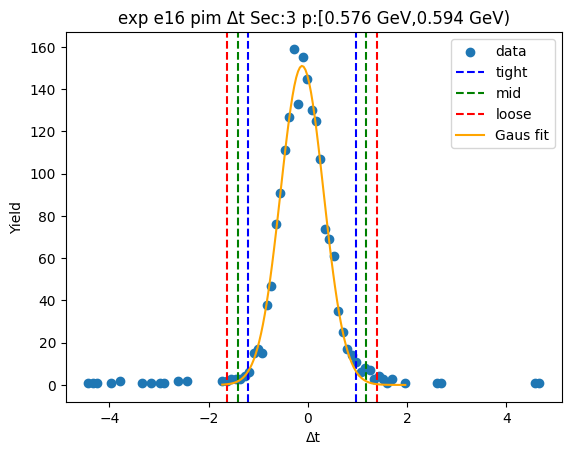

-1.2082385332220853 1.0173283355973348
-1.4307952201040275 1.239885022479277
-1.6533519069859695 1.462441709361219


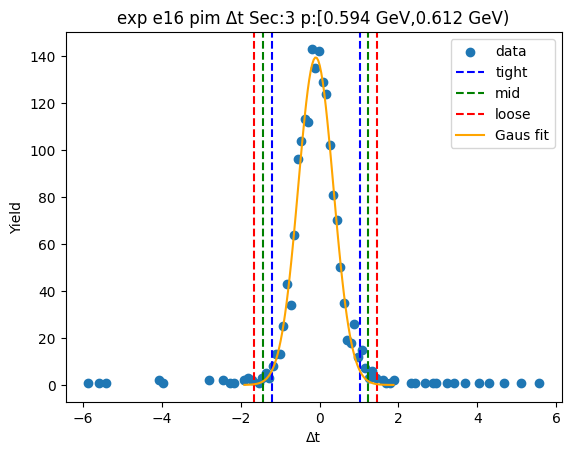

-1.2478773518916242 1.0545833510588158
-1.4781234221866684 1.28482942135386
-1.7083694924817123 1.515075491648904


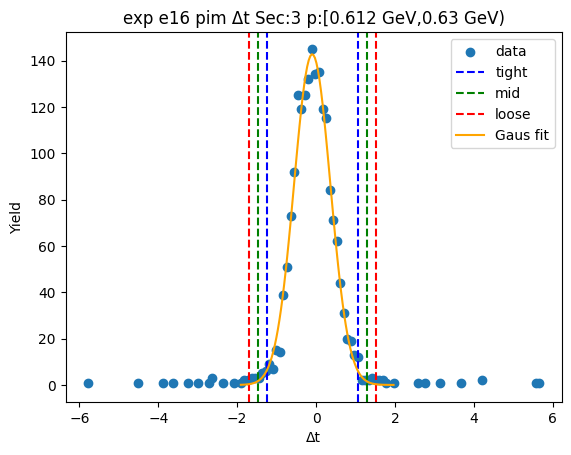

-1.183480883124641 1.0339630605149968
-1.4052252774886047 1.2557074548789604
-1.6269696718525684 1.477451849242924


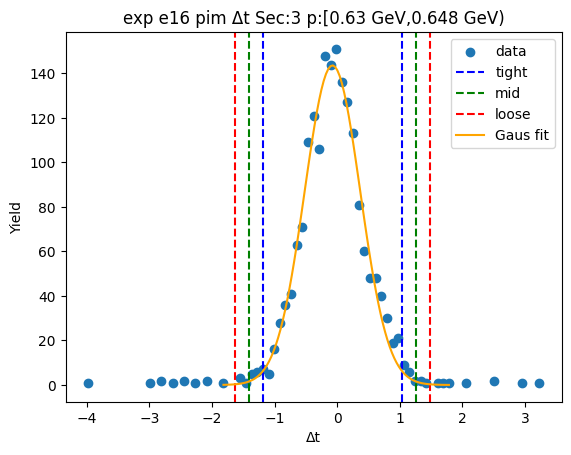

-1.2246049857065413 1.0271604513858816
-1.4497815294157836 1.252336995095124
-1.674958073125026 1.4775135388043663


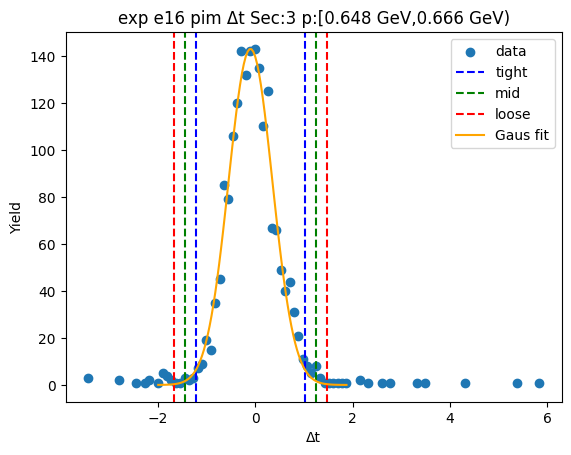

-1.2120081584190103 1.052530291431062
-1.4384620034040176 1.2789841364160692
-1.6649158483890247 1.5054379814010763


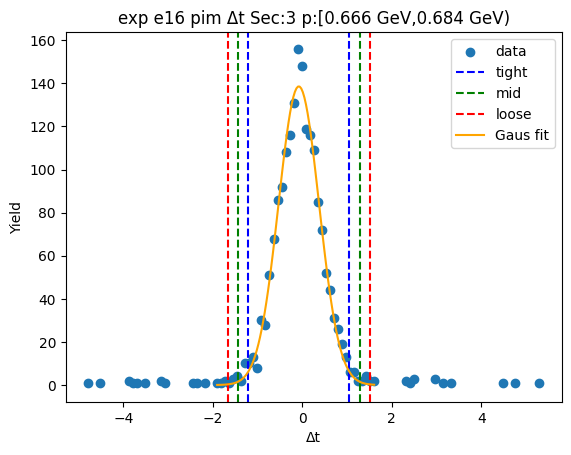

-1.2123521194927909 1.0613703521405773
-1.4397243666561277 1.288742599303914
-1.6670966138194645 1.516114846467251


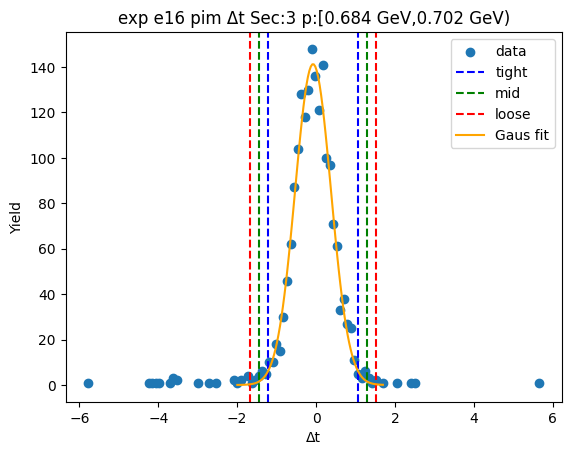

-1.1696607970756994 1.0377871394422156
-1.390405590727491 1.2585319330940072
-1.6111503843792825 1.4792767267457987


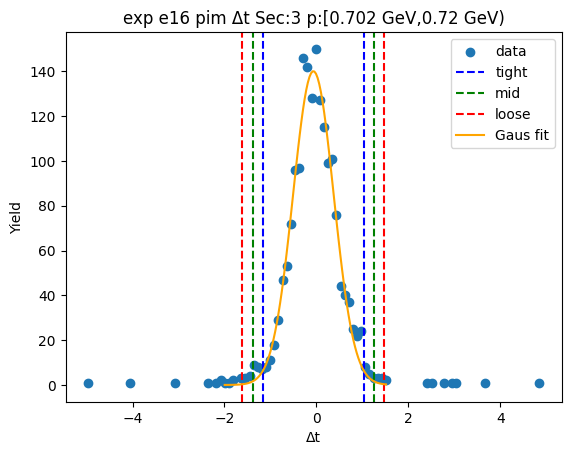

-1.2460578456331384 1.0438967526094556
-1.4750533054573978 1.272892212433715
-1.7040487652816572 1.5018876722579744


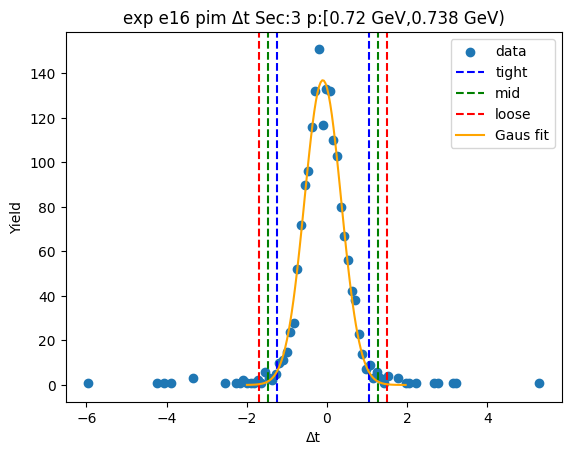

-1.1862644454954583 1.0064662018492418
-1.4055375102299283 1.225739266583712
-1.6248105749643984 1.445012331318182


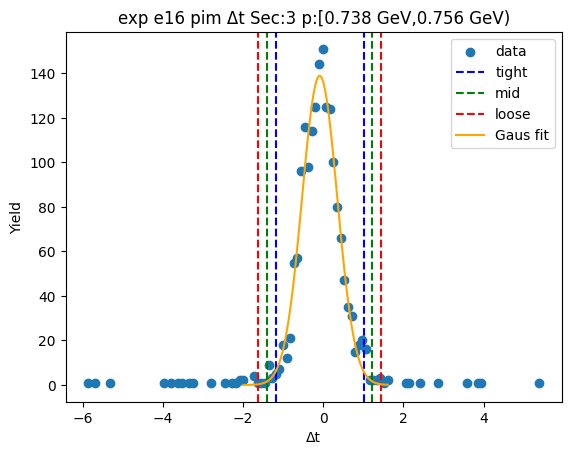

-1.1976660258582363 1.0350164755667248
-1.4209342760007326 1.2582847257092211
-1.6442025261432287 1.4815529758517172


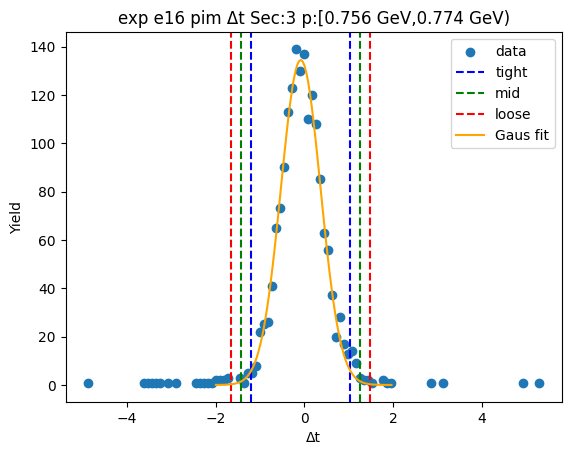

-1.1788302082740778 1.0615572897127927
-1.4028689580727647 1.2855960395114796
-1.6269077078714518 1.5096347893101667


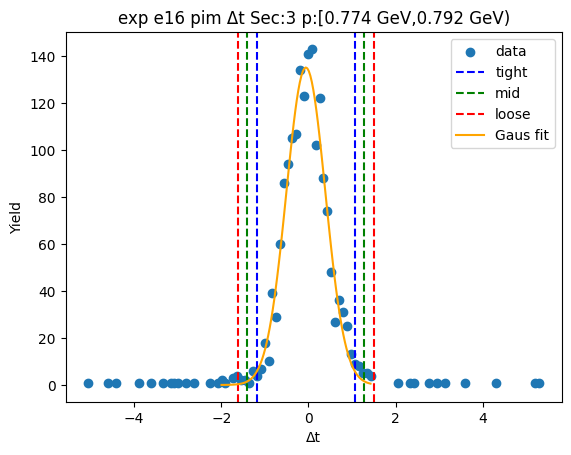

-1.197347810545726 1.050421501188122
-1.4221247417191107 1.2751984323615067
-1.6469016728924957 1.4999753635348916


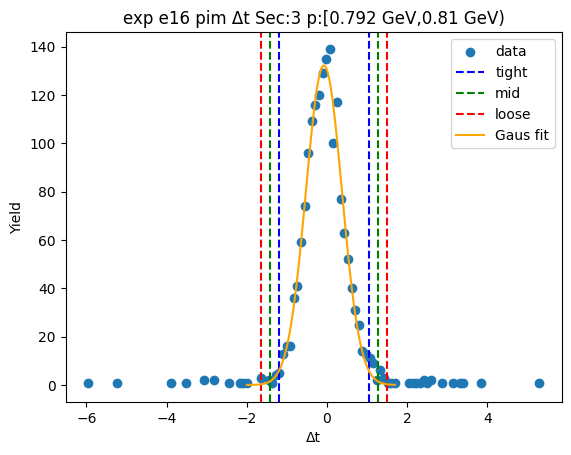

-1.193355859749511 1.0390365916970845
-1.4165951048941707 1.2622758368417442
-1.6398343500388302 1.4855150819864036


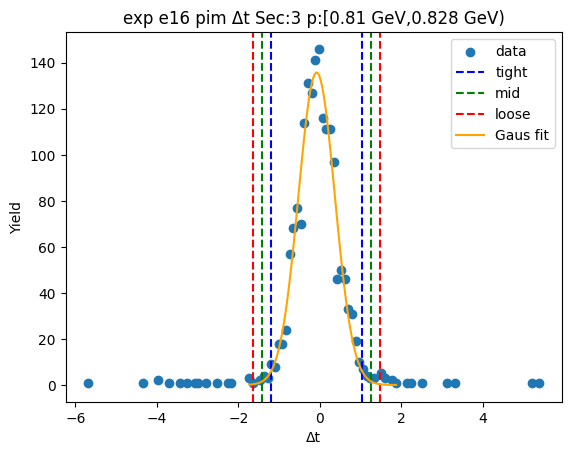

-1.156635103124758 1.039235464228631
-1.376222159860097 1.25882252096397
-1.5958092165954358 1.478409577699309


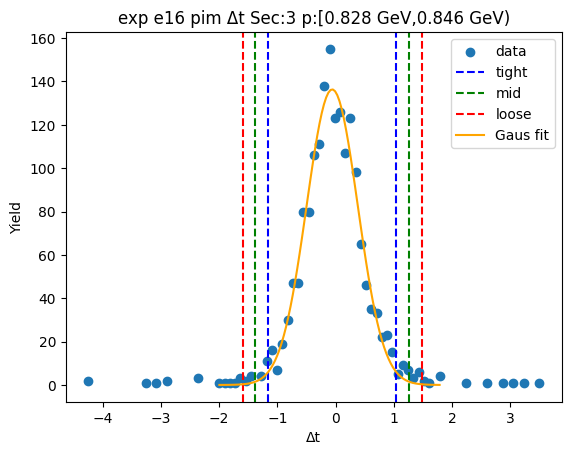

-1.1667173236445363 1.0470372604095233
-1.3880927820499422 1.2684127188149292
-1.6094682404553482 1.4897881772203352


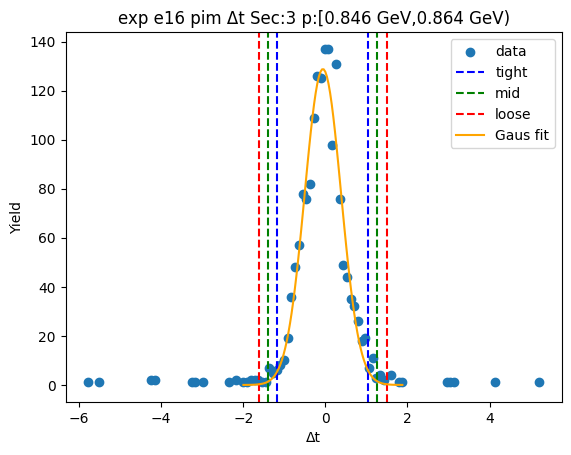

-1.2237865321827712 1.0646375070524443
-1.4526289361062927 1.2934799109759658
-1.6814713400298142 1.5223223148994873


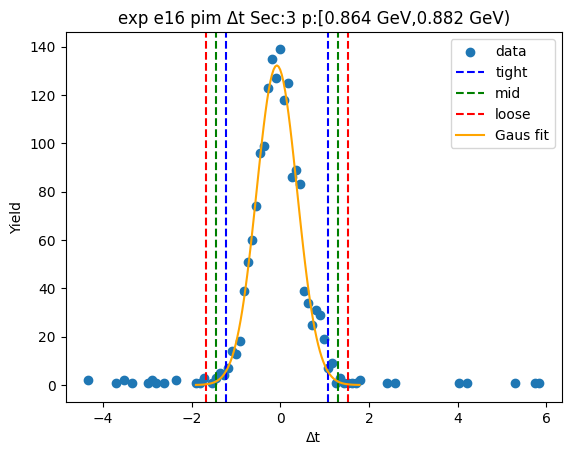

-1.1979480489484864 1.0349735575862646
-1.4212402096019614 1.2582657182397397
-1.6445323702554366 1.4815578788932149


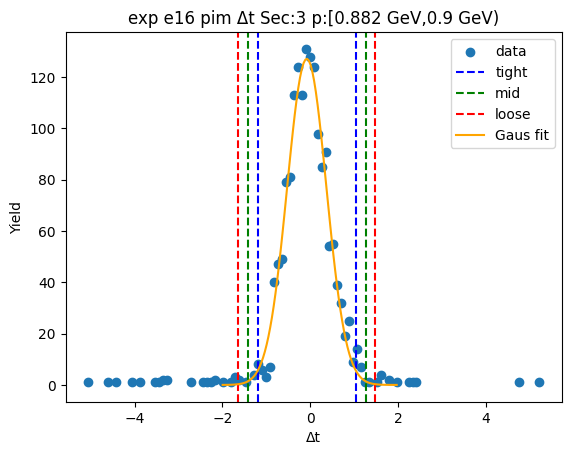

-1.1406645584400896 1.023127250447234
-1.3570437393288222 1.2395064313359665
-1.5734229202175545 1.4558856122246988


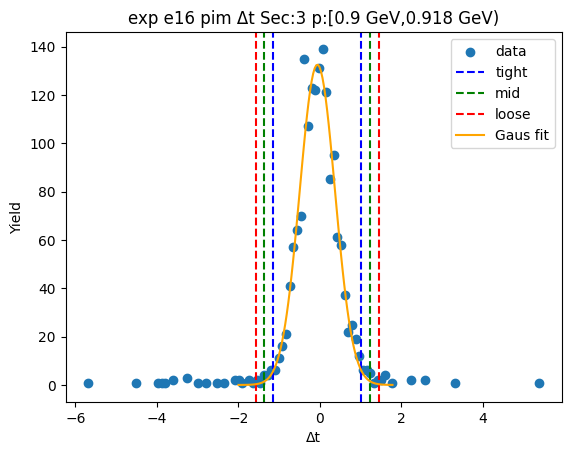

-1.1868933308118625 1.0639367699913442
-1.411976340892183 1.2890197800716647
-1.6370593509725038 1.5141027901519855


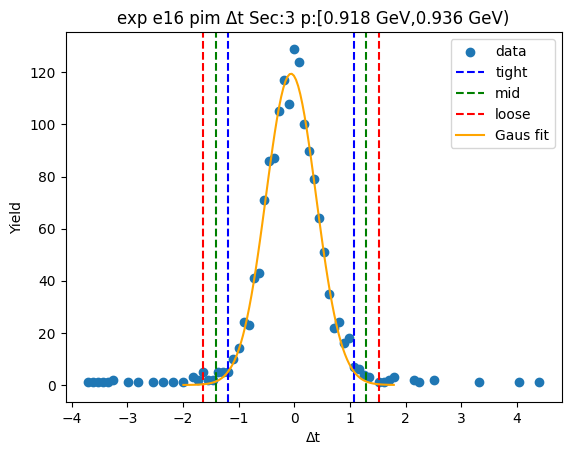

-1.168456174042811 1.0641249425007404
-1.391714285697166 1.2873830541550955
-1.6149723973515213 1.5106411658094507


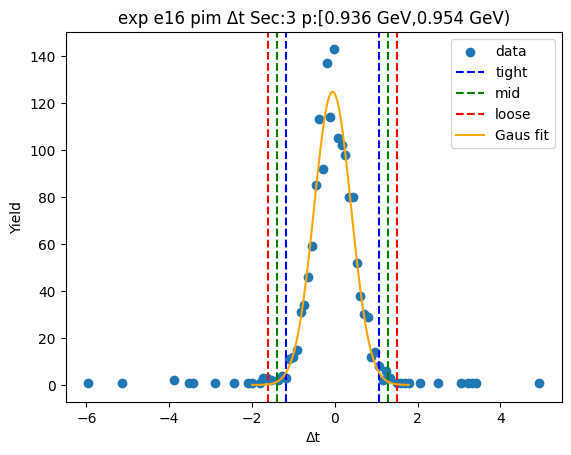

-1.1519946934428371 1.0709360170515656
-1.3742877644922775 1.293229088101006
-1.596580835541718 1.5155221591504464


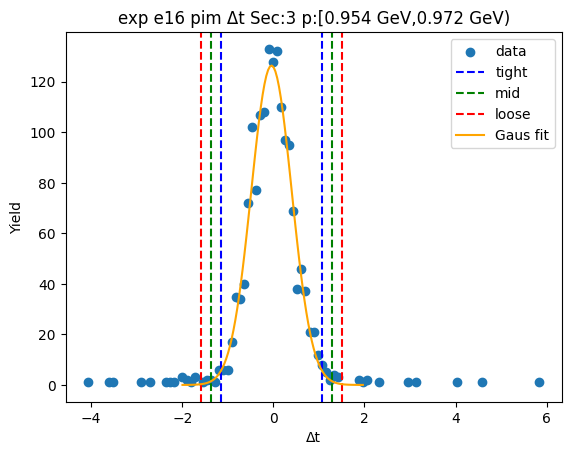

-1.1366642662826523 0.9965451646607753
-1.3499852093769948 1.2098661077551178
-1.5633061524713376 1.4231870508494606


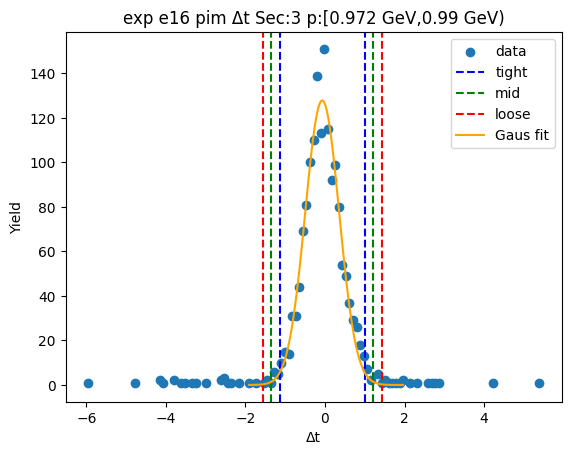

-1.1703499689397303 1.0833659202766615
-1.3957215578613695 1.3087375091983007
-1.6210931467830088 1.53410909811994


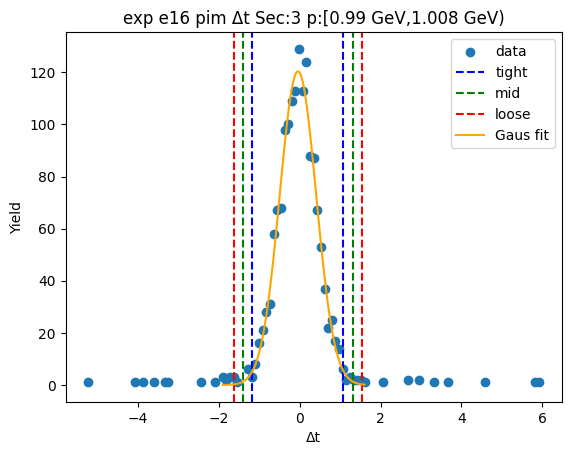

-1.1737157431750032 1.0870864230250195
-1.3997959597950056 1.313166639645022
-1.6258761764150078 1.539246856265024


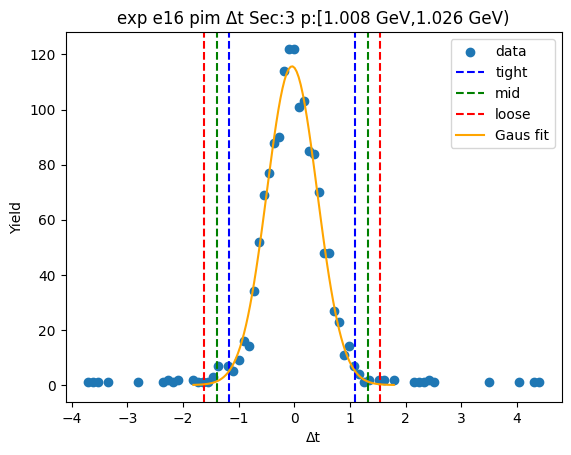

-1.1459659068864017 1.0792251063341658
-1.3684850082084585 1.3017442076562227
-1.5910041095305154 1.5242633089782796


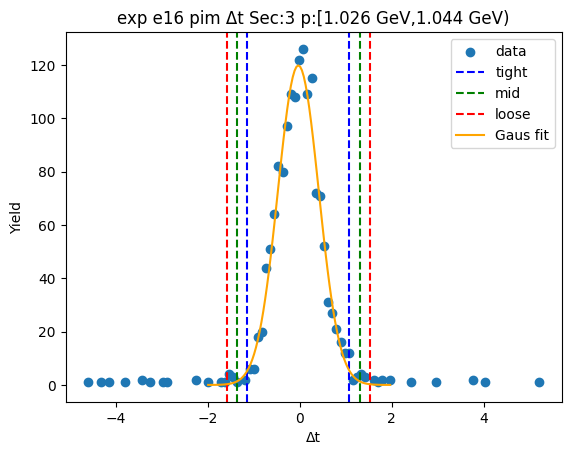

-1.1408592226941234 1.0734862779056464
-1.3622937727541002 1.2949208279656232
-1.5837283228140773 1.5163553780256003


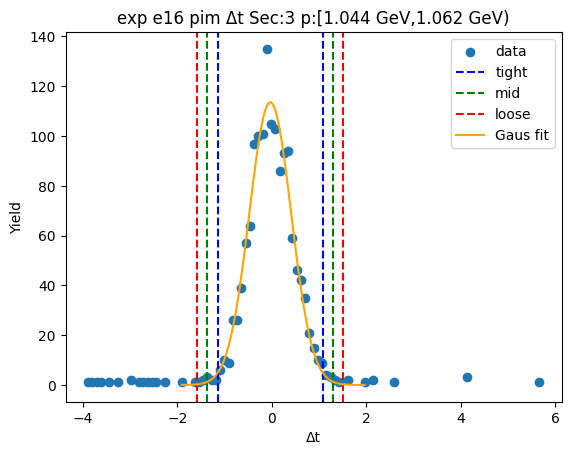

-1.0793917479768758 0.9893153312818721
-1.2862624559027507 1.196186039207747
-1.4931331638286256 1.403056747133622


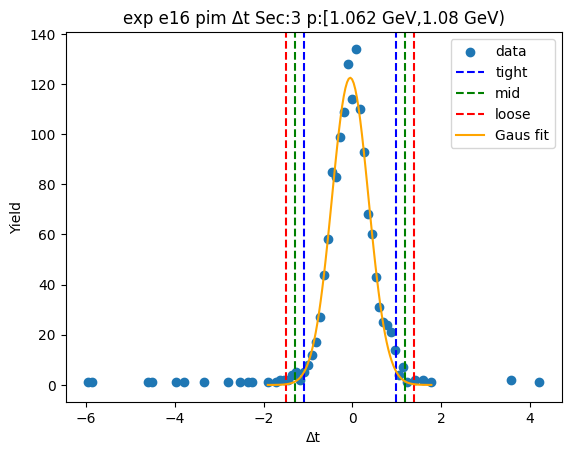

-1.1562457660141277 1.0932808507987233
-1.3811984276954128 1.3182335124800084
-1.606151089376698 1.5431861741612936


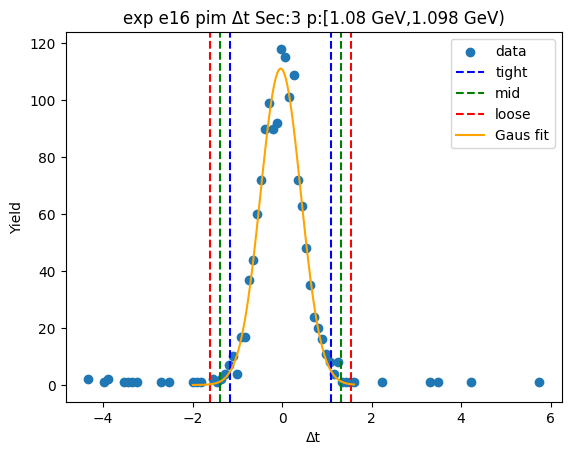

-1.1438870667445937 1.0267277401820643
-1.3609485474372596 1.24378922087473
-1.5780100281299254 1.460850701567396


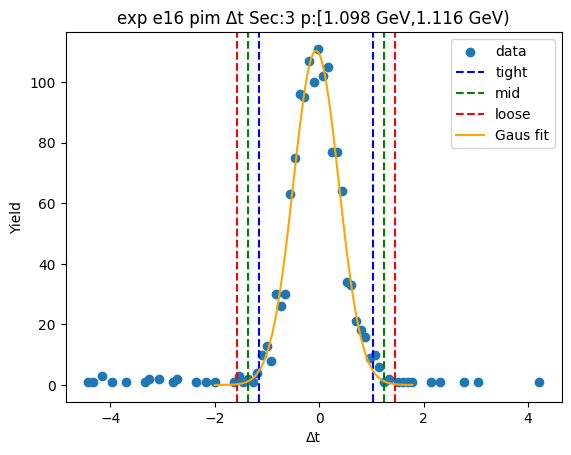

-1.1567299819578973 1.091127269853722
-1.3815157071390591 1.3159129950348838
-1.606301432320221 1.5406987202160456


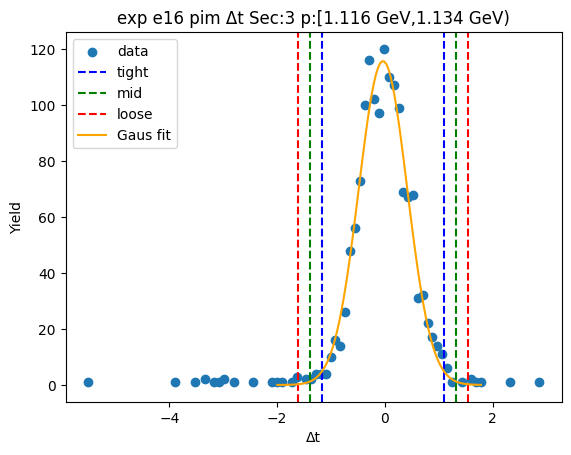

-1.143936960014969 1.0622790332038314
-1.3645585593368488 1.2829006325257113
-1.5851801586587289 1.5035222318475914


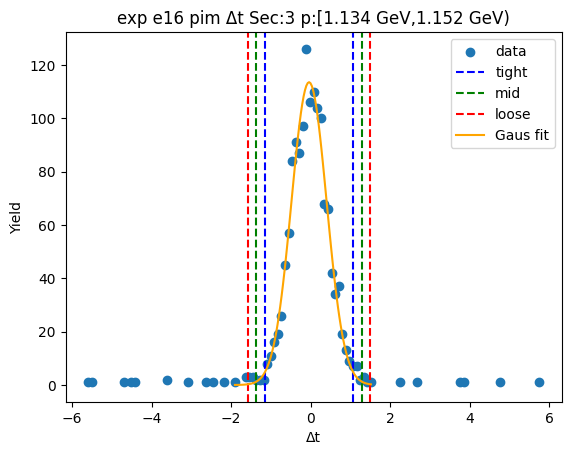

-1.0685765105208576 1.0280516061026008
-1.2782393221832034 1.2377144177649466
-1.4879021338455491 1.4473772294272924


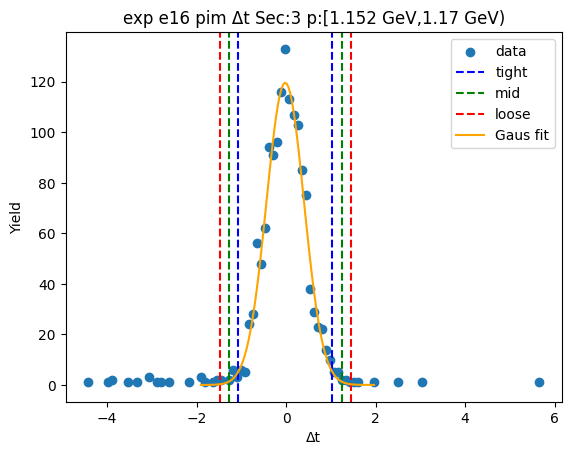

-1.0733045509583954 0.9784145904787491
-1.2784764651021099 1.1835865046224636
-1.4836483792458244 1.3887584187661781


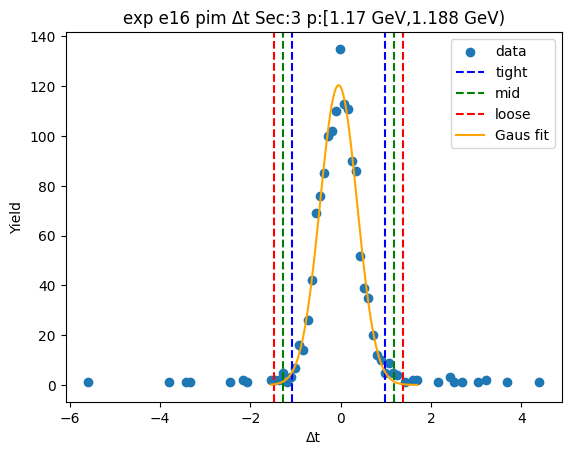

-1.1010433386264336 1.046725040026203
-1.3158201764916972 1.2615018778914666
-1.530597014356961 1.4762787157567303


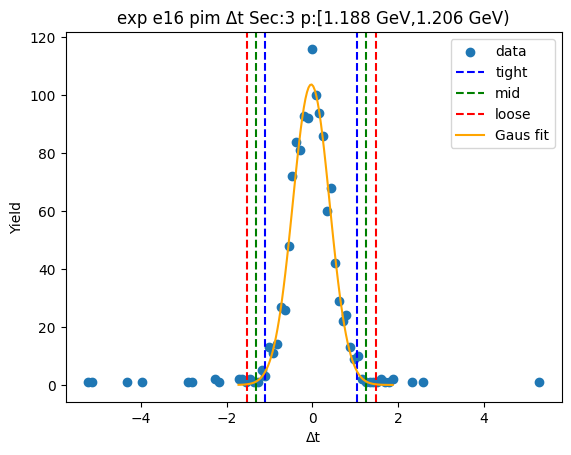

-1.1622137915673107 1.0294965196549435
-1.3813848226895358 1.248667550777169
-1.6005558538117612 1.4678385818993944


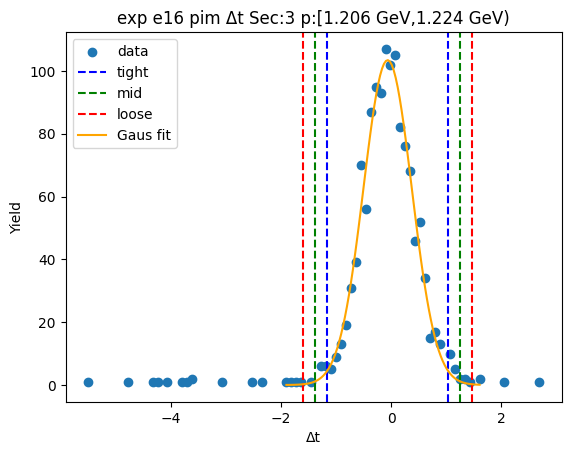

-1.0802399244874819 0.9915475869665165
-1.2874186756328816 1.1987263381119162
-1.4945974267782816 1.4059050892573162


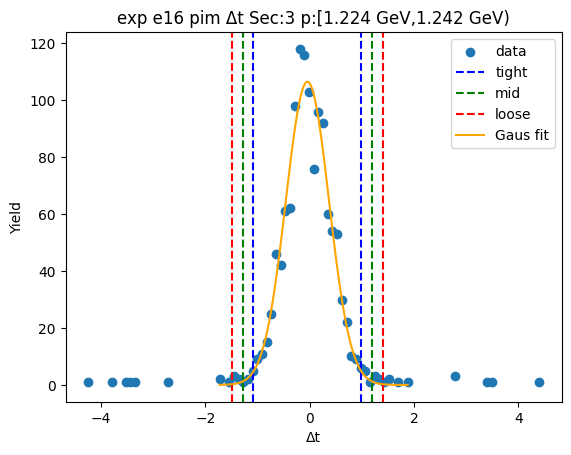

-1.0785760835965414 0.9843371034301317
-1.2848674022992088 1.1906284221327992
-1.4911587210018762 1.3969197408354666


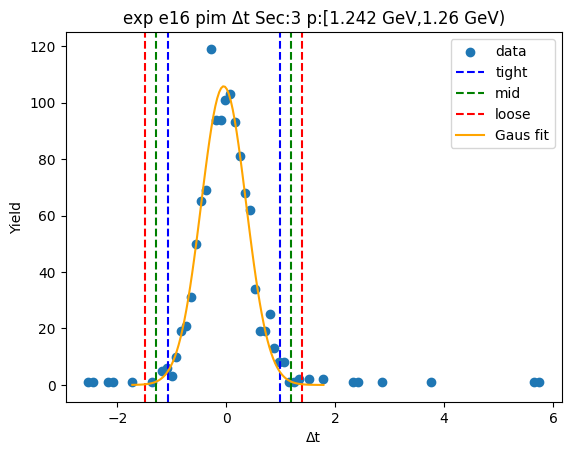

-1.0823591713636287 1.0290321872139157
-1.293498307221383 1.24017132307167
-1.5046374430791376 1.4513104589294246


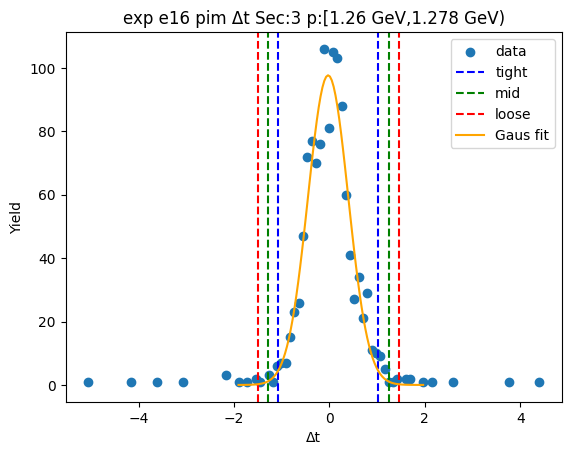

-1.1657547708707214 1.1027769602302973
-1.3926079439808232 1.329630133340399
-1.6194611170909252 1.556483306450501


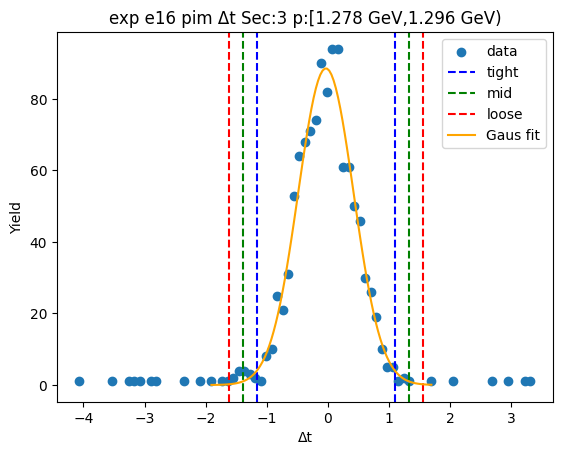

-1.11413943293254 1.073098338050367
-1.3328632100308306 1.2918221151486575
-1.5515869871291215 1.5105458922469484


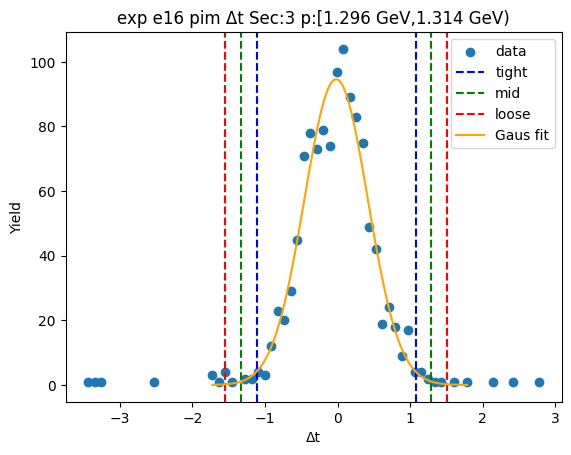

-1.1125968927271874 1.011030291909235
-1.3249596111908297 1.2233930103728774
-1.537322329654472 1.4357557288365197


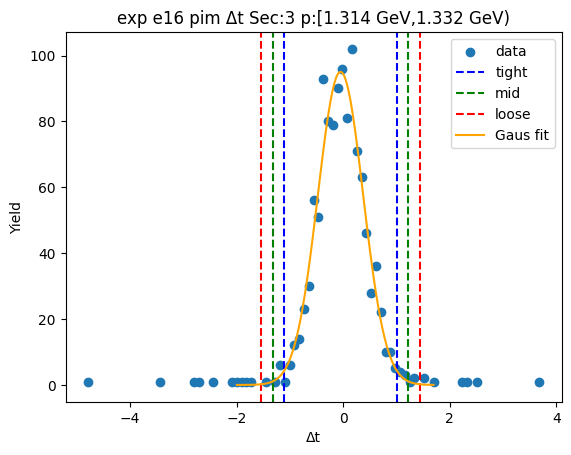

-1.0479691091960641 1.06165271763167
-1.2589312918788376 1.2726149003144434
-1.469893474561611 1.4835770829972168


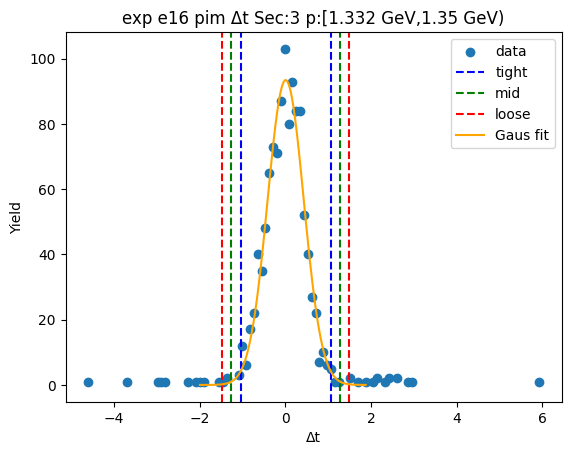

-0.9796124518112196 0.9330888045002182
-1.1708825774423635 1.1243589301313621
-1.3621527030735072 1.3156290557625059


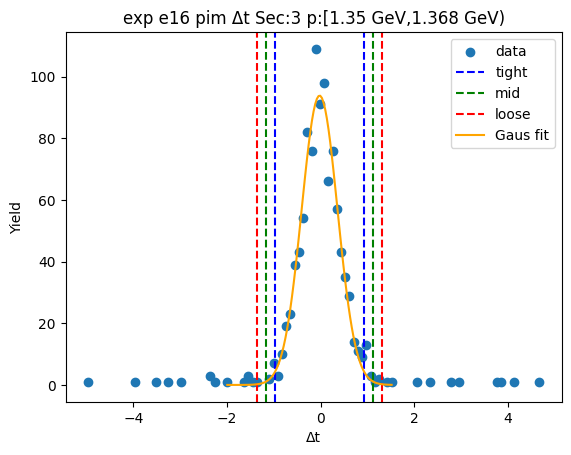

-1.0841611651924352 1.0387435487680103
-1.2964516365884797 1.2510340201640548
-1.5087421079845242 1.4633244915600994


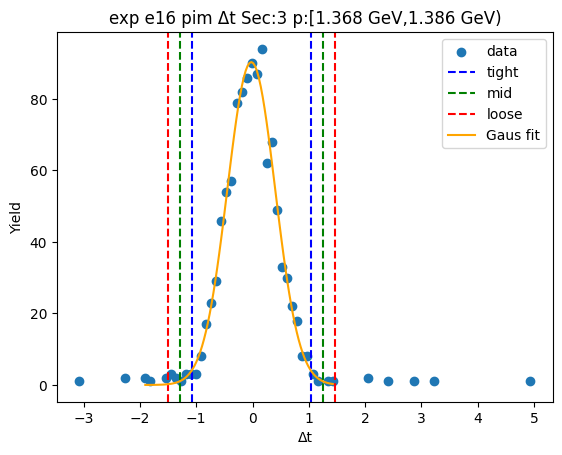

-1.101256284493473 1.0554585237462817
-1.3169277653174485 1.2711300045702572
-1.532599246141424 1.4868014853942326


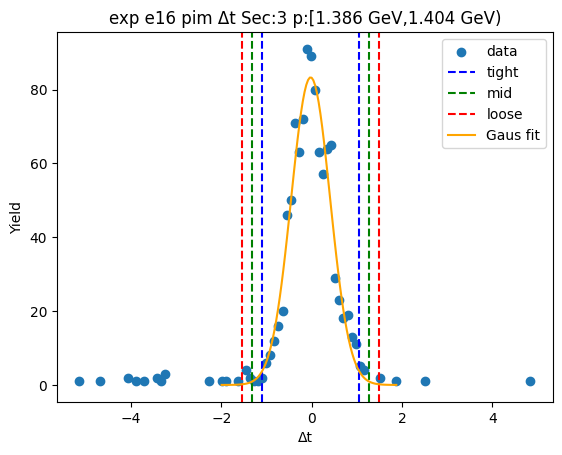

-1.082251631949327 1.0613867198720026
-1.29661546713146 1.2757505550541357
-1.5109793023135931 1.4901143902362688


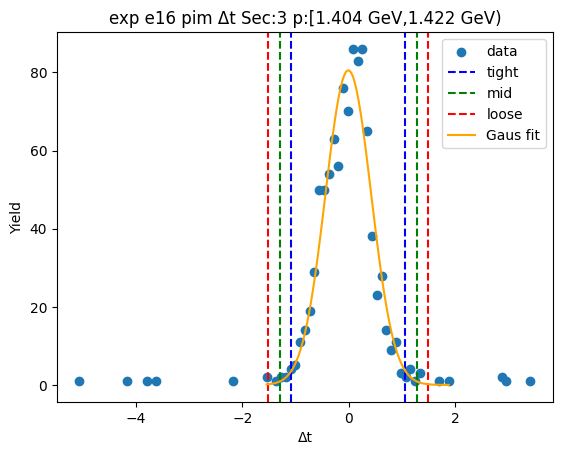

-1.1014614546900214 1.0640184630581577
-1.3180094464648393 1.2805664548329756
-1.5345574382396572 1.4971144466077935


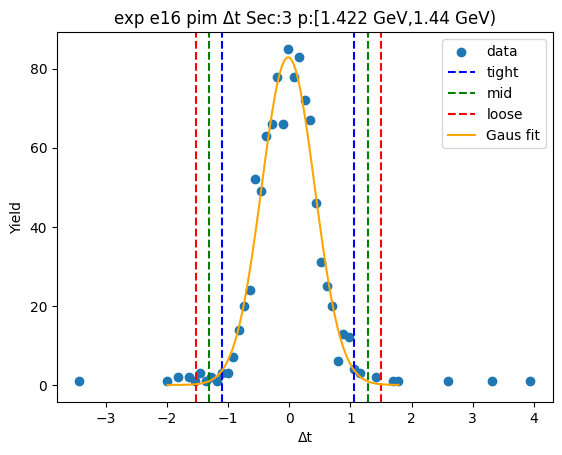

-1.053701248015329 1.0201549399386587
-1.2610868668107278 1.2275405587340575
-1.4684724856061264 1.4349261775294562


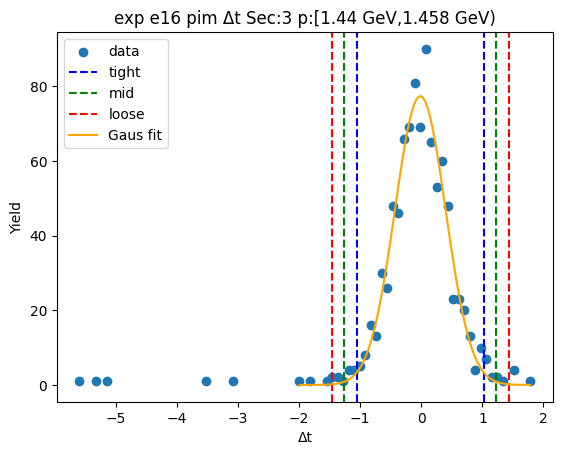

-1.0299709206367202 0.9718955363943697
-1.2301575663398292 1.1720821820974787
-1.4303442120429382 1.3722688278005877


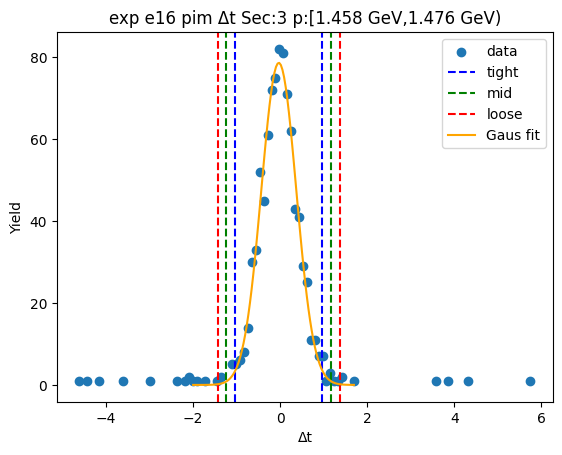

-1.0426771957438339 1.0402377603717778
-1.2509686913553952 1.2485292559833392
-1.4592601869669564 1.4568207515949003


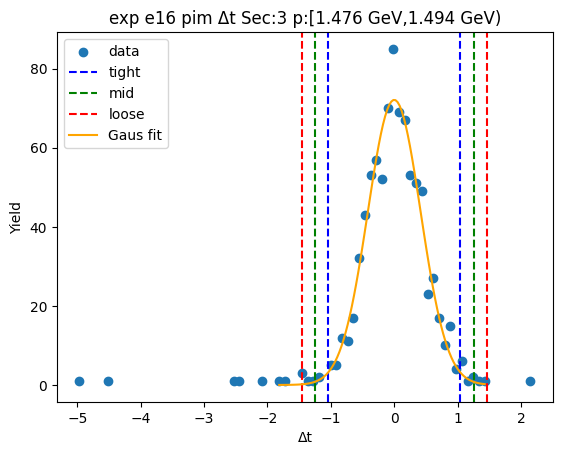

-1.1136133006095585 1.0937773794805228
-1.3343523686185665 1.3145164474895308
-1.5550914366275745 1.5352555154985388


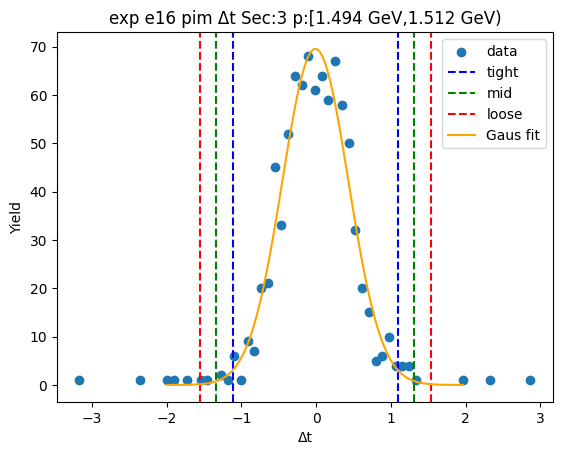

-0.9909389052960483 0.9604569178312125
-1.1860784876087742 1.1555965001439386
-1.3812180699215004 1.3507360824566648


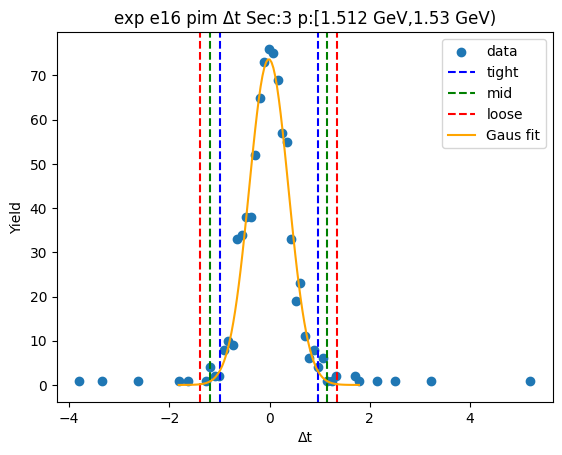

-1.0057215436873852 1.0448453565816243
-1.2107782337142863 1.2499020466085253
-1.4158349237411874 1.4549587366354264


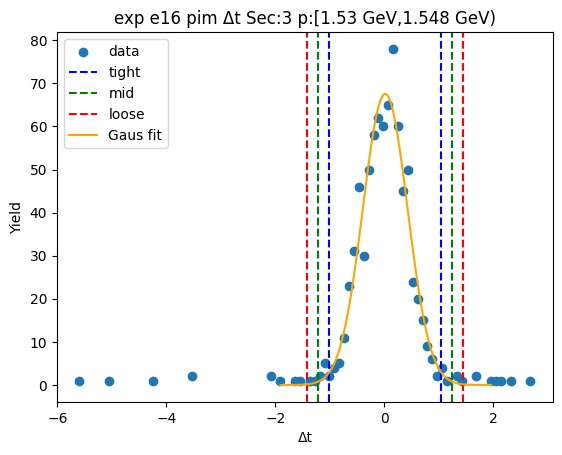

-1.0942821618442122 1.0202800820819375
-1.3057383862368273 1.2317363064745526
-1.5171946106294423 1.4431925308671676


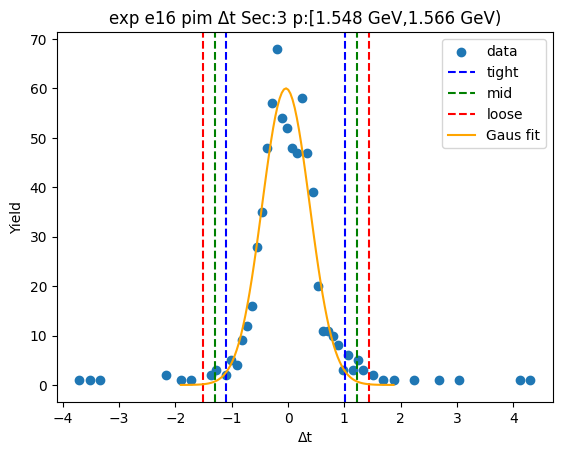

-1.0147595959533715 1.0309617918889884
-1.2193317347376076 1.2355339306732245
-1.4239038735218434 1.4401060694574603


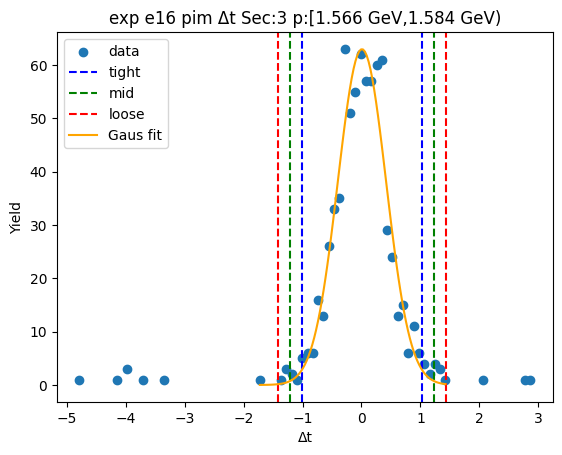

-1.1355081729853211 1.1707875274547843
-1.3661377430293318 1.401417097498795
-1.5967673130733422 1.6320466675428054


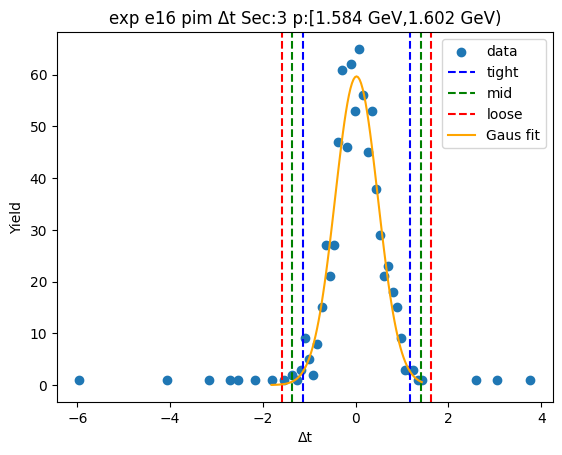

-0.9888714273878969 1.0054239960737787
-1.1883009697340643 1.2048535384199461
-1.387730512080232 1.4042830807661137


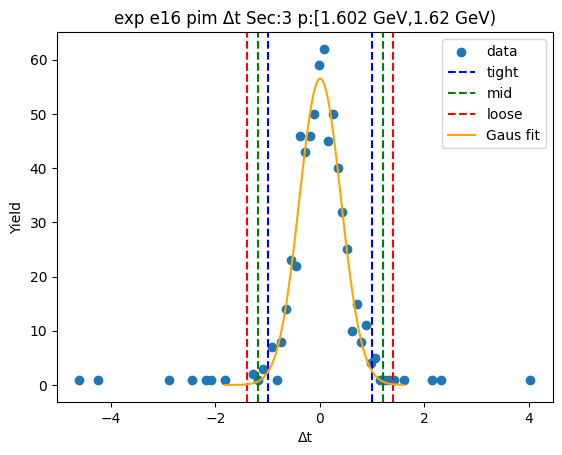

-1.13401340926833 1.1921674428078555
-1.3666314944759486 1.424785528015474
-1.599249579683567 1.6574036132230925


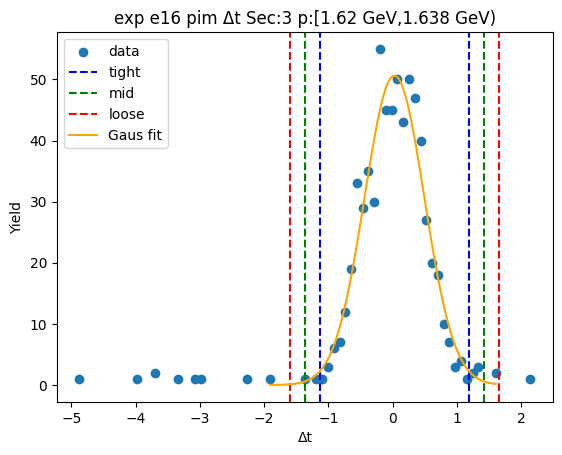

-0.9750153039982082 1.0115709636024948
-1.1736739307582786 1.2102295903625653
-1.372332557518349 1.4088882171226356


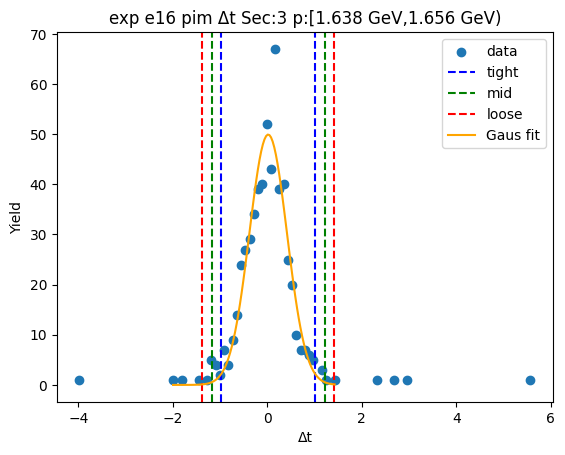

-1.061950539279909 1.0901419275120408
-1.2771597859591037 1.3053511741912356
-1.4923690326382986 1.5205604208704304


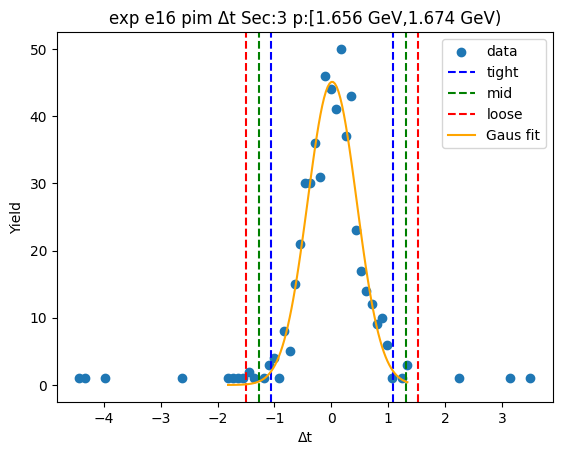

-1.0552291457660175 1.1009240548893808
-1.2708444658315572 1.3165393749549206
-1.4864597858970972 1.5321546950204605


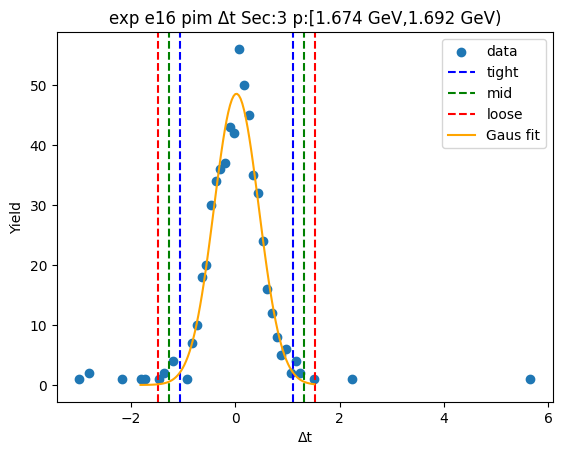

-0.9954981487376872 1.0920226970525122
-1.204250233316707 1.3007747816315323
-1.4130023178957272 1.5095268662105523


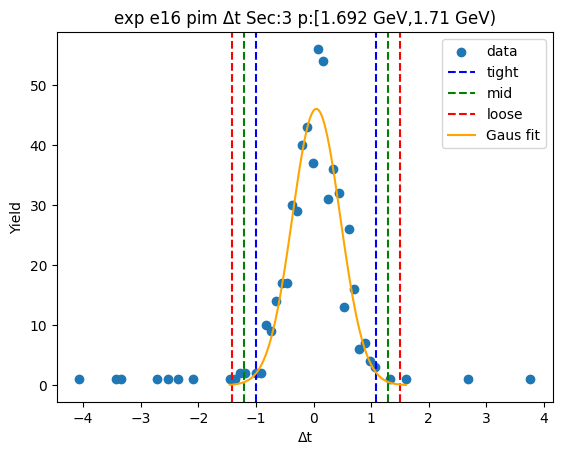

-0.9732510681958972 1.174495114370591
-1.1880256864525462 1.38926973262724
-1.402800304709195 1.6040443508838889


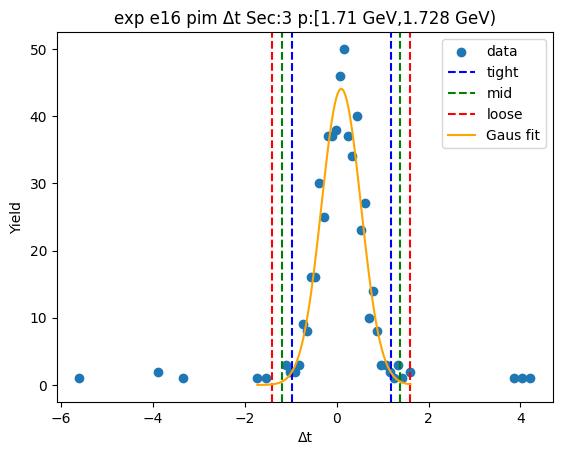

-1.0478339596455442 1.1394305350708227
-1.266560409117181 1.3581569845424595
-1.4852868585888175 1.576883434014096


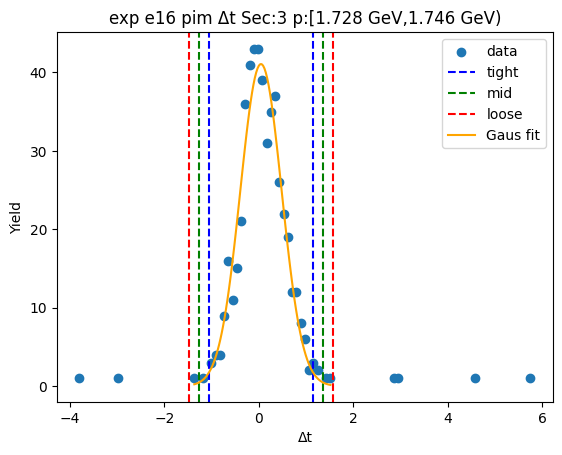

-1.0577701291398227 1.2442978828076836
-1.2879769303345732 1.474504684002434
-1.5181837315293238 1.7047114851971847


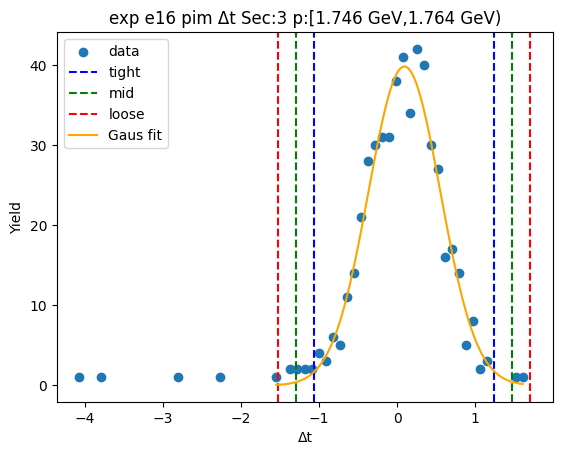

-0.9425509362205136 1.0724554490621026
-1.1440515747487752 1.2739560875903642
-1.3455522132770368 1.4754567261186258


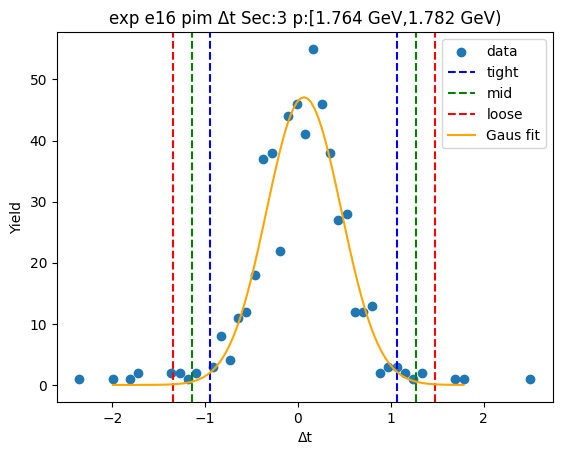

-0.9970440250104567 1.2325618499310909
-1.2200046125046116 1.4555224374252458
-1.4429651999987663 1.6784830249194005


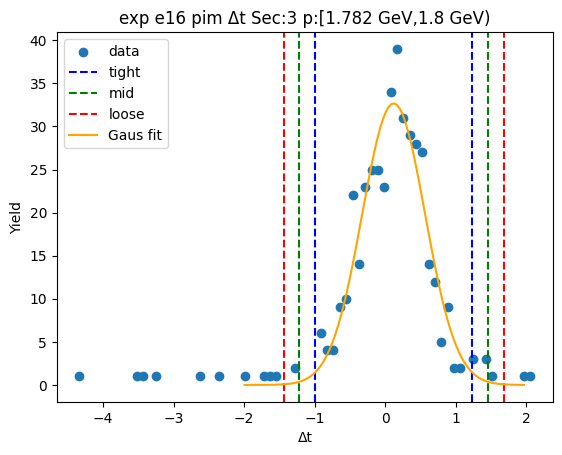

-0.994336381864095 1.0914798655295852
-1.2029180066034628 1.3000614902689531
-1.411499631342831 1.5086431150083213


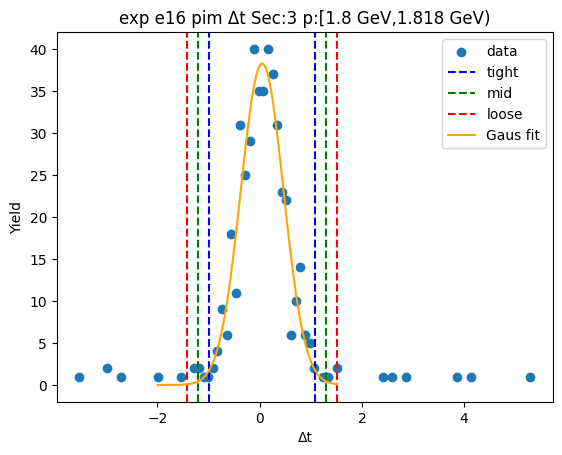

-1.1247035947576332 1.2997448146871555
-1.367148435702112 1.5421896556316343
-1.6095932766465908 1.7846344965761132


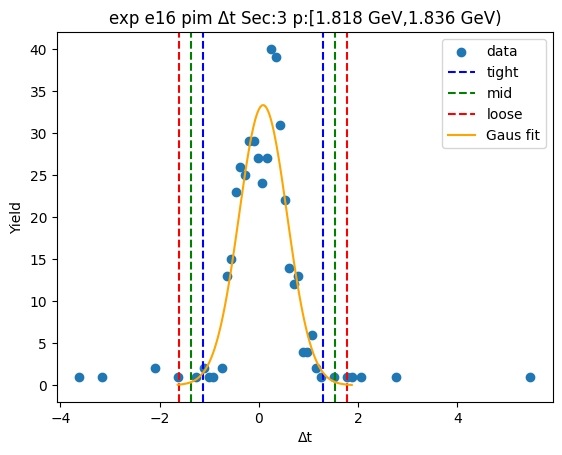

-0.9814700395986202 1.181043159424691
-1.1977213595009515 1.3972944793270223
-1.4139726794032828 1.6135457992293536


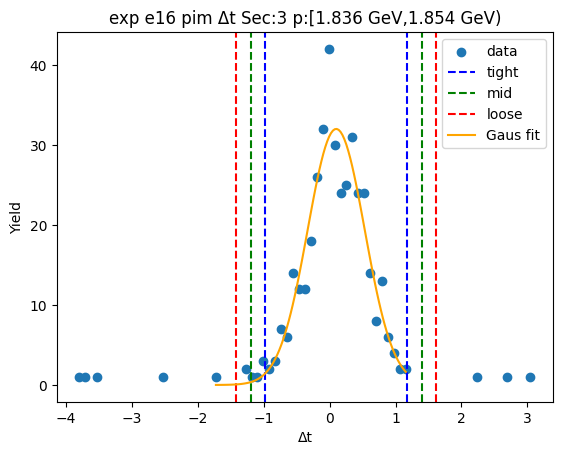

-0.980891781151956 1.0652108150405428
-1.185502040771206 1.2698210746597929
-1.3901123003904559 1.4744313342790427


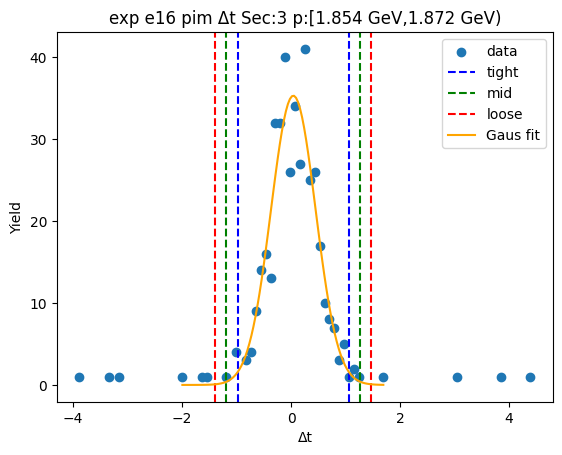

-1.0183274936418905 1.2119751195270985
-1.2413577549587893 1.4350053808439973
-1.4643880162756882 1.6580356421608962


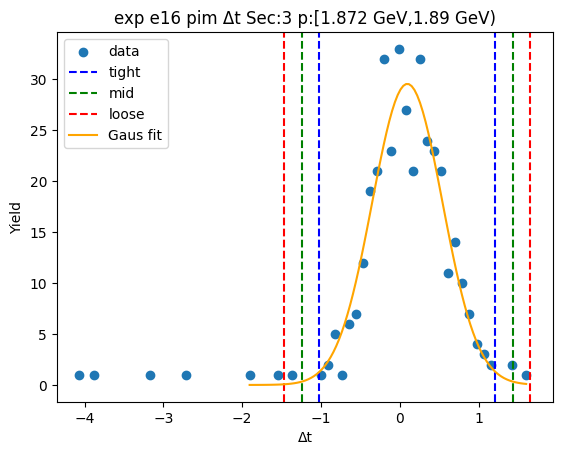

-0.8575649897503312 1.0740696994466796
-1.0507284586700325 1.267233168366381
-1.2438919275897335 1.460396637286082


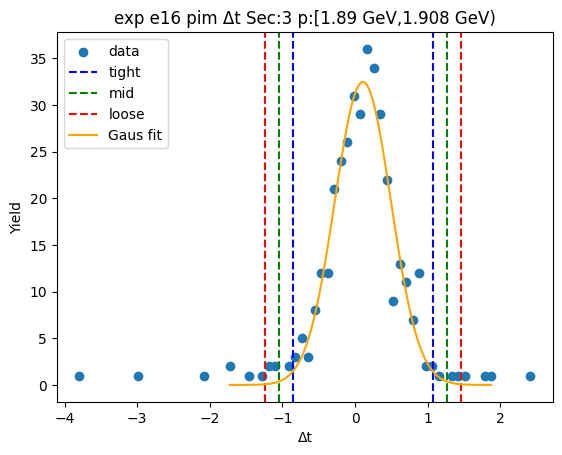

-0.9371978651921824 1.1104179483194396
-1.1419594465433447 1.315179529670602
-1.3467210278945068 1.519941111021764


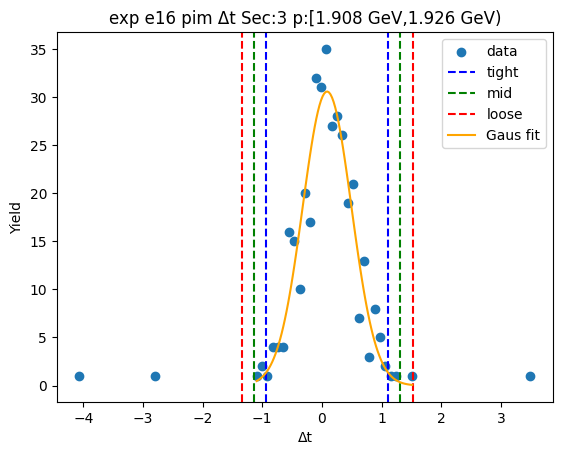

-1.0353917051210153 1.1859995888548422
-1.2575308345186011 1.408138718252428
-1.4796699639161868 1.6302778476500137


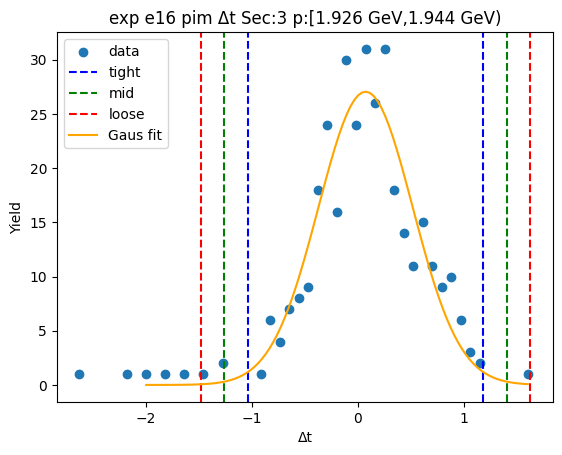

-0.8610095403711437 1.0296588377989997
-1.050076378188158 1.2187256756160139
-1.2391432160051723 1.4077925134330282


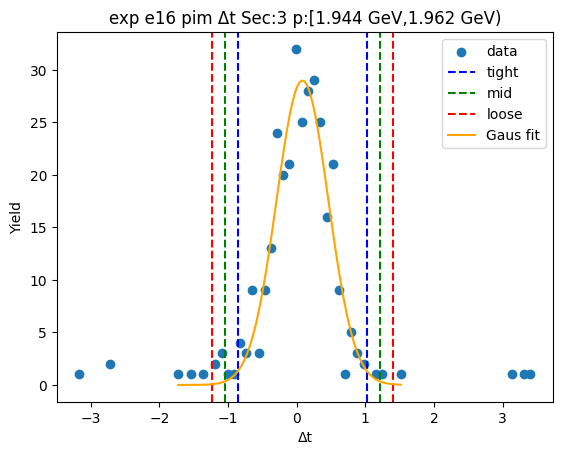

-1.0180668266090476 1.3197207940006708
-1.2518455886700195 1.5534995560616427
-1.4856243507309912 1.7872783181226144


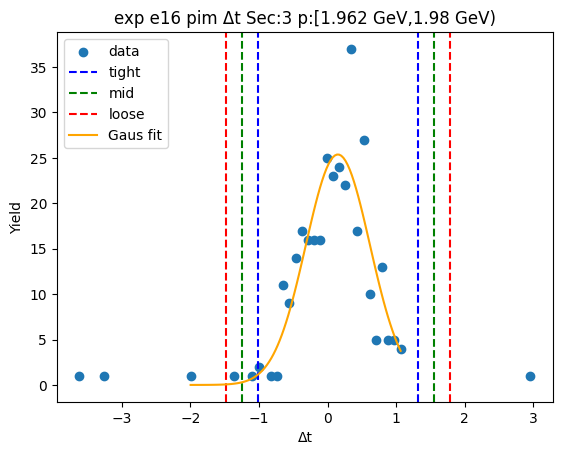

-0.8853367628889401 1.1152113451621481
-1.0853915736940491 1.3152661559672572
-1.285446384499158 1.515320966772366


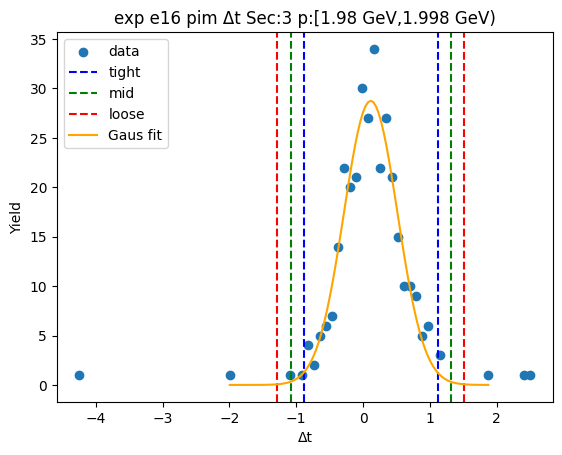

-0.824738192939524 1.0789727257846413
-1.0151092848119407 1.269343817657058
-1.2054803766843571 1.4597149095294744


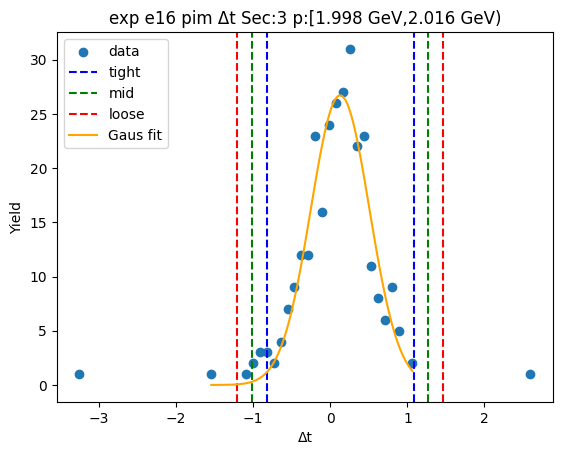

-0.9335652125700017 1.1077382239607405
-1.137695556223076 1.3118685676138147
-1.3418258998761503 1.515998911266889


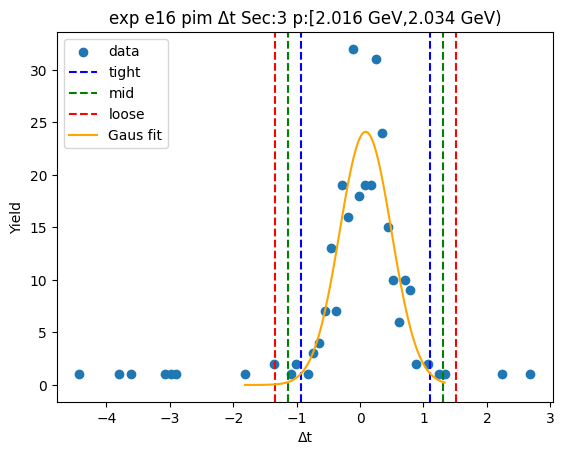

-0.8816459401440988 1.0874296444404838
-1.078553498602557 1.284337202898942
-1.2754610570610152 1.4812447613574002


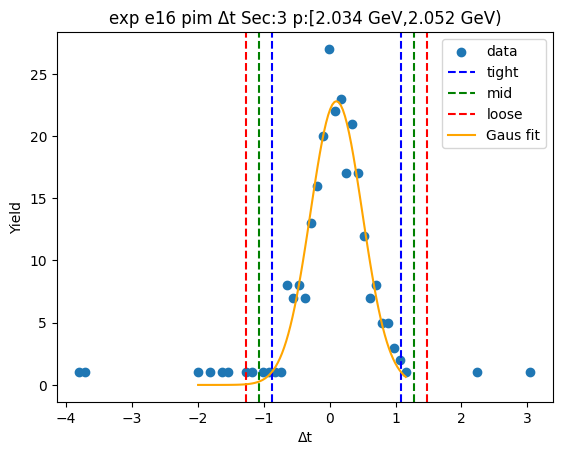

-0.776288008779089 1.0336472697515517
-0.9572815366321529 1.2146407976046156
-1.1382750644852169 1.3956343254576797


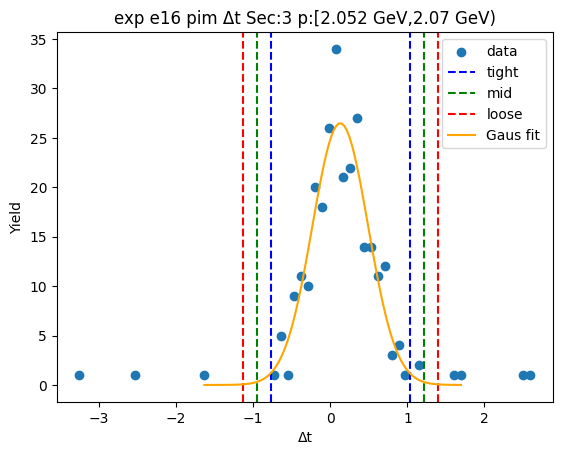

-0.9555318682920502 1.3326905227631347
-1.1843541073975685 1.561512761868653
-1.4131763465030869 1.7903350009741714


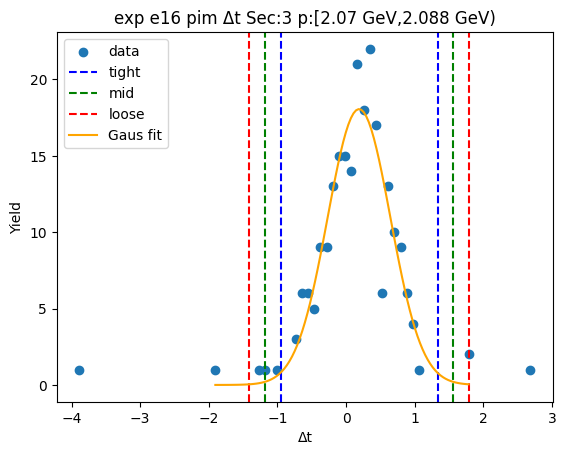

-0.8693959426928843 1.1963286461993963
-1.0759684015821125 1.4029011050886244
-1.2825408604713404 1.6094735639778524


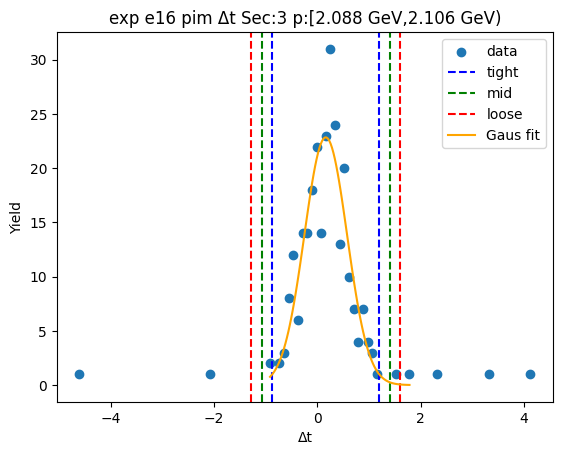

-0.9959296235555615 1.2101632927371833
-1.216538915184836 1.4307725843664578
-1.4371482068141104 1.6513818759957322


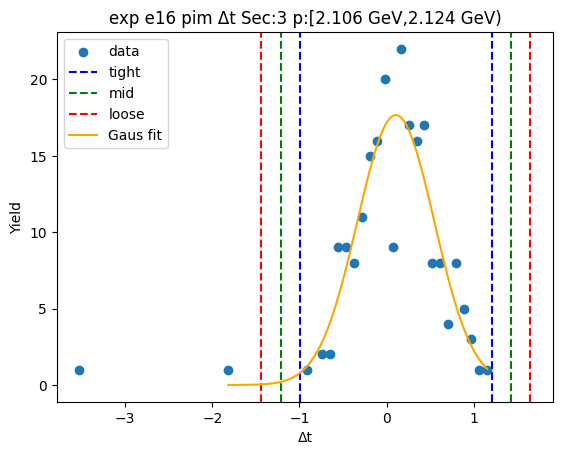

-0.8649526972310073 1.1536662209754018
-1.0668145890516483 1.3555281127960428
-1.2686764808722892 1.5573900046166838


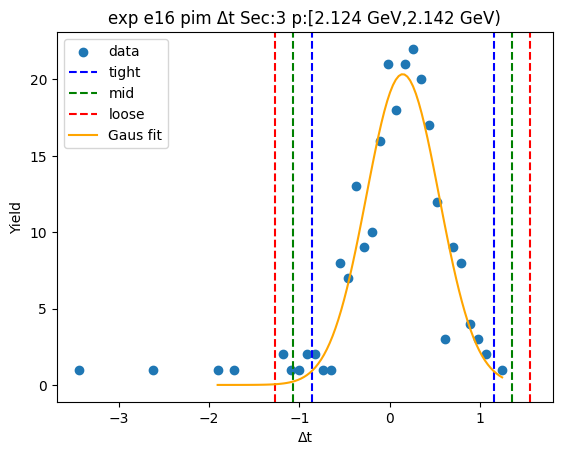

-0.9422899826205874 1.1213642391676704
-1.1486554047994129 1.327729661346496
-1.3550208269782387 1.5340950835253218


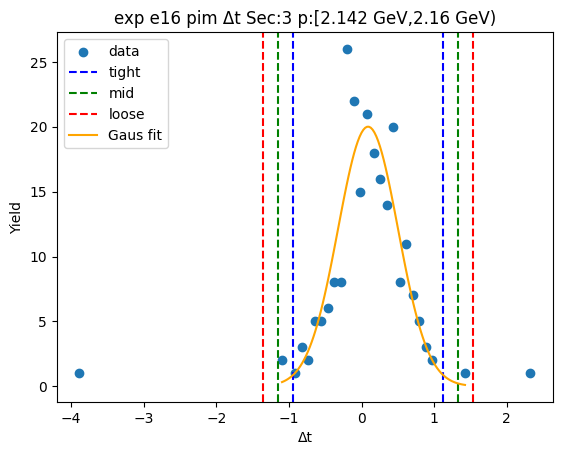

-0.8454822177473205 1.0816822281779106
-1.0381986623398436 1.2743986727704335
-1.2309151069323667 1.4671151173629566


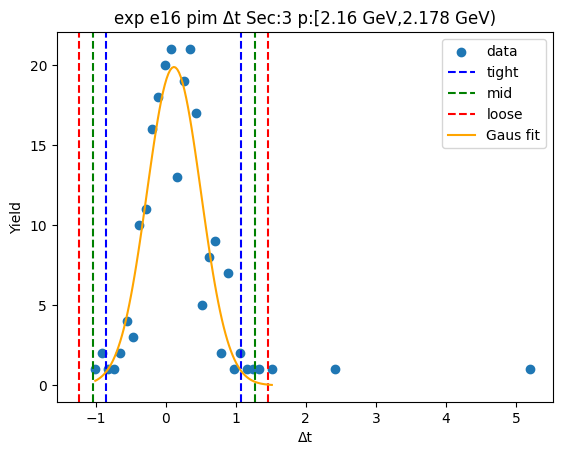

-0.8818478737684685 1.272692455847906
-1.097301906730106 1.4881464888095435
-1.3127559396917434 1.703600521771181


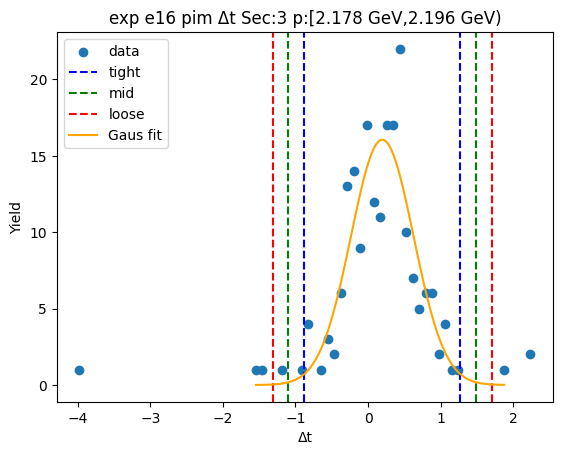

-1.090060868777336 1.359011447349853
-1.334968100390055 1.603918678962572
-1.5798753320027739 1.8488259105752907


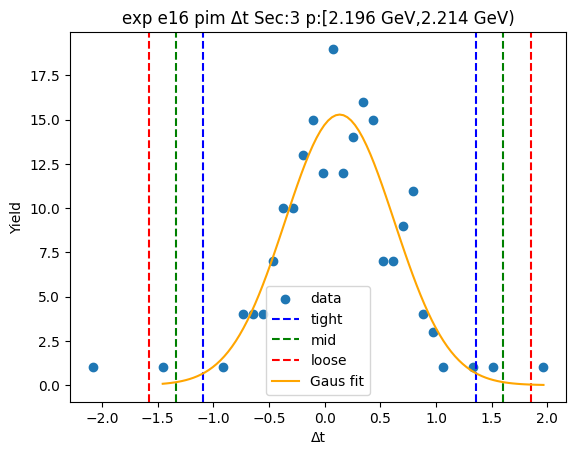

-0.9356990470514324 1.211032340594915
-1.150372185816067 1.4257054793595496
-1.3650453245807017 1.6403786181241844


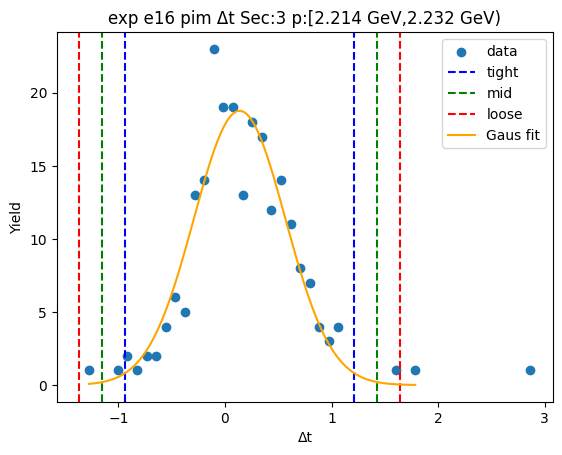

-0.609352492555856 0.985680312882705
-0.7688557730997121 1.145183593426561
-0.9283590536435682 1.3046868739704172


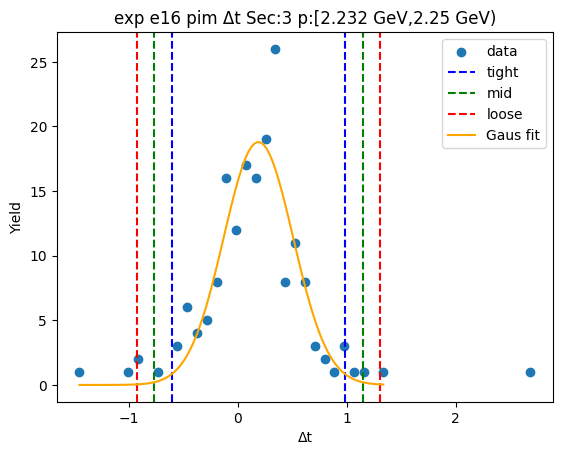

-0.8609421314331174 1.2602975364355404
-1.0730660982199831 1.4724215032224062
-1.2851900650068488 1.684545470009272


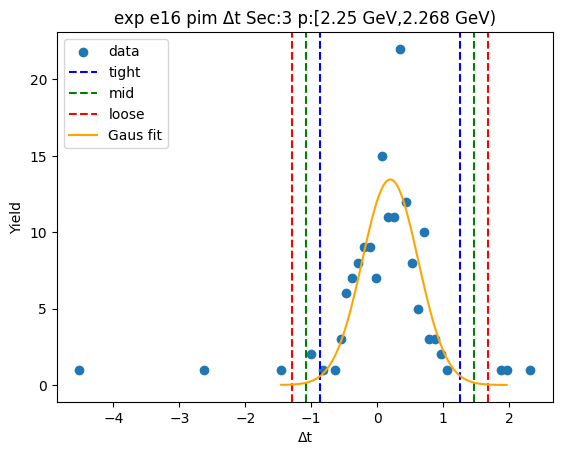

-0.8215889255670003 1.276757977209467
-1.031423615844647 1.486592667487114
-1.241258306122294 1.6964273577647604


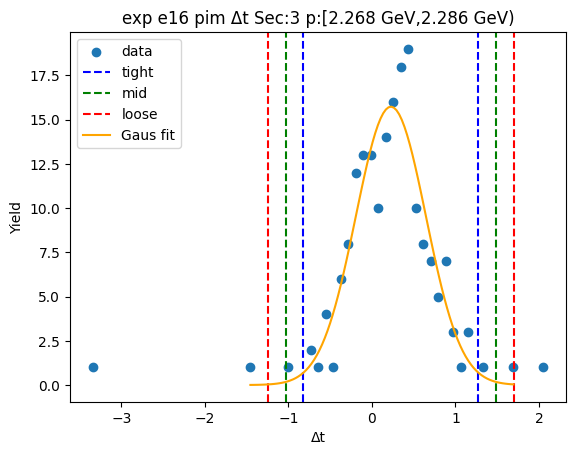

-0.8998638843346416 1.1204441764970385
-1.1018946904178097 1.3224749825802067
-1.3039254965009779 1.5245057886633748


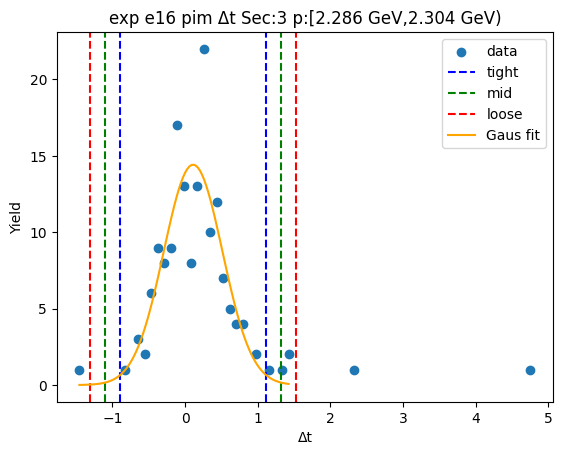

-0.7524453516281626 1.2437829781823293
-0.9520681846092118 1.4434058111633783
-1.151691017590261 1.6430286441444275


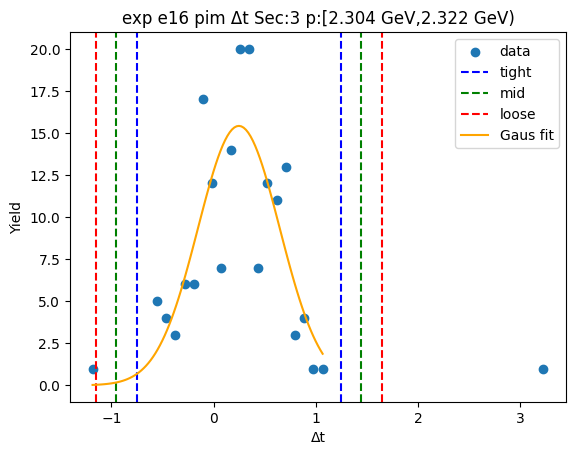

-0.7459860263191863 1.1594248276696457
-0.9365271117180697 1.349965913068529
-1.1270681971169527 1.5405069984674122


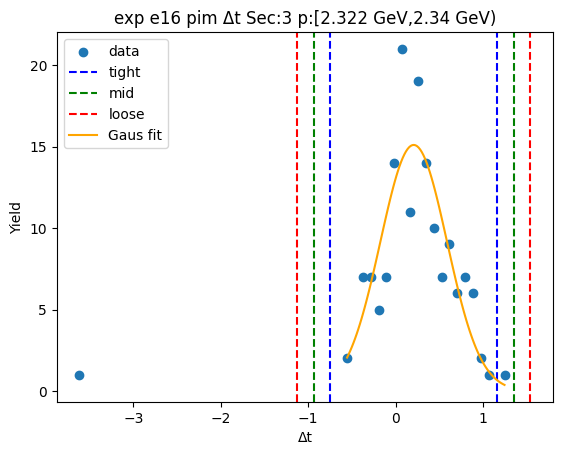

-0.8178886802279275 1.185103858049086
-1.0181879340556288 1.3854031118767873
-1.21848718788333 1.5857023657044886


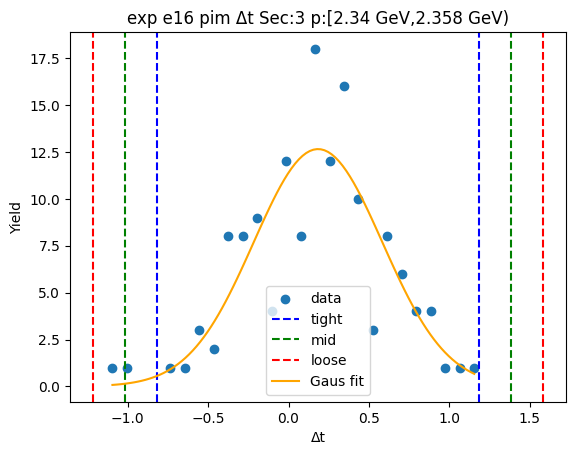

-0.6436437686093148 1.2196237621552473
-0.8299705216857711 1.4059505152317036
-1.0162972747622272 1.5922772683081596


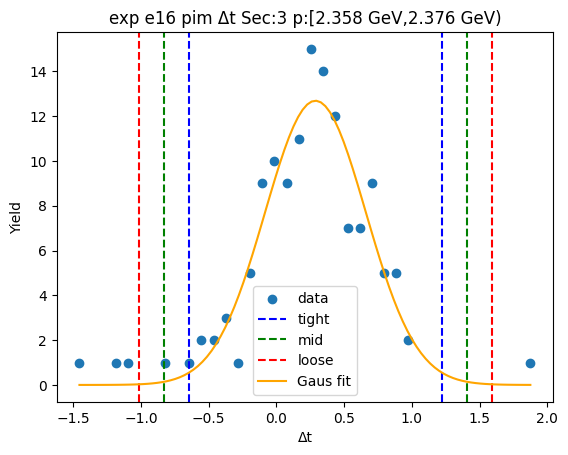

-0.7391270275126589 1.2818229777074321
-0.9412220280346681 1.4839179782294414
-1.1433170285566774 1.6860129787514506


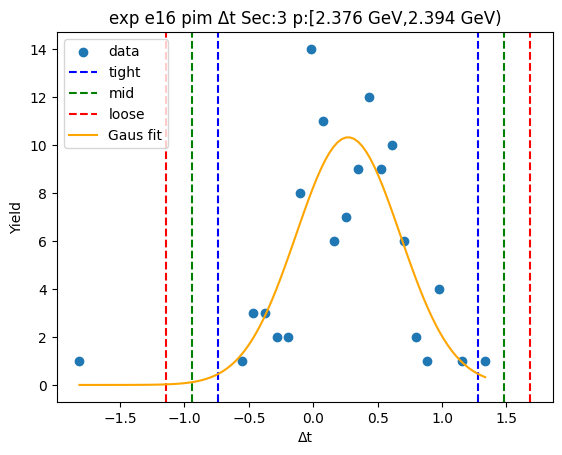

1.3670764168597689 -1.4016439336200874
1.6439484519077545 -1.678515968668073
1.9208204869557401 -1.9553880037160587


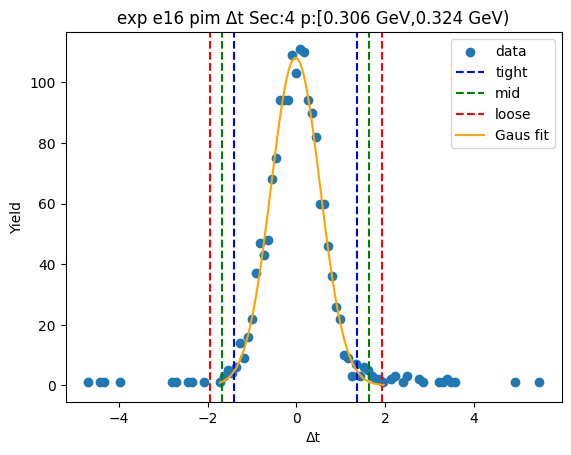

1.3343223775383517 -1.3944203627830325
1.6071966515704903 -1.667294636815171
1.8800709256026287 -1.9401689108473095


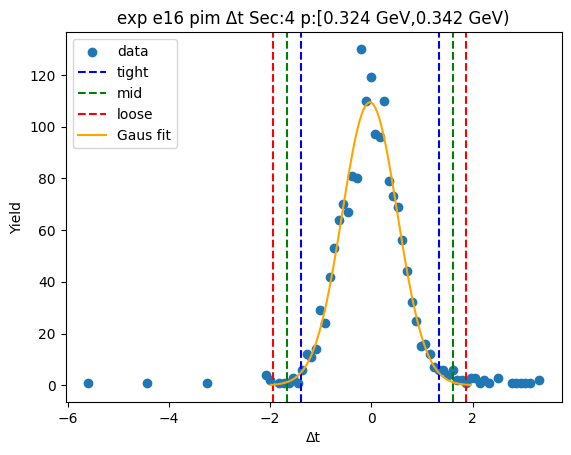

1.3565661422270312 -1.295261731869435
1.6217489296366778 -1.5604445192790817
1.8869317170463245 -1.8256273066887283


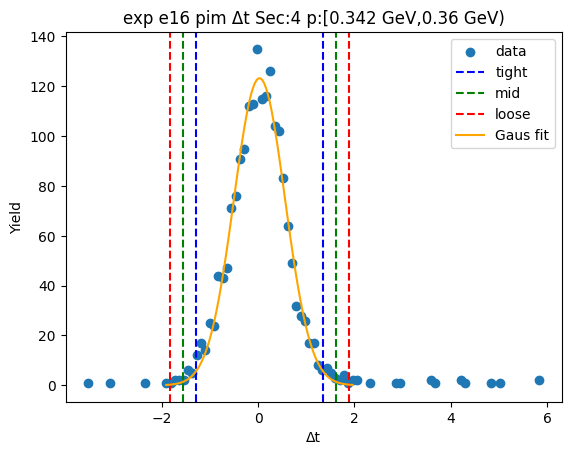

1.3696510270844346 -1.3480108384523917
1.641417213638117 -1.6197770250060741
1.9131834001917998 -1.8915432115597568


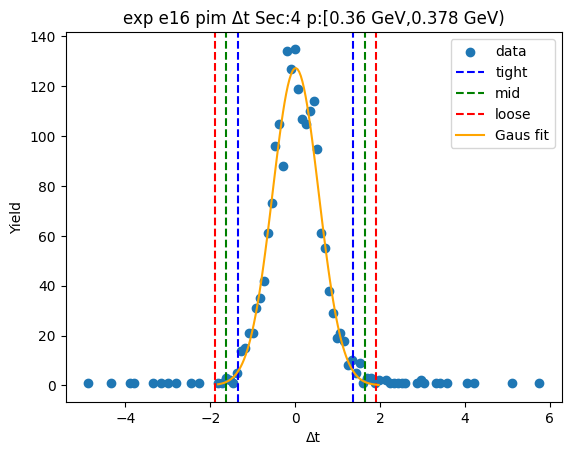

1.3686991712525454 -1.3317198029352433
1.6387410686713244 -1.6017617003540223
1.9087829660901032 -1.8718035977728011


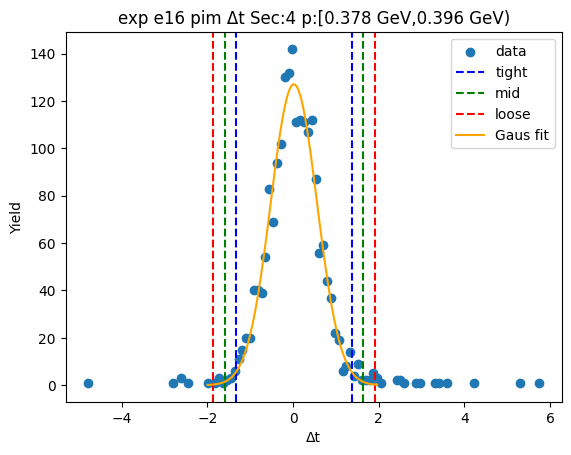

1.3855296052275583 -1.297928649722318
1.653875430722546 -1.5662744752173057
1.9222212562175338 -1.8346203007122934


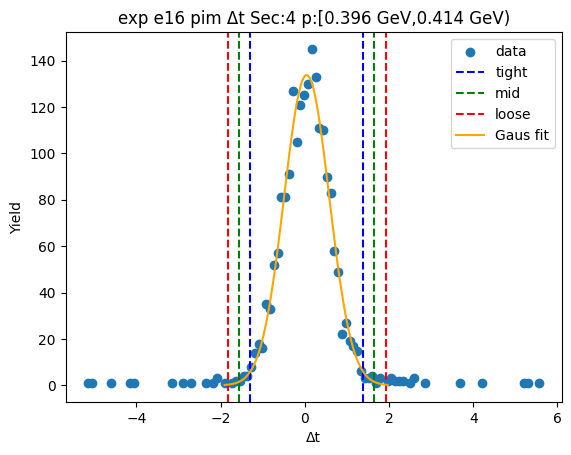

1.3683062940055795 -1.2568582817477654
1.630822751580914 -1.5193747393230999
1.8933392091562484 -1.7818911968984343


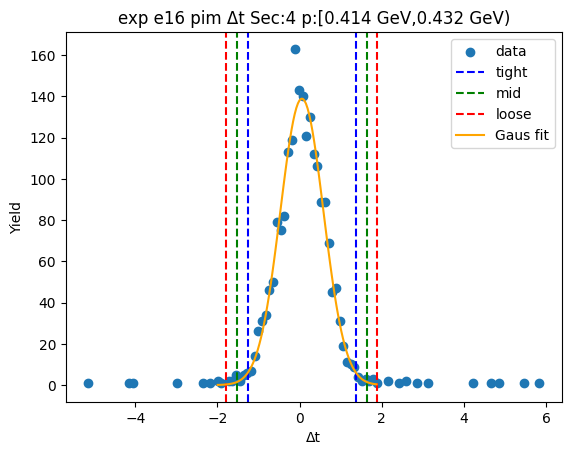

1.37574328358854 -1.247375014341592
1.6380551133815533 -1.5096868441346054
1.9003669431745664 -1.7719986739276186


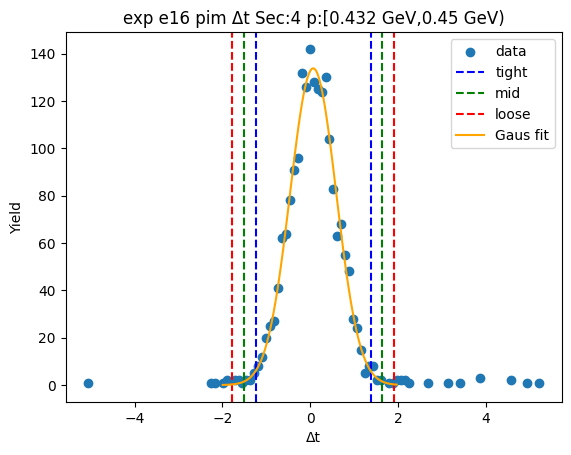

1.4038391254304377 -1.2215521676195098
1.6663782547354322 -1.4840912969245044
1.928917384040427 -1.7466304262294992


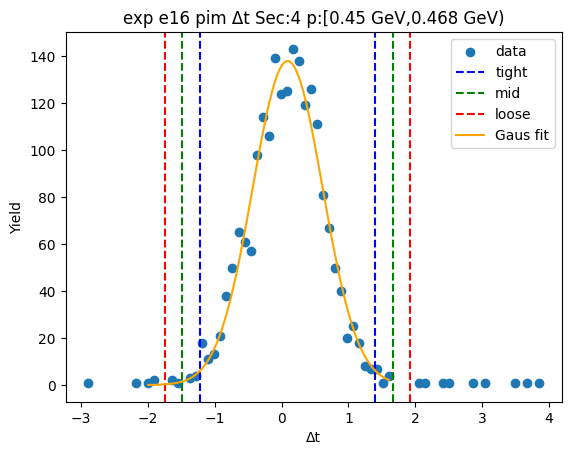

1.378081366750396 -1.16529346216789
1.6324188496422247 -1.4196309450597189
1.8867563325340533 -1.6739684279515474


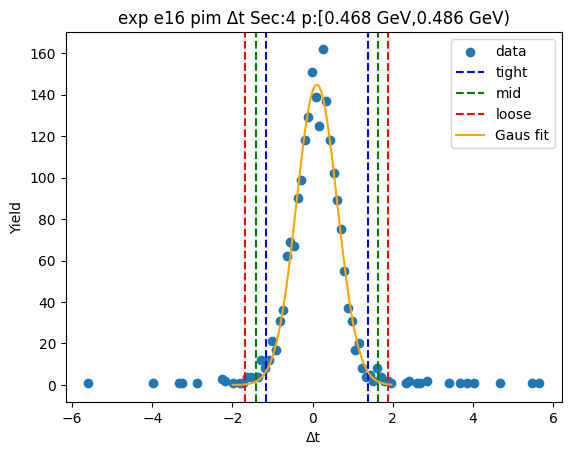

1.3641694350347968 -1.2230865302543672
1.6228950315637134 -1.4818121267832838
1.8816206280926298 -1.7405377233122001


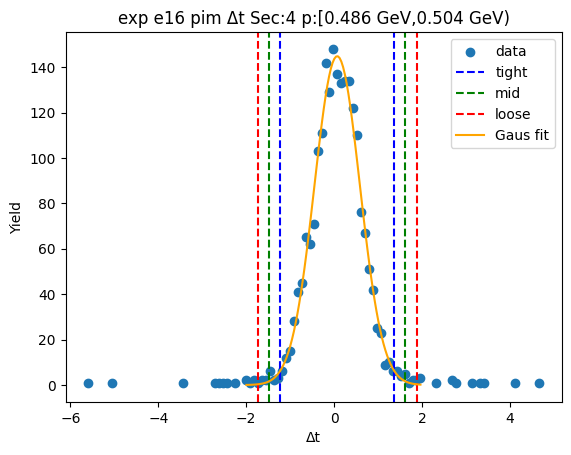

1.3765783699108585 -1.14201760707438
1.6284379676093823 -1.3938772047729038
1.8802975653079061 -1.6457368024714276


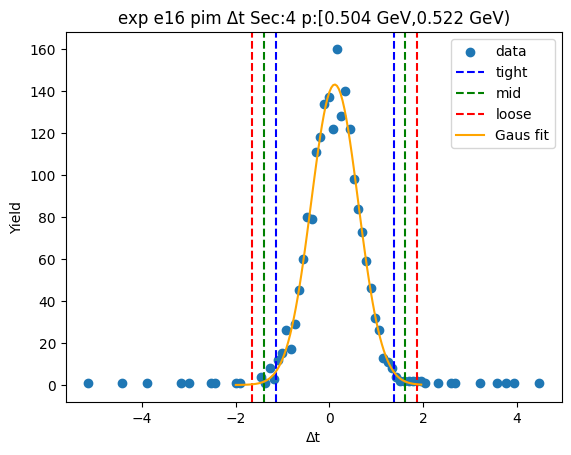

1.3715746014952737 -1.1749198966928456
1.6262240513140858 -1.4295693465116577
1.8808735011328976 -1.6842187963304696


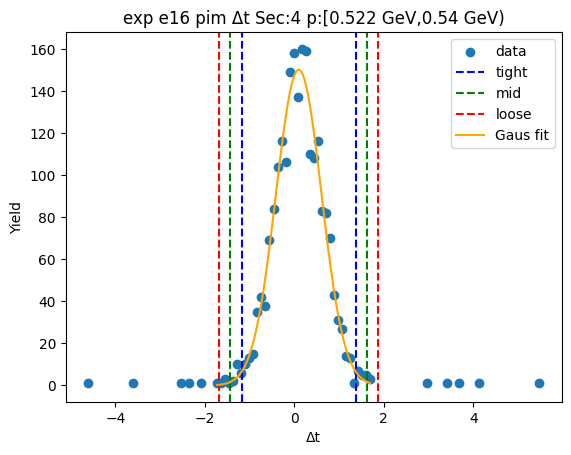

1.3416109632562543 -1.086862519026149
1.5844583114844948 -1.3297098672543894
1.827305659712735 -1.5725572154826297


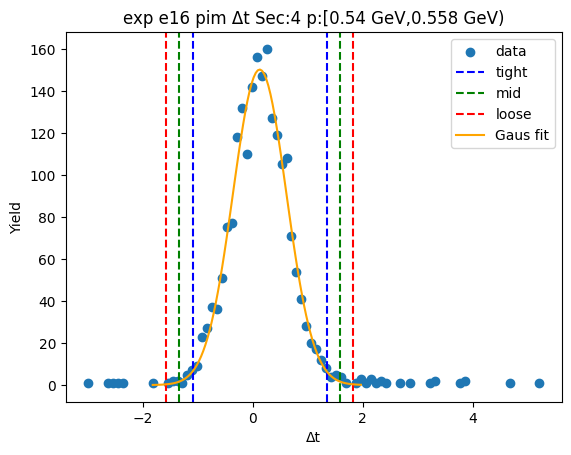

1.3789269113911995 -1.1054851610713474
1.627368118637454 -1.353926368317602
1.8758093258837087 -1.6023675755638567


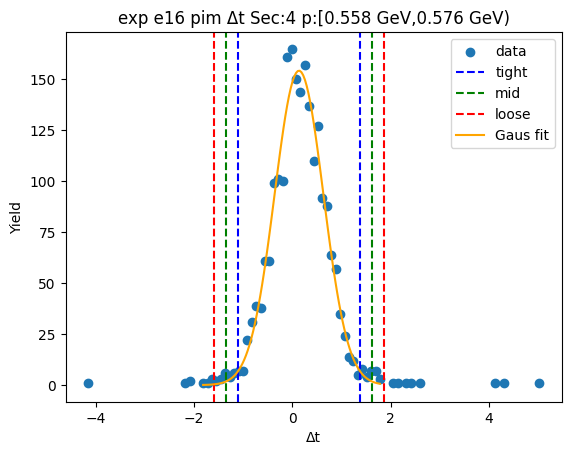

1.356533248080817 -1.0419282402985357
1.596379396918752 -1.2817743891364708
1.8362255457566874 -1.521620537974406


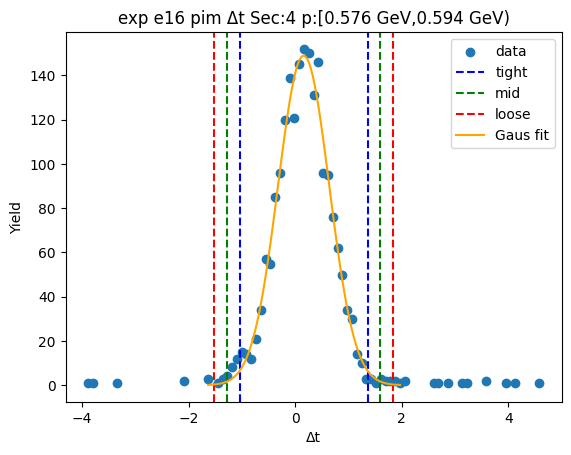

1.3886358181396914 -1.0627148947084089
1.6337708894245015 -1.307849965993219
1.8789059607093117 -1.5529850372780292


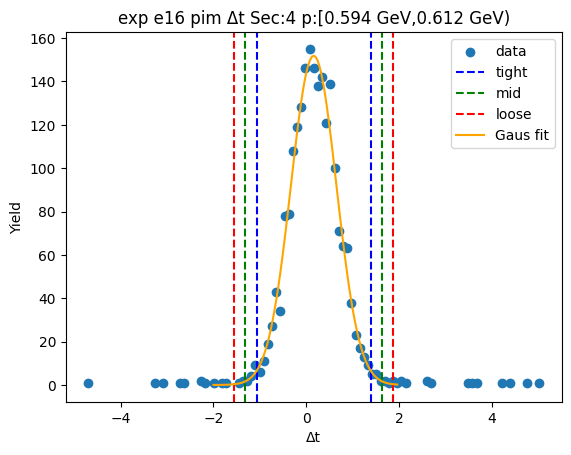

1.3244178292707987 -0.9948343401347413
1.5563430462113528 -1.2267595570752954
1.788268263151907 -1.4586847740158495


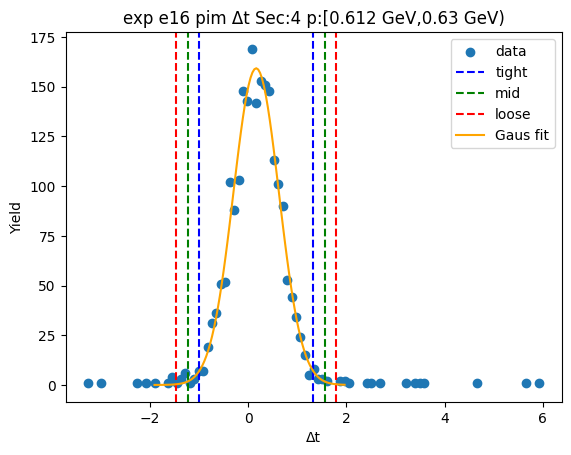

1.3916853484303773 -1.0830558986356098
1.6391594731369759 -1.3305300233422084
1.8866335978435744 -1.578004148048807


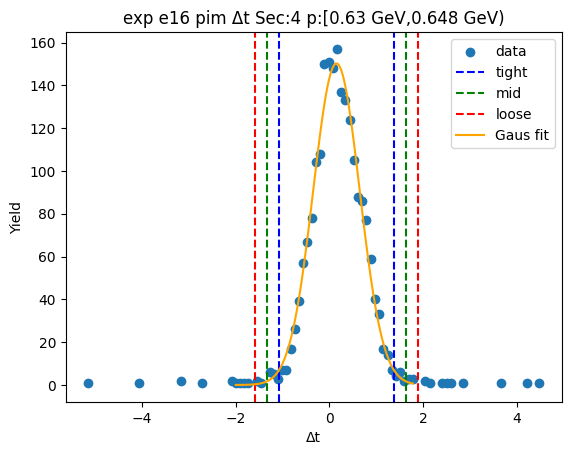

1.3767401980750893 -1.0701595611217949
1.6214301739947778 -1.3148495370414834
1.8661201499144664 -1.559539512961172


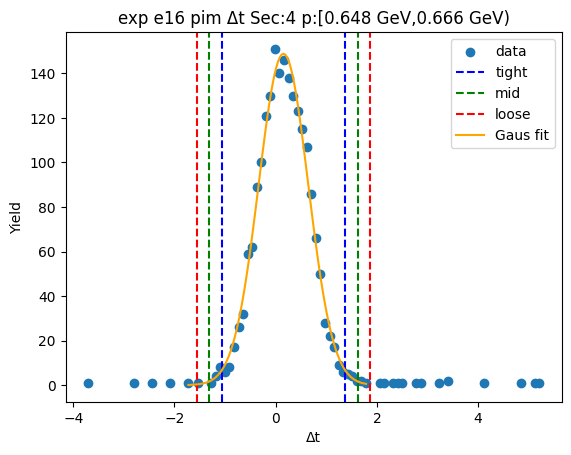

1.3953437895935834 -1.0533948410345682
1.6402176526563985 -1.2982687040973833
1.8850915157192136 -1.5431425671601984


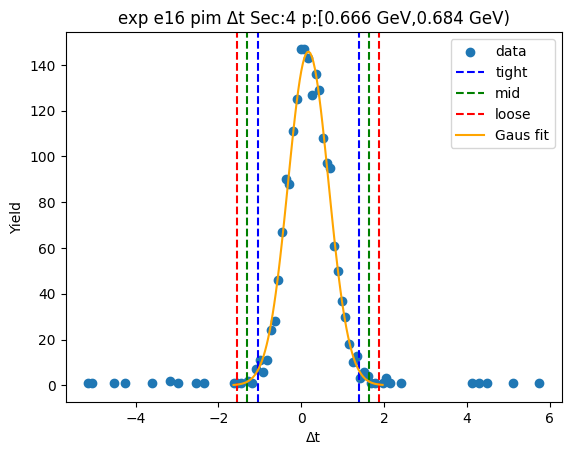

1.3819366408132814 -1.0731458208155125
1.6274448869761609 -1.318654066978392
1.87295313313904 -1.5641623131412712


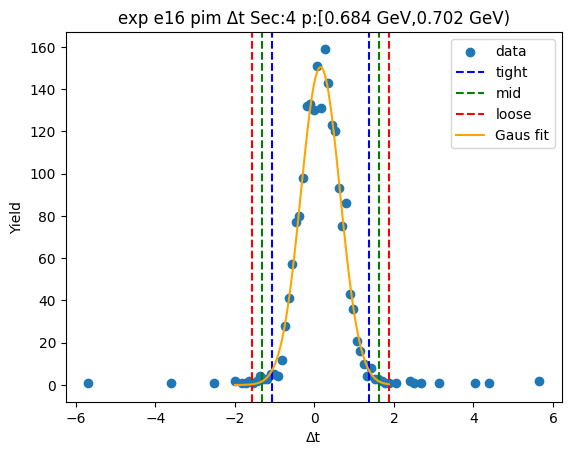

1.384138887513699 -1.0610495996954352
1.6286577362346124 -1.3055684484163486
1.8731765849555257 -1.5500872971372623


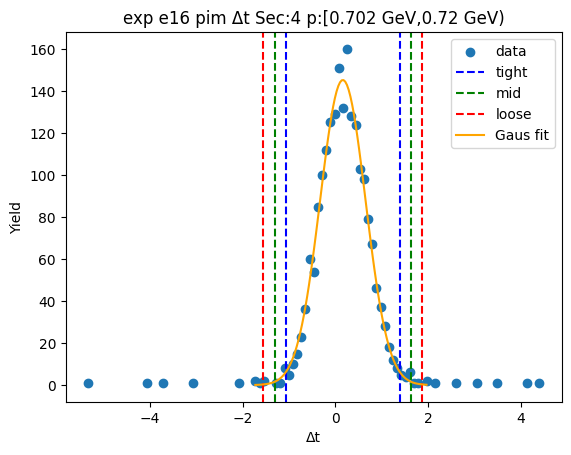

1.4327943768179423 -1.0604159514802383
1.6821154096477602 -1.3097369843100561
1.9314364424775783 -1.5590580171398742


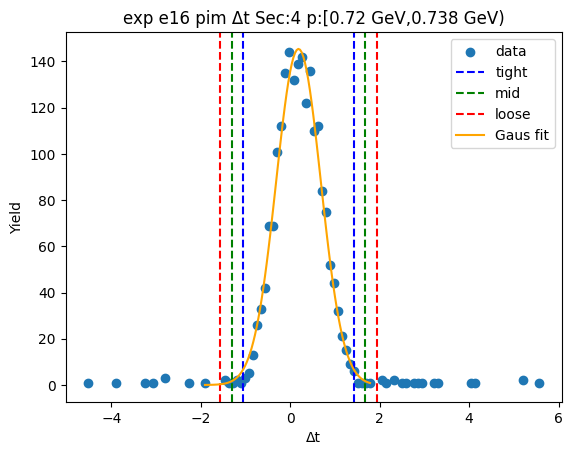

1.3712326309562468 -1.0440840954390356
1.612764303595775 -1.2856157680785638
1.8542959762353033 -1.527147440718092


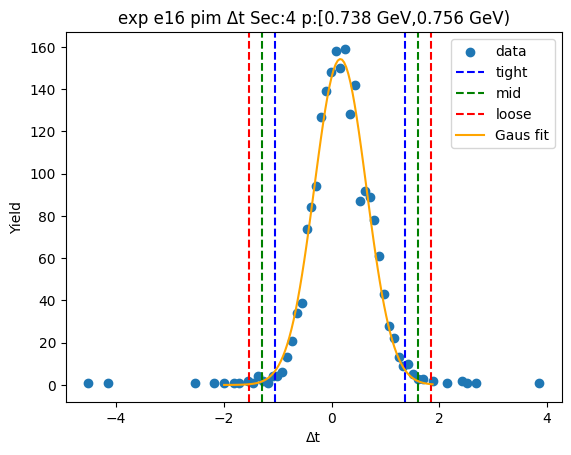

1.41504007788401 -1.0526401360000588
1.6618080992724167 -1.2994081573884655
1.9085761206608236 -1.5461761787768724


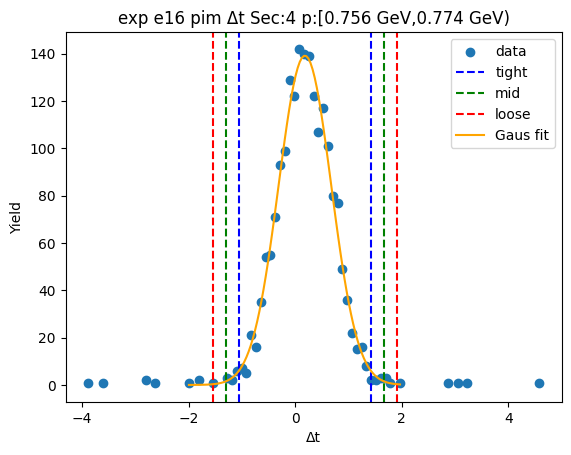

1.391307568098657 -1.0757653985651314
1.638014864765036 -1.3224726952315105
1.884722161431415 -1.5691799918978893


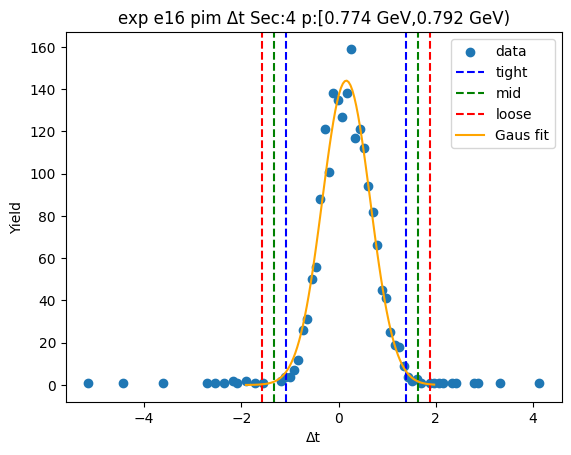

1.3841028143696923 -1.0331378619360543
1.625826882000267 -1.274861929566629
1.8675509496308416 -1.5165859971972036


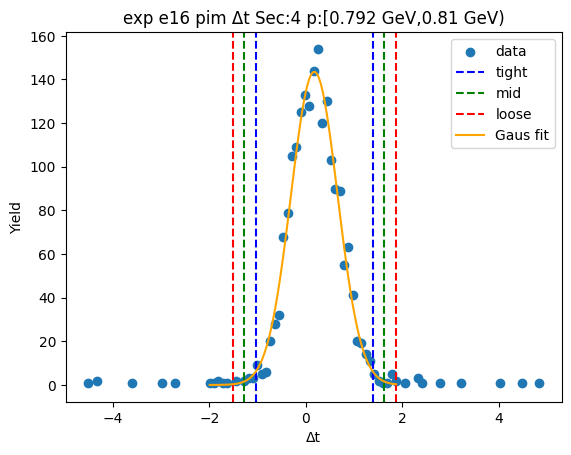

1.3591351503045166 -0.9939796793411743
1.594446633269086 -1.2292911623057434
1.8297581162336551 -1.4646026452703125


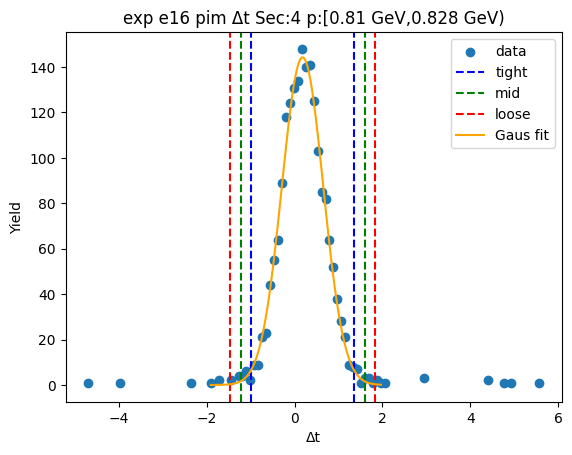

1.3804686917647053 -1.0279473306029228
1.6213102940014683 -1.2687889328396857
1.862151896238231 -1.5096305350764485


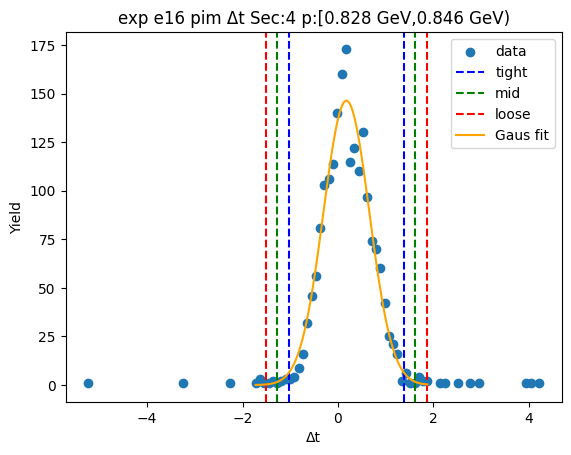

1.375067460199312 -1.0009122919692555
1.612665435416169 -1.2385102671861123
1.8502634106330258 -1.4761082424029692


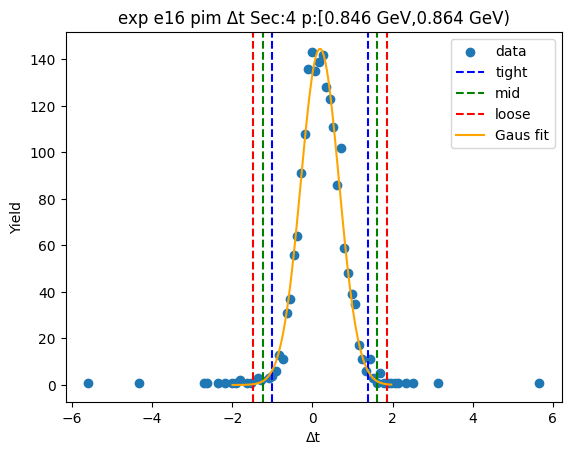

1.4692022083386977 -1.0604786744879766
1.722170296621365 -1.3134467627706439
1.9751383849040325 -1.5664148510533114


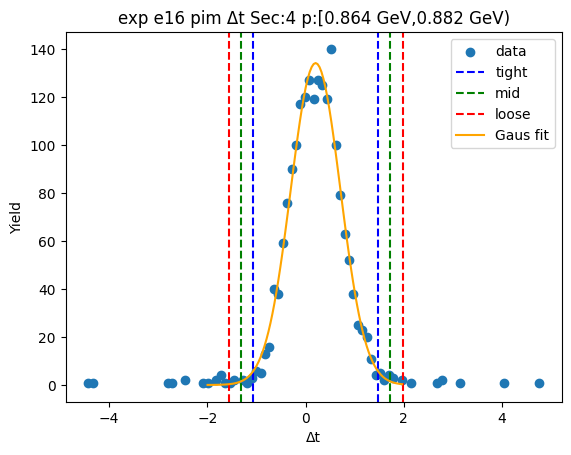

1.4430146731647786 -1.0565451633561838
1.692970656816875 -1.3065011470082801
1.9429266404689713 -1.5564571306603765


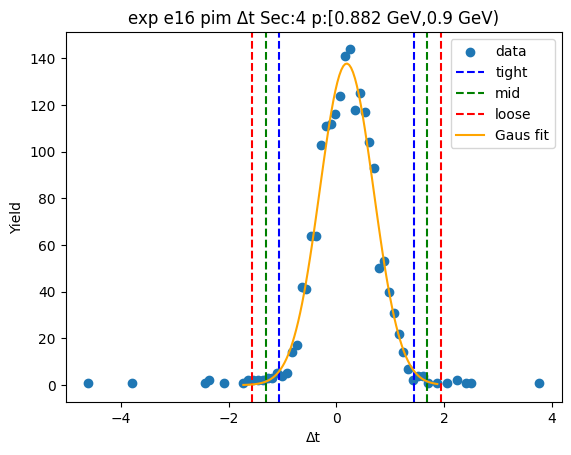

1.4929787580355147 -1.0646009785626105
1.748736731695327 -1.3203589522224228
2.00449470535514 -1.5761169258822354


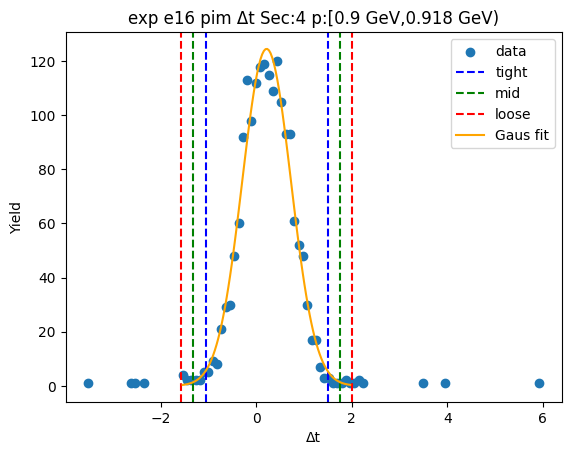

1.3977519027667358 -1.021206833475542
1.6396477763909636 -1.2631027070997698
1.8815436500151914 -1.5049985807239976


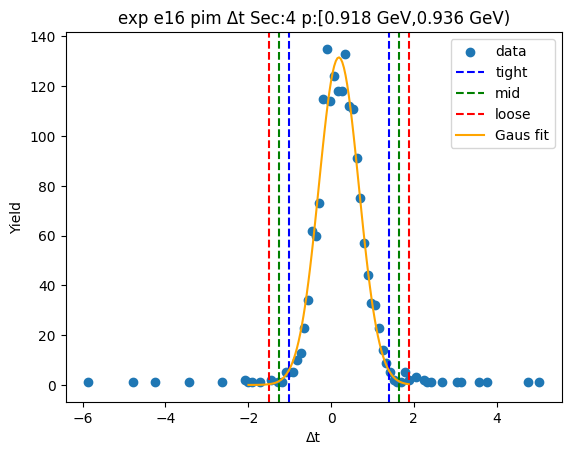

1.4619946654588847 -1.022195914156811
1.7104137234204544 -1.2706149721183808
1.958832781382024 -1.5190340300799505


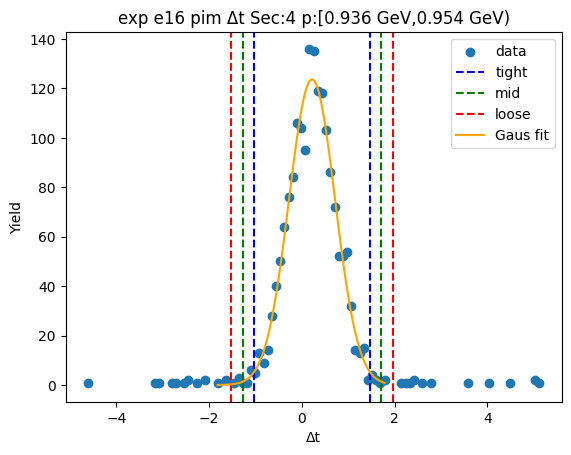

1.4170259950958015 -1.0699763680691352
1.6657262314122951 -1.3186766043856288
1.9144264677287888 -1.5673768407021225


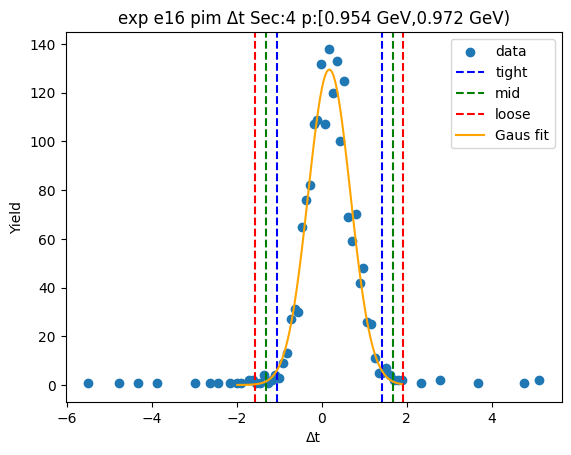

1.4817977528924047 -1.0955751087117593
1.7395350390528213 -1.353312394872176
1.9972723252132376 -1.6110496810325923


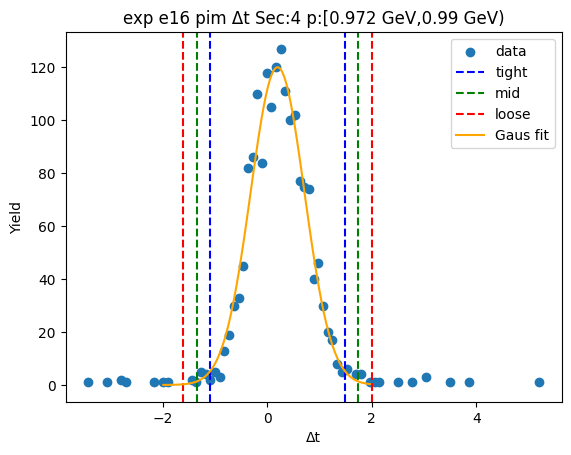

1.5057658602948734 -1.0977049812381101
1.7661129444481716 -1.3580520653914083
2.02646002860147 -1.6183991495447065


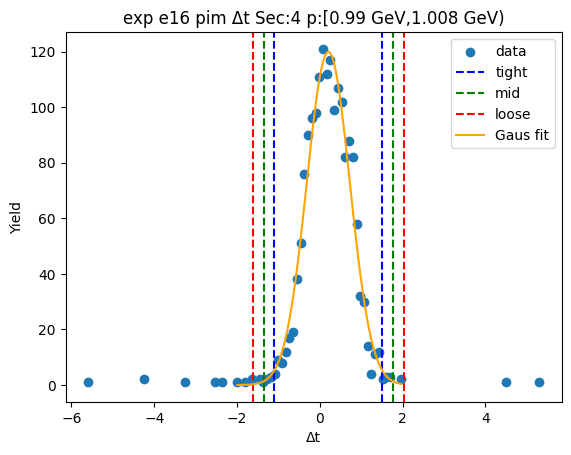

1.4728783035880275 -0.979964487780687
1.718162582724899 -1.2252487669175585
1.9634468618617704 -1.47053304605443


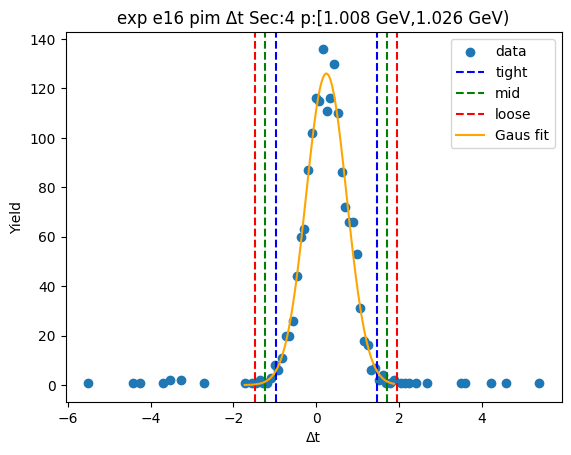

1.512745998362834 -1.0409170536748902
1.7681123035666062 -1.2962833588786624
2.0234786087703784 -1.5516496640824349


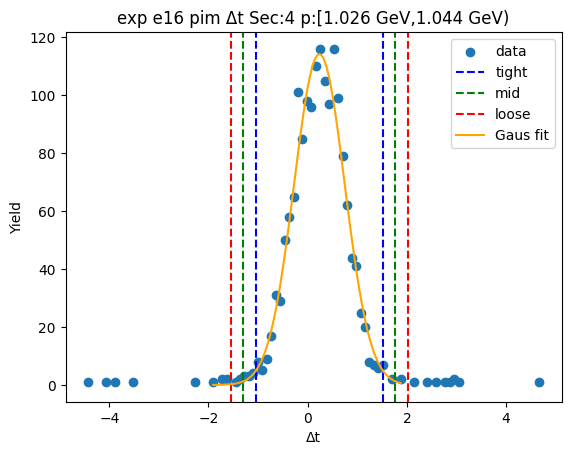

1.5015001244856658 -1.0263509898049294
1.7542852359147252 -1.2791361012339888
2.0070703473437845 -1.5319212126630484


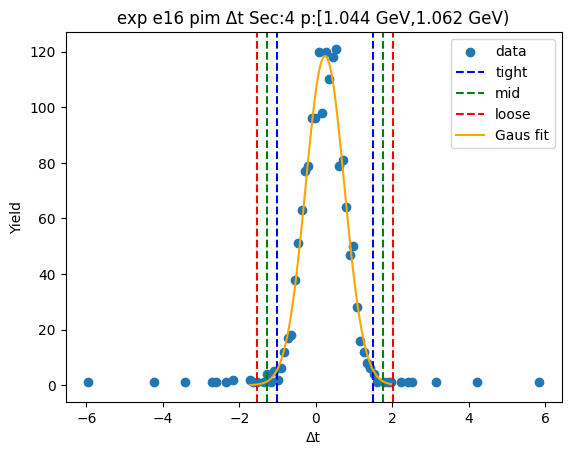

1.491257815845032 -1.072516131899012
1.7476352106194366 -1.3288935266734165
2.004012605393841 -1.585270921447821


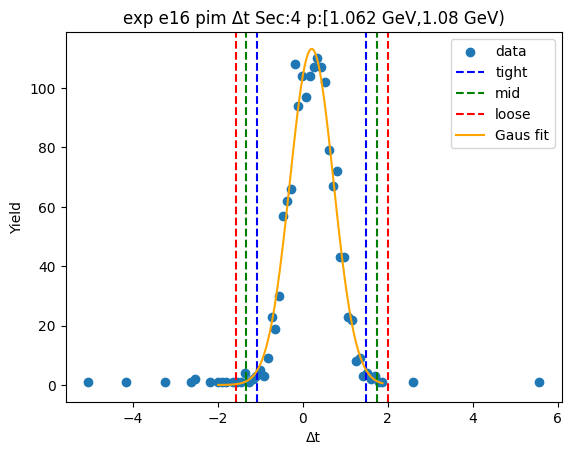

1.4634916462356025 -1.0184499135522314
1.7116858022143857 -1.2666440695310146
1.959879958193169 -1.5148382255097979


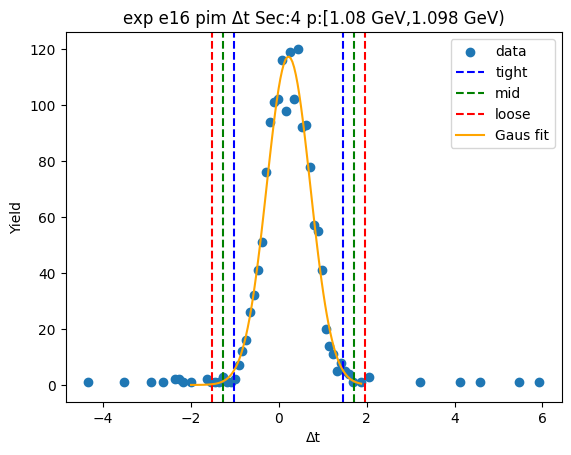

1.5132191489784919 -1.0650819530382643
1.7710492591801676 -1.32291206323994
2.028879369381843 -1.5807421734416156


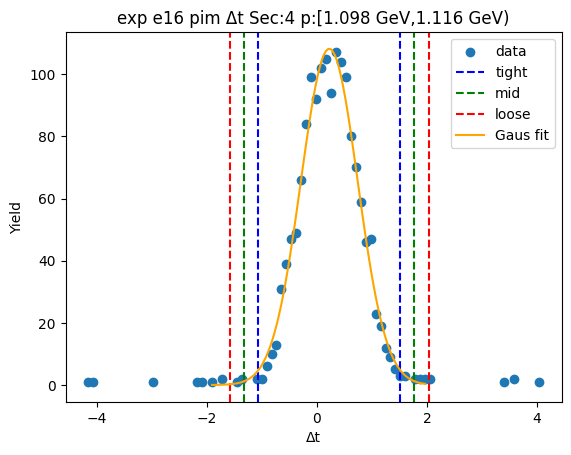

1.5335351546555518 -1.0725571263143043
1.7941443827525374 -1.33316635441129
2.054753610849523 -1.5937755825082756


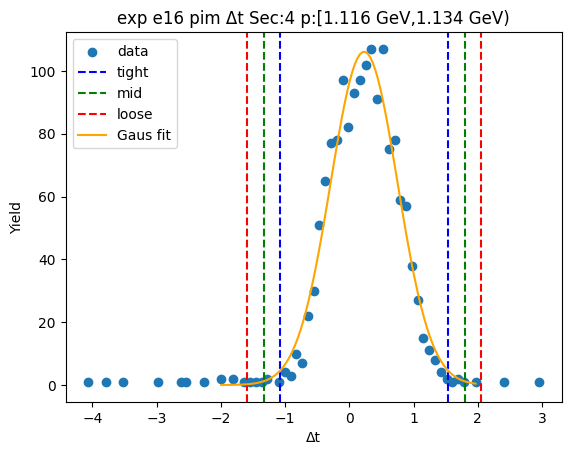

1.551947995560666 -1.0780754442764469
1.8149503395443776 -1.3410777882601583
2.0779526835280886 -1.6040801322438696


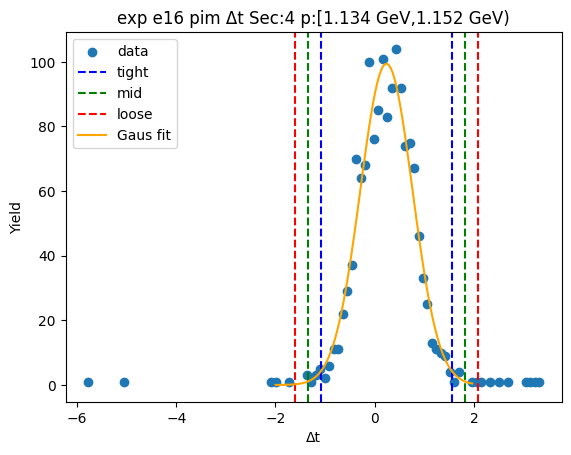

1.5872043610378657 -1.081228752638319
1.8540476724054842 -1.3480720640059372
2.1208909837731027 -1.6149153753735557


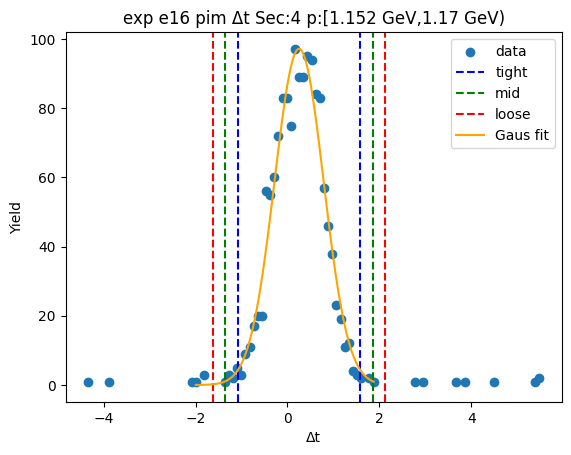

1.536881854490931 -1.0288648682104942
1.7934565267610736 -1.2854395404806367
2.050031199031216 -1.5420142127507792


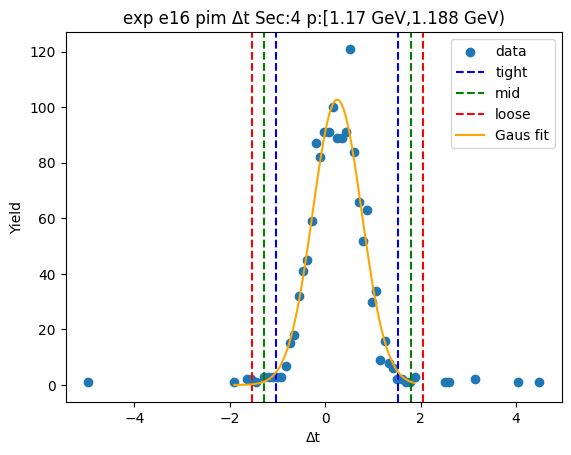

1.5179331923971358 -1.0160998077626204
1.7713364924131112 -1.2695031077785959
2.024739792429087 -1.5229064077945715


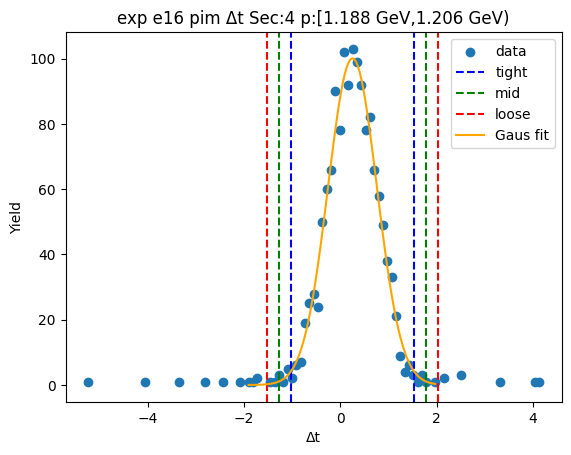

1.5863225353882 -1.0668918741346505
1.851643976340485 -1.3322133150869355
2.11696541729277 -1.5975347560392206


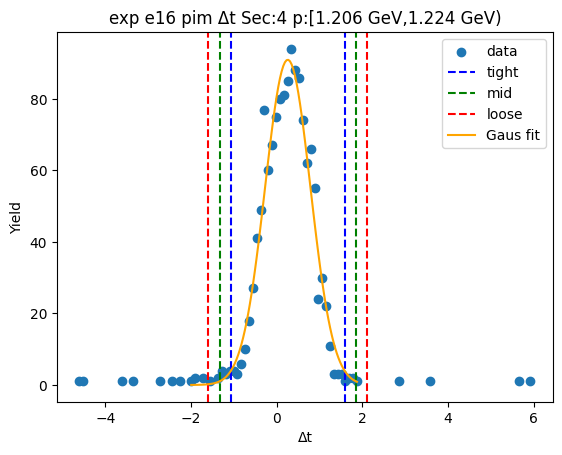

1.63569615230428 -1.139742018456199
1.913239969380328 -1.417285835532247
2.190783786456376 -1.694829652608295


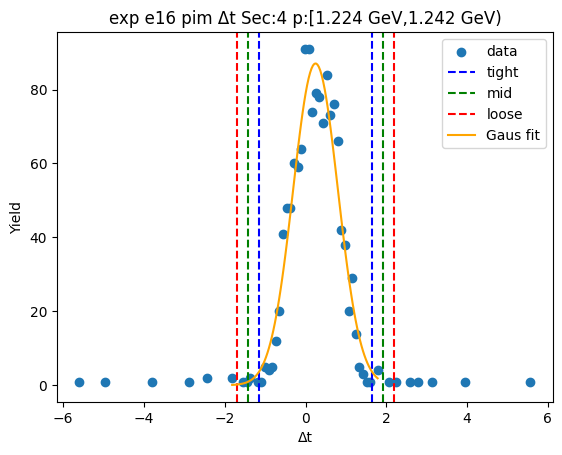

1.550946253875134 -1.0920160784987076
1.8152424871125183 -1.3563123117360916
2.0795387203499023 -1.620608544973476


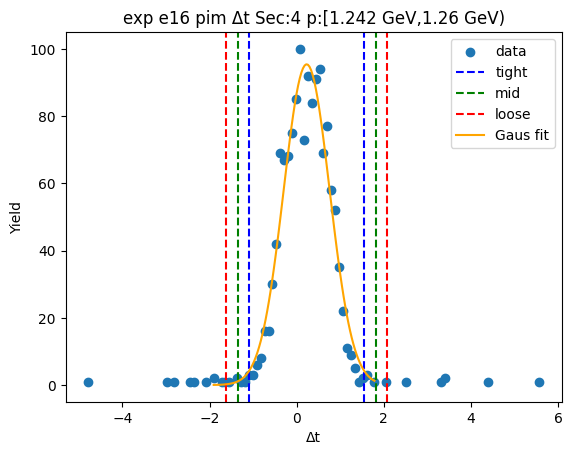

1.5886523489603004 -1.0782469466788704
1.8553422785242173 -1.3449368762427873
2.122032208088134 -1.6116268058067045


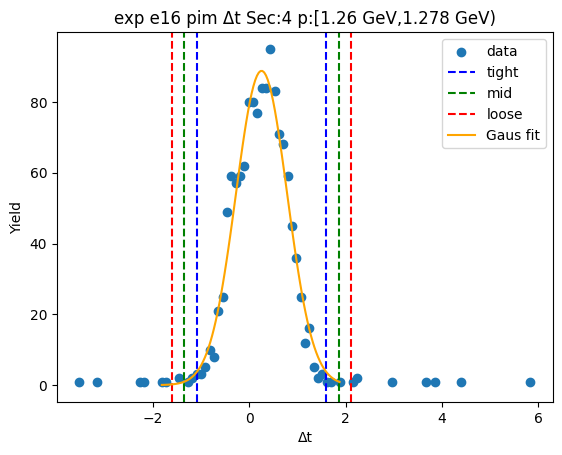

1.5720094732455183 -1.0143309304306949
1.8306435136131398 -1.2729649707983164
2.089277553980761 -1.5315990111659377


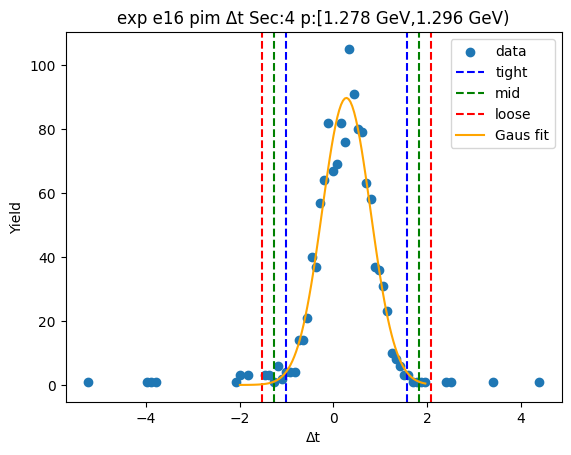

1.5977681795528857 -1.100836926123848
1.8676286901205592 -1.370697436691521
2.1374892006882322 -1.6405579472591945


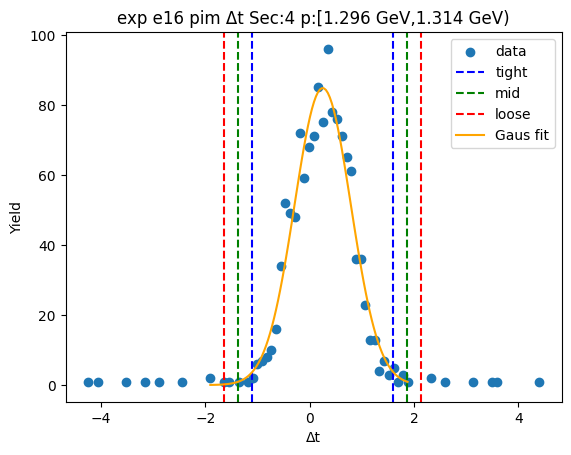

1.6327114456408123 -1.0575097835798801
1.9017335685628813 -1.3265319065019492
2.170755691484951 -1.5955540294240182


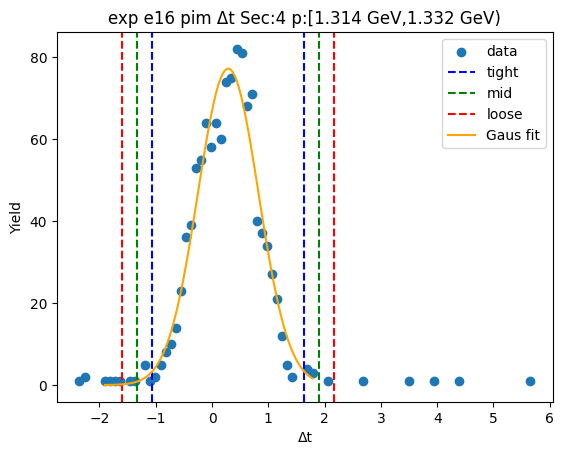

1.5788720715138365 -1.049442024706518
1.841703481135872 -1.3122734343285534
2.1045348907579076 -1.5751048439505888


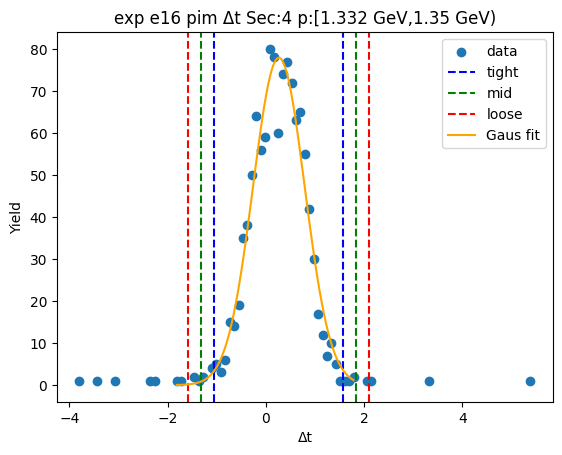

1.5429683741882614 -0.997055493045504
1.796970760911638 -1.2510578797688807
2.0509731476350144 -1.5050602664922572


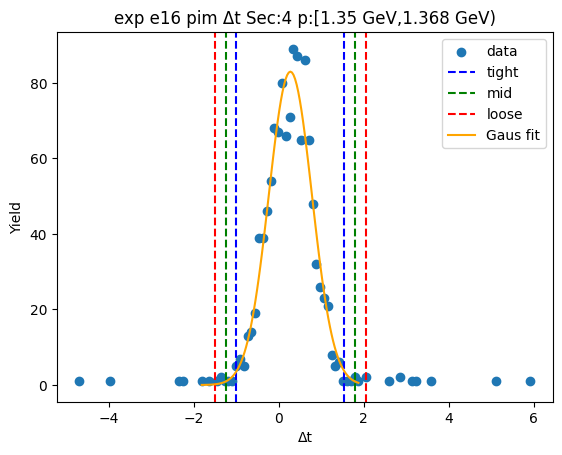

1.5737618336166899 -1.0447088120766261
1.8356088981860215 -1.3065558766459577
2.097455962755353 -1.5684029412152893


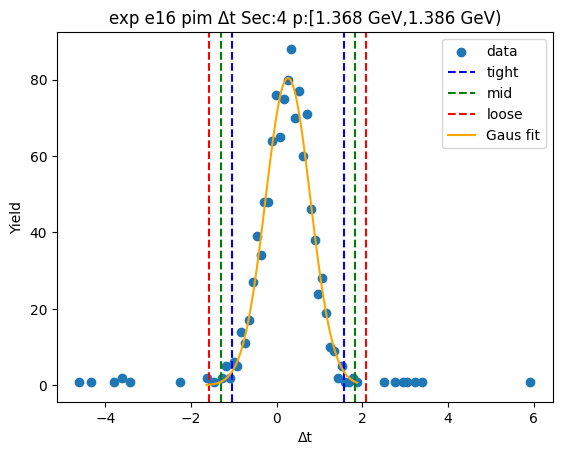

1.6305283723181931 -1.1329061654277819
1.9068718260927908 -1.4092496192023796
2.183215279867388 -1.6855930729769772


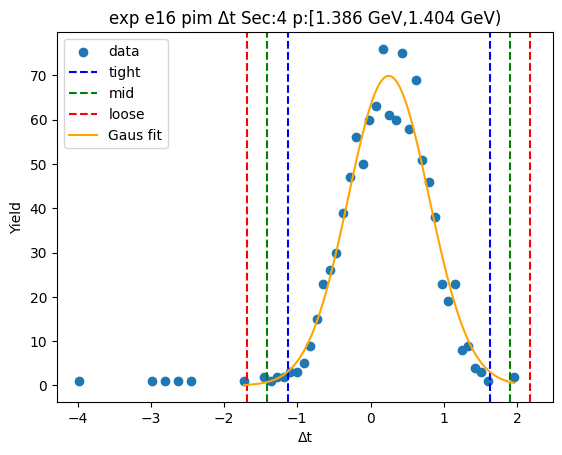

1.5574505231753435 -1.0217881617862294
1.8153743916715006 -1.2797120302823866
2.073298260167658 -1.537635898778544


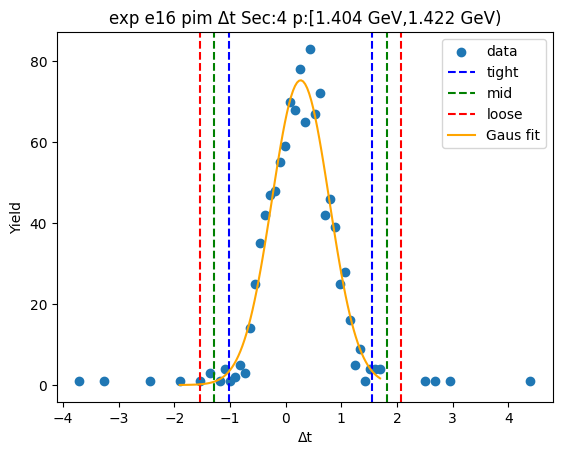

1.6327162925527312 -1.0978174674530448
1.905769668553309 -1.3708708434536225
2.1788230445538863 -1.6439242194542


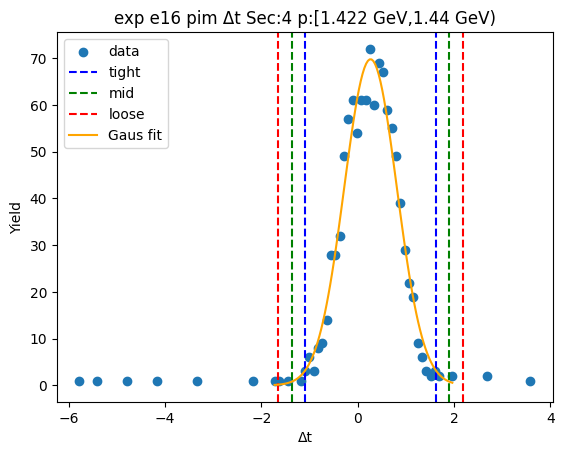

1.6295052972680102 -1.061360592289844
1.8985918862237956 -1.3304471812456293
2.167678475179581 -1.5995337702014147


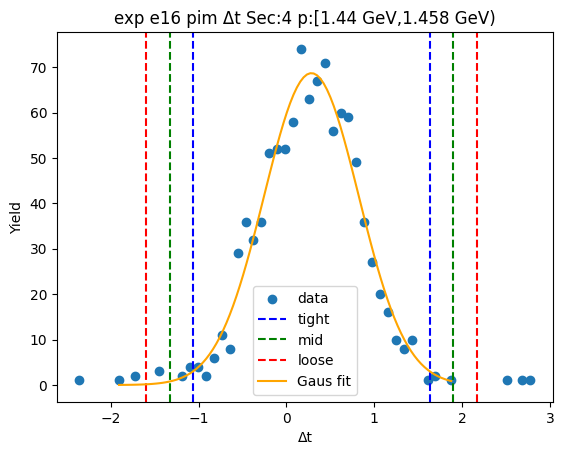

1.6084841939563181 -1.0229388869538891
1.871626502047339 -1.28608119504491
2.1347688101383597 -1.5492235031359307


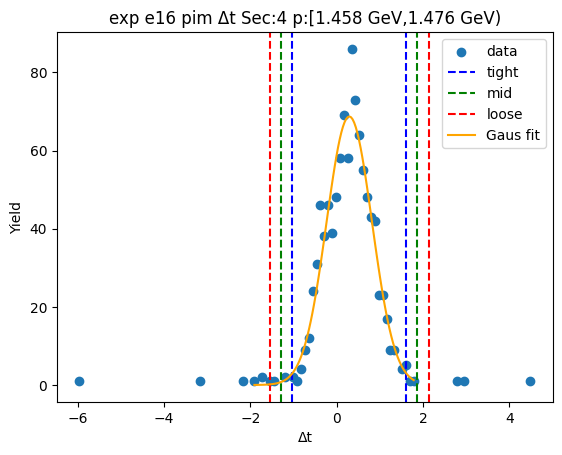

1.659954838135385 -1.0786241621457995
1.9338127381635033 -1.3524820621739178
2.2076706381916216 -1.6263399622020362


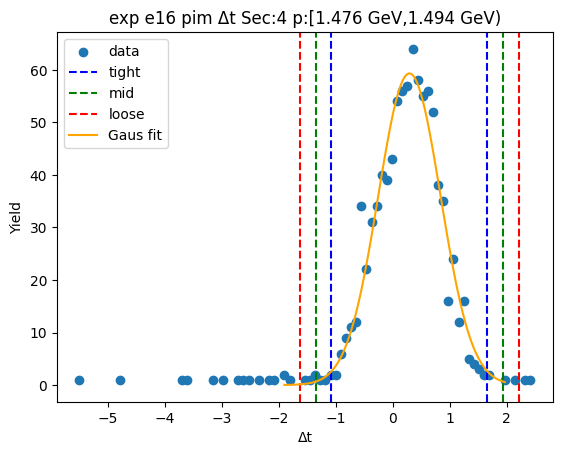

1.6792199299794848 -1.1076332921021073
1.957905252187644 -1.3863186143102666
2.2365905743958034 -1.665003936518426


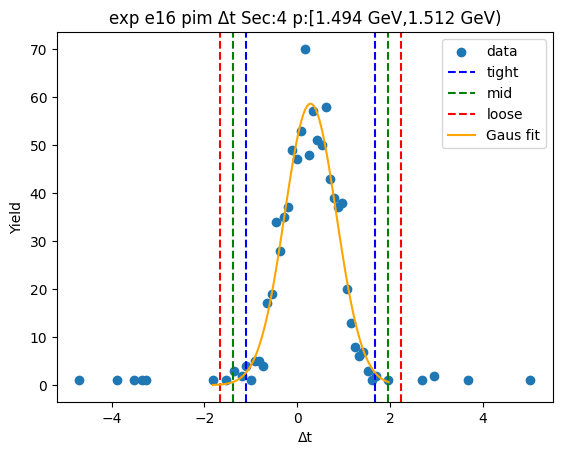

1.5744859023414555 -0.9670672182777484
1.8286412144033757 -1.2212225303396687
2.0827965264652963 -1.475377842401589


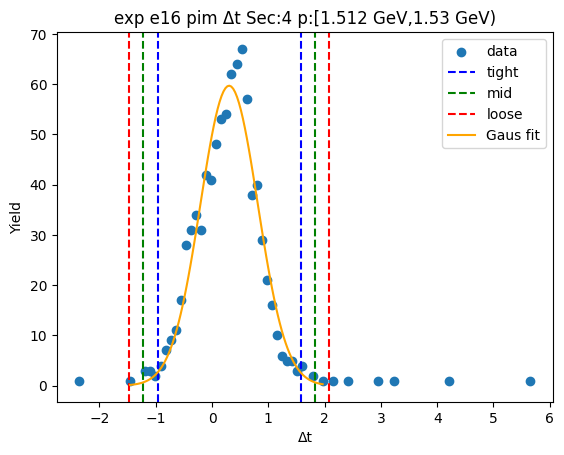

1.6701331845938776 -1.0917554284999922
1.9463220459032644 -1.367944289809379
2.2225109072126514 -1.644133151118766


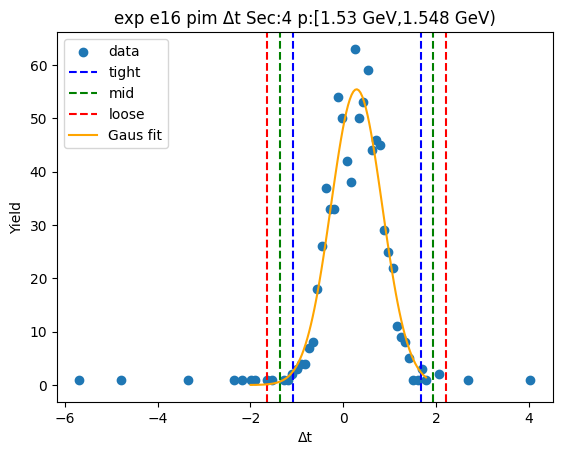

1.6460390700388086 -1.0785322746551764
1.9184962045082072 -1.350989409124575
2.1909533389776055 -1.6234465435939736


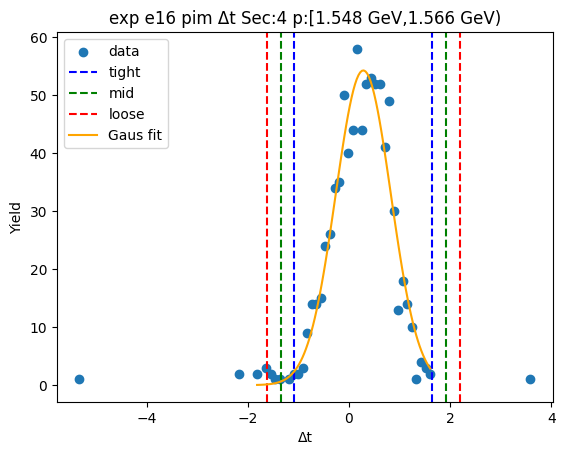

1.5789934410984234 -0.9554813077910864
1.8324409159873742 -1.2089287826800372
2.0858883908763253 -1.4623762575689883


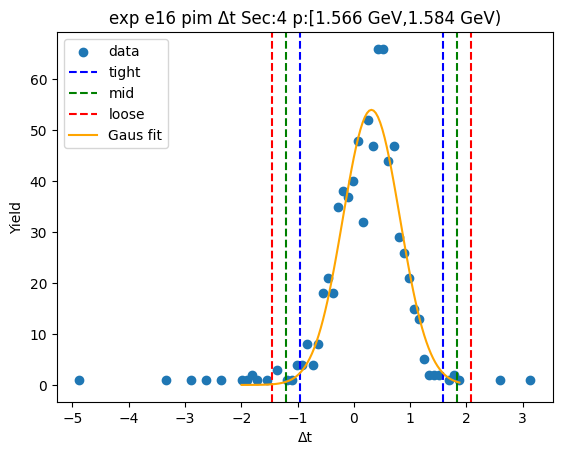

1.6434887251596084 -1.0397016536531658
1.911807763040886 -1.308020691534443
2.1801268009221633 -1.5763397294157206


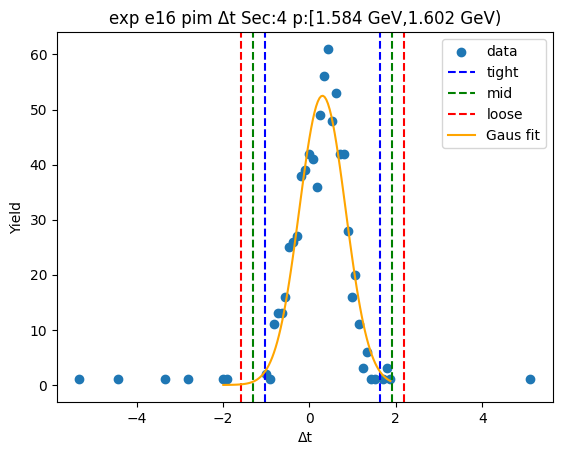

1.5324538516732669 -0.9051588826538817
1.776215125105982 -1.1489201560865967
2.0199763985386965 -1.3926814295193115


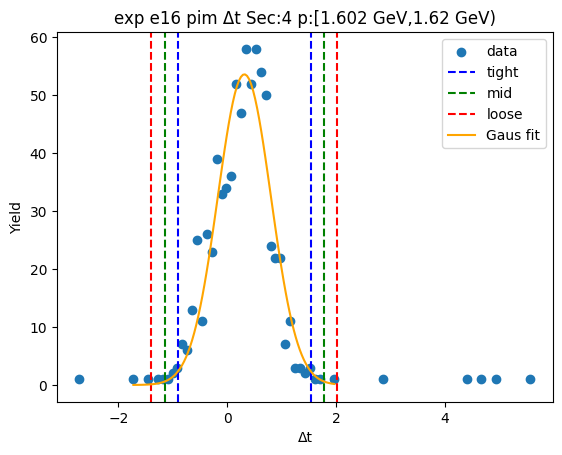

1.6500934263952578 -1.021478006899542
1.9172505697247382 -1.2886351502290219
2.184407713054218 -1.5557922935585018


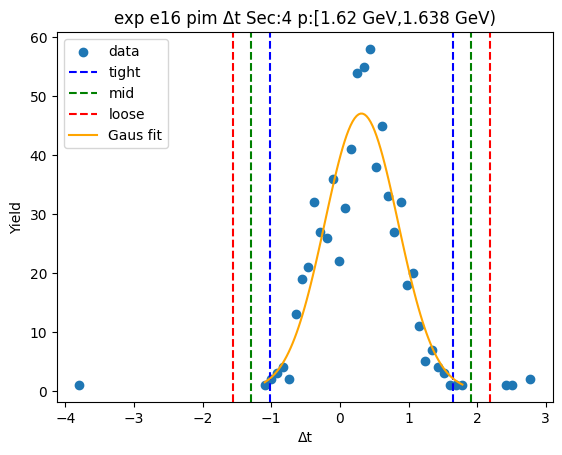

1.5550933390830393 -0.8954889544117589
1.800151568432519 -1.1405471837612389
2.045209797781999 -1.3856054131107185


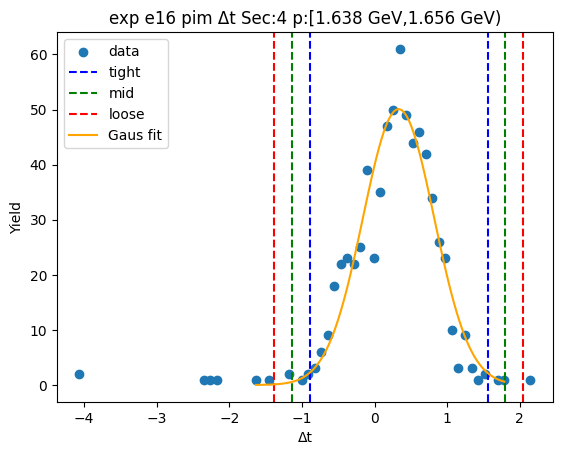

1.7611010900088262 -1.0378603399606483
2.0409972330057737 -1.3177564829575956
2.320893376002721 -1.597652625954543


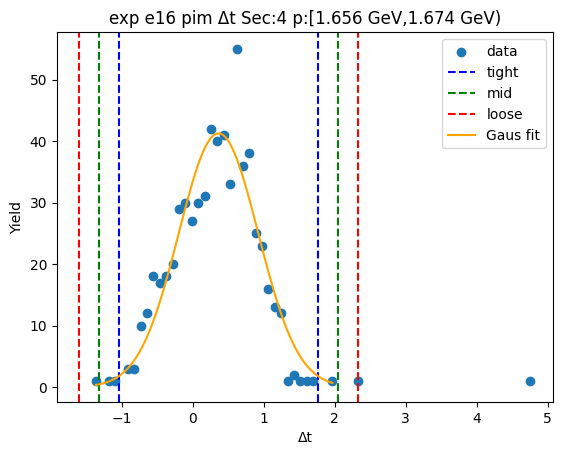

1.600580889058628 -0.9437715312417548
1.8550161310886666 -1.1982067732717931
2.109451373118705 -1.4526420153018318


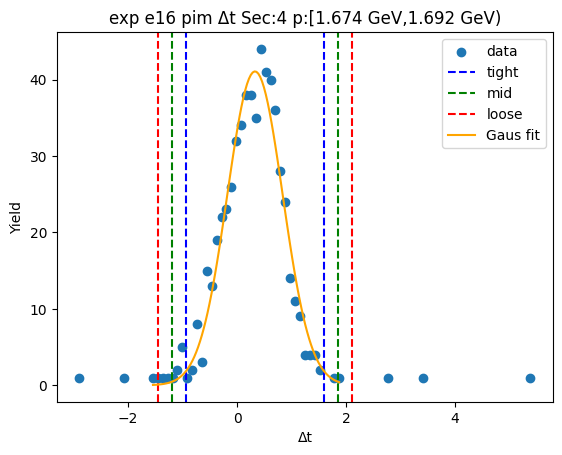

1.7287966914784787 -1.0183627944269065
2.003512640069017 -1.2930787430174449
2.2782285886595552 -1.5677946916079832


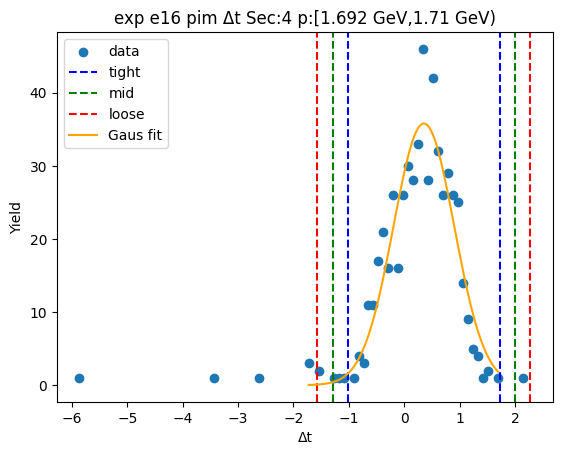

1.6864347181781474 -0.8999935687564199
1.945077546871604 -1.1586363974498766
2.203720375565061 -1.4172792261433331


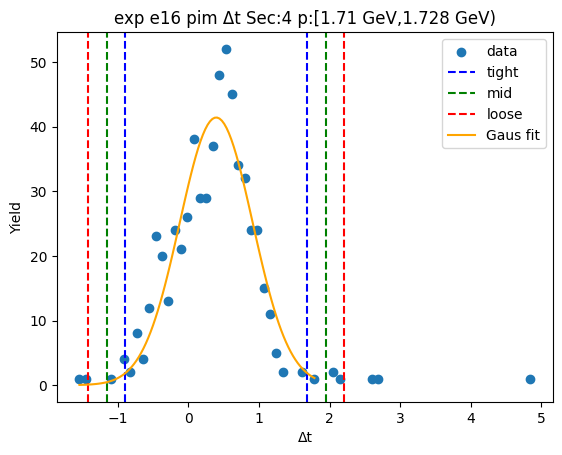

1.7022988075263317 -0.9744664785593804
1.969975336134903 -1.2421430071679518
2.237651864743474 -1.509819535776523


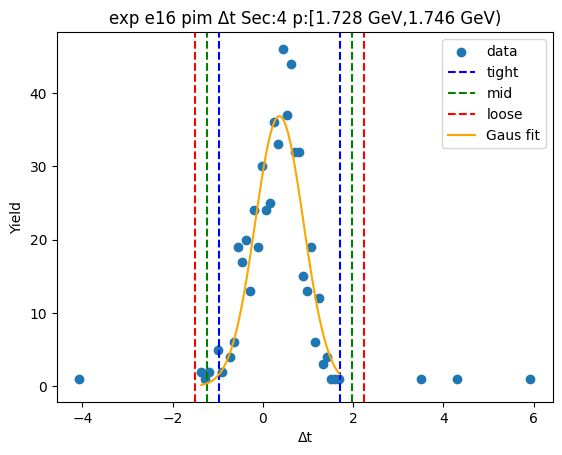

1.7145928461506827 -0.8537389372334265
1.9714260244890935 -1.1105721155718373
2.228259202827504 -1.3674052939102481


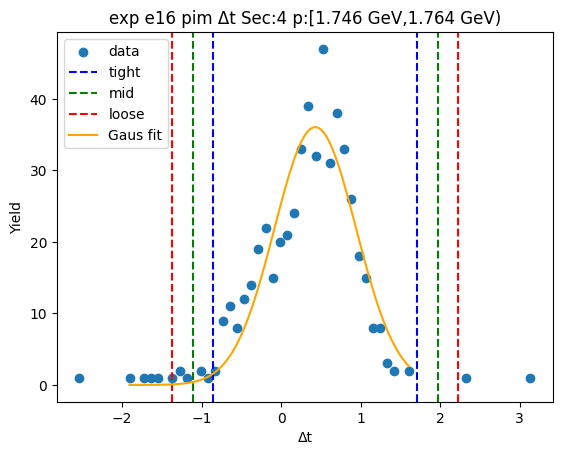

1.6277624859447928 -0.8407766683615183
1.874616401375424 -1.0876305837921496
2.121470316806055 -1.3344844992227807


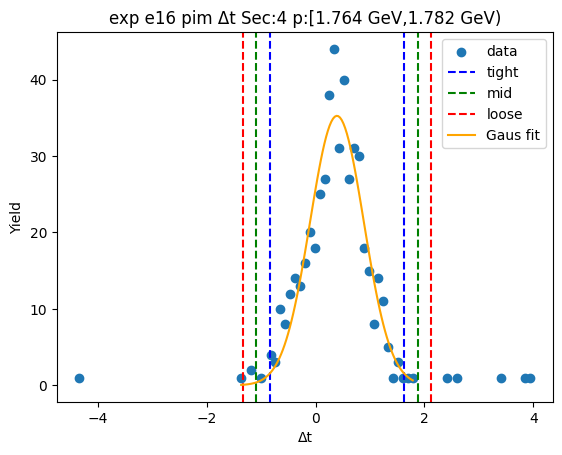

1.726920991830481 -1.011283419169358
2.000741432930465 -1.285103860269342
2.274561874030449 -1.5589243013693261


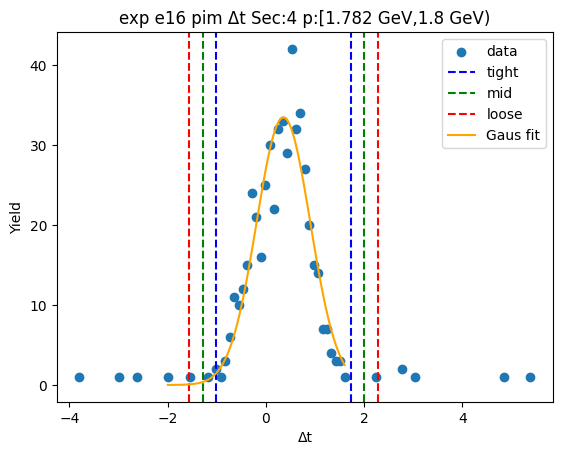

1.6771034753651084 -0.8777705626416653
1.9325908791657858 -1.1332579664423426
2.188078282966463 -1.38874537024302


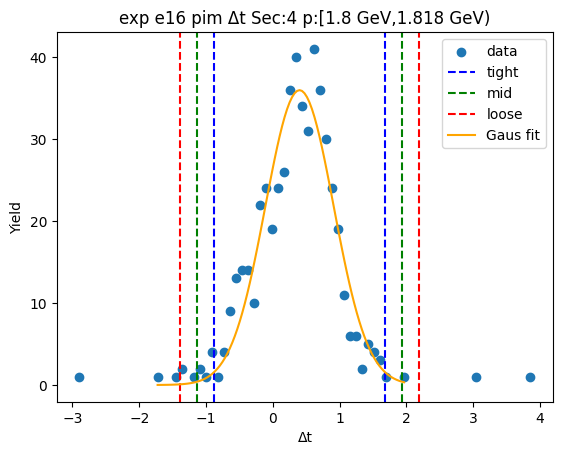

1.5052603497650914 -0.7849617084094419
1.7342825555825447 -1.0139839142268952
1.963304761399998 -1.2430061200443485


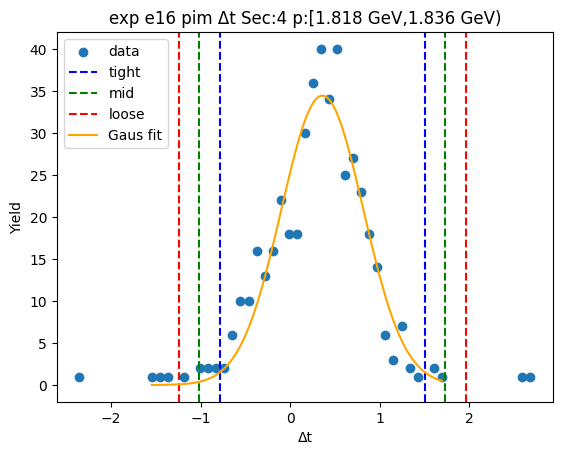

1.6504957166060419 -0.8933486317825912
1.9048801514449052 -1.1477330666214545
2.1592645862837685 -1.4021175014603178


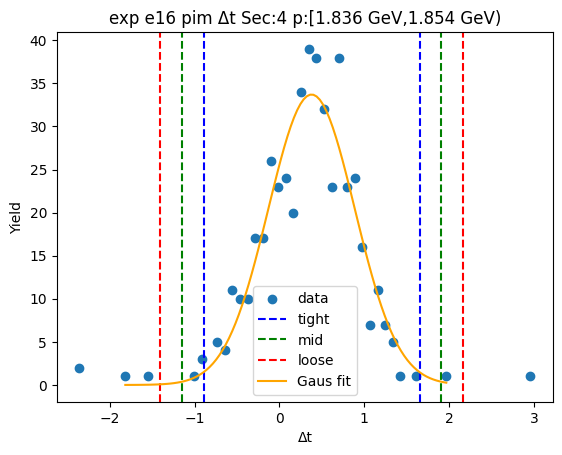

1.6243772328218444 -0.8032490649558538
1.8671398625996138 -1.0460116947336235
2.1099024923773837 -1.2887743245113934


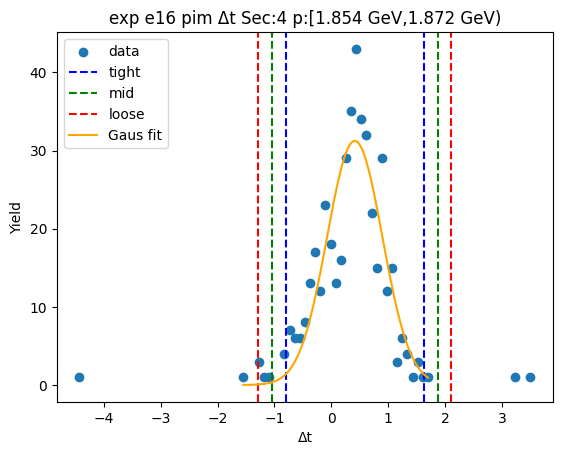

1.6847332004032223 -0.8389605850286148
1.9371025789464058 -1.0913299635717983
2.1894719574895896 -1.343699342114982


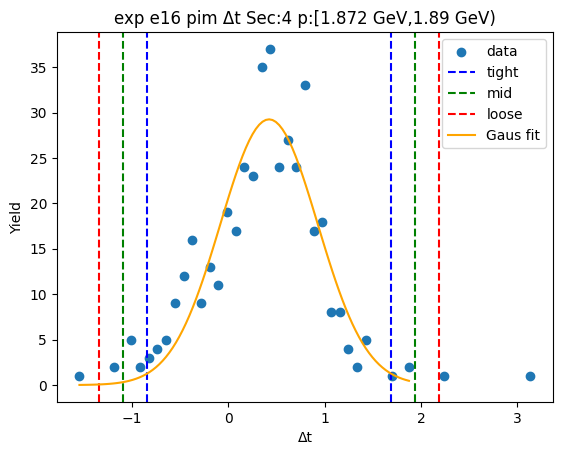

1.6628439652497056 -0.843744999212714
1.9135028616959475 -1.094403895658956
2.1641617581421895 -1.3450627921051979


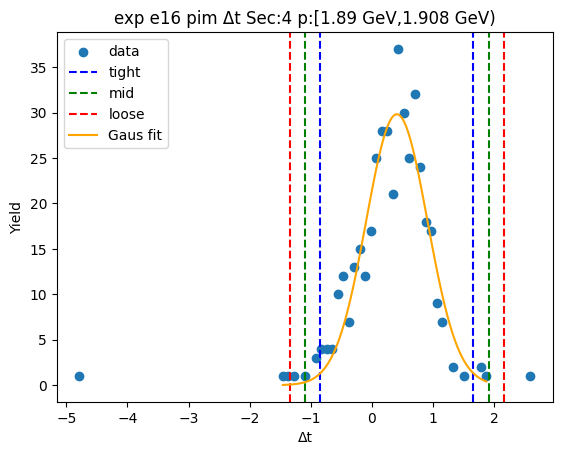

1.563388589181045 -0.6832958962137625
1.7880570377205258 -0.9079643447532433
2.0127254862600066 -1.132632793292724


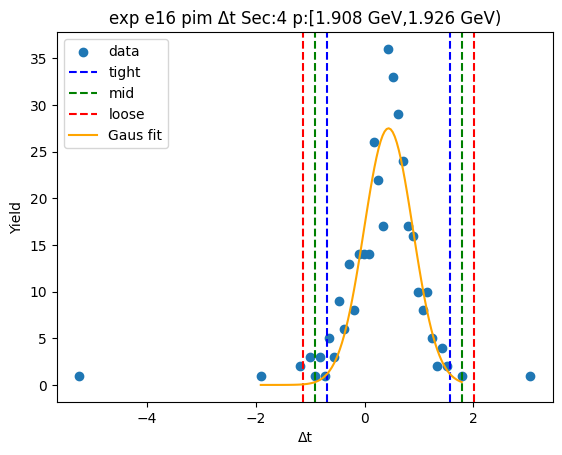

1.5883451414655976 -0.7736912119767128
1.8245487768098285 -1.0098948473209437
2.0607524121540597 -1.2460984826651749


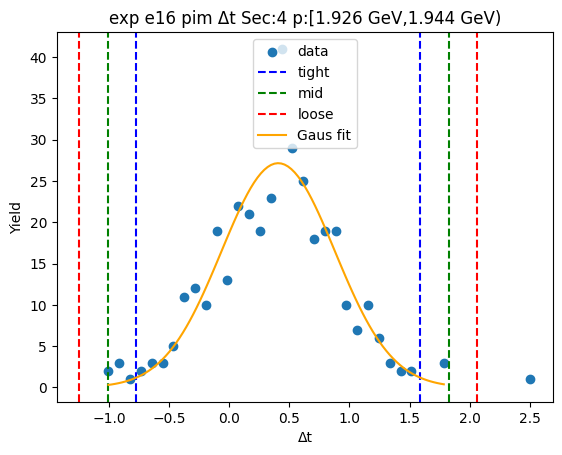

1.6906518240362058 -0.937952614865817
1.9535122679264083 -1.2008130587560195
2.2163727118166108 -1.4636735026462218


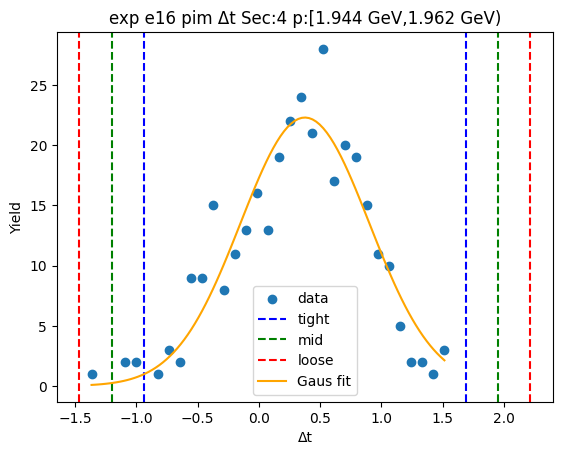

1.6456918483337832 -0.740873988791187
1.8843484320462802 -0.979530572503684
2.1230050157587774 -1.218187156216181


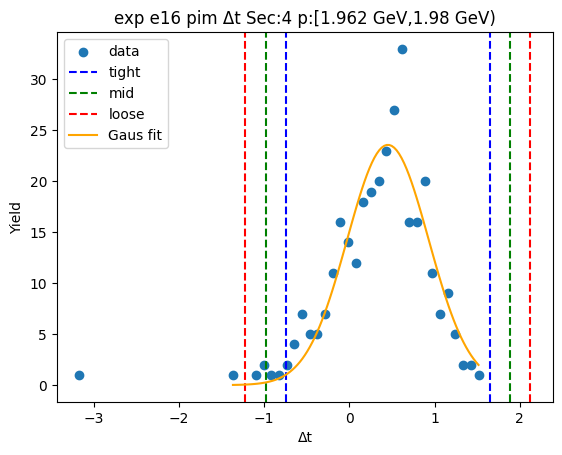

1.6643211549271244 -0.7525040894413493
1.9060036793639719 -0.9941866138781967
2.147686203800819 -1.235869138315044


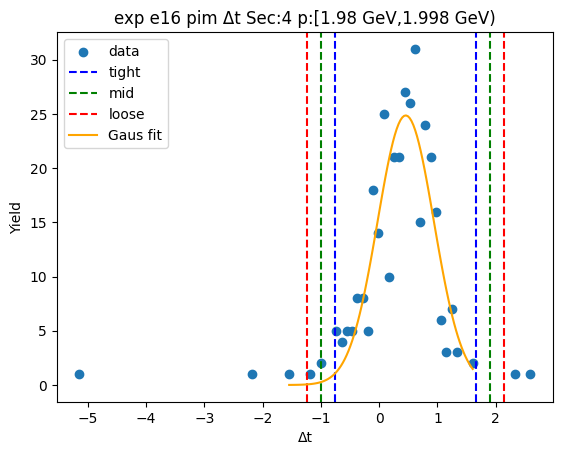

1.558717576270799 -0.6857502660481021
1.783164360502689 -0.9101970502799921
2.0076111447345792 -1.1346438345118823


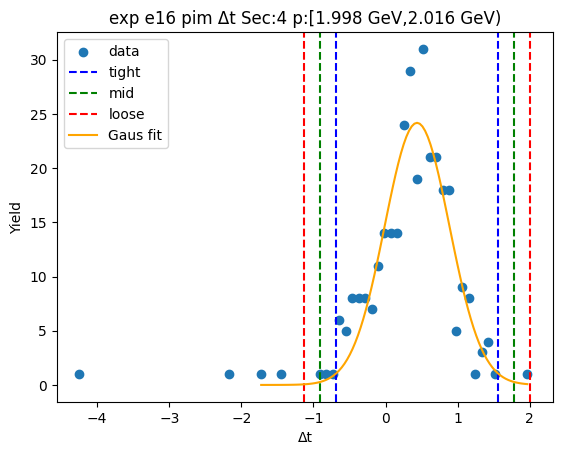

1.631444499493861 -0.6933348996196295
1.86392243940521 -0.9258128395309785
2.096400379316559 -1.1582907794423276


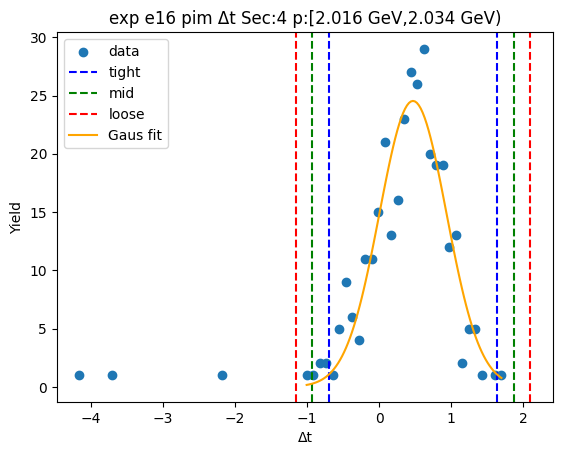

1.6457370362397958 -0.6376760096028067
1.874078340824056 -0.8660173141870668
2.1024196454083164 -1.0943586187713272


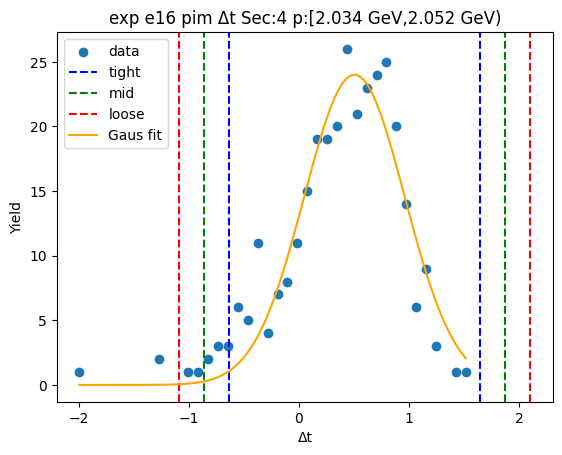

1.4166936383930329 -0.5472894697238417
1.6130919492047204 -0.7436877805355292
1.8094902600164078 -0.9400860913472168


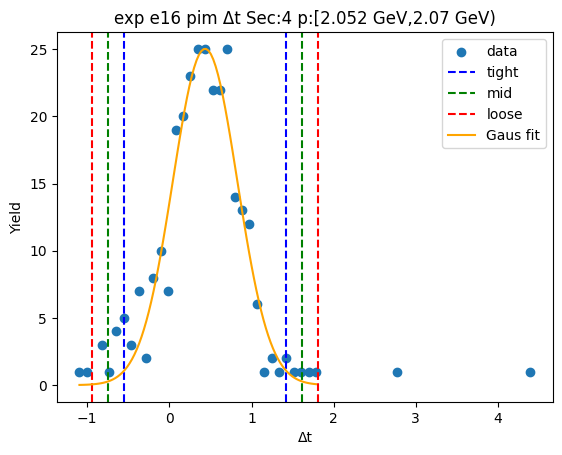

1.5043979407676722 -0.635901037889188
1.718427838633358 -0.849930935754874
1.9324577364990443 -1.06396083362056


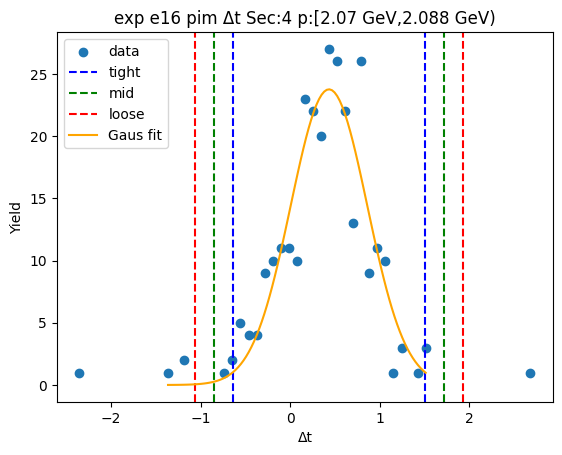

1.6117088002633728 -0.7498962383983445
1.8478693041295446 -0.9860567422645163
2.0840298079957162 -1.222217246130688


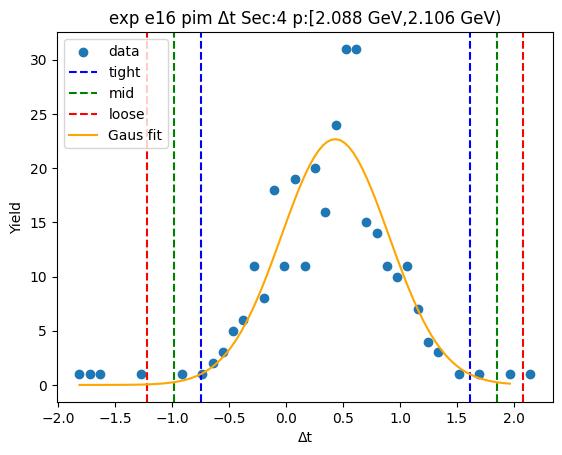

1.4371316932090474 -0.38359648911425626
1.619204511441378 -0.5656693073465867
1.8012773296737081 -0.7477421255789171


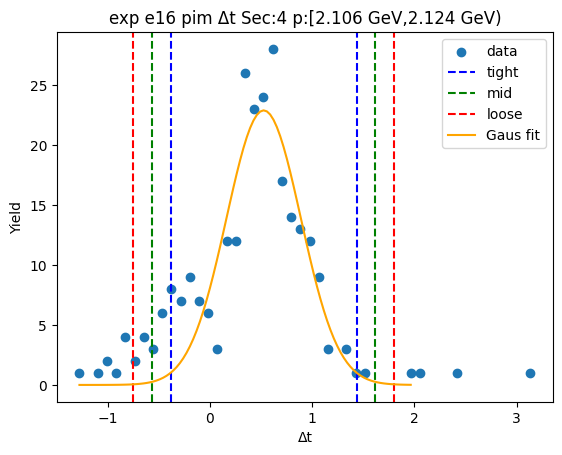

1.509841410654203 -0.6652348787200013
1.7273490395916233 -0.8827425076574216
1.9448566685290438 -1.100250136594842


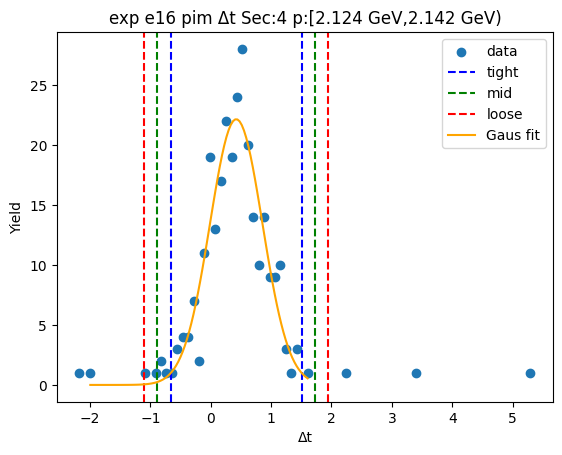

1.32271852842254 -0.30896735953737253
1.4858871172185313 -0.4721359483333637
1.6490557060145226 -0.635304537129355


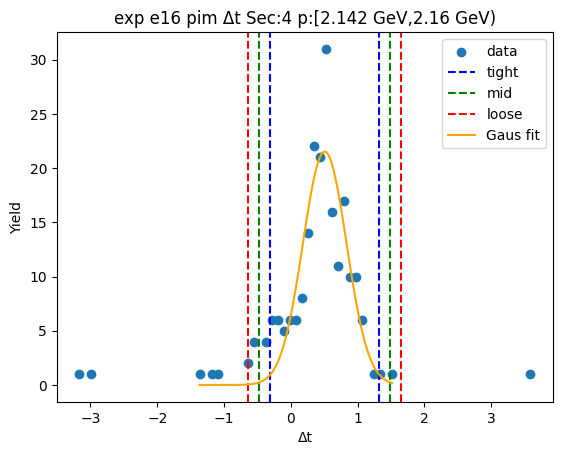

1.5024292806103494 -0.5763869980182967
1.710310908473214 -0.7842686258811613
1.9181925363360786 -0.9921502537440259


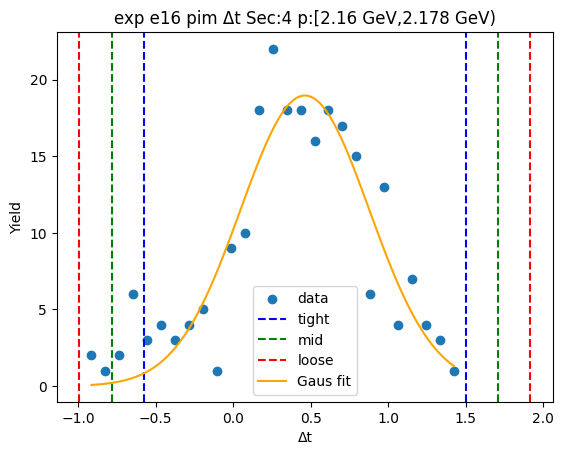

1.5703787625152126 -0.6605057272738821
1.7934672114941221 -0.8835941762527917
2.0165556604730313 -1.106682625231701


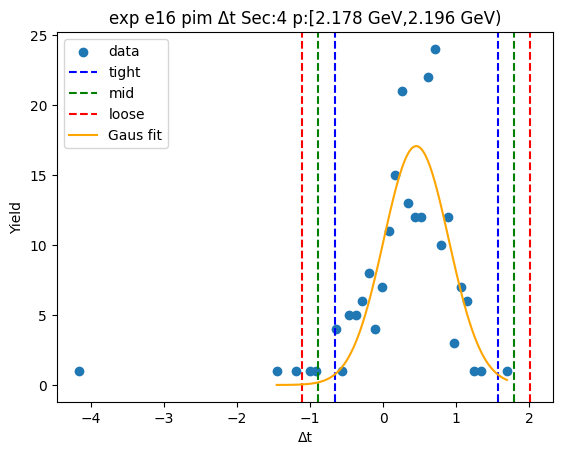

1.4844552349061684 -0.4970113198340413
1.6826018903801894 -0.6951579753080621
1.8807485458542104 -0.8933046307820831


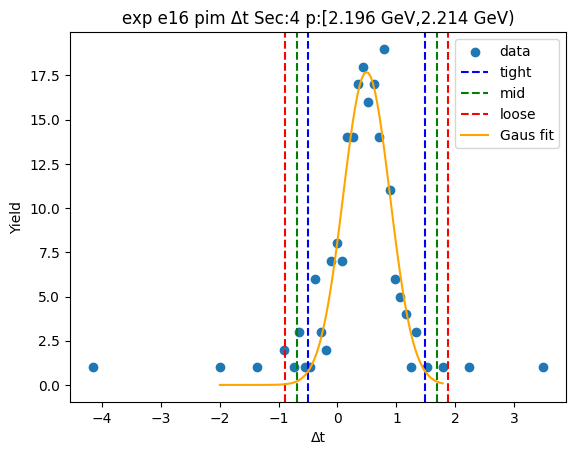

1.5372222744425548 -0.44619594097587656
1.7355640959843979 -0.6445377625177198
1.933905917526241 -0.8428795840595629


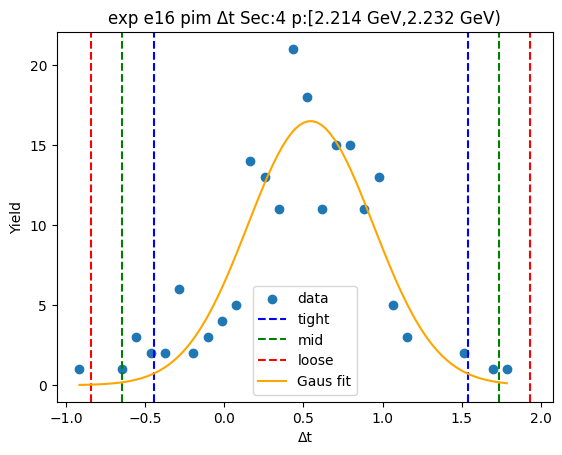

1.4007384810640884 -0.40182188926802515
1.5809945180972997 -0.5820779263012366
1.761250555130511 -0.7623339633344479


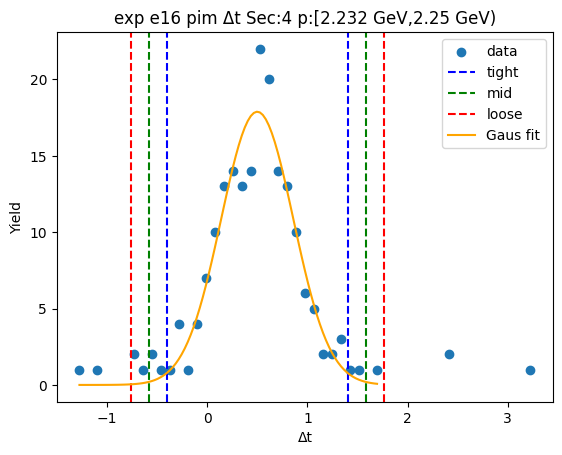

1.3257624114356372 -0.2895285003651872
1.4872915026157196 -0.4510575915452697
1.648820593795802 -0.6125866827253521


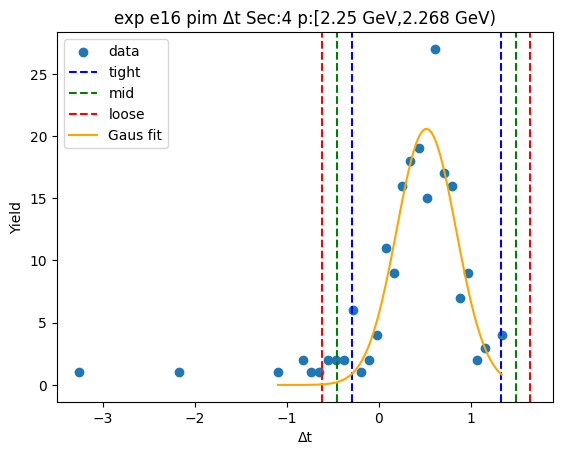

1.3402072562933602 -0.4077334932913366
1.51500133125183 -0.5825275682498063
1.6897954062102996 -0.7573216432082759


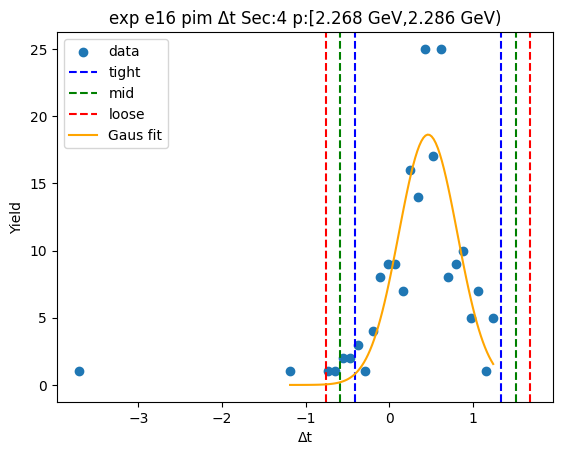

1.3112212513959507 -0.36300533279415004
1.4786439098149609 -0.5304279912131602
1.6460665682339708 -0.6978506496321701


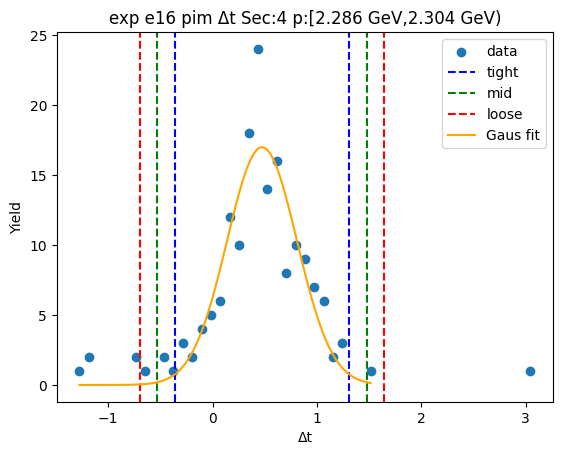

1.1338971266831237 -0.4025253762388172
1.2875393769753178 -0.5561676265310111
1.4411816272675118 -0.7098098768232053


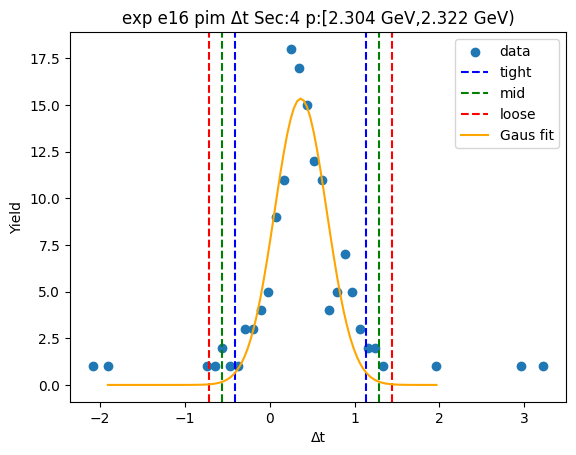

1.1643599956546862 -0.30637789808978105
1.311433785029133 -0.45345168746422787
1.4585075744035798 -0.6005254768386745


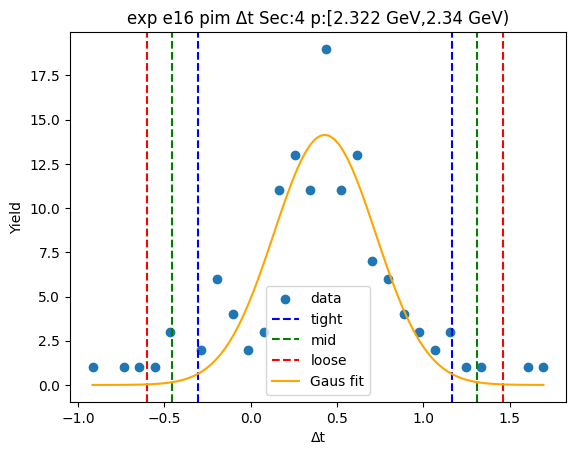

1.3659541990120925 -0.5234210228293137
1.554891721196233 -0.7123585450134544
1.7438292433803737 -0.9012960671975951


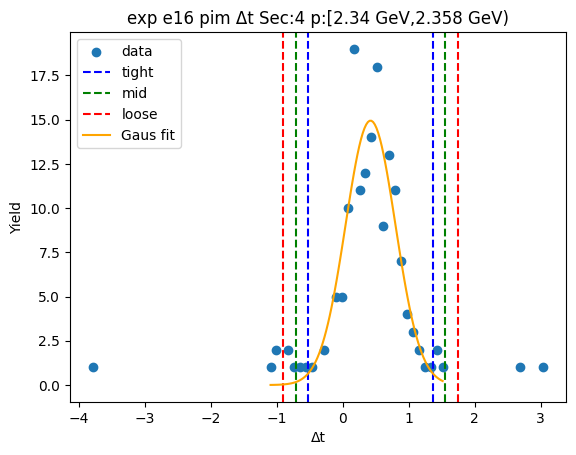

1.3580851337003055 -0.5023995792655385
1.5441336049968897 -0.6884480505621229
1.730182076293474 -0.8744965218587073


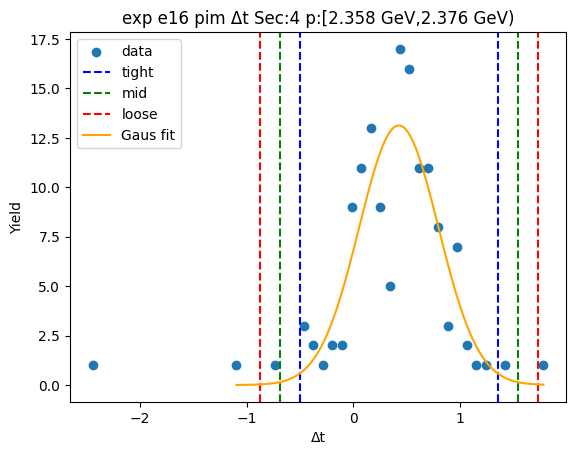

1.2227732914342047 -0.4929774064748964
1.3943483612251149 -0.6645524762658066
1.5659234310160248 -0.8361275460567166


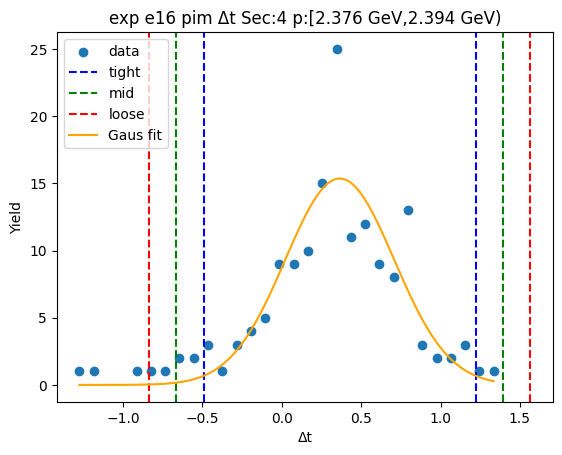

-1.6708212876286994 1.4997259672422325
-1.9878760131157924 1.8167806927293255
-2.3049307386028857 2.1338354182164188


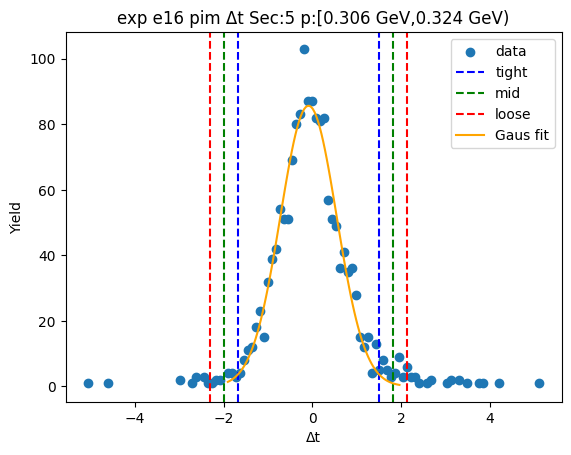

-1.762874737042289 1.5345625532343163
-2.0926184660699496 1.8643062822619765
-2.42236219509761 2.194050011289637


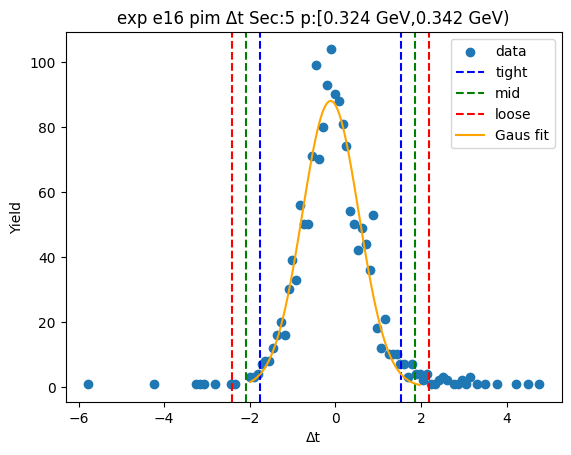

-1.679405845407603 1.4693861241925772
-1.9942850423676213 1.7842653211525954
-2.3091642393276395 2.099144518112613


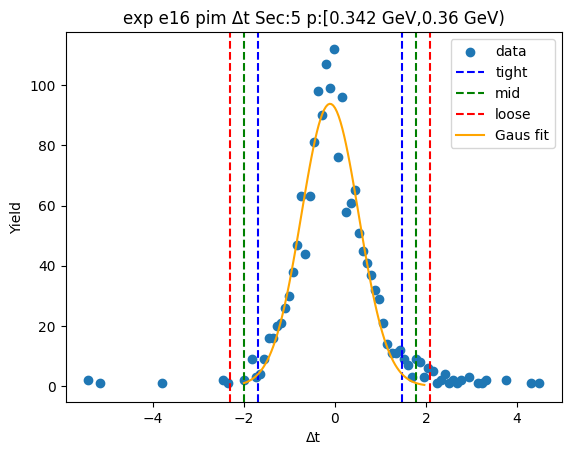

-1.6486570970979704 1.4551864037188433
-1.9590414471796516 1.7655707538005245
-2.269425797261333 2.075955103882206


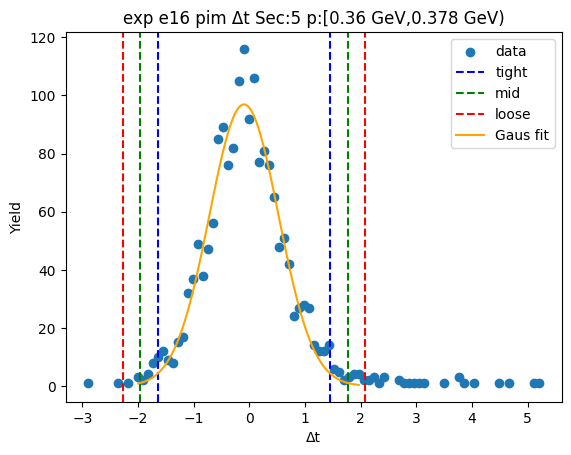

-1.575070866461314 1.3959495196246485
-1.87217290506991 1.6930515582332446
-2.1692749436785066 1.9901535968418411


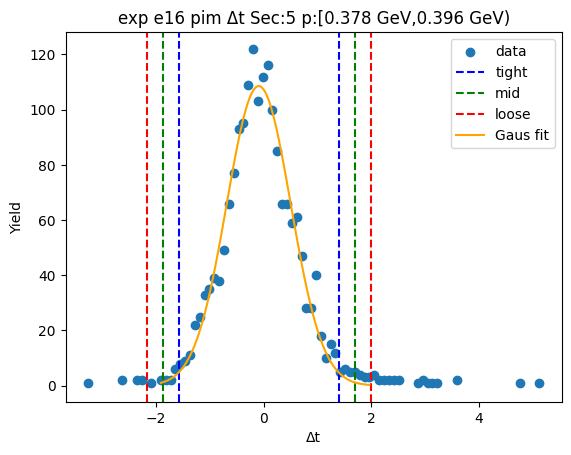

-1.6060982690412415 1.4762227684975149
-1.9143303727951173 1.7844548722513907
-2.222562476548993 2.0926869760052664


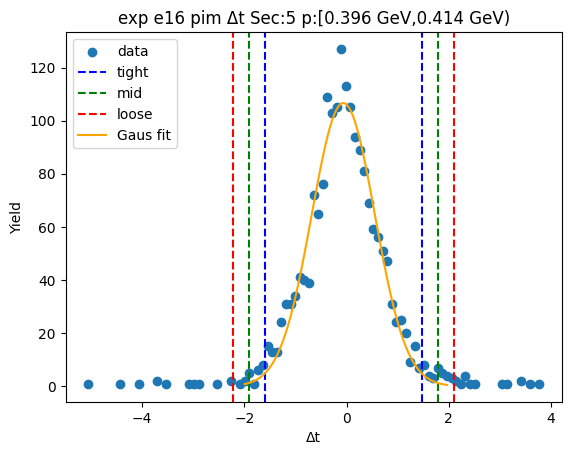

-1.660415296170984 1.5115426382743695
-1.9776110896155195 1.828738431718905
-2.2948068830600548 2.1459342251634403


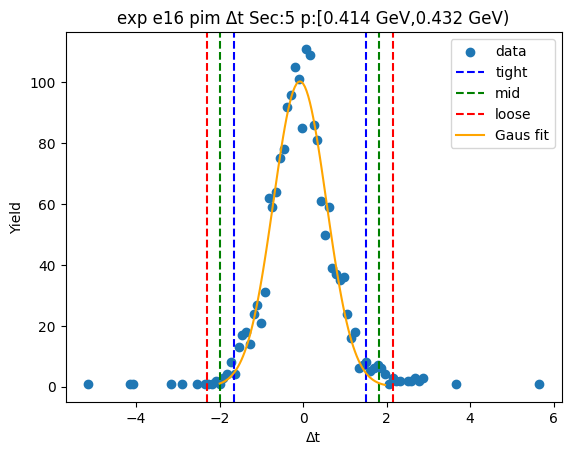

-1.6582499372383663 1.5336772522697795
-1.977442656189181 1.852869971220594
-2.2966353751399953 2.172062690171409


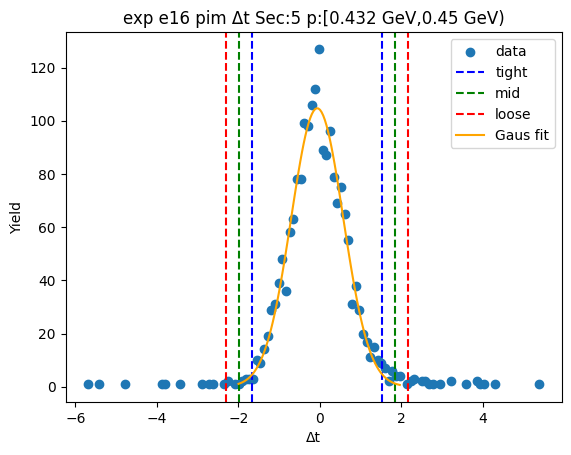

-1.7218018095364194 1.5748031920830527
-2.0514623096983664 1.9044636922449998
-2.381122809860314 2.2341241924069473


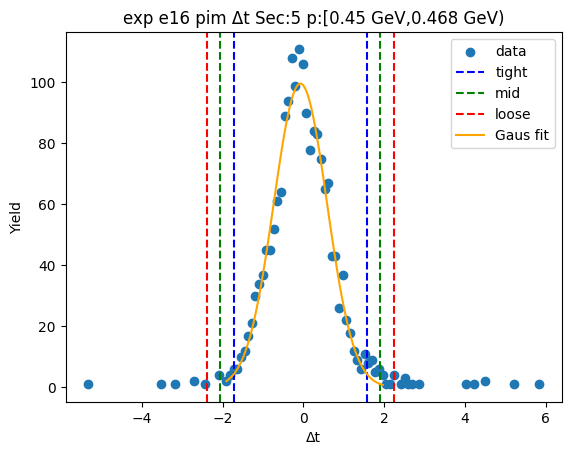

-1.6130272480835282 1.4954140145024817
-1.923871374342129 1.8062581407610825
-2.23471550060073 2.1171022670196837


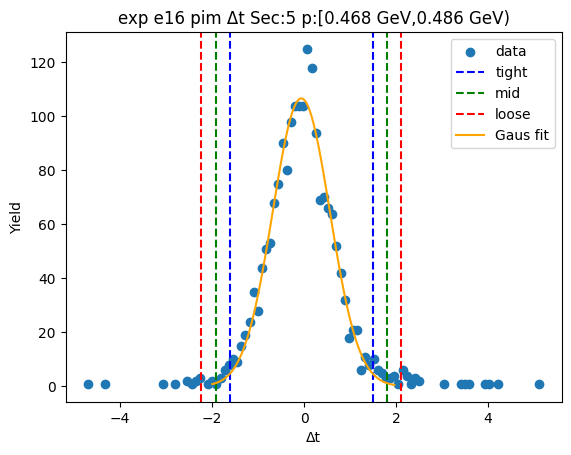

-1.555758317643103 1.491549604623486
-1.8604891098697618 1.7962803968501448
-2.1652199020964207 2.101011189076804


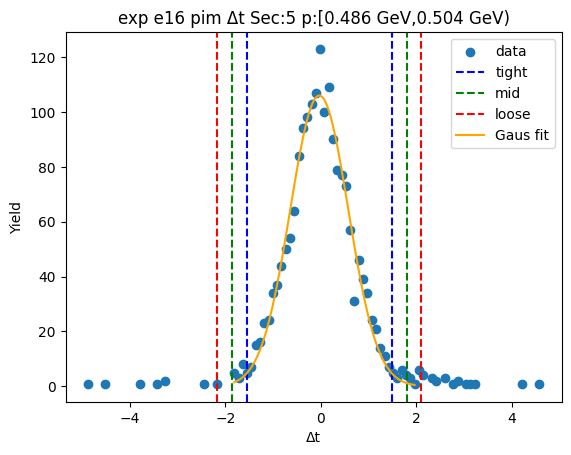

-1.5360973664641704 1.5298512292120785
-1.8426922260317953 1.8364460887797034
-2.1492870855994206 2.1430409483473283


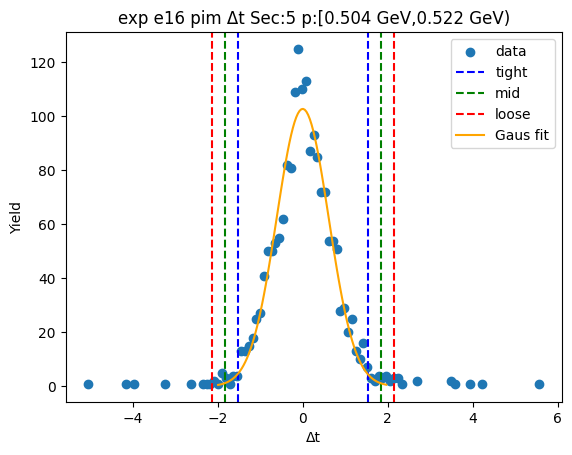

-1.6303733135222267 1.5903242622941887
-1.952443071103868 1.91239401987583
-2.27451282868551 2.2344637774574716


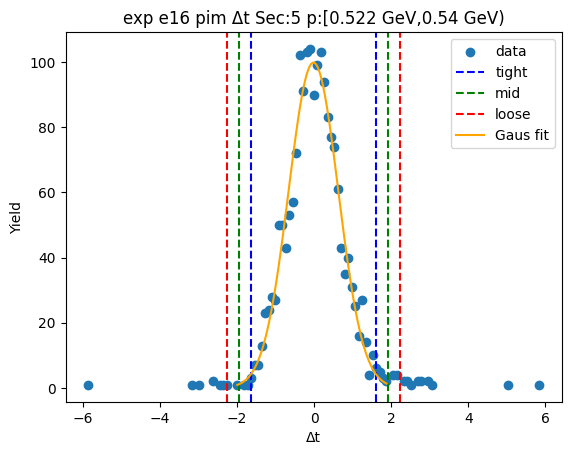

-1.628115183505342 1.5641266645293024
-1.9473393683088063 1.8833508493327666
-2.2665635531122708 2.2025750341362316


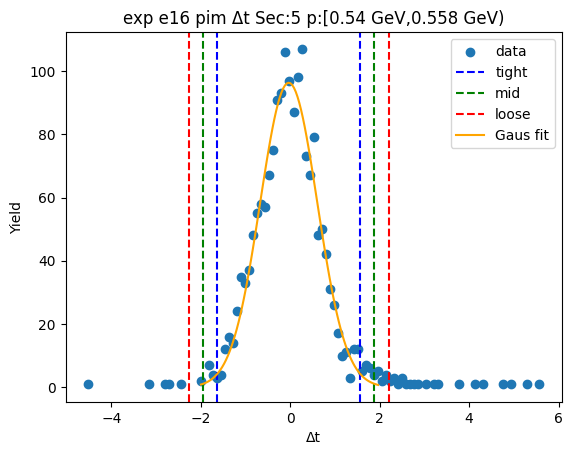

-1.6352380658909689 1.5183016173861401
-1.9505920342186798 1.833655585713851
-2.2659460025463907 2.149009554041562


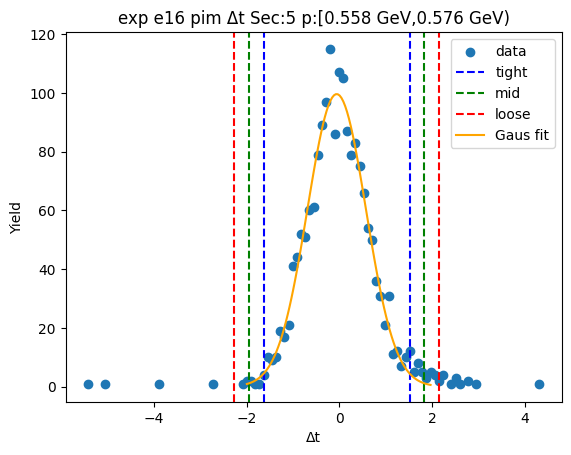

-1.639030029096478 1.5887206479352725
-1.961805096799653 1.9114957156384473
-2.2845801645028283 2.234270783341622


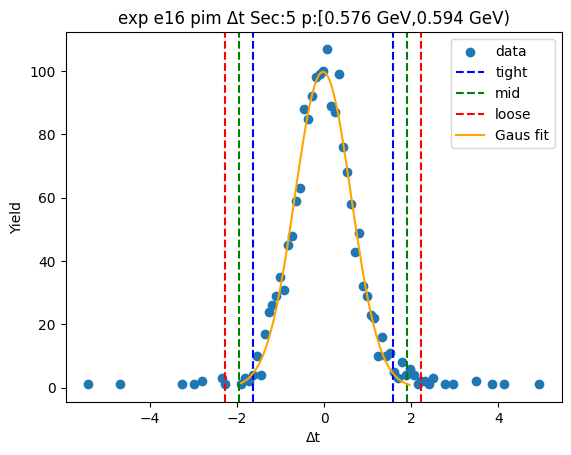

-1.6647593302929402 1.6427258817989787
-1.9955078515021323 1.9734744030081708
-2.326256372711324 2.3042229242173624


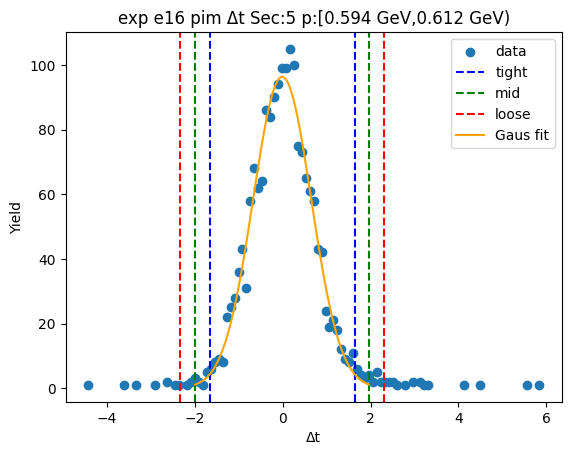

-1.5500503930423493 1.5203792767886426
-1.8570933600254484 1.8274222437717418
-2.164136327008548 2.134465210754841


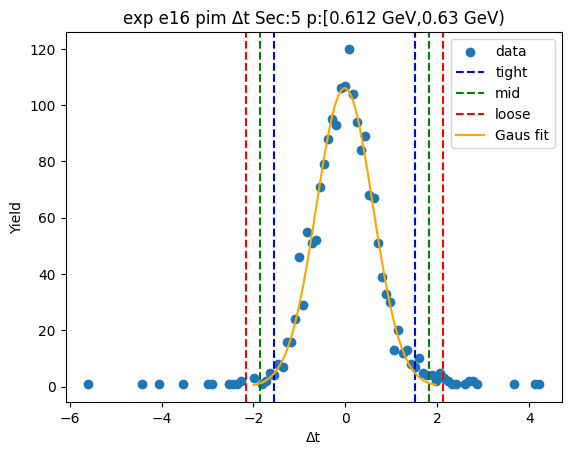

-1.6165640237558707 1.6286149864428643
-1.941081924775744 1.9531328874627376
-2.2655998257956176 2.277650788482611


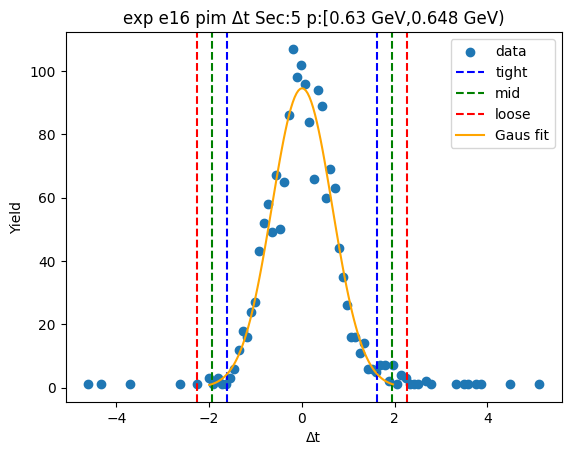

-1.58538611991857 1.6021892993896527
-1.9041436618493923 1.920946841320475
-2.2229012037802147 2.2397043832512975


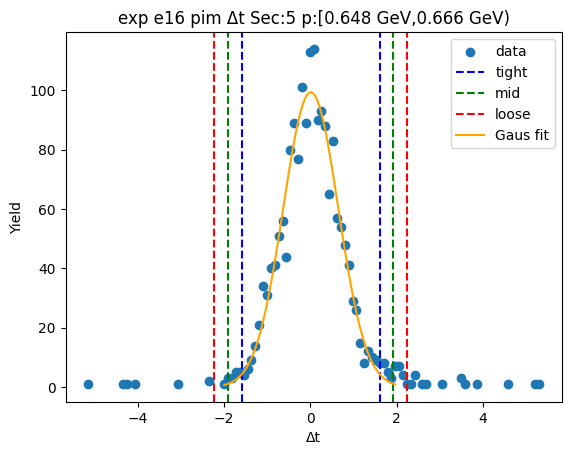

-1.5693668476558864 1.5584429380289029
-1.8821478262243652 1.8712239165973816
-2.1949288047928444 2.184004895165861


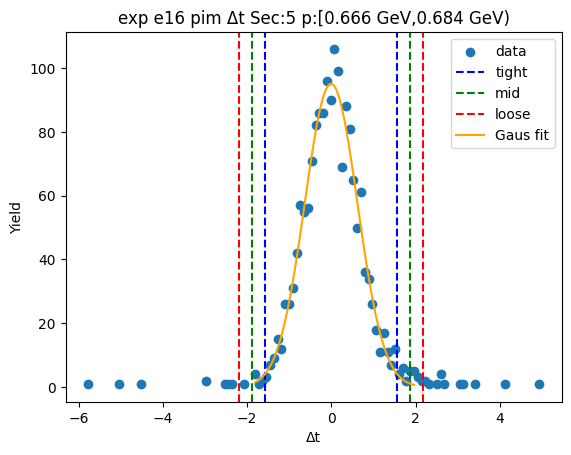

-1.659562032031955 1.6206927872287005
-1.9875875139580208 1.9487182691547662
-2.3156129958840865 2.2767437510808315


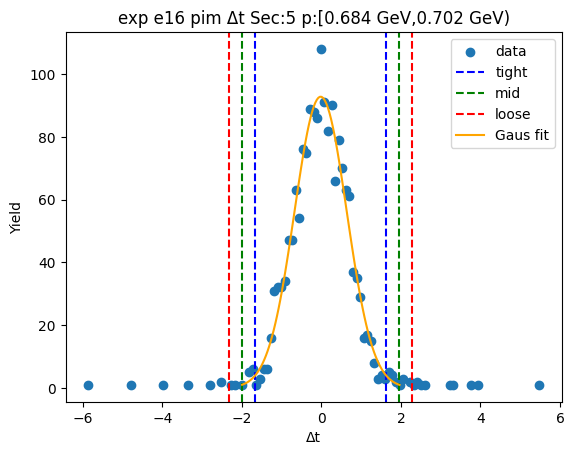

-1.6392424581833003 1.6590832138937184
-1.9690750253910023 1.9889157811014204
-2.298907592598704 2.3187483483091222


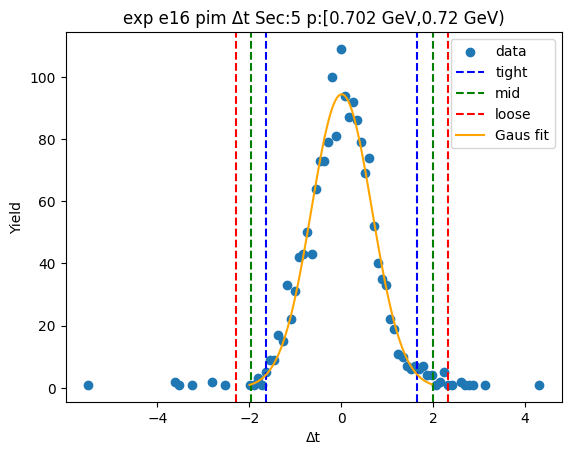

-1.610279557745475 1.547968219939278
-1.9261043355139502 1.8637929977077532
-2.241929113282425 2.1796177754762285


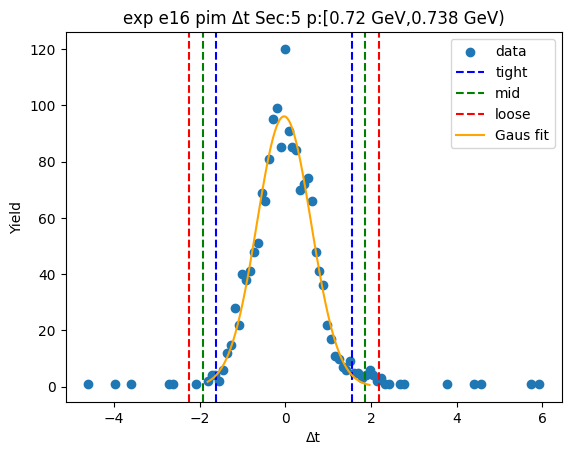

-1.653363388034332 1.6409939688291217
-1.9827991237206775 1.9704297045154673
-2.3122348594070226 2.299865440201813


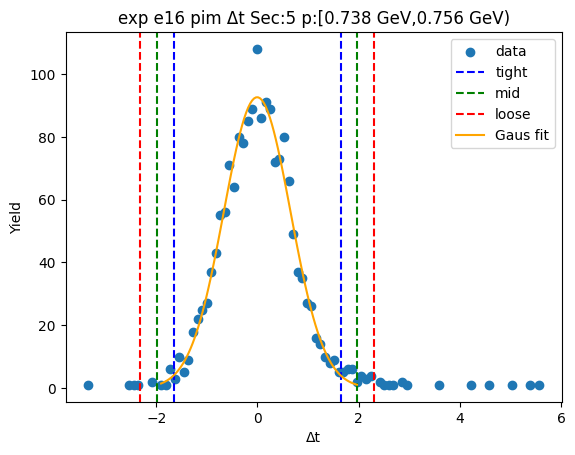

-1.7329570239576904 1.6143732696924906
-2.0676900533227083 1.9491062990575085
-2.4024230826877266 2.283839328422527


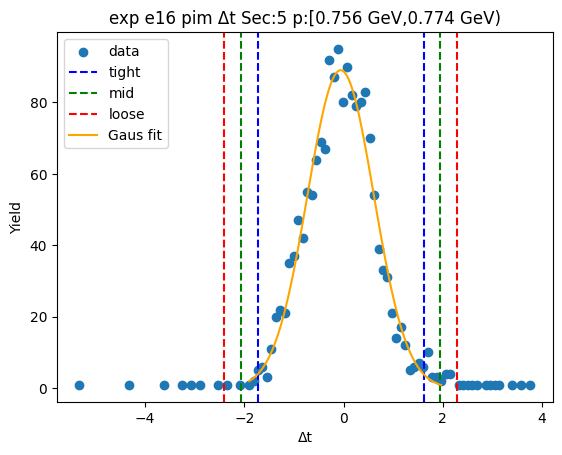

-1.5390267290797521 1.5070682868792133
-1.8436362306756489 1.81167778847511
-2.1482457322715454 2.1162872900710066


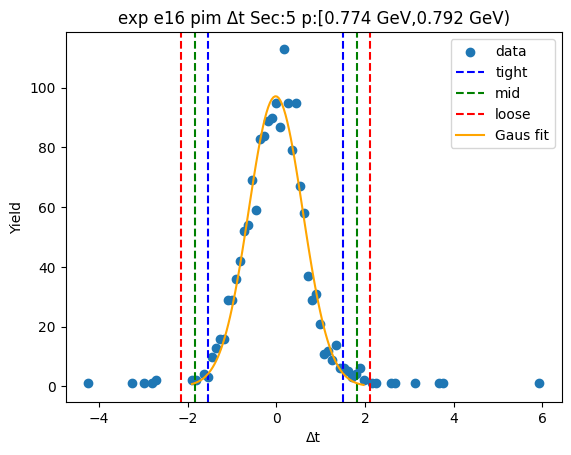

-1.6157324575952412 1.565289196484271
-1.9338346230031924 1.8833913618922222
-2.251936788411144 2.2014935273001734


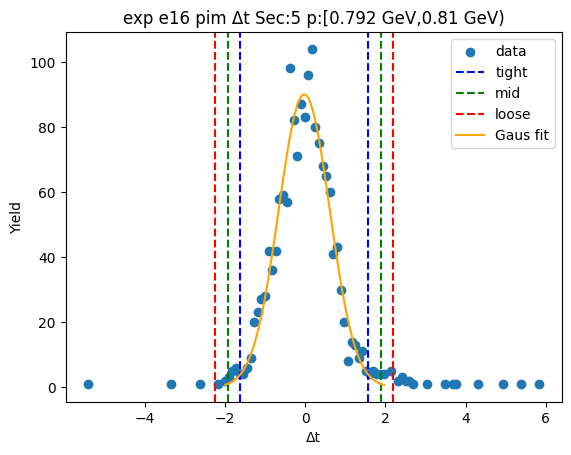

-1.5885853269497157 1.574709389028979
-1.904914798547585 1.8910388606268482
-2.221244270145455 2.2073683322247177


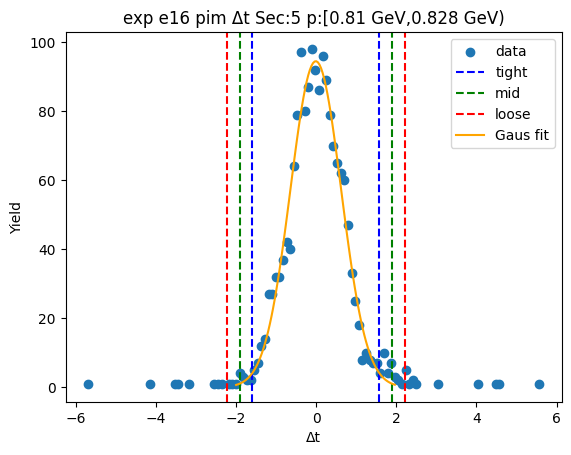

-1.5617946252559287 1.5558080009182875
-1.8735548878733503 1.8675682635357091
-2.185315150490772 2.1793285261531308


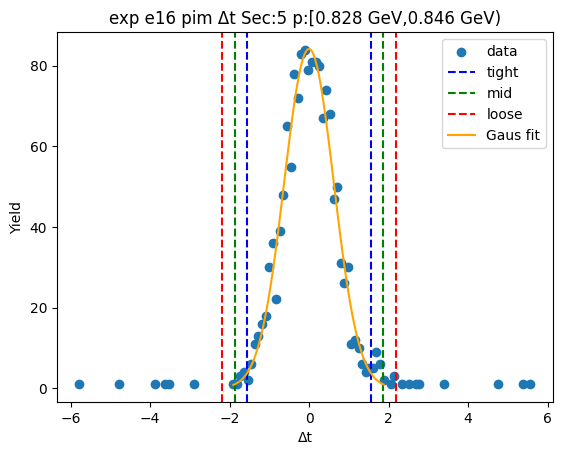

-1.6426423829267667 1.5977384045704568
-1.966680461676489 1.9217764833201791
-2.2907185404262114 2.245814562069902


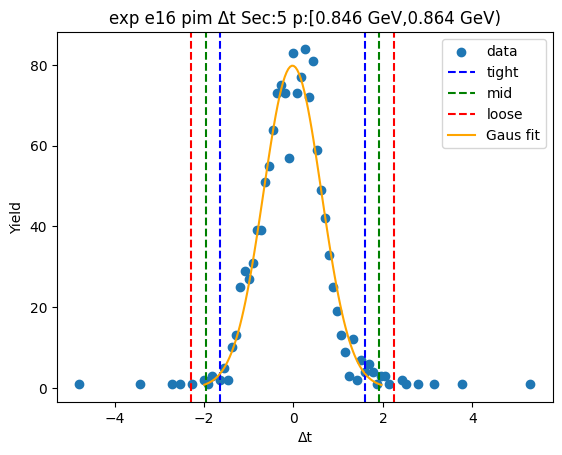

-1.5773516611670475 1.6015487103903623
-1.8952416983227887 1.9194387475461034
-2.21313173547853 2.237328784701844


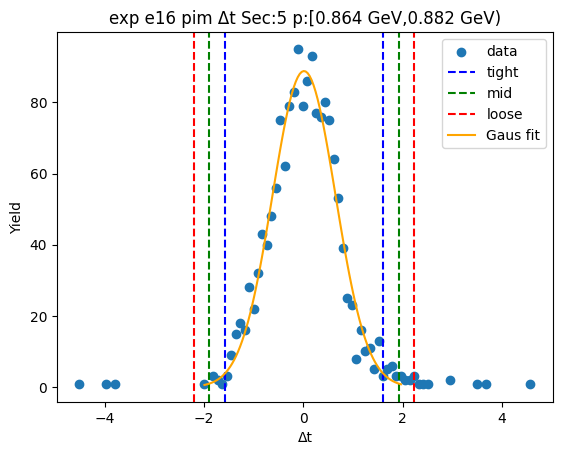

-1.5485195703825934 1.528755640602633
-1.856247091481116 1.8364831617011557
-2.163974612579639 2.1442106827996783


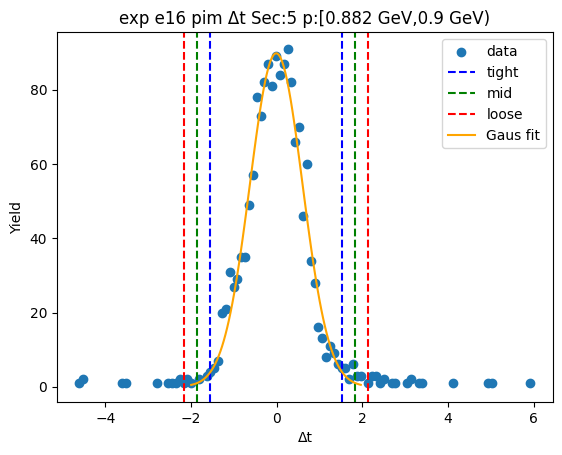

-1.6636951642190285 1.6482476445908223
-1.9948894451000134 1.9794419254718072
-2.3260837259809986 2.3106362063527923


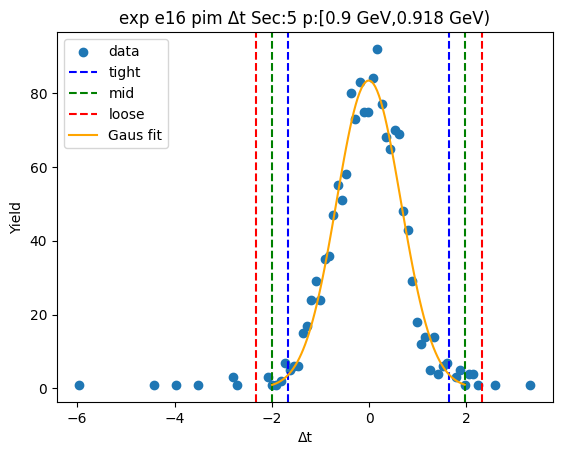

-1.575913940556839 1.5377485265494752
-1.8872801872674703 1.8491147732601065
-2.1986464339781016 2.160481019970738


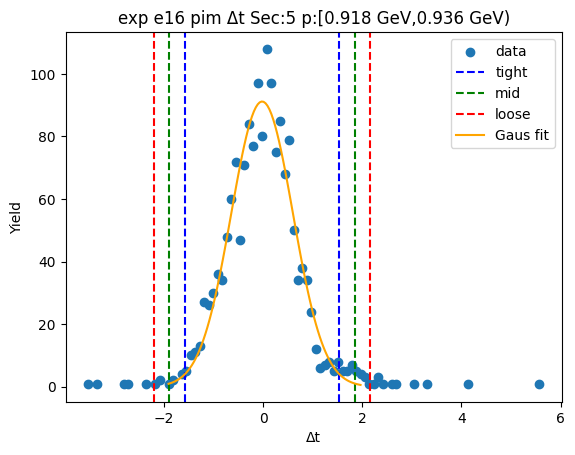

-1.5955264619816258 1.5641160787462107
-1.9114907160544097 1.8800803328189946
-2.227454970127193 2.196044586891778


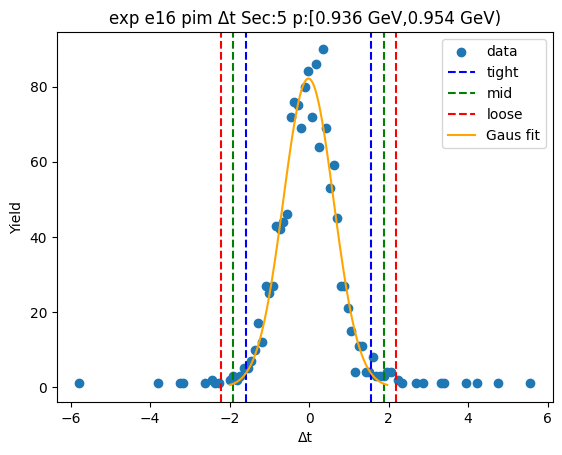

-1.5716055362781614 1.5588356019471274
-1.8846496501006904 1.8718797157696565
-2.197693763923219 2.1849238295921856


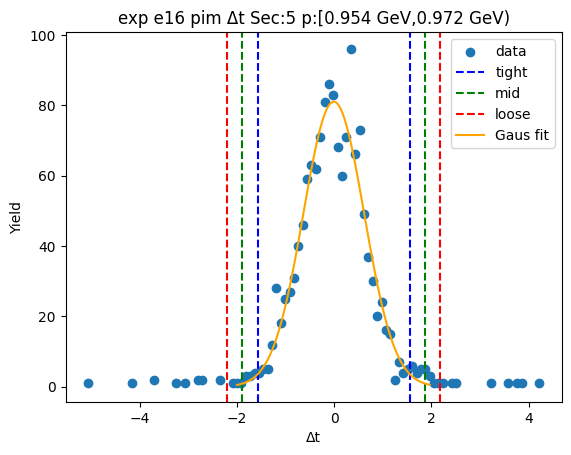

-1.508140708126995 1.508540684139897
-1.8098088473536844 1.8102088233665863
-2.1114769865803735 2.111876962593276


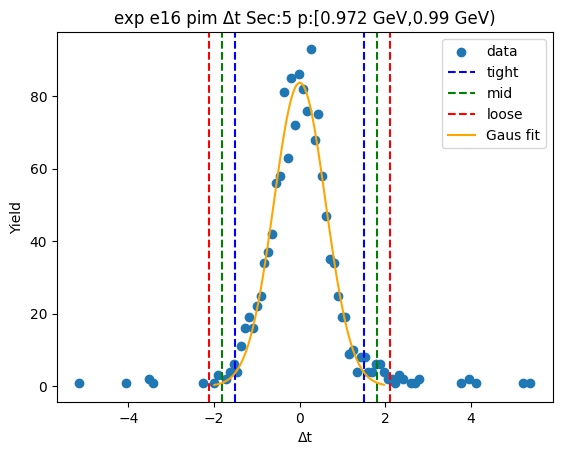

-1.5980879365286151 1.6053598788464583
-1.9184327180661225 1.9257046603839656
-2.23877749960363 2.2460494419214734


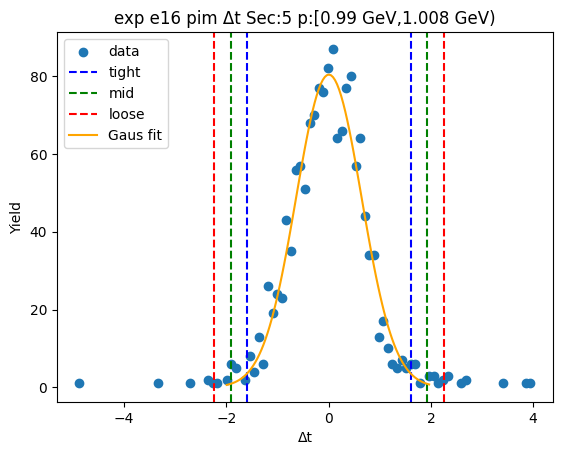

-1.5641169684340959 1.5560881959704056
-1.876137484874546 1.8681087124108557
-2.188158001314996 2.1801292288513063


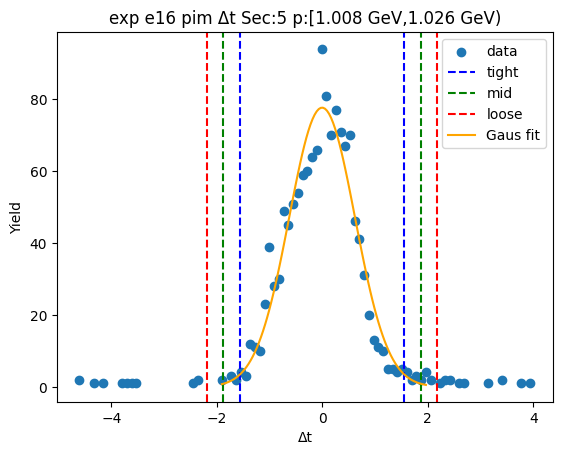

-1.5158274963470768 1.5916897458989088
-1.8265792205716755 1.9024414701235075
-2.137330944796274 2.2131931943481056


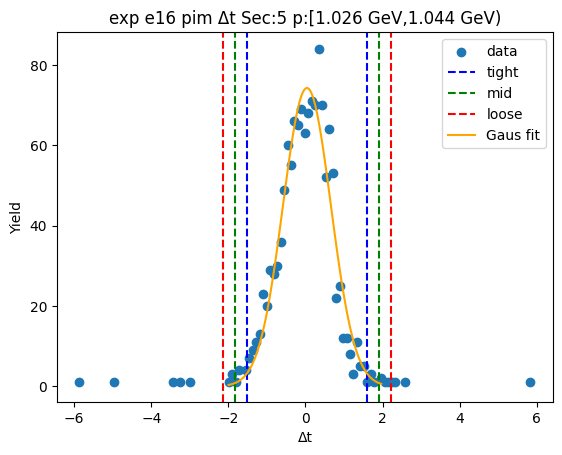

-1.566231813593689 1.5705546421251446
-1.8799104591655722 1.8842332876970278
-2.1935891047374554 2.1979119332689114


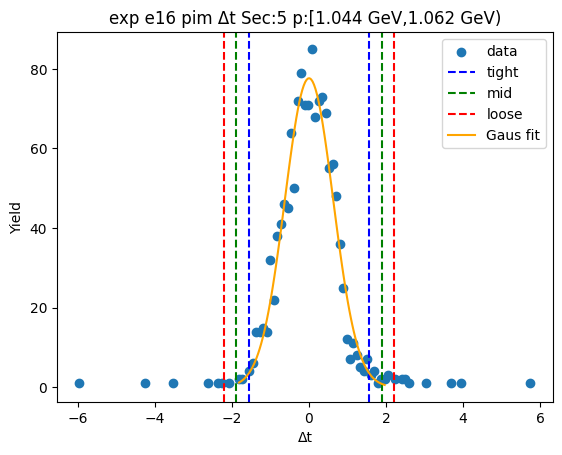

-1.5145742104900437 1.545828970265489
-1.8206145285655968 1.8518692883410421
-2.1266548466411503 2.1579096064165952


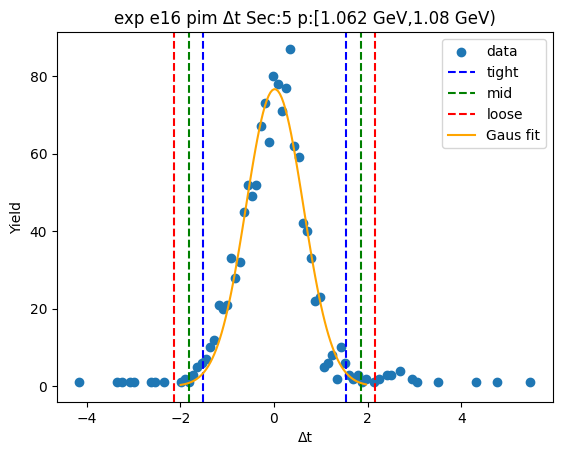

-1.5876492903640287 1.6270072106763074
-1.9091149404680623 1.948472860780341
-2.230580590572096 2.2699385108843746


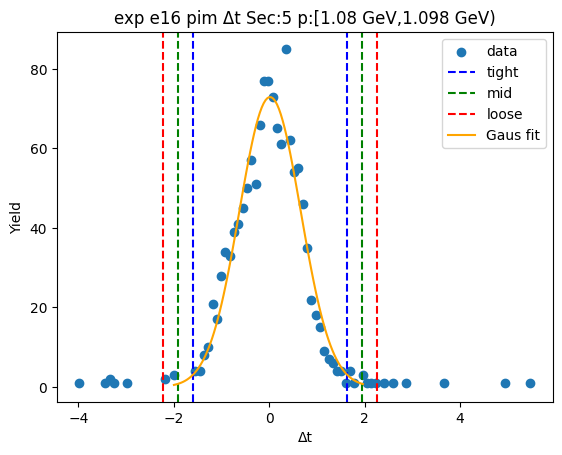

-1.6439876369413844 1.6638188230212856
-1.9747682829376514 1.9945994690175526
-2.305548928933918 2.32538011501382


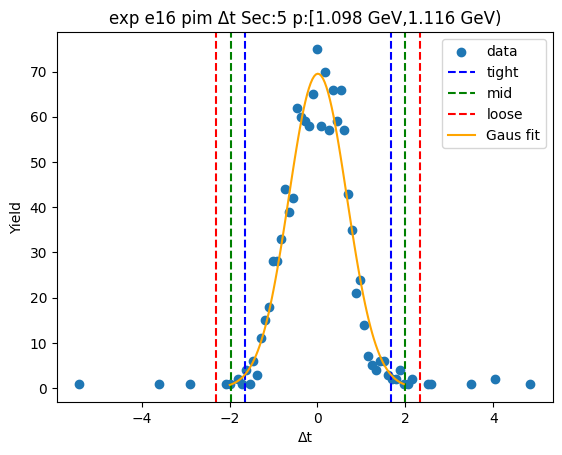

-1.5200954107233022 1.5591472881801562
-1.828019680613648 1.867071558070502
-2.135943950503994 2.1749958279608474


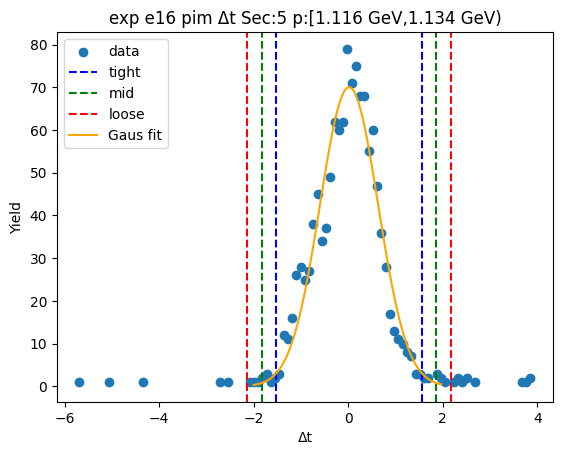

-1.4828311905169196 1.4997145340512503
-1.7810857629737364 1.7979691065080672
-2.0793403354305533 2.096223678964884


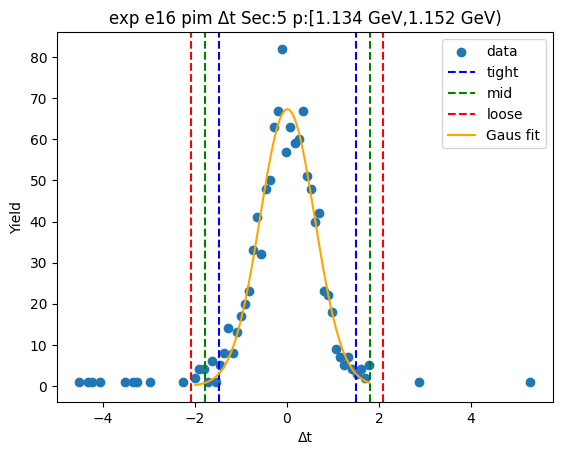

-1.5613305215340199 1.657776539160348
-1.8832412276034565 1.9796872452297847
-2.2051519336728935 2.3015979512992217


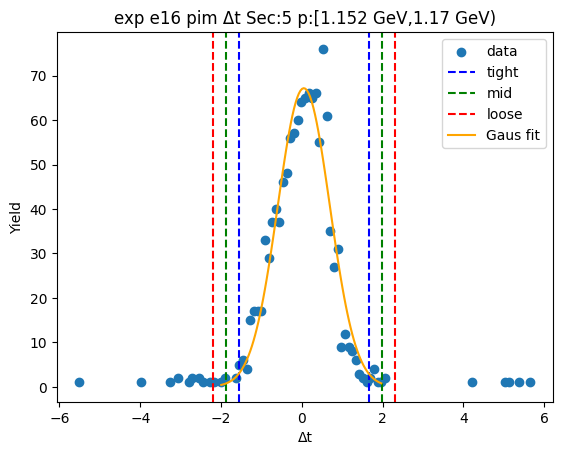

-1.4180759729095362 1.4997840762665164
-1.7098619778271413 1.7915700811841215
-2.001647982744747 2.083356086101727


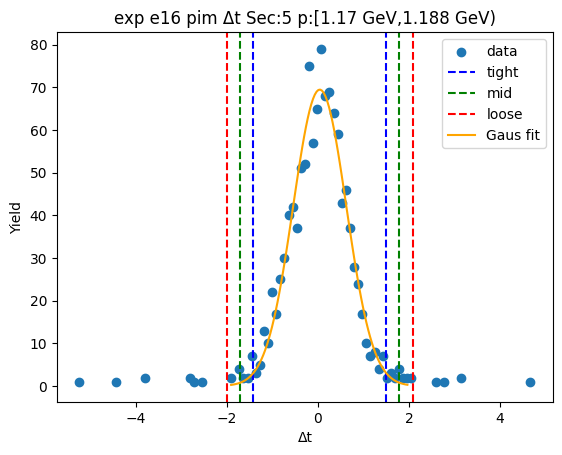

-1.5558833342105958 1.6421592106731917
-1.8756875886989743 1.9619634651615703
-2.195491843187353 2.2817677196499493


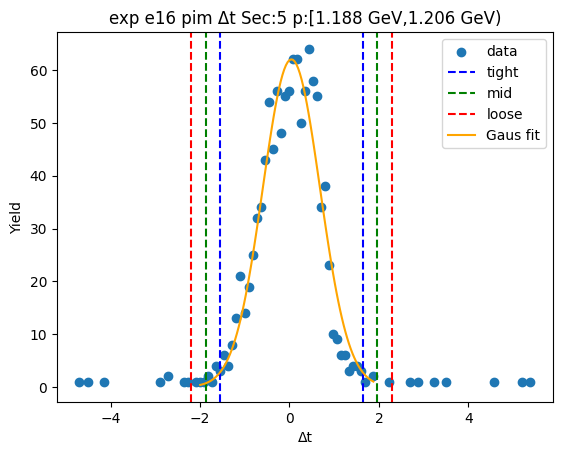

-1.4669215738322854 1.591802498292373
-1.772793981044751 1.8976749055048387
-2.0786663882572167 2.203547312717305


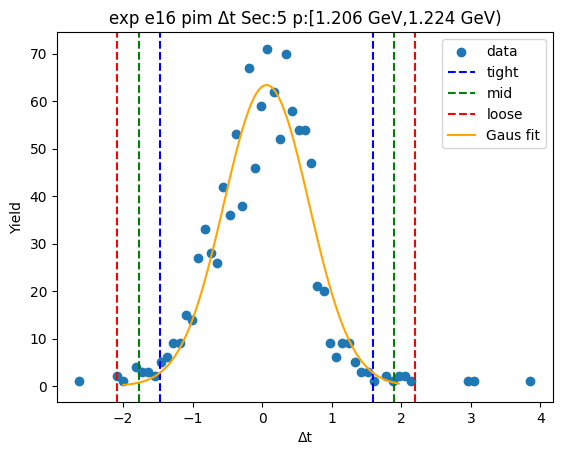

-1.480786221632916 1.591494489143497
-1.7880142927105571 1.8987225602211382
-2.0952423637881985 2.205950631298779


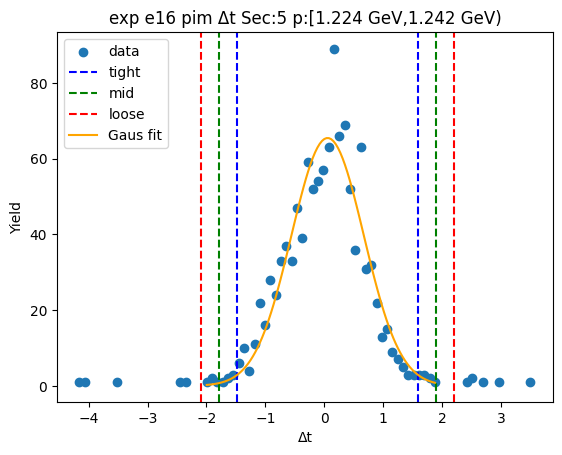

-1.4053003053865765 1.5103717339163985
-1.6968675093168741 1.8019389378466961
-1.9884347132471714 2.0935061417769933


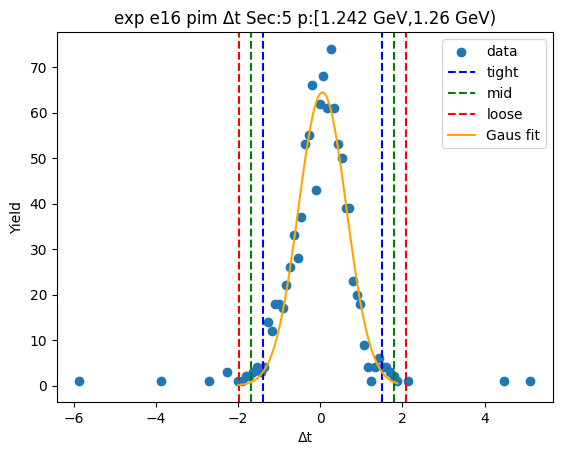

-1.463865081824386 1.6088677790906833
-1.771138367915893 1.9161410651821904
-2.0784116540074 2.2234143512736977


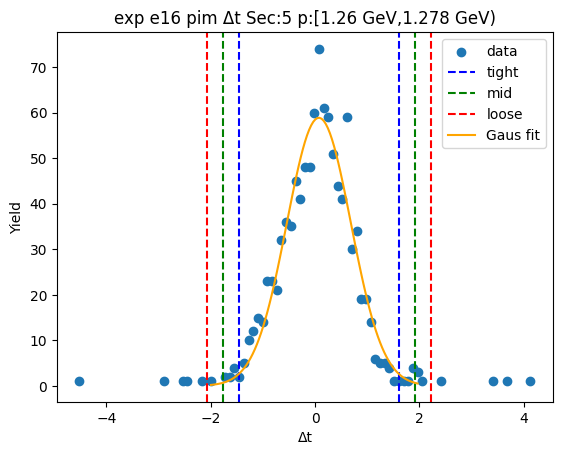

-1.670647419309096 1.726401051124864
-2.0103522663524918 2.0661058981682596
-2.350057113395888 2.4058107452116557


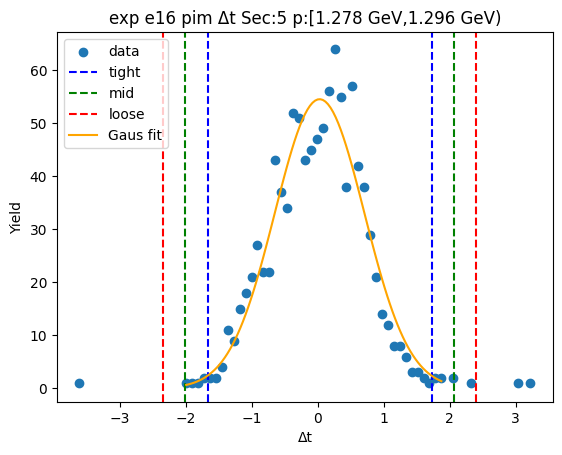

-1.4769758443314749 1.657271077096096
-1.7904005364742321 1.9706957692388531
-2.103825228616989 2.28412046138161


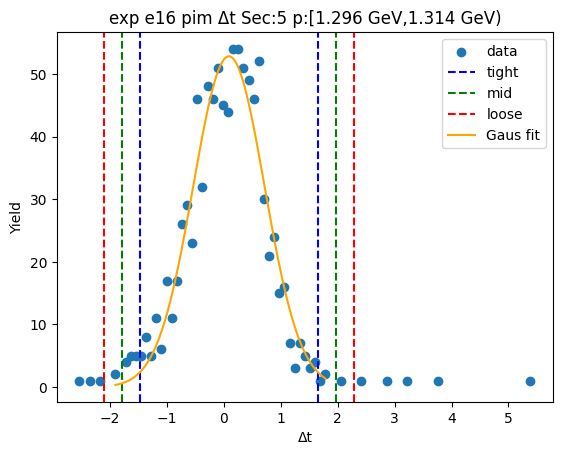

-1.3001481228123601 1.5330727183472275
-1.583470206928319 1.8163948024631864
-1.8667922910442778 2.099716886579145


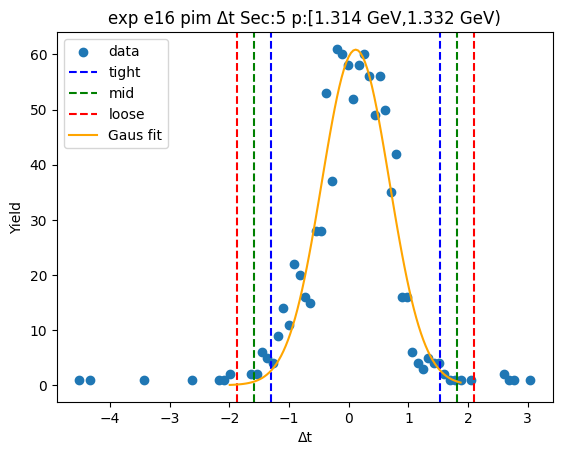

-1.4321834768245278 1.5870295530997203
-1.7341047798169527 1.888950856092145
-2.0360260828093772 2.1908721590845697


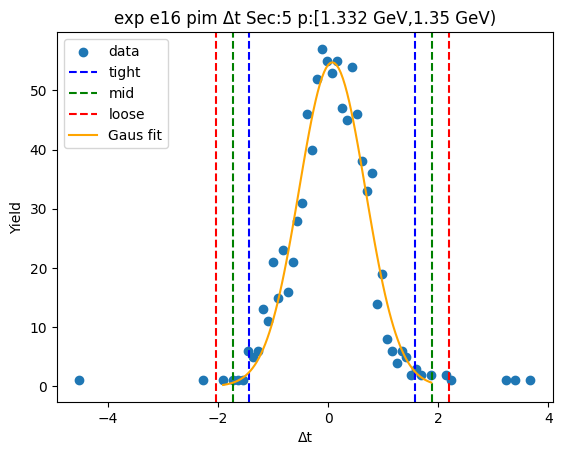

-1.382933441080461 1.6074438336818324
-1.6819711685566905 1.9064815611580619
-1.98100889603292 2.2055192886342914


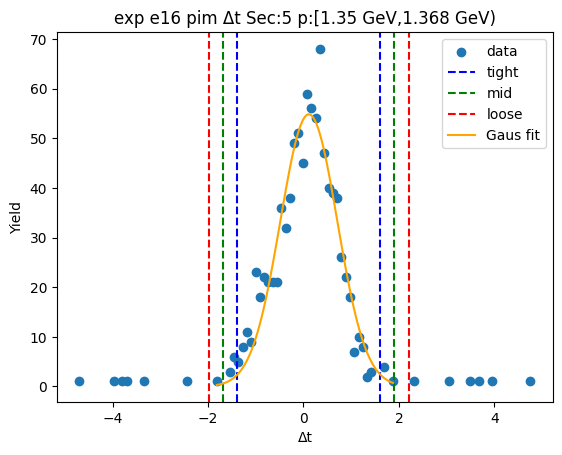

-1.5152935750191523 1.669376974980054
-1.8337606300190727 1.9878440299799744
-2.1522276850189934 2.306311084979895


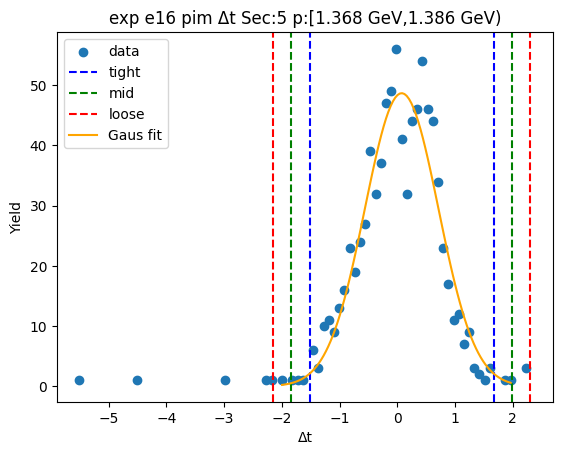

-1.4706795633377867 1.6066438112074706
-1.7784119007923123 1.9143761486619961
-2.0861442382468383 2.2221084861165217


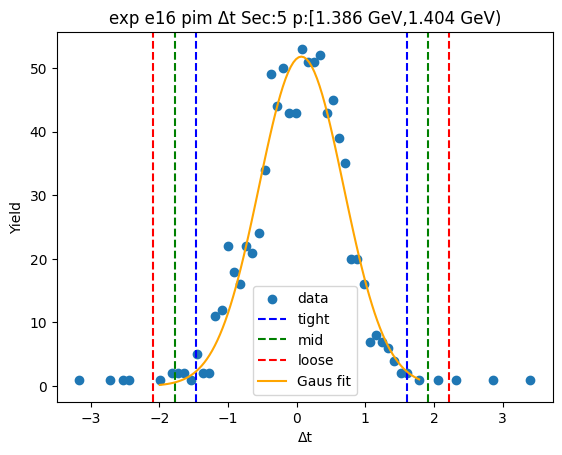

-1.244325290223767 1.5089585493751214
-1.519653674183656 1.7842869333350104
-1.7949820581435447 2.059615317294899


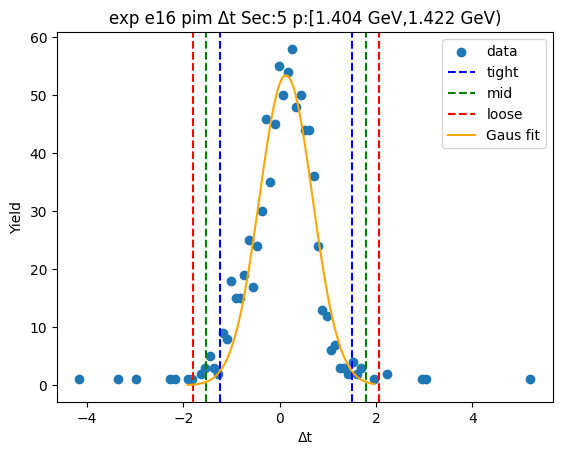

-1.4007151738865715 1.7146160390356922
-1.712248295178798 2.0261491603279187
-2.0237814164710244 2.337682281620145


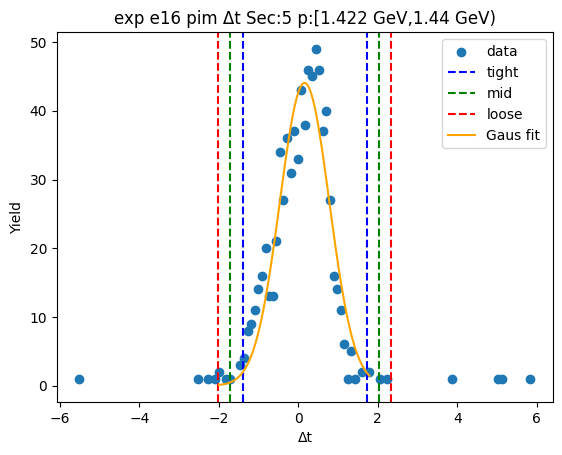

-1.2799730279855595 1.5297207199088
-1.5609424027749954 1.810690094698236
-1.8419117775644314 2.0916594694876722


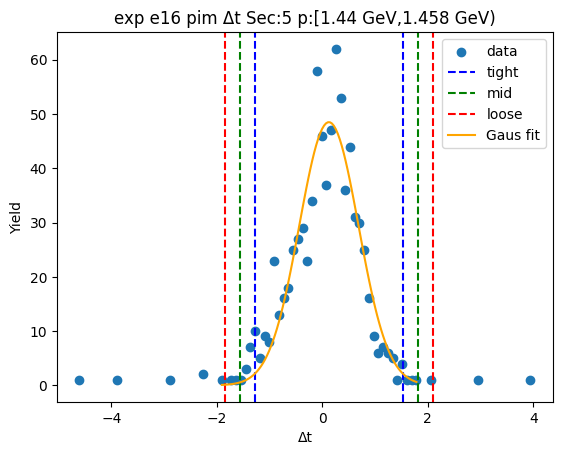

-1.2865355602602297 1.6077274176729122
-1.575961858053544 1.8971537154662264
-1.8653881558468581 2.1865800132595403


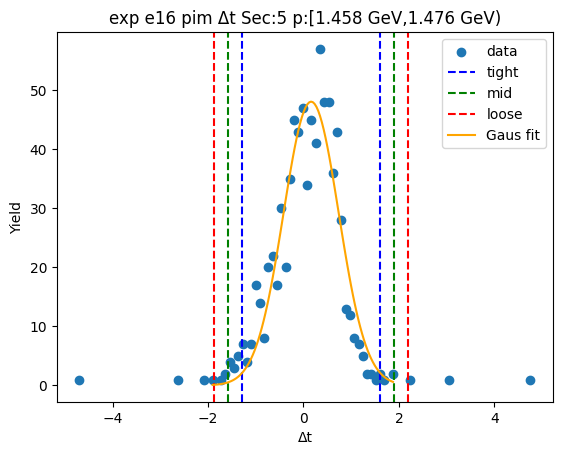

-1.2907810923758964 1.603144754203648
-1.580173677033851 1.8925373388616027
-1.8695662616918056 2.181929923519557


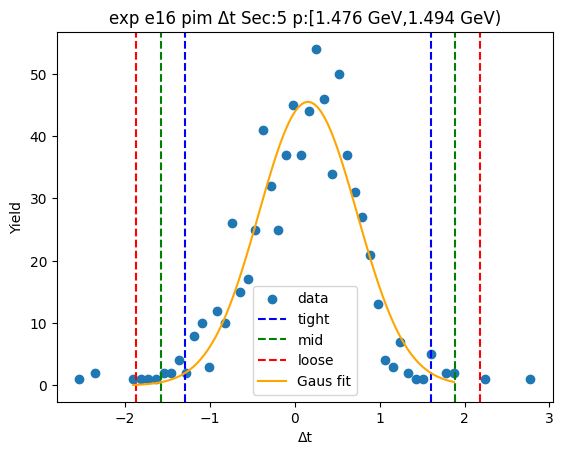

-1.4780726402064561 1.7239586530074964
-1.7982757695278515 2.044161782328892
-2.1184788988492467 2.3643649116502874


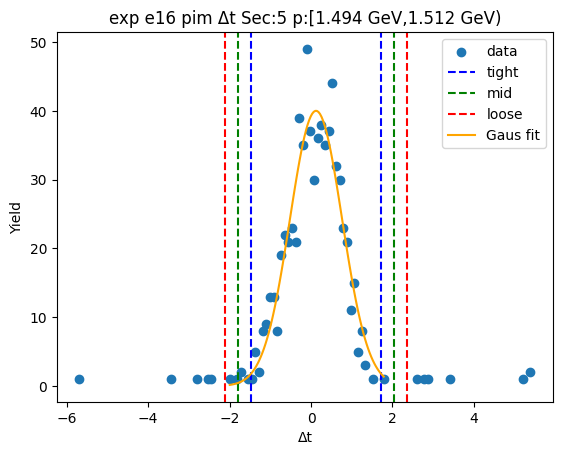

-1.4086118891641193 1.6398940813601146
-1.7134624862165428 1.9447446784125382
-2.018313083268966 2.2495952754649613


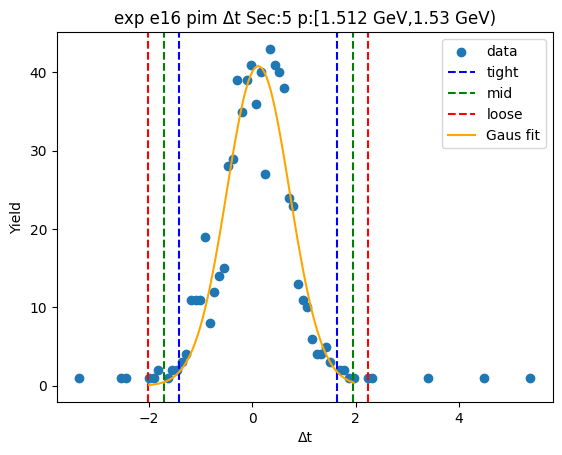

-1.4330905659587596 1.682946932557787
-1.7446943158104145 1.9945506824094419
-2.0562980656620686 2.3061544322610965


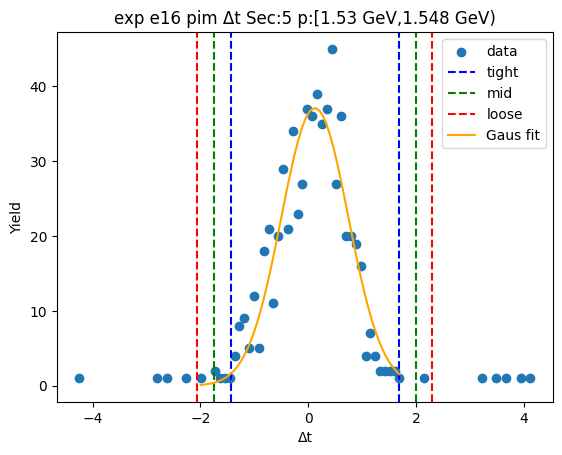

-1.3862410543626555 1.658565157147833
-1.6907216755137042 1.9630457782988817
-1.9952022966647533 2.267526399449931


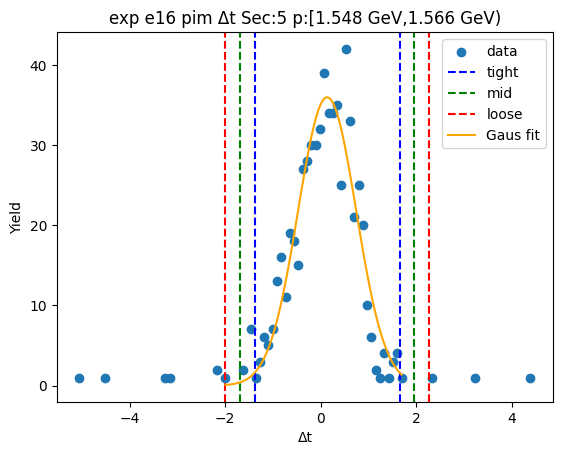

-1.2231563668329155 1.5298340604484015
-1.4984554095610472 1.8051331031765336
-1.7737544522891788 2.0804321459046653


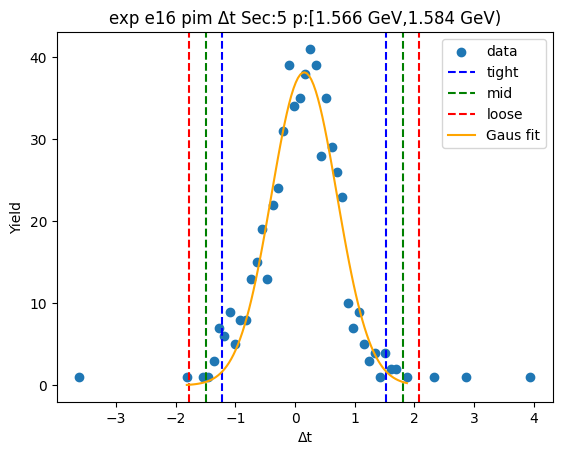

-1.0872013693565739 1.5387533284417485
-1.349796839136406 1.8013487982215806
-1.6123923089162382 2.063944268001413


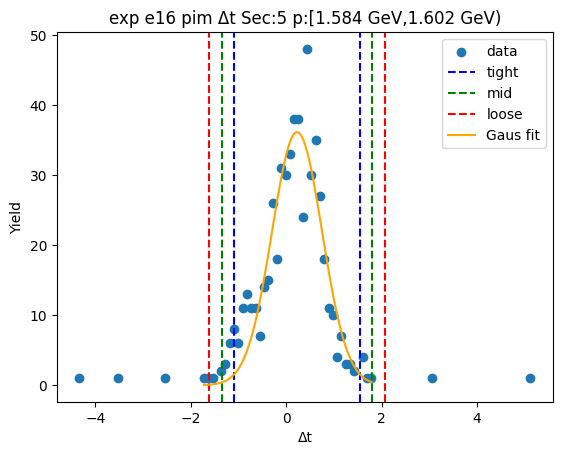

-1.3003198206232103 1.6680554405024766
-1.5971573467357791 1.9648929666150454
-1.8939948728483478 2.261730492727614


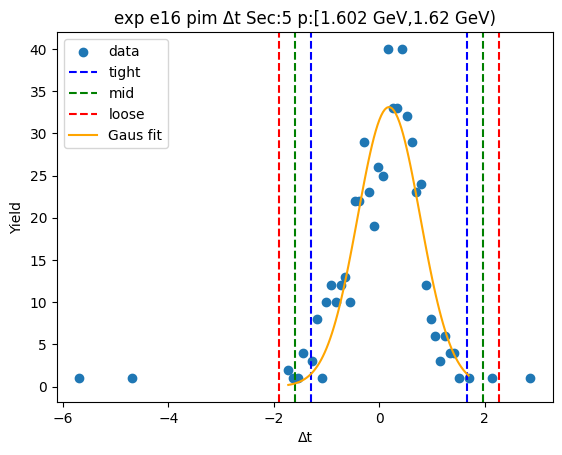

-1.308822553669715 1.6095699289972984
-1.600661801936416 1.9014091772639996
-1.8925010502031174 2.193248425530701


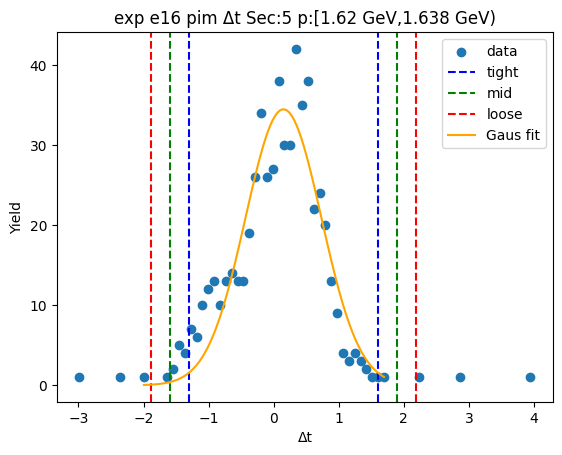

-1.3909266089498735 1.6625282985610879
-1.6962720997009695 1.9678737893121838
-2.0016175904520654 2.2732192800632802


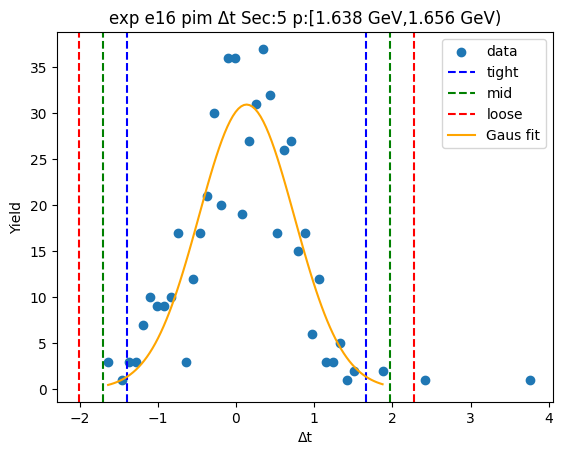

-1.3375851365800395 1.5832294755016756
-1.6296665977882112 1.8753109367098473
-1.9217480589963825 2.1673923979180185


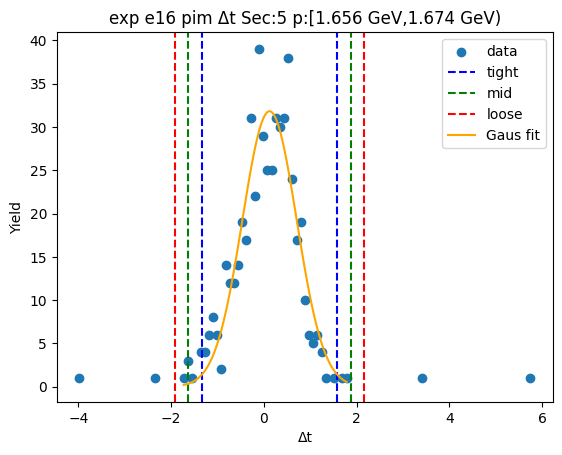

-1.2635108747079837 1.6981322548494642
-1.5596751876637287 1.9942965678052091
-1.8558395006194732 2.290460880760954


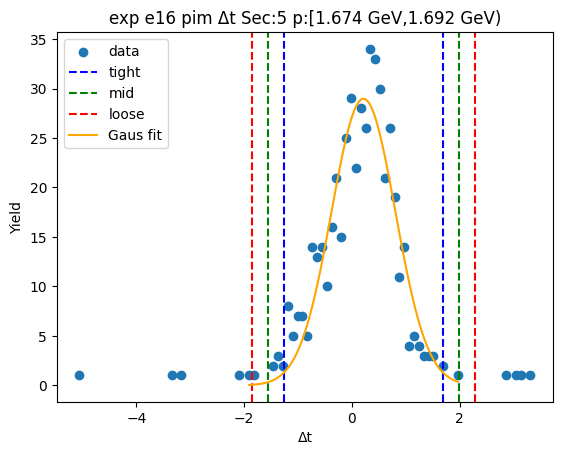

-1.181755840199393 1.6273711509639663
-1.4626685393157288 1.908283850080302
-1.7435812384320648 2.1891965491966383


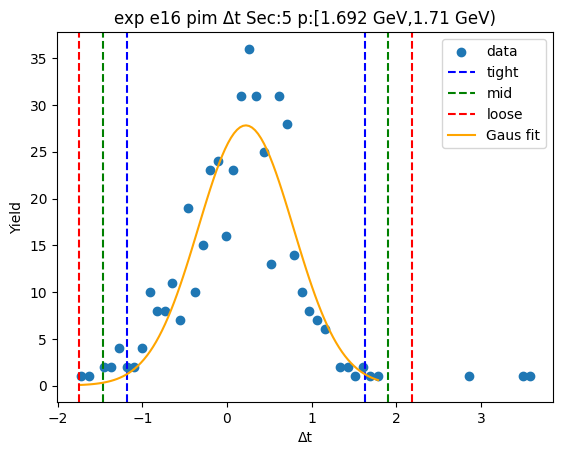

-1.2569377859749729 1.6899021491356128
-1.5516217794860314 1.9845861426466713
-1.8463057729970902 2.27927013615773


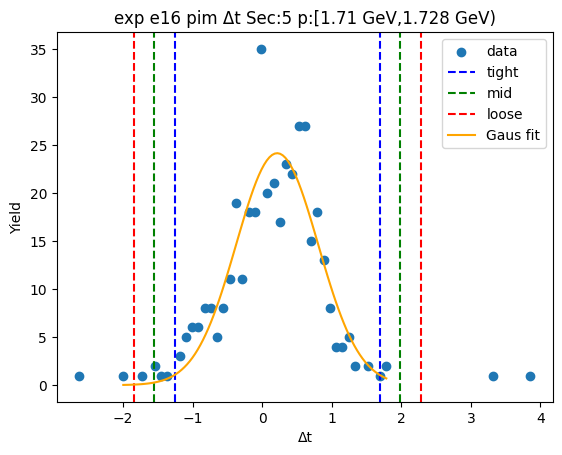

-1.3713868427867846 1.7603699641346835
-1.6845625234789312 2.07354564482683
-1.997738204171078 2.3867213255189768


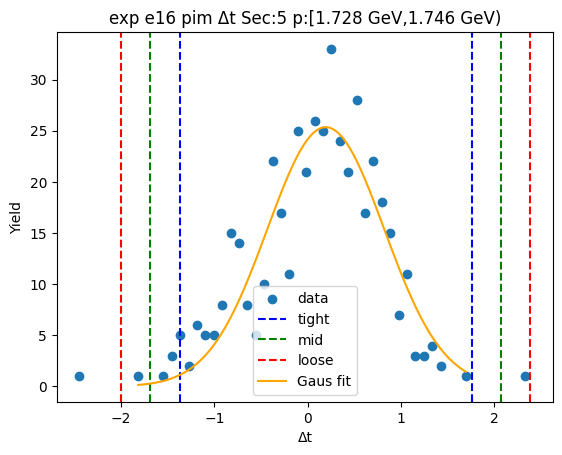

-1.361090322313707 1.8312383744030145
-1.680323191985379 2.1504712440746867
-1.9995560616570514 2.469704113746359


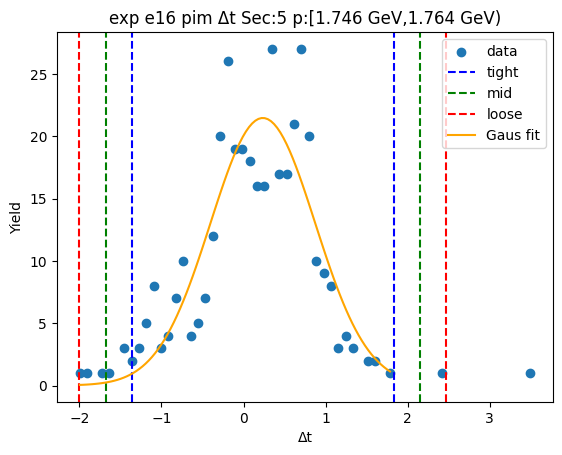

-1.005159712323994 1.611543854194629
-1.2668300689758558 1.8732142108464913
-1.5285004256277182 2.1348845674983536


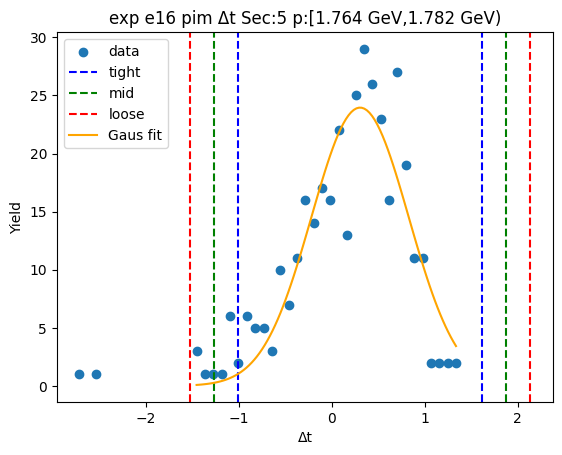

-1.0196078046336352 1.4924898541725786
-1.2708175705142566 1.7436996200532
-1.522027336394878 1.9949093859338214


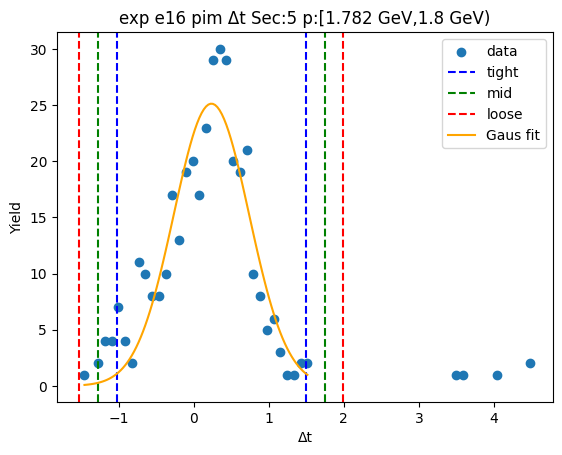

-1.2257096981315374 1.6344089104574133
-1.5117215589904325 1.9204207713163084
-1.7977334198493276 2.2064326321752037


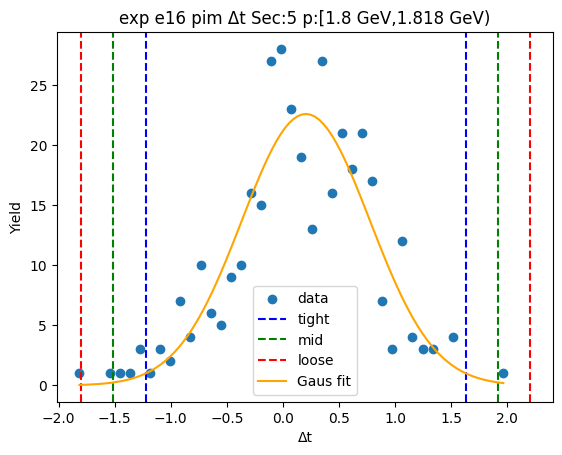

-1.060490483702937 1.6105836044343924
-1.3275978925166703 1.8776910132481253
-1.5947053013304031 2.1447984220618586


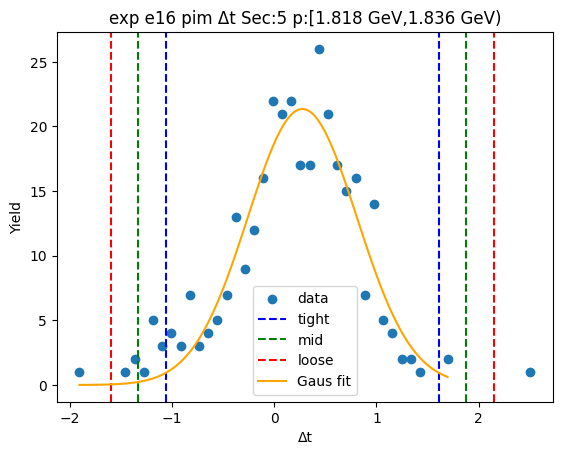

-1.0258684683585992 1.5322984182321993
-1.2816851570176793 1.7881151068912793
-1.537501845676759 2.043931795550359


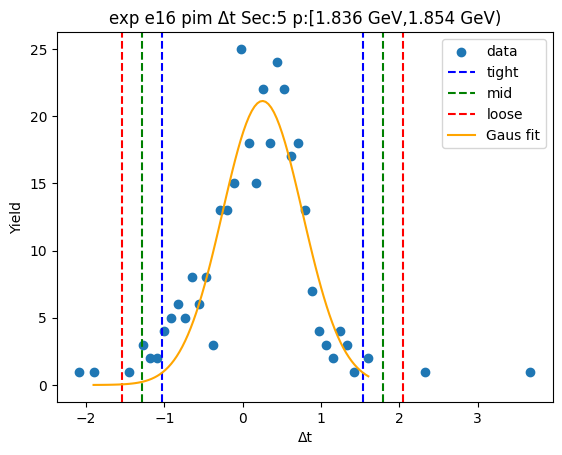

-1.2115550279854206 1.539753183285568
-1.4866858491125194 1.8148840044126668
-1.7618166702396183 2.0900148255397655


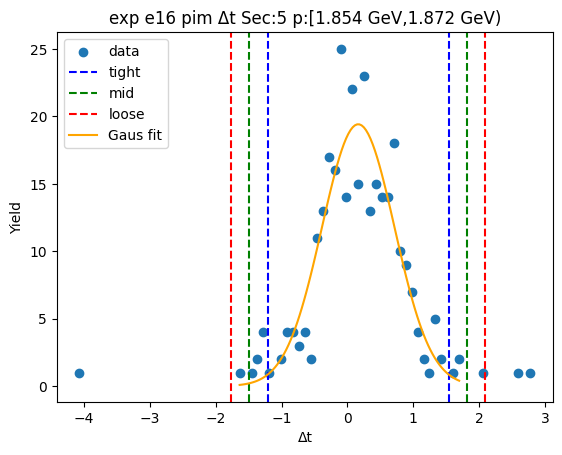

-1.2576894150343971 1.7168989693636258
-1.5551482534741998 2.014357807803428
-1.852607091914002 2.3118166462432304


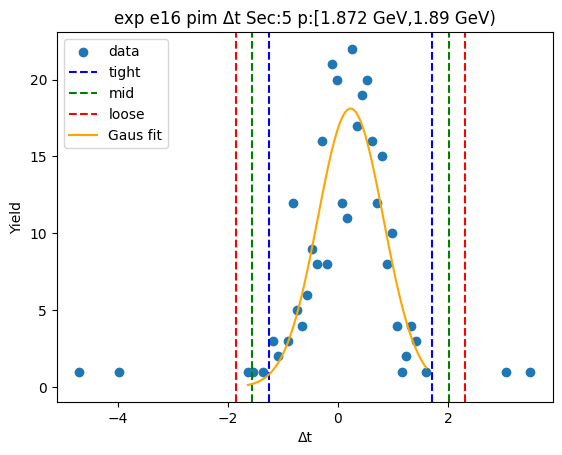

-1.2362435356078092 1.689344260668157
-1.528802315235406 1.9819030402957538
-1.8213610948630024 2.27446181992335


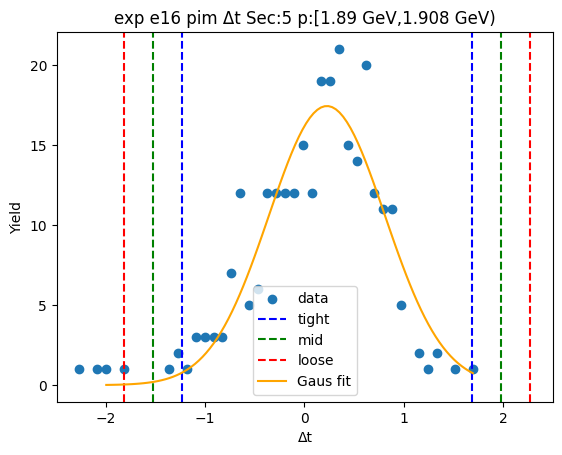

-1.3530766818500097 1.8116732024346949
-1.66955167027848 2.128148190863165
-1.9860266587069504 2.4446231792916358


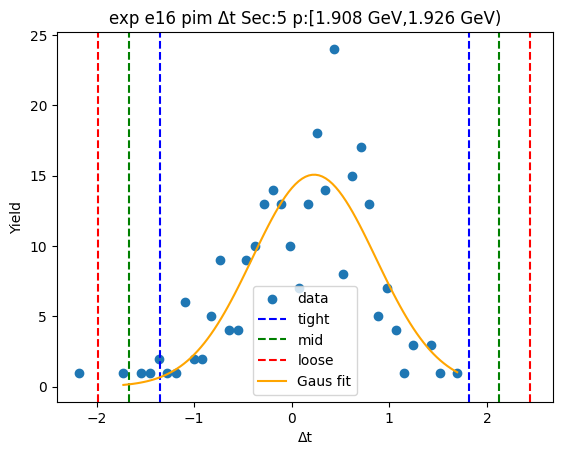

-1.3498550327861734 1.8168746435701368
-1.6665280004218044 2.133547611205768
-1.9832009680574356 2.450220578841399


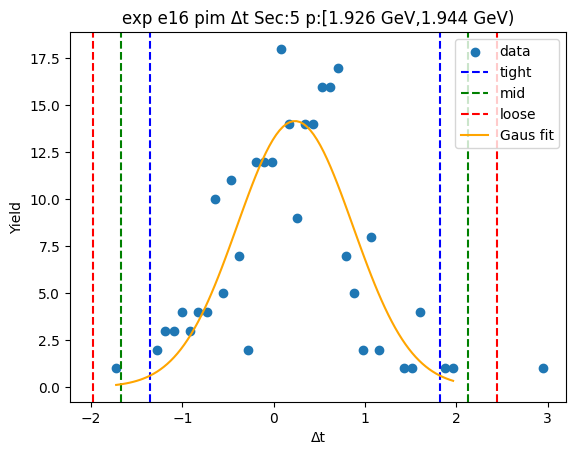

-1.1716669510671458 1.64895068849767
-1.4537287150236275 1.9310124524541517
-1.735790478980109 2.213074216410633


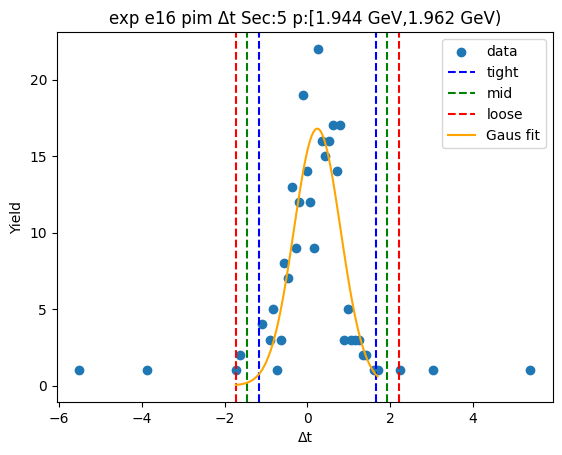

-1.11385069793777 1.4814219266009574
-1.3733779603916432 1.74094918905483
-1.6329052228455159 2.000476451508703


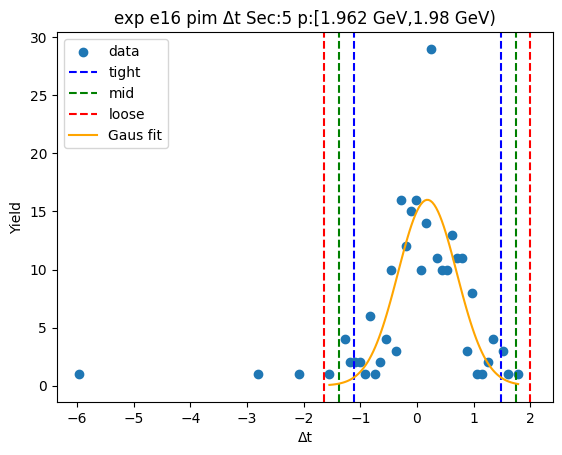

-1.2130100612232606 1.6431204165614697
-1.4986231090017335 1.9287334643399425
-1.7842361567802065 2.2143465121184156


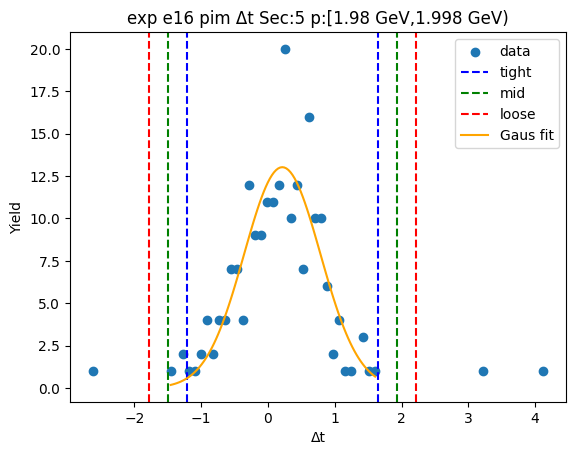

-0.9155920283990262 1.5351815663747452
-1.1606693878764034 1.7802589258521224
-1.4057467473537806 2.0253362853295


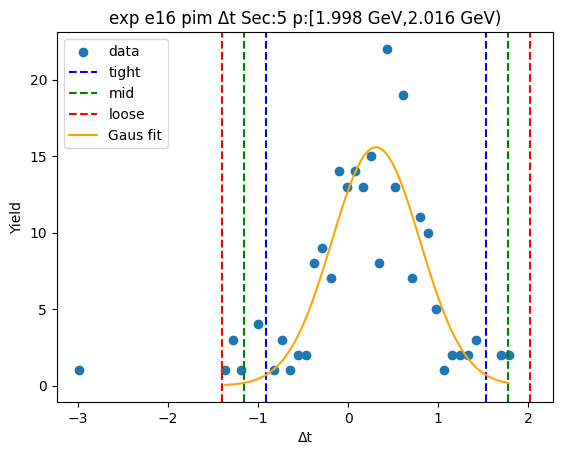

-1.1625892084982306 1.6585369160248236
-1.4447018209505358 1.9406495284771288
-1.7268144334028412 2.2227621409294342


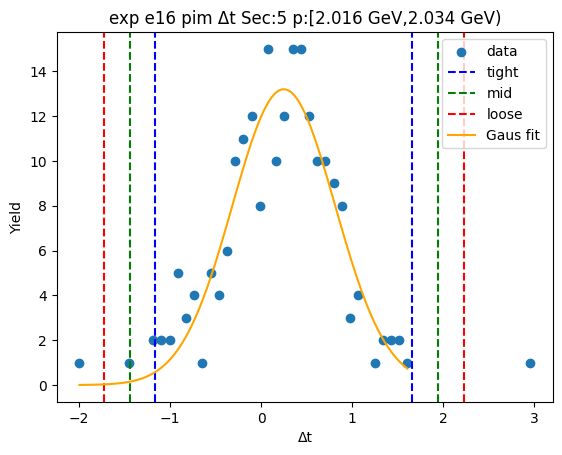

-1.1575029436943693 1.6880480433985476
-1.4420580424036609 1.9726031421078392
-1.7266131411129526 2.2571582408171307


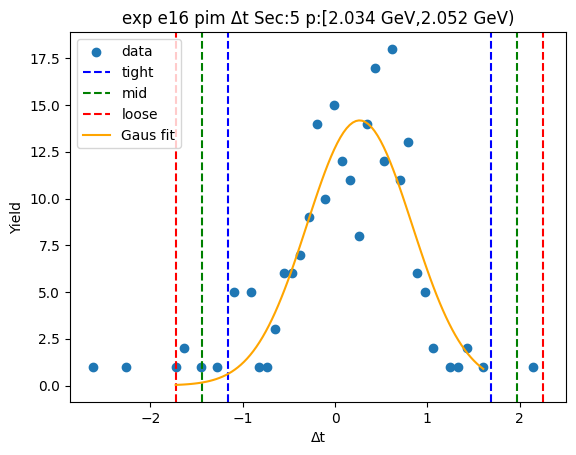

-1.1054214390994295 1.5493899629007846
-1.3709025792994507 1.8148711031008058
-1.636383719499472 2.0803522433008275


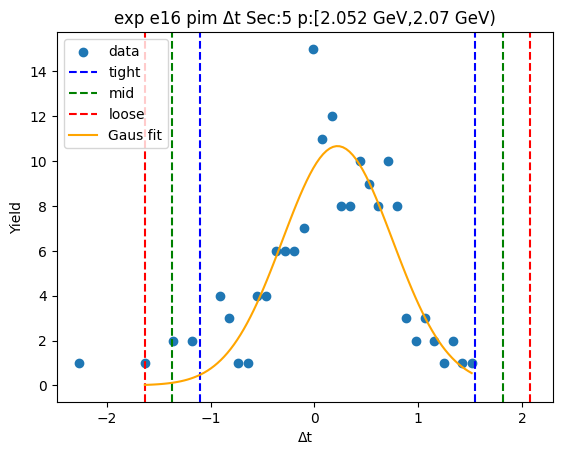

-1.1762845351610107 1.7787797003875345
-1.471790958715865 2.0742861239423886
-1.7672973822707199 2.3697925474972434


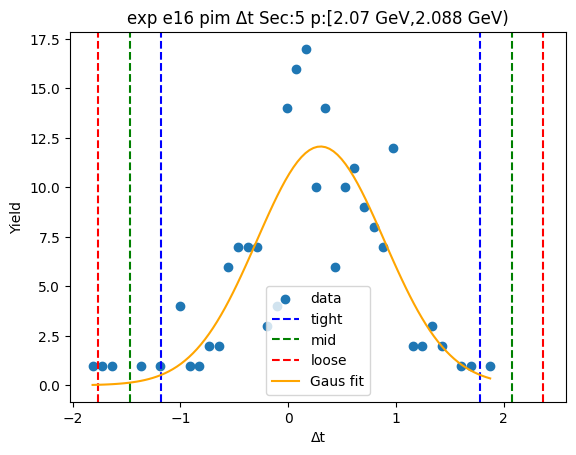

-1.0180922736891824 1.556965229880922
-1.275598024046193 1.8144709802379326
-1.5331037744032034 2.071976730594943


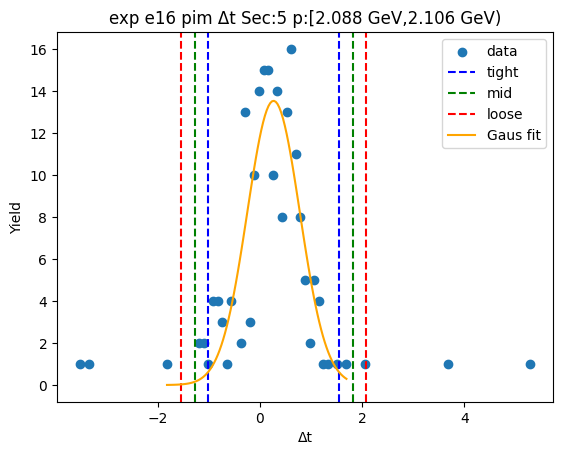

-1.4452845841167754 1.7738145352959558
-1.7671944960580483 2.0957244472372287
-2.0891044079993217 2.417634359178502


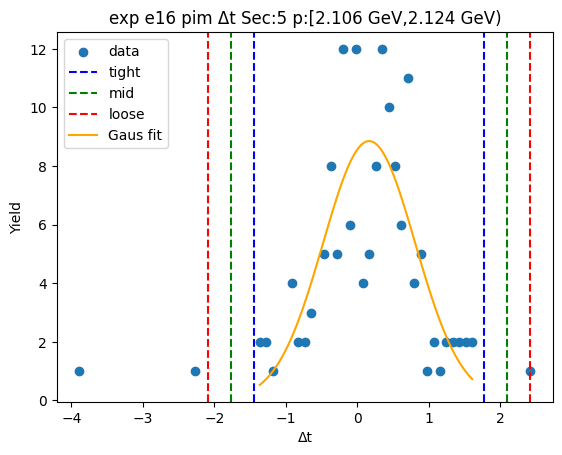

-0.9476579738707716 1.6544629588852726
-1.2078700671463758 1.9146750521608769
-1.4680821604219803 2.174887145436481


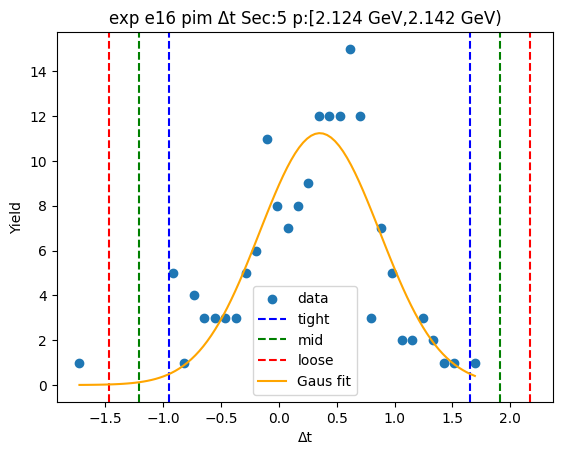

-1.2104665513185076 1.8113234041142272
-1.5126455468617812 2.113502399657501
-1.8148245424050544 2.415681395200774


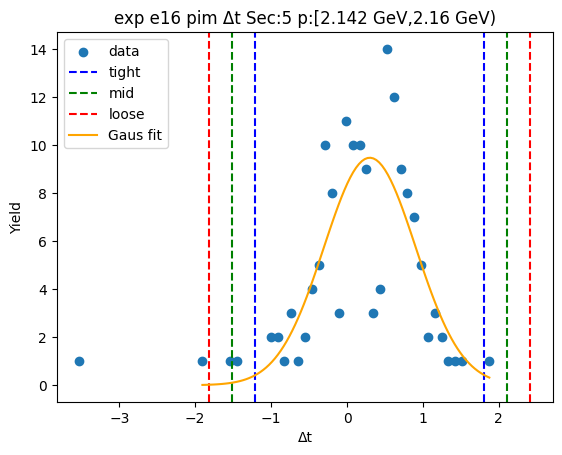

-0.9762122879096293 1.533865571843898
-1.2272200738849819 1.7848733578192506
-1.4782278598603347 2.0358811437946036


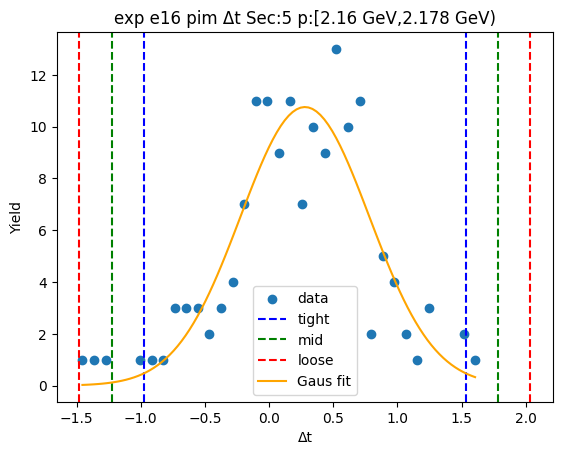

-0.8241666425923131 1.6913125646690306
-1.0757145633184473 1.9428604853951648
-1.3272624840445817 2.1944084061212994


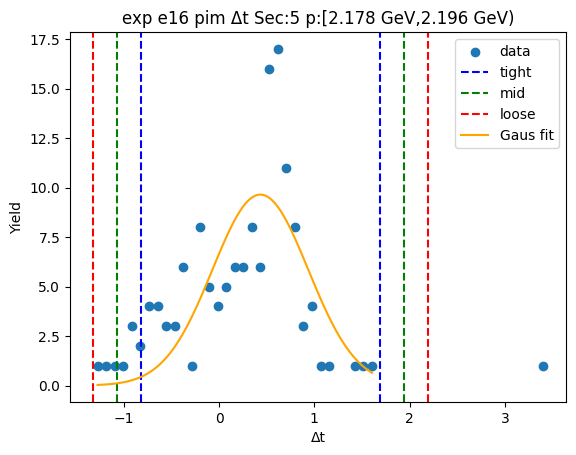

-0.8786992056493612 1.4832352659251216
-1.1148926528068095 1.7194287130825698
-1.3510860999642578 1.9556221602400181


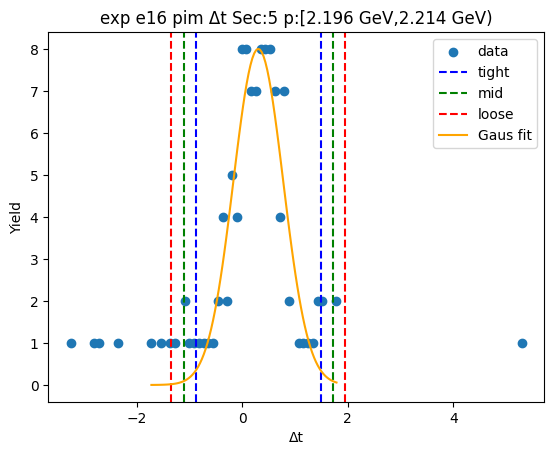

-1.2810532455623158 1.9180667384693066
-1.600965243965478 2.2379787368724693
-1.9208772423686402 2.5578907352756315


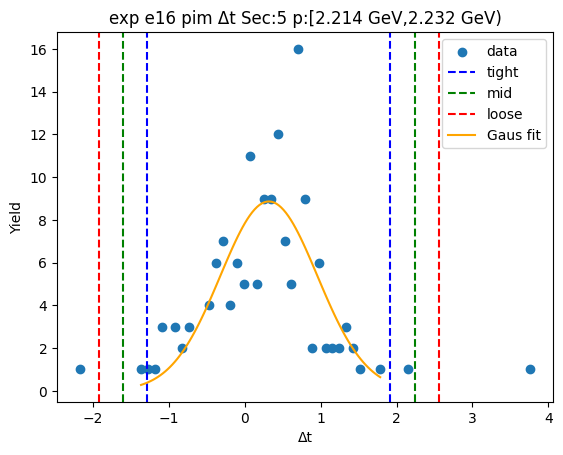

-0.8347232619374427 1.4989857815174918
-1.0680941662829362 1.7323566858629853
-1.3014650706284296 1.9657275902084788


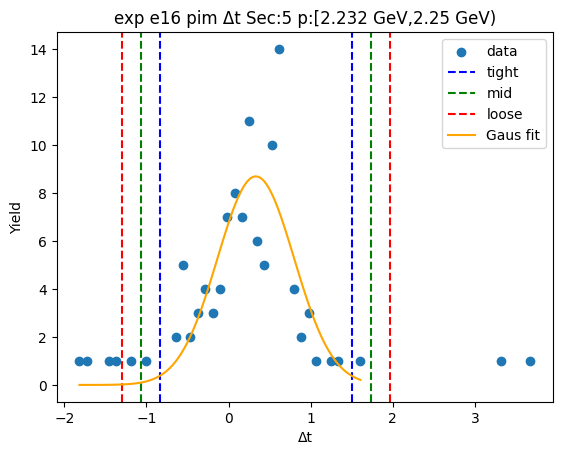

-1.0600147184168713 1.6506159588535463
-1.331077786143913 1.9216790265805879
-1.6021408538709547 2.1927420943076297


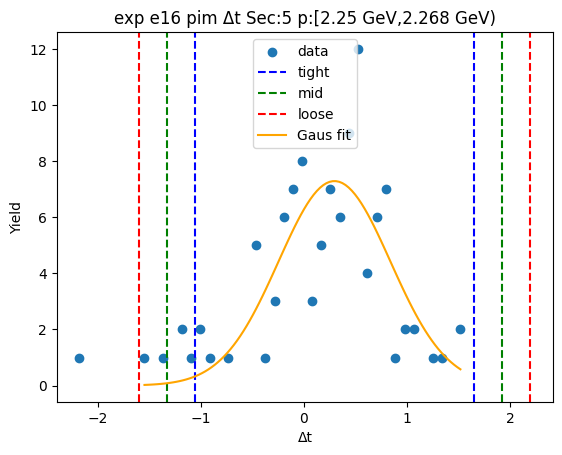

-1.043831253846031 1.4511351275620676
-1.293327891986841 1.7006317657028776
-1.5428245301276509 1.9501284038436875


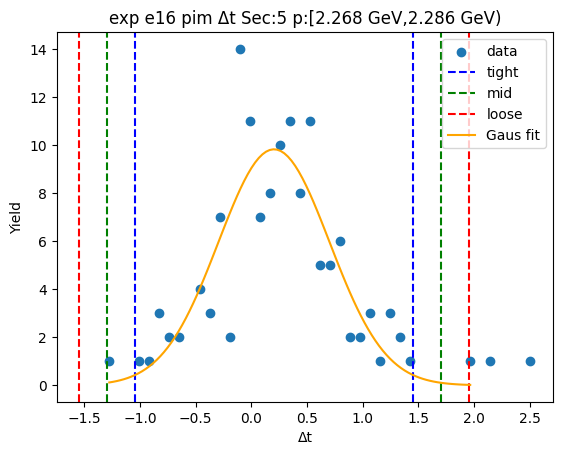

-1.416862336831621 1.9162638586355325
-1.7501749563783366 2.249576478182248
-2.083487575925052 2.582889097728963


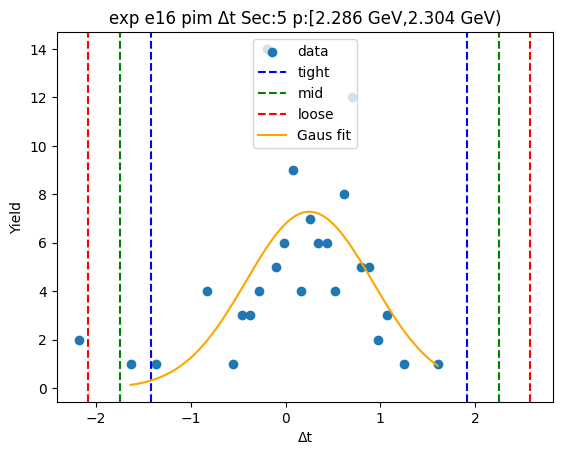

-0.9310018735045367 1.6613188895558813
-1.1902339498105783 1.9205509658619229
-1.4494660261166201 2.1797830421679647


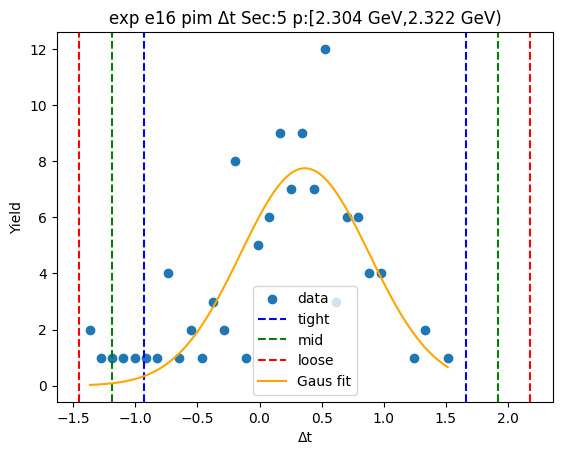

-1.739288506845117 2.215150463268711
-2.1347324038565003 2.610594360280094
-2.530176300867883 3.006038257291477


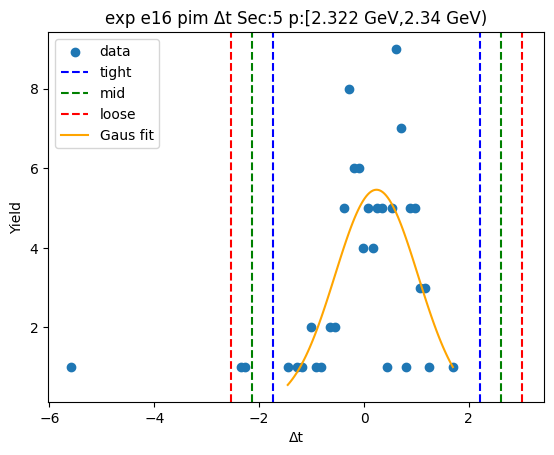

-0.7085899168531798 1.4642598514063483
-0.9258748936791327 1.6815448282323011
-1.1431598705050856 1.898829805058254


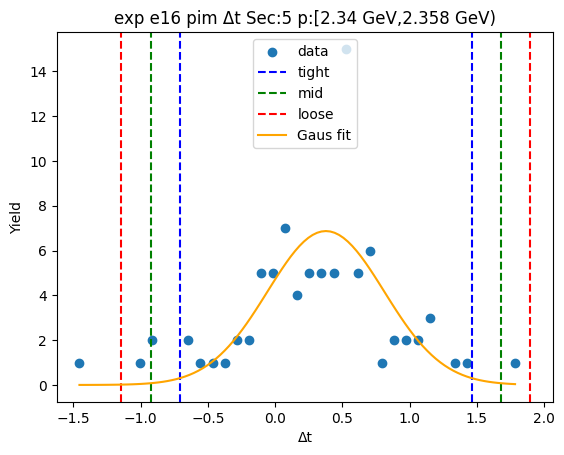

-2.0920923090857633 2.298801144132076
-2.531181654407547 2.7378904894538607
-2.9702709997293306 3.1769798347756444


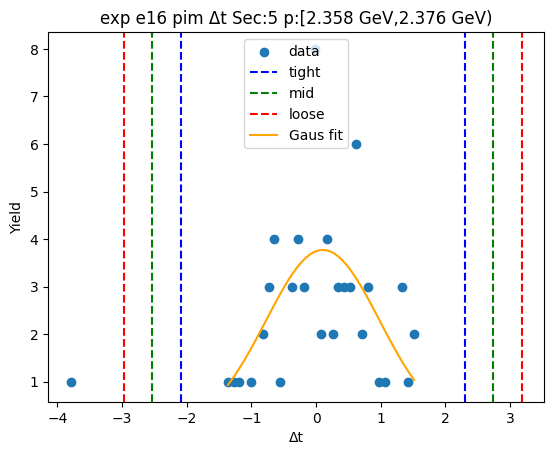

-1.3846666477704428 1.690824982451904
-1.6922158107926775 1.9983741454741386
-1.9997649738149121 2.3059233084963733


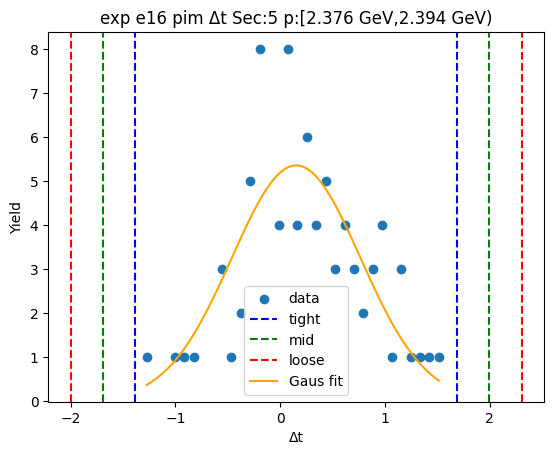

0.9466374141549875 -1.4291773123283298
1.184218886803319 -1.6667587849766614
1.4218003594516508 -1.9043402576249933


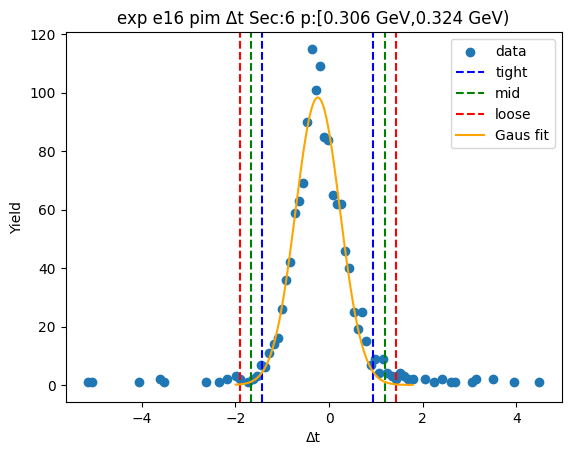

1.144040629941847 -1.6096594295493638
1.4194106358909682 -1.885029435498485
1.6947806418400893 -2.160399441447606


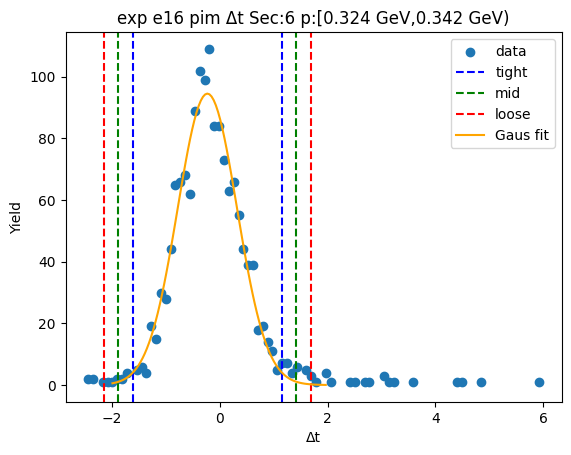

1.0045507443366484 -1.3889610563727026
1.2439019244075835 -1.6283122364436378
1.4832531044785187 -1.867663416514573


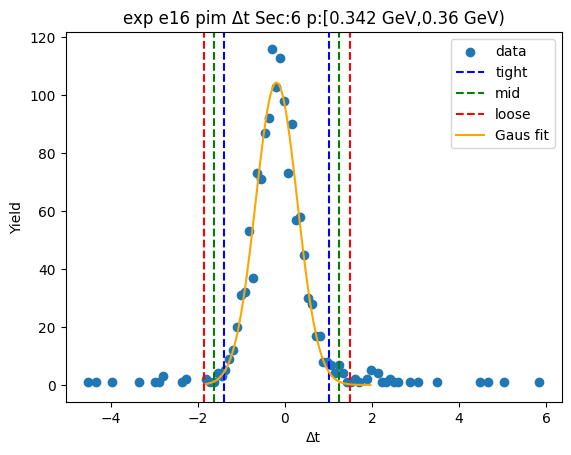

0.9682429876753259 -1.4239635704530573
1.2074636434881643 -1.6631842262658956
1.4466842993010027 -1.902404882078734


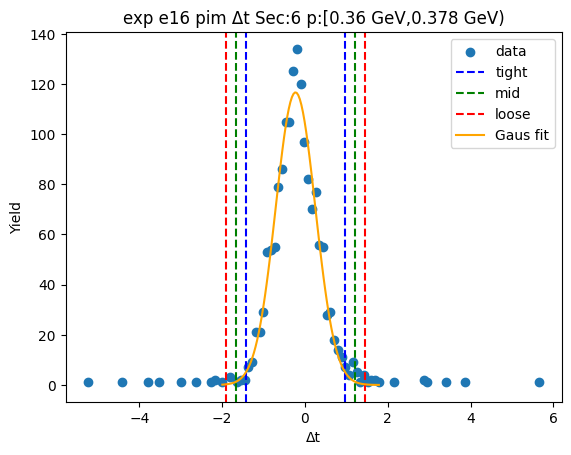

0.9483541147591195 -1.4292378194794597
1.1861133081829773 -1.6669970129033176
1.4238725016068352 -1.9047562063271755


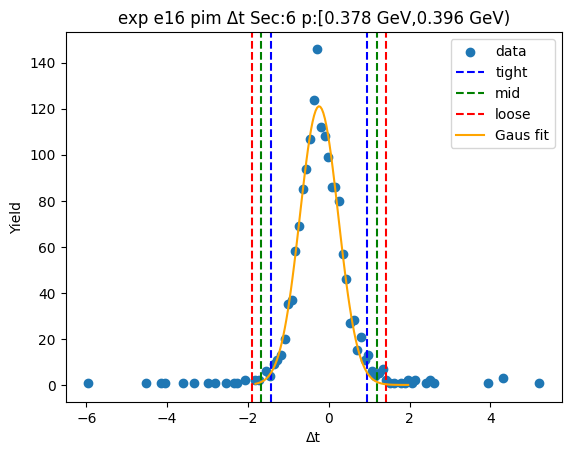

0.9635628197602404 -1.4088454386563363
1.2008036456018982 -1.6460862644979941
1.4380444714435558 -1.8833270903396517


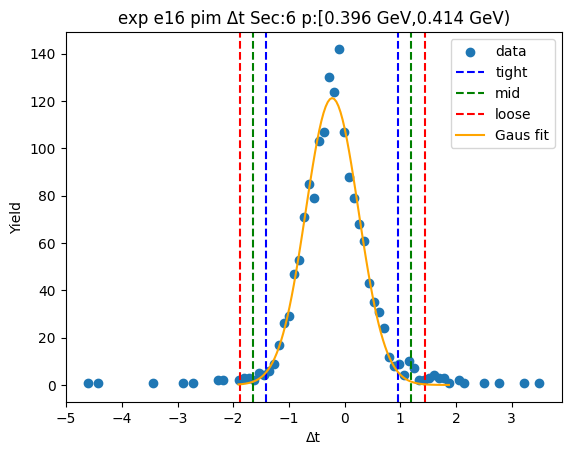

1.0336061615869394 -1.4333235353896996
1.2802991312846033 -1.6800165050873634
1.5269921009822671 -1.9267094747850273


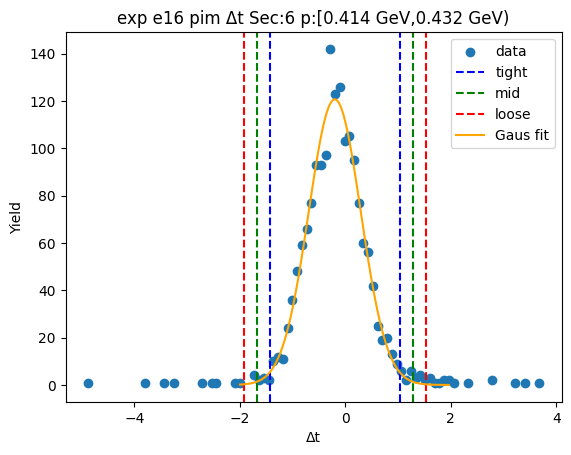

1.0492815287761357 -1.3978807494331773
1.293997756597067 -1.6425969772541087
1.5387139844179982 -1.8873132050750399


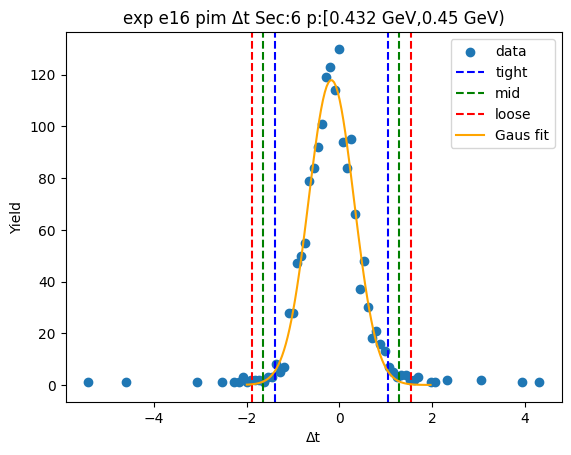

0.9888545621253846 -1.3613561886936763
1.2238756372072905 -1.5963772637755822
1.4588967122891965 -1.8313983388574882


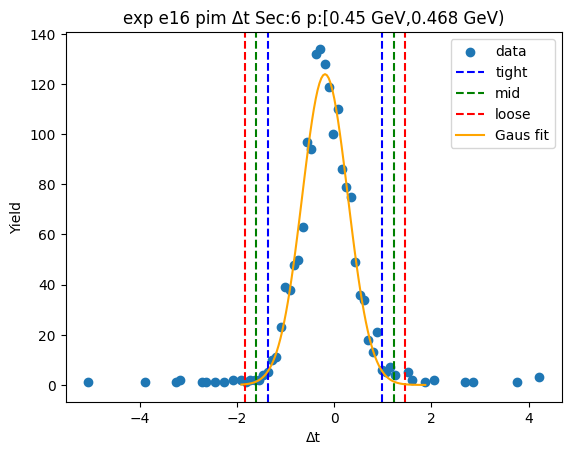

0.9658957223426392 -1.3805107142544846
1.2005363660023516 -1.615151357914197
1.435177009662064 -1.8497920015739093


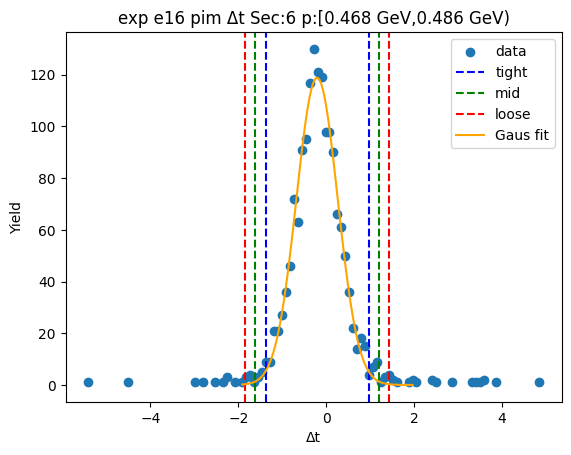

0.9334353584326663 -1.3409278011590833
1.1608716743918412 -1.568364117118258
1.3883079903510163 -1.795800433077433


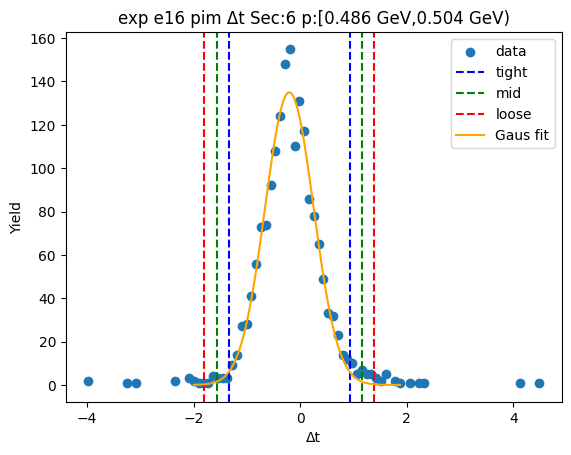

0.9774107910575194 -1.368359507300342
1.2119878208933055 -1.6029365371361282
1.4465648507290916 -1.8375135669719143


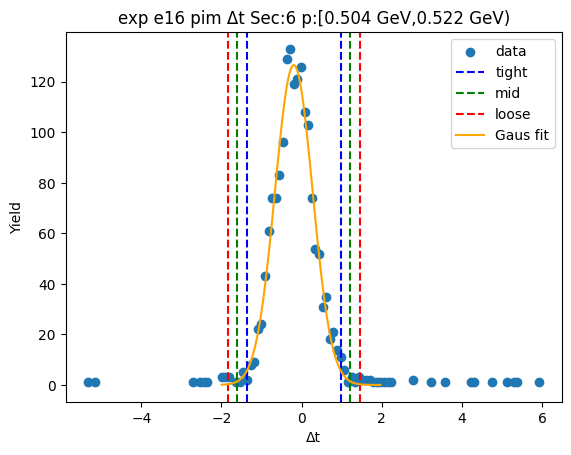

0.9708249409634572 -1.4274803531221723
1.2106554703720198 -1.667310882530735
1.4504859997805828 -1.907141411939298


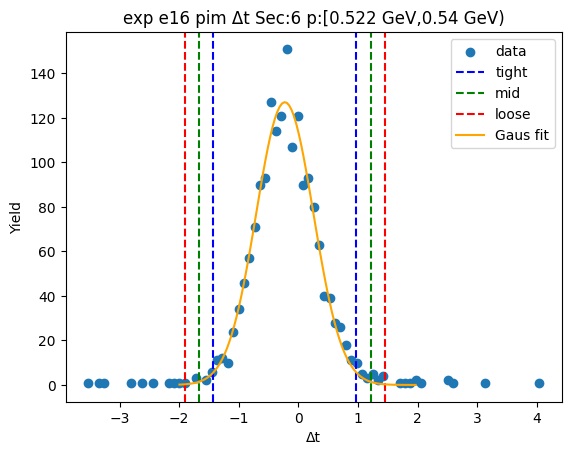

1.0094425150417512 -1.4025546949149457
1.250642236037421 -1.6437544159106154
1.4918419570330905 -1.884954136906285


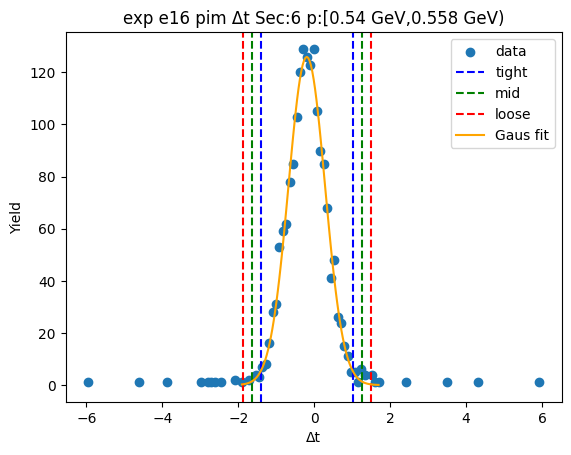

1.0288484488316663 -1.4368964670191902
1.2754229404167519 -1.6834709586042758
1.5219974320018375 -1.9300454501893614


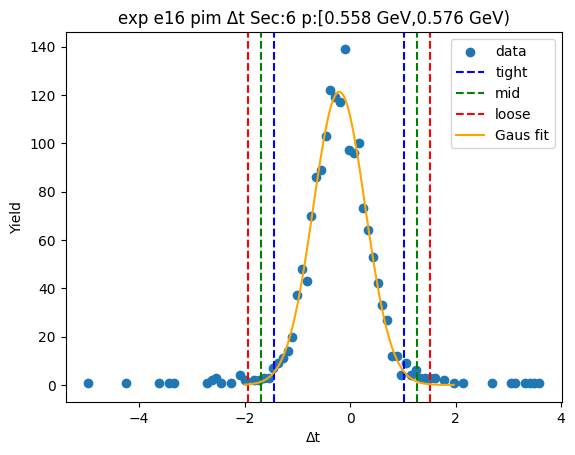

1.0015467886579927 -1.3881230242950122
1.240513769953293 -1.6270900055903126
1.4794807512485935 -1.866056986885613


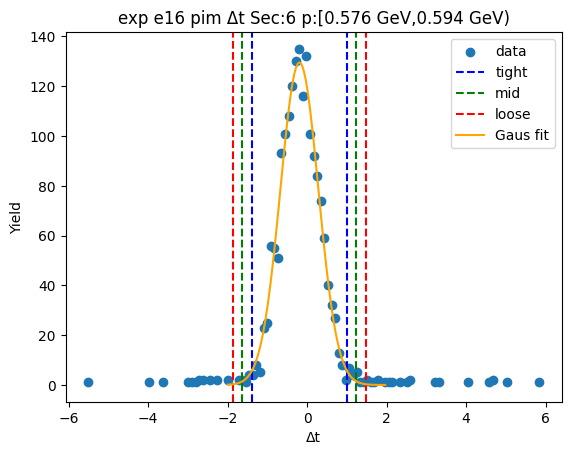

0.9170308703004589 -1.3049350257352719
1.139227459904032 -1.5271316153388448
1.361424049507605 -1.749328204942418


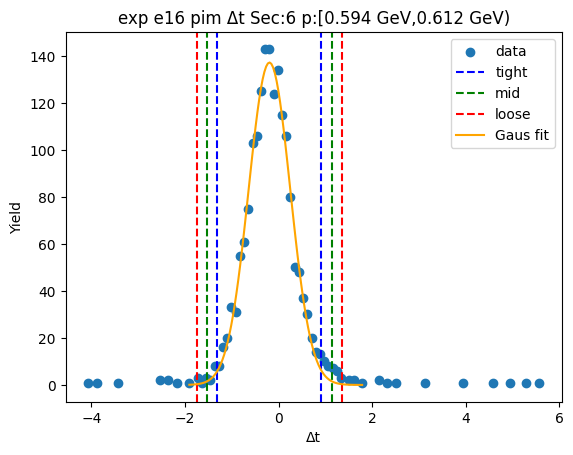

0.931573848625691 -1.3110175905132209
1.1558329925395823 -1.535276734427112
1.3800921364534735 -1.7595358783410033


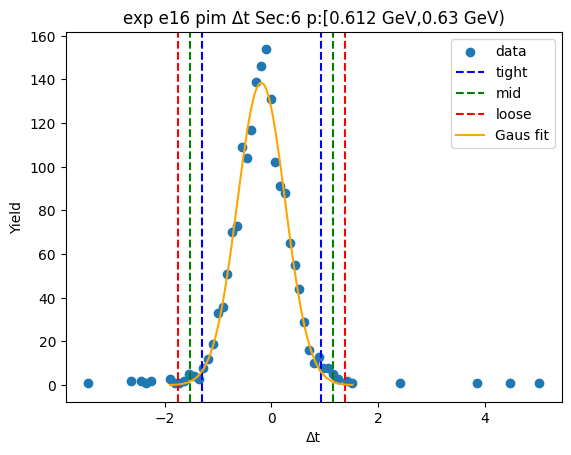

1.0216414015532163 -1.377746326210029
1.2615801743295407 -1.6176850989863534
1.5015189471058652 -1.8576238717626778


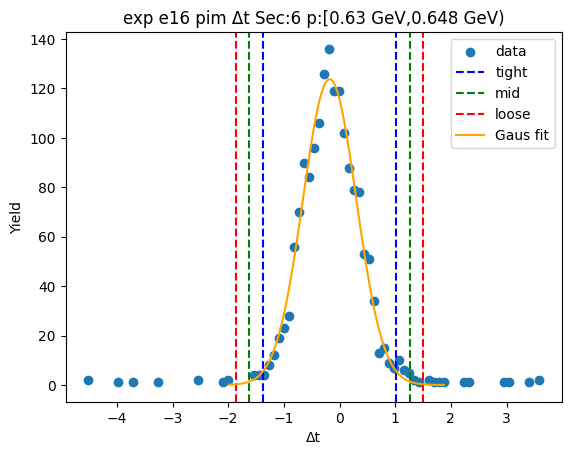

0.9667450197519658 -1.386928193006244
1.202112341027787 -1.6222955142820652
1.437479662303608 -1.8576628355578861


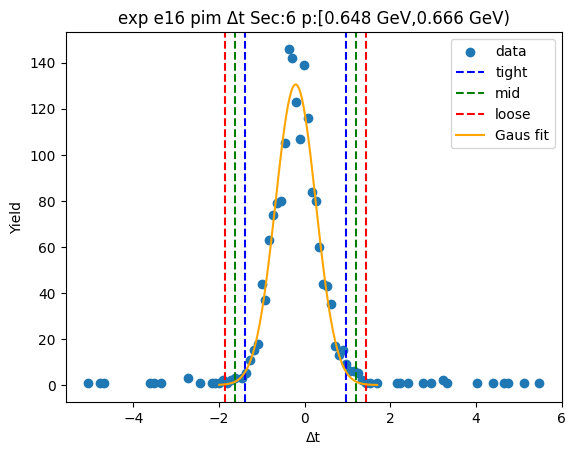

0.9984299820319964 -1.3997588098016691
1.2382488612153628 -1.6395776889850355
1.4780677403987292 -1.879396568168402


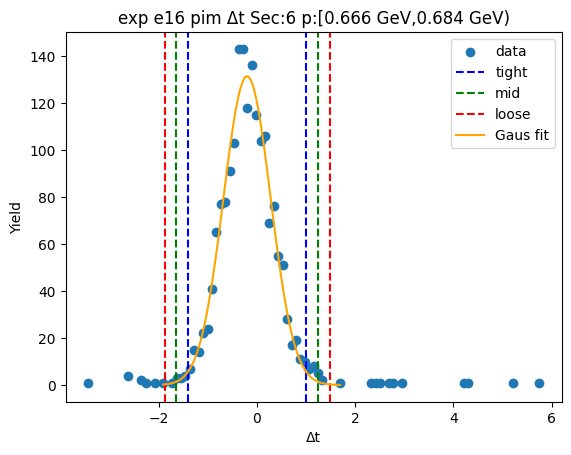

0.9414857260918459 -1.3292053768139578
1.168554836382426 -1.556274487104538
1.3956239466730065 -1.7833435973951184


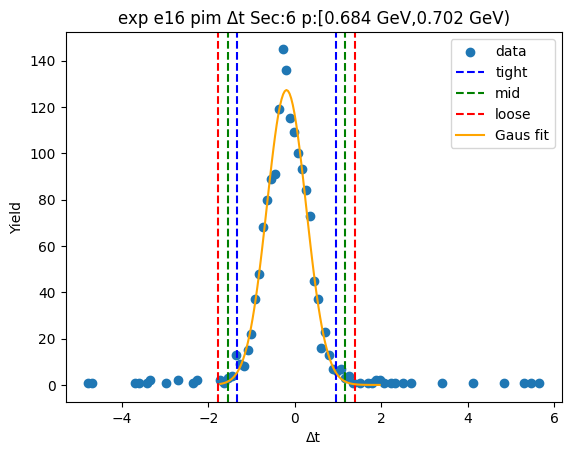

0.9401408421635347 -1.3404434606018498
1.168199272440073 -1.568501890878388
1.3962577027166114 -1.7965603211549266


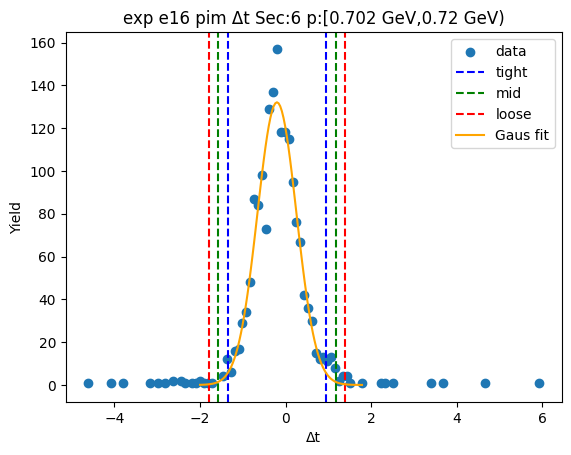

0.9529966788314751 -1.3175879071984495
1.1800551374344674 -1.544646365801442
1.40711359603746 -1.7717048244044344


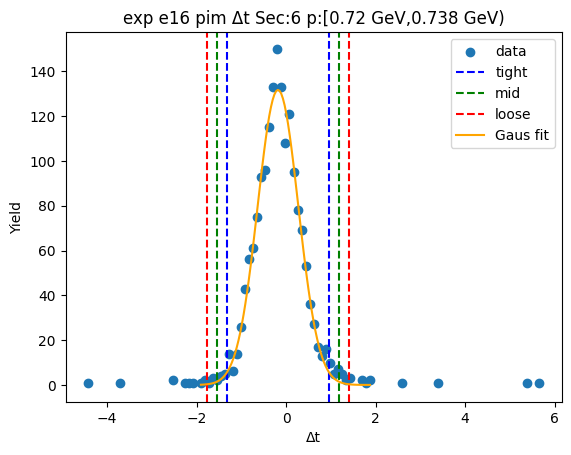

0.9451466341647747 -1.3662695480909934
1.1762882523903517 -1.5974111663165704
1.4074298706159285 -1.8285527845421472


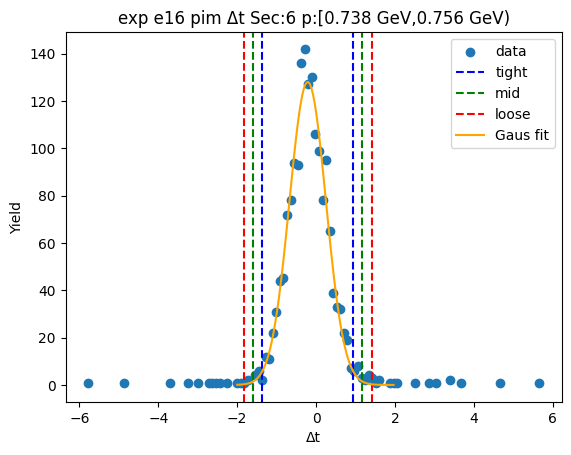

0.9872764727373772 -1.3576779307944782
1.2217719130905629 -1.5921733711476638
1.4562673534437485 -1.8266688115008494


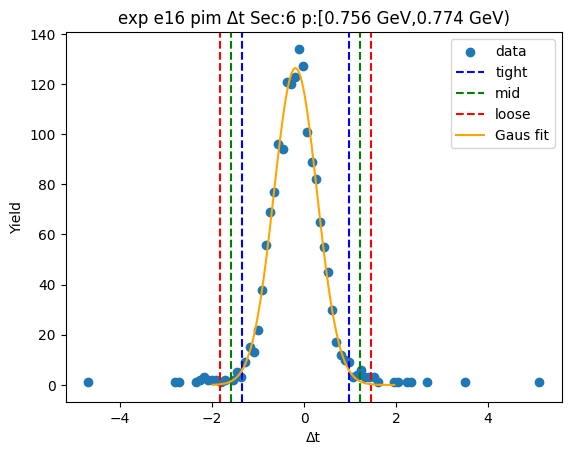

0.8908626559034882 -1.2973381576488778
1.109682737258725 -1.5161582390041146
1.3285028186139616 -1.7349783203593512


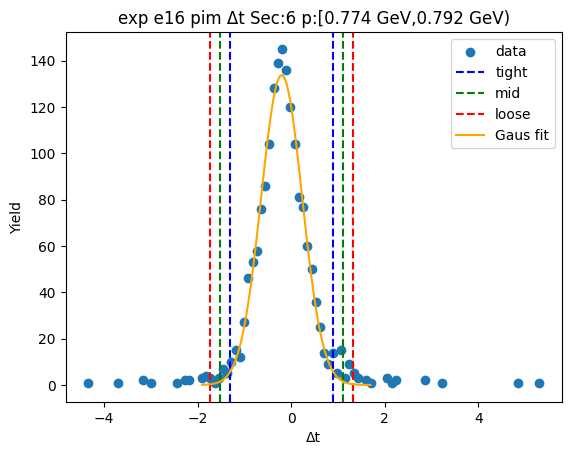

0.9427210031966794 -1.346254814990913
1.1716185850154388 -1.5751523968096723
1.400516166834198 -1.8040499786284316


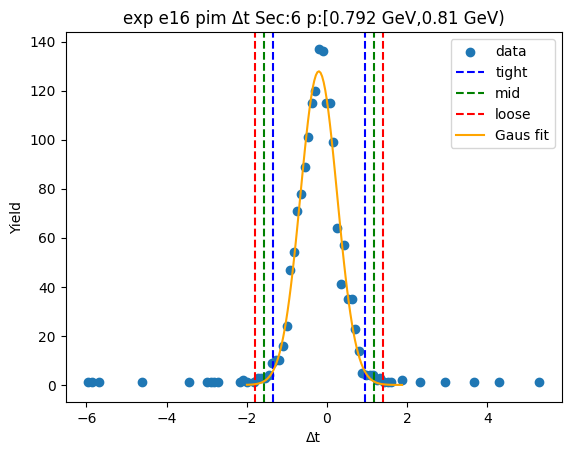

0.9458381711718657 -1.342990051904354
1.1747209934794878 -1.571872874211976
1.4036038157871098 -1.800755696519598


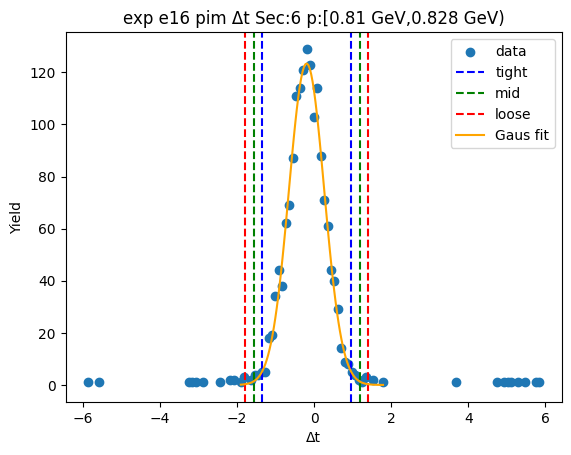

0.9241452817263482 -1.323045714553643
1.1488643813543475 -1.5477648141816422
1.3735834809823466 -1.7724839138096413


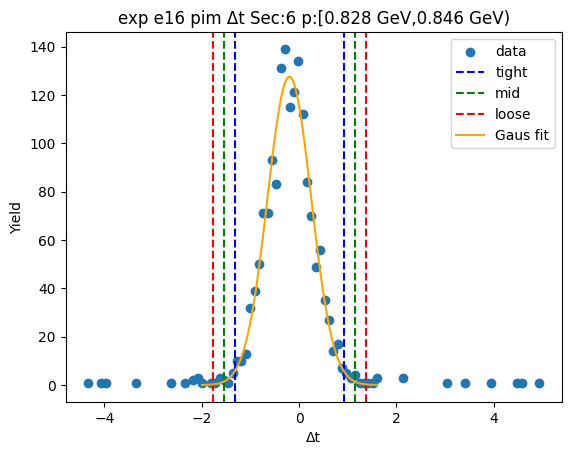

0.9398300529659085 -1.3696386741132665
1.170776925673826 -1.600585546821184
1.4017237983817434 -1.8315324195291014


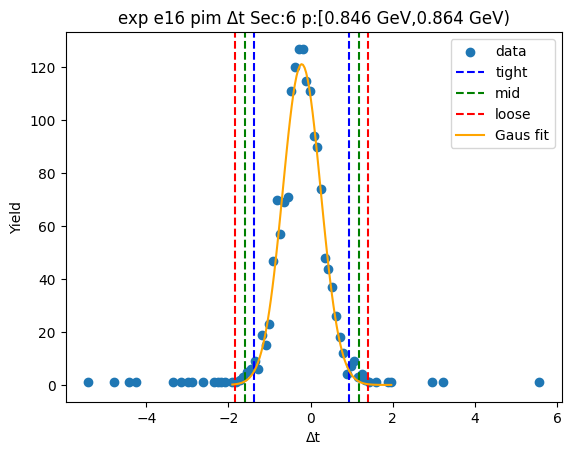

1.001627266340319 -1.3601407339347966
1.2378040663678305 -1.5963175339623081
1.473980866395342 -1.8324943339898196


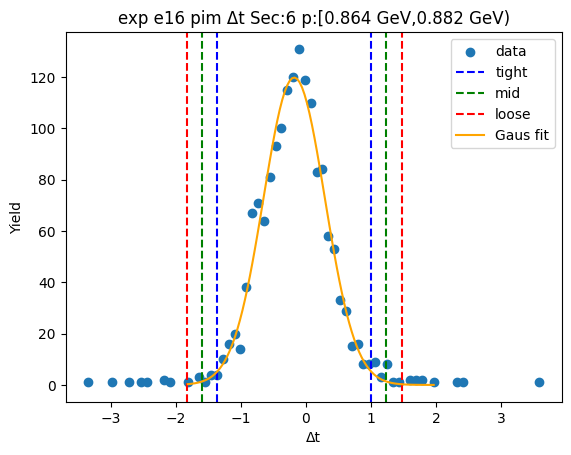

0.8644521922577625 -1.2583376943513653
1.0767311809186755 -1.4706166830122782
1.2890101695795881 -1.6828956716731909


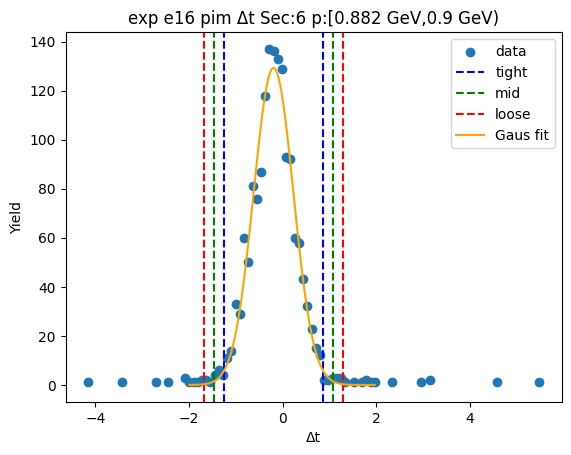

0.9504462204656492 -1.303573322515354
1.1758481747637497 -1.5289752768134546
1.40125012906185 -1.7543772311115549


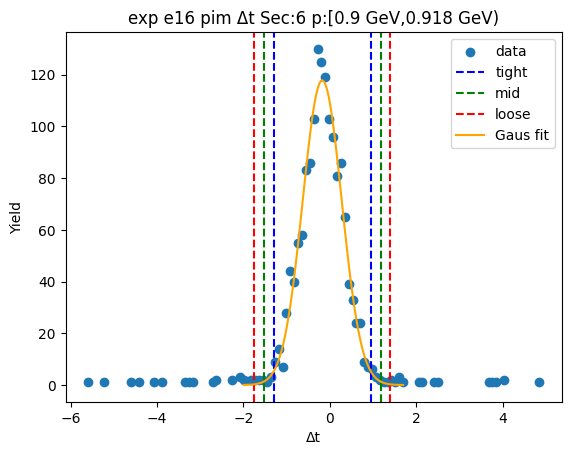

0.9053498101990798 -1.2611468681613187
1.1219994780351197 -1.4777965359973586
1.3386491458711596 -1.6944462038333985


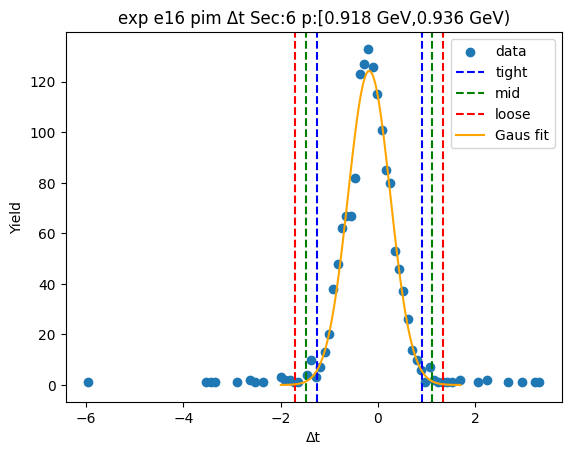

0.9733907933309806 -1.3354231878672973
1.2042721914508085 -1.5663045859871252
1.4351535895706362 -1.7971859841069528


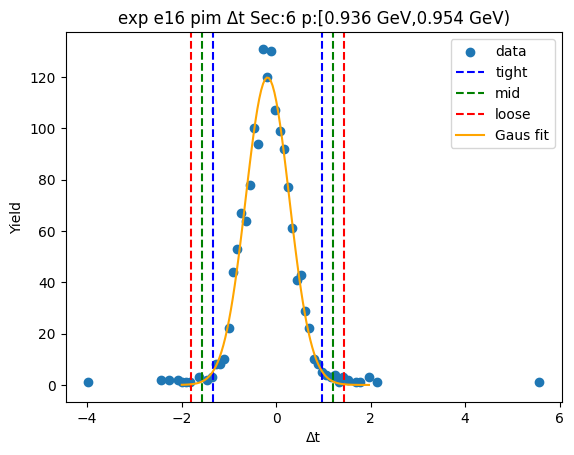

0.9487616144200779 -1.2950045694889167
1.1731382328109774 -1.5193811878798162
1.397514851201877 -1.7437578062707157


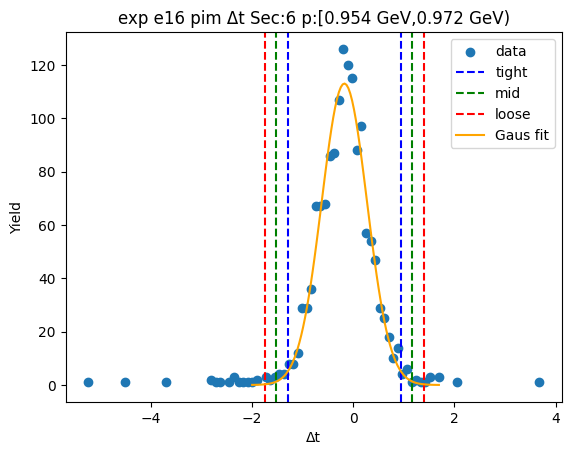

0.9356586201041912 -1.3352681654867378
1.1627512986632842 -1.5623608440458308
1.389843977222377 -1.7894535226049235


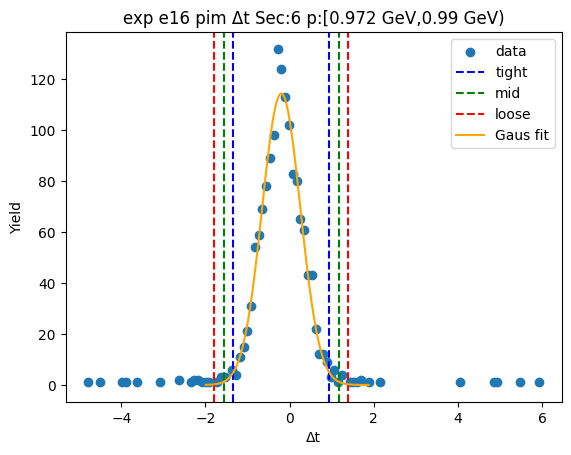

0.9546457548890812 -1.264644083156588
1.176574738693648 -1.4865730669611548
1.398503722498215 -1.7085020507657218


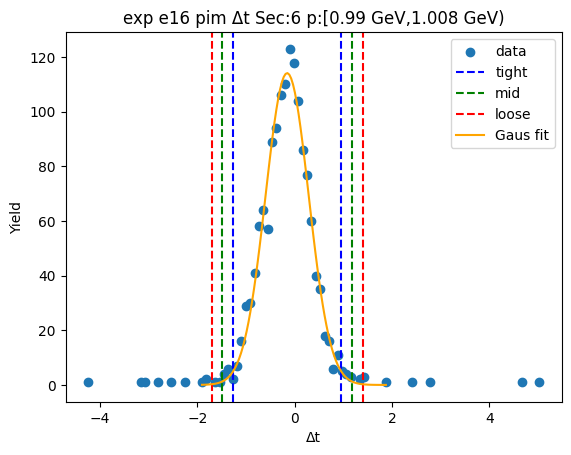

0.9369840026406014 -1.2340019275674041
1.1540825956614023 -1.4511005205882048
1.371181188682203 -1.6681991136090055


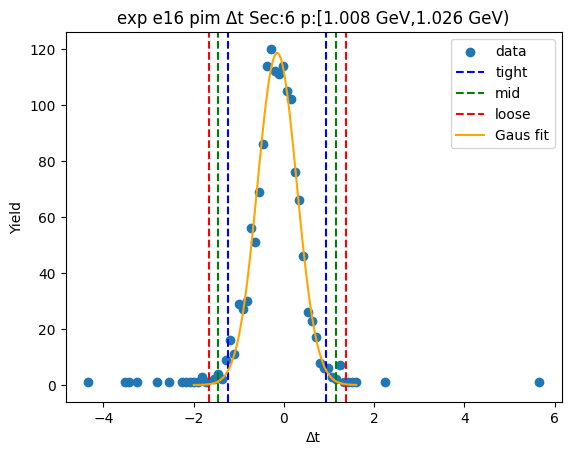

0.9330217433052828 -1.2542598638767566
1.1517499040234869 -1.4729880245949607
1.3704780647416908 -1.6917161853131646


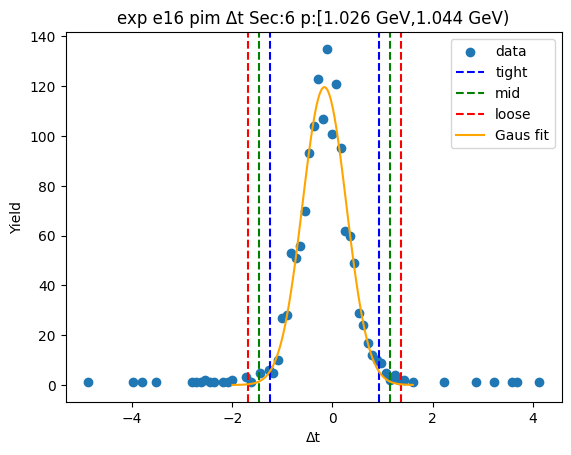

0.9209251667780018 -1.2497592222880864
1.1379936056846107 -1.4668276611946953
1.3550620445912196 -1.6838961001013042


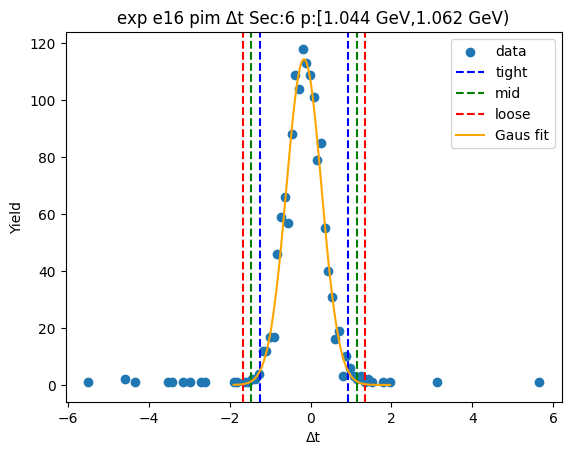

0.9777287569146165 -1.2806142427913019
1.2035630568852083 -1.5064485427618937
1.4293973568558 -1.7322828427324855


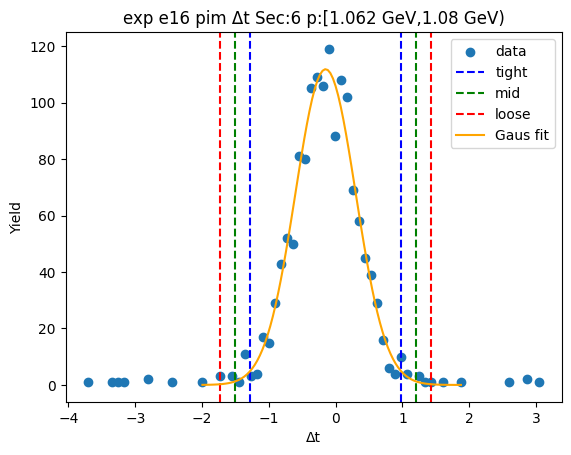

0.9259686768198012 -1.2096154470135319
1.1395270892031346 -1.4231738593968652
1.3530855015864678 -1.6367322717801984


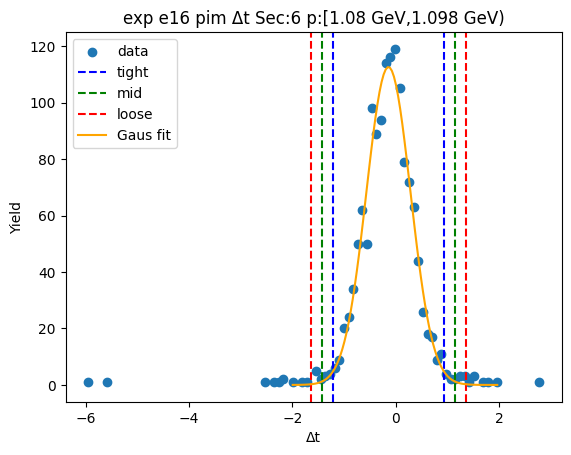

0.8996257074525559 -1.1604101921122838
1.1056292974090398 -1.3664137820687678
1.3116328873655236 -1.5724173720252517


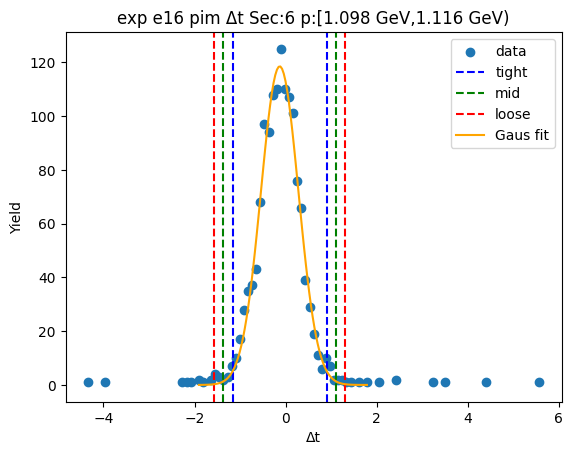

0.9160029027146741 -1.2952579590333972
1.1371289888894813 -1.5163840452082045
1.3582550750642883 -1.7375101313830115


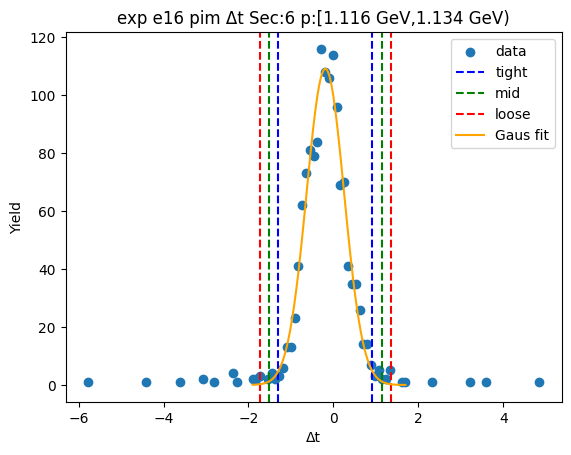

0.8880646254752569 -1.20189095268119
1.0970601832909015 -1.4108865104968347
1.3060557411065463 -1.6198820683124795


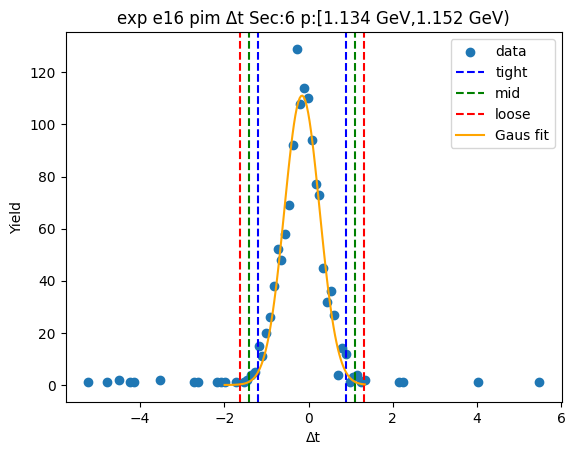

0.9063514078304463 -1.1807661906396403
1.1150631676774552 -1.3894779504866488
1.3237749275244637 -1.5981897103336573


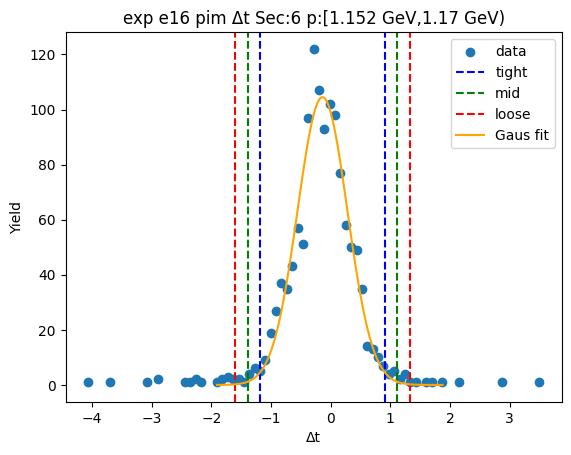

0.8788223502805789 -1.1600473043067918
1.082709315739316 -1.3639342697655286
1.2865962811980531 -1.5678212352242658


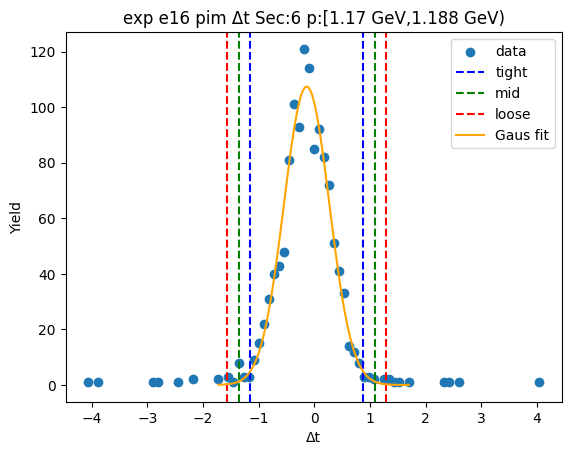

0.9045347376743386 -1.162988951568781
1.1112871065986507 -1.3697413204930928
1.3180394755229625 -1.5764936894174046


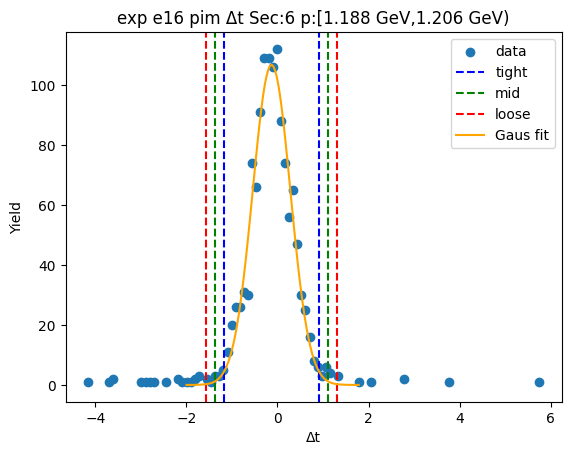

0.9429736462342883 -1.1750228471764057
1.1547732955753576 -1.3868224965174751
1.366572944916427 -1.5986221458585446


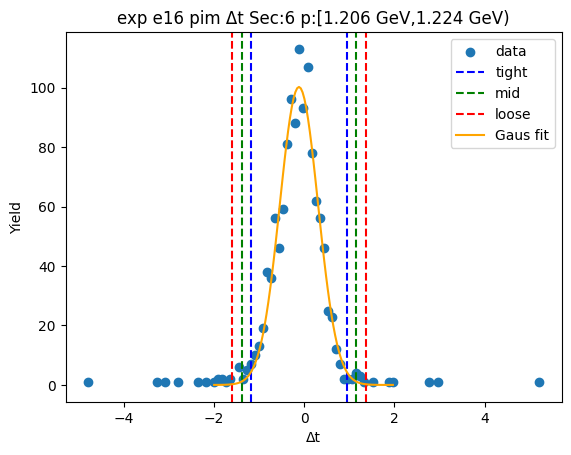

0.8990548292725627 -1.137004046382078
1.1026607168380271 -1.3406099339475424
1.3062666044034912 -1.5442158215130064


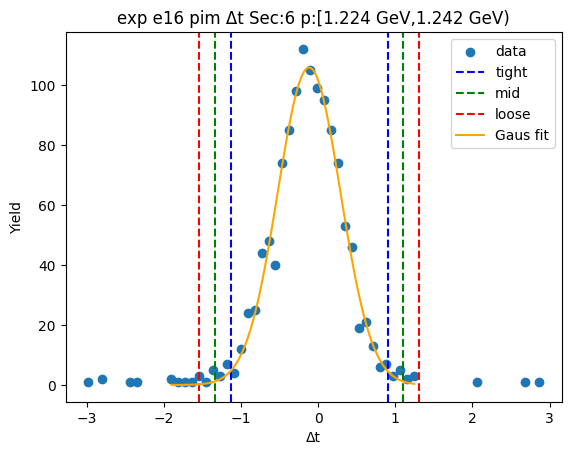

0.9151369109688448 -1.2313074527808152
1.1297813473438107 -1.4459518891557812
1.3444257837187767 -1.6605963255307472


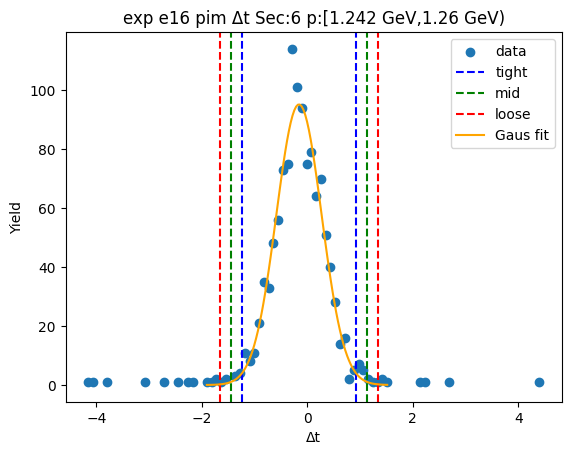

0.9304507416394715 -1.144461567316583
1.137941972535077 -1.3519527982121886
1.3454332034306824 -1.559444029107794


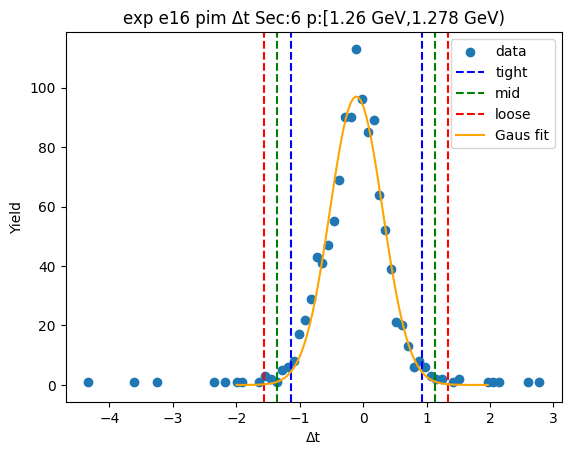

0.8852413204999147 -1.1634473952291138
1.0901101920728176 -1.3683162668020168
1.2949790636457204 -1.5731851383749196


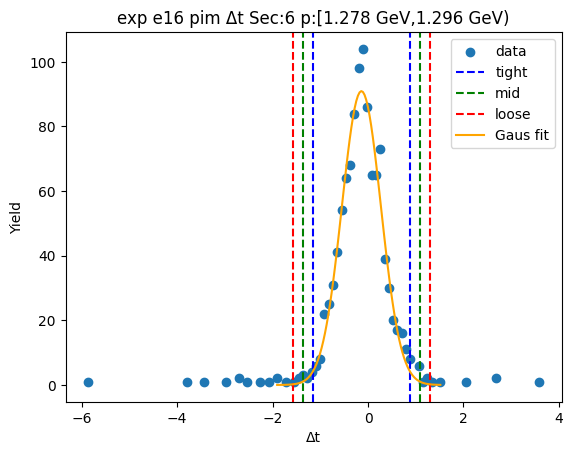

0.9369200943574099 -1.2105689969032765
1.1516690034834784 -1.425317906029345
1.366417912609547 -1.6400668151554136


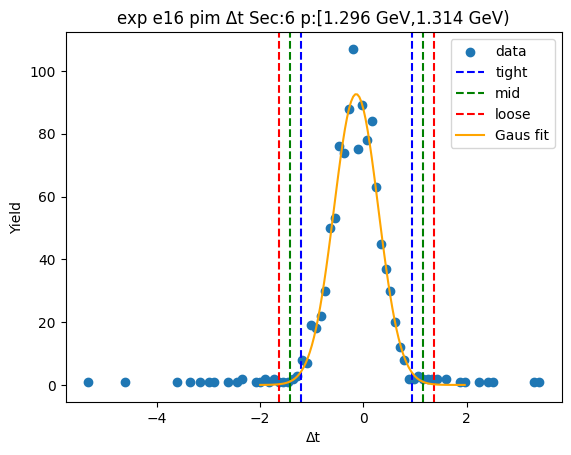

0.8906162683511977 -1.0917053697376387
1.088848432160081 -1.2899375335465222
1.2870805959689648 -1.488169697355406


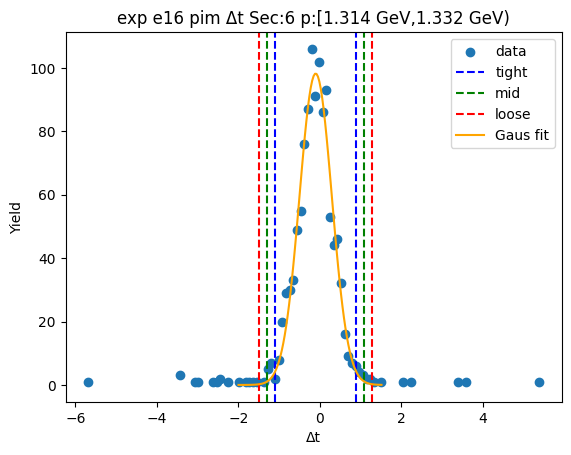

0.8467922853169092 -1.095984761038387
1.041069989952439 -1.2902624656739166
1.2353476945879687 -1.4845401703094463


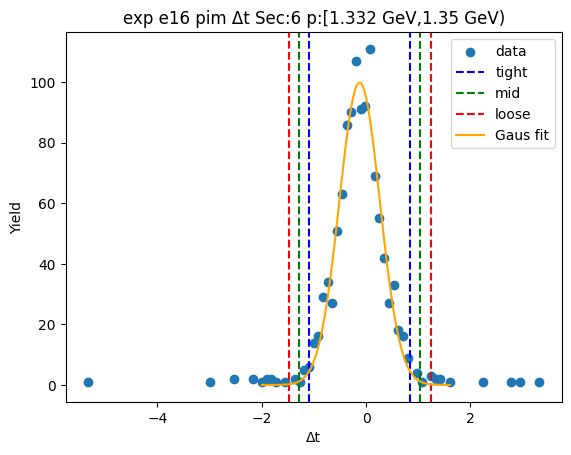

0.8881366053759155 -1.1258173037723875
1.0895319962907462 -1.327212694687218
1.2909273872055764 -1.5286080856020483


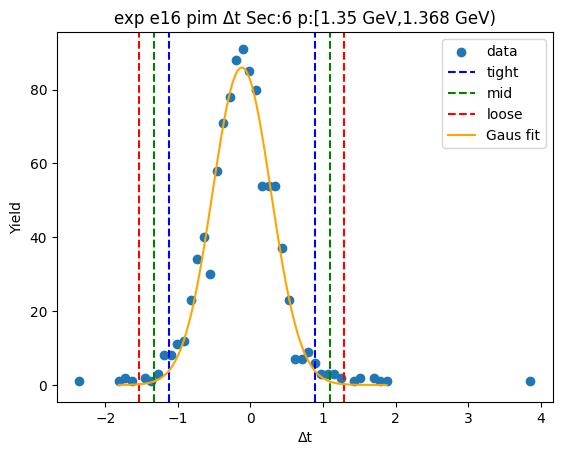

0.7843886348188653 -1.1251371853790075
0.9753412168386528 -1.3160897673987948
1.16629379885844 -1.507042349418582


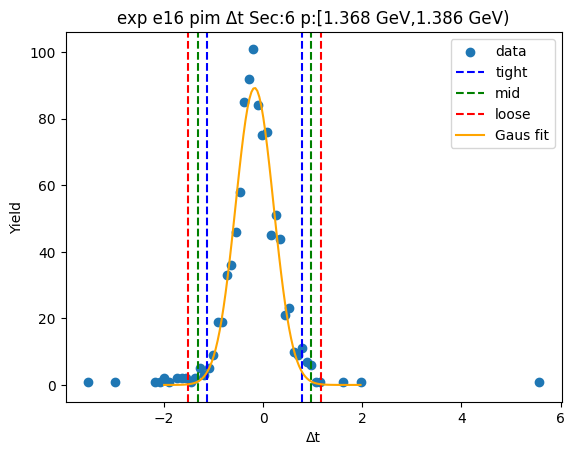

0.885821312525233 -1.1405804799310657
1.088461491770863 -1.3432206591766958
1.2911016710164929 -1.5458608384223256


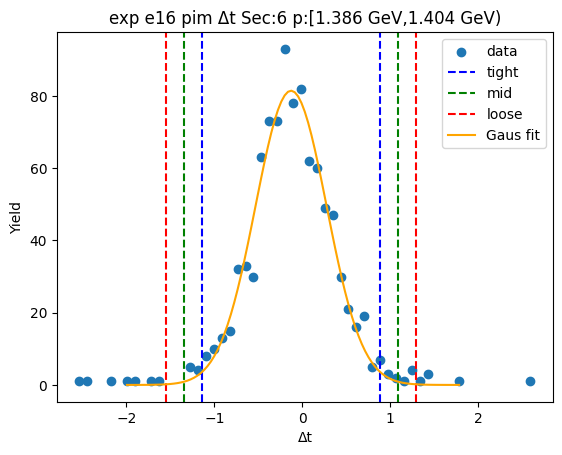

0.8939341577487028 -1.1487436815625092
1.098201941679824 -1.3530114654936305
1.3024697256109454 -1.5572792494247518


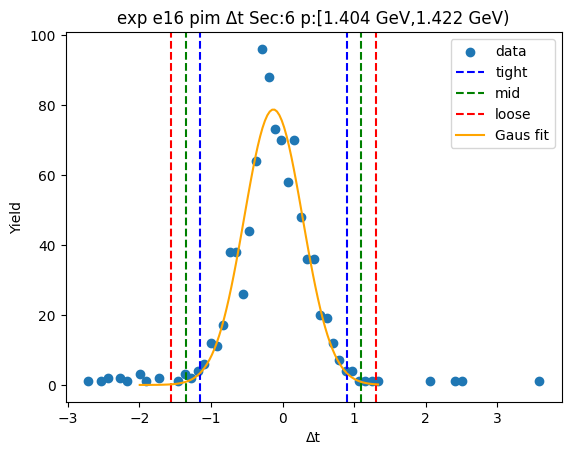

0.9078716850106563 -1.1002835816051975
1.1086872116722417 -1.3010991082667829
1.3095027383338271 -1.5019146349283683


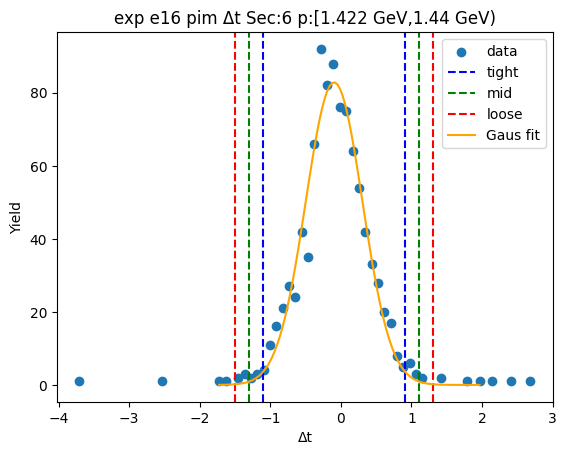

0.8674895732634892 -1.129340588382123
1.0671725894280506 -1.3290236045466841
1.2668556055926117 -1.5287066207112452


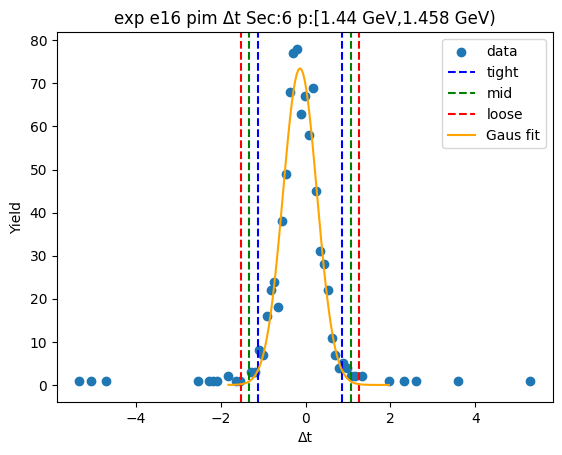

0.8048134690573173 -1.0217989696151242
0.9874747129245616 -1.2044602134823685
1.1701359567918057 -1.3871214573496127


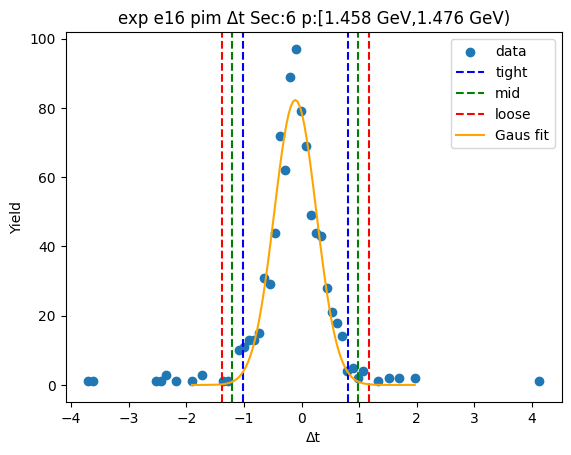

0.9202875206467473 -1.1342240276769233
1.1257386754791145 -1.3396751825092905
1.3311898303114817 -1.5451263373416577


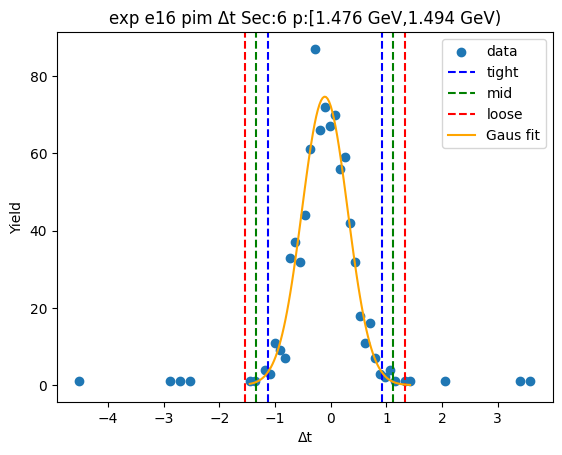

0.9456061079050356 -1.1299039372893072
1.1531571124244702 -1.3374549418087416
1.3607081169439046 -1.545005946328176


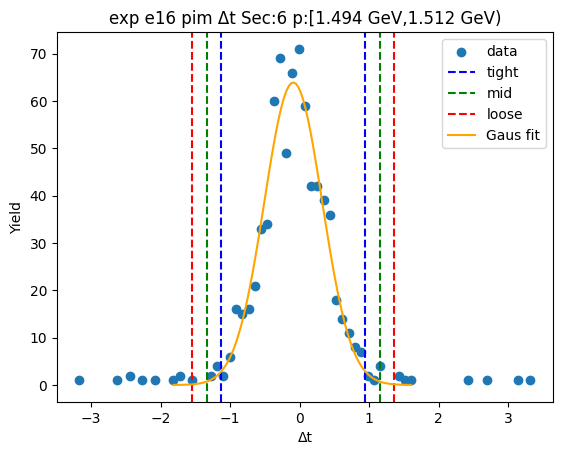

0.9134986605459545 -1.0966960317752954
1.1145181297780795 -1.2977155010074204
1.3155375990102045 -1.4987349702395454


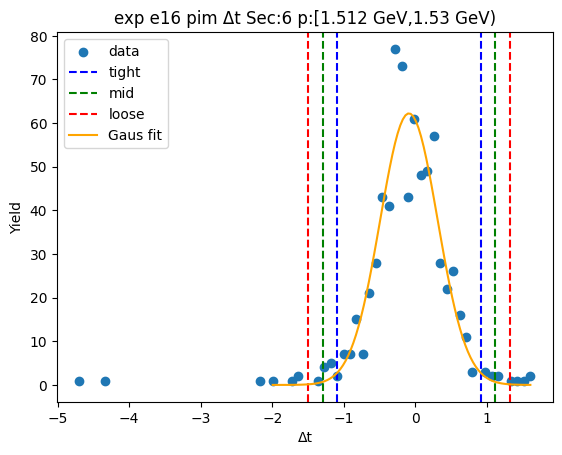

0.9034226732172026 -1.0472570922304796
1.0984906497619706 -1.2423250687752476
1.293558626306739 -1.4373930453200159


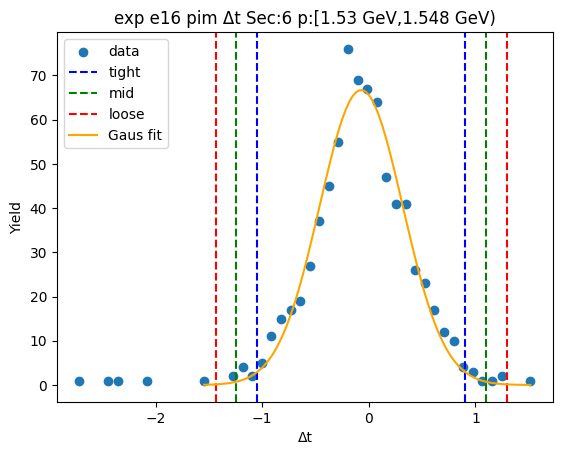

0.8713168265153619 -1.0539341002784808
1.0638419191947464 -1.2464591929578652
1.2563670118741306 -1.4389842856372494


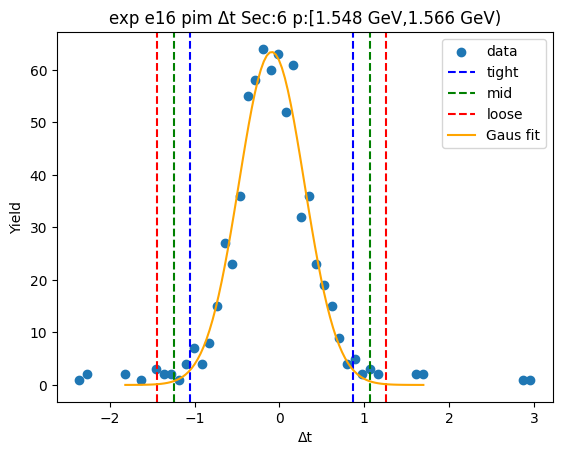

0.7747040280506693 -0.989046345468405
0.9510790654025768 -1.1654213828203126
1.127454102754484 -1.34179642017222


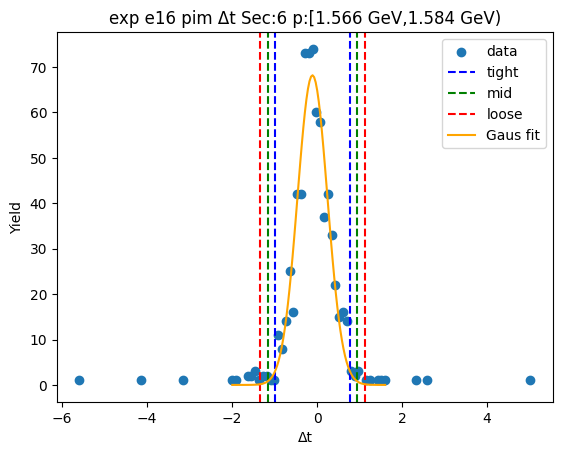

0.8794464348342744 -1.0279346129390845
1.0701845396116103 -1.2186727177164203
1.2609226443889463 -1.4094108224937563


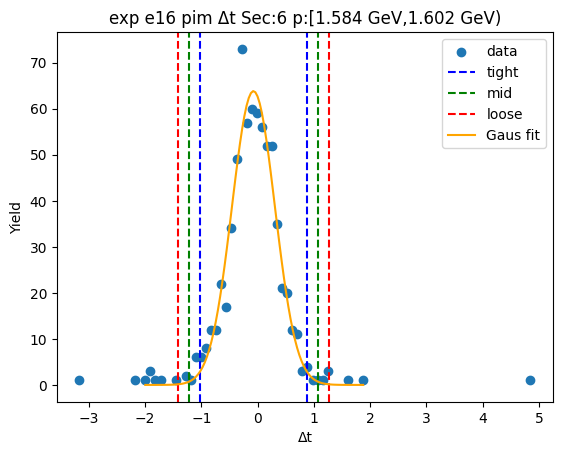

0.9042824624184732 -1.033991235169159
1.0981098321772365 -1.227818604927922
1.2919372019359998 -1.4216459746866854


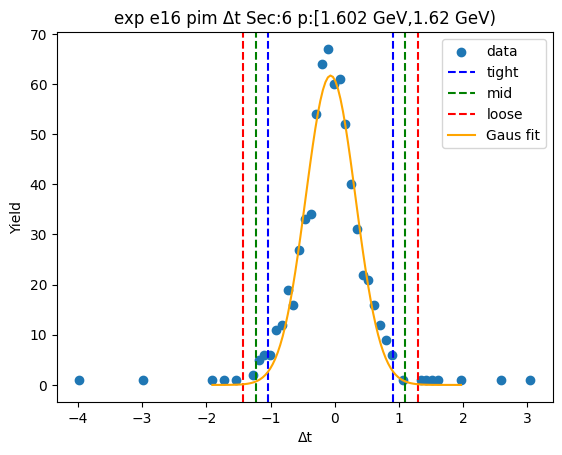

0.911494057557324 -1.0408864414703485
1.106732107460091 -1.2361244913731158
1.3019701573628584 -1.431362541275883


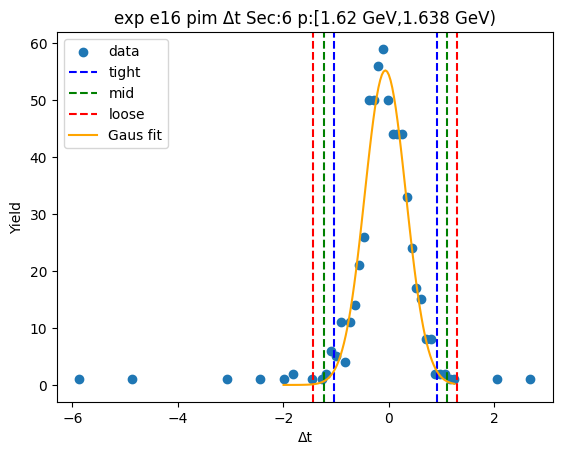

0.9332736544947433 -1.0671660150645301
1.1333176214506708 -1.2672099820204576
1.3333615884065981 -1.467253948976385


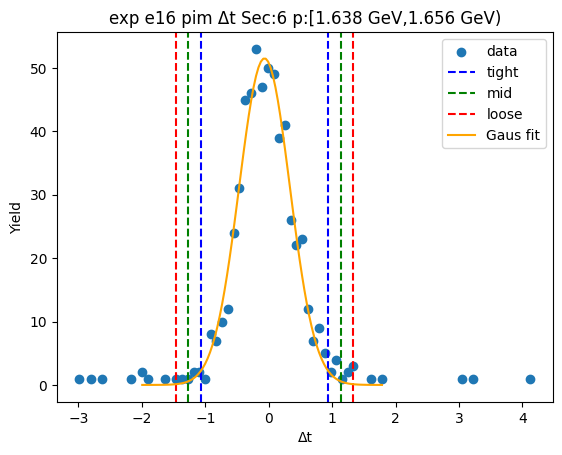

0.8784091826820888 -1.031827973157826
1.0694328982660803 -1.2228516887418175
1.2604566138500717 -1.4138754043258088


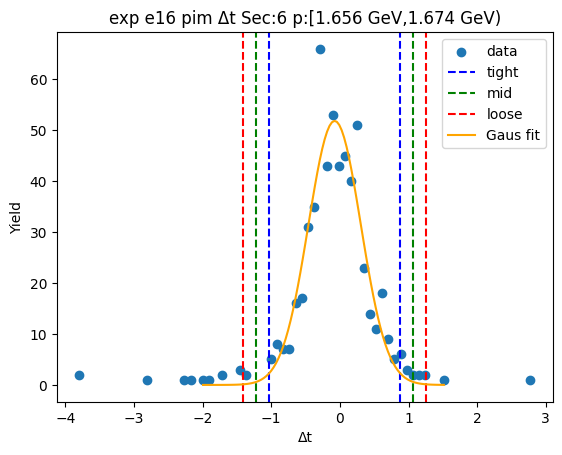

0.9342733649161977 -1.071488688163079
1.1348495702241257 -1.2720648934710068
1.335425775532053 -1.4726410987789347


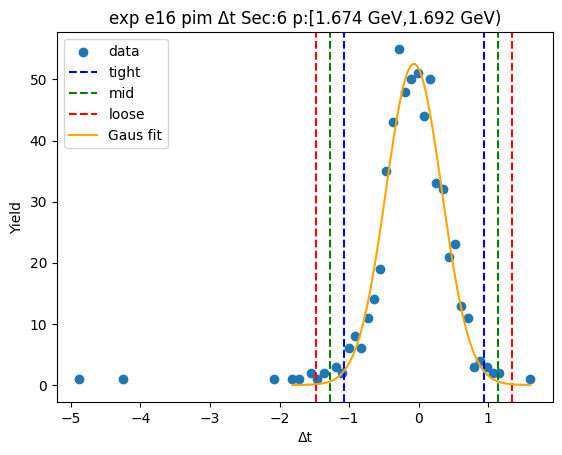

0.8825435741892429 -1.0578827834220952
1.0765862099503767 -1.2519254191832292
1.2706288457115105 -1.445968054944363


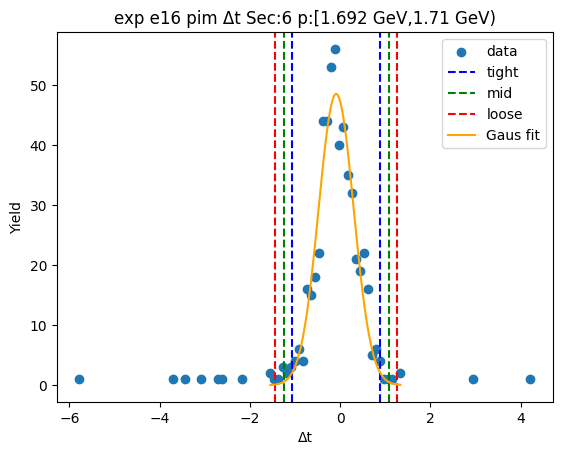

0.888362973105181 -0.9985131547842323
1.0770505858941224 -1.1872007675731737
1.2657381986830636 -1.375888380362115


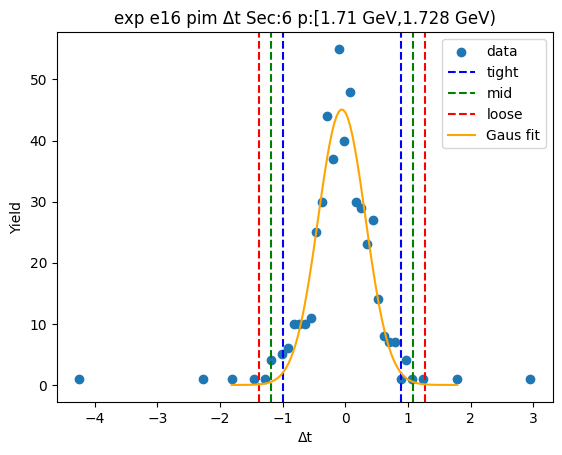

0.9983439555430772 -1.1657596348445236
1.2147543145818376 -1.3821699938832839
1.4311646736205976 -1.598580352922044


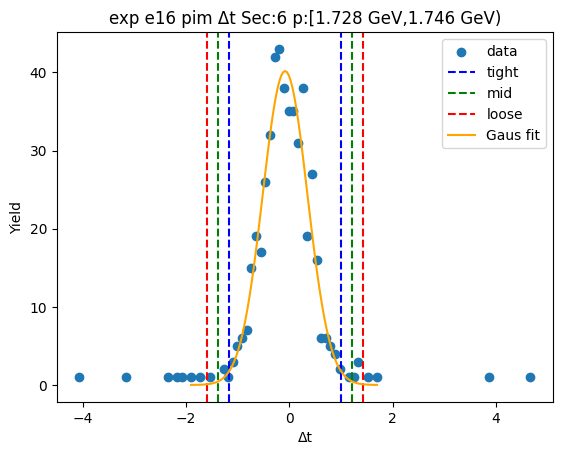

0.8934974011370815 -1.0309944911979187
1.0859465903705814 -1.2234436804314186
1.2783957796040815 -1.4158928696649187


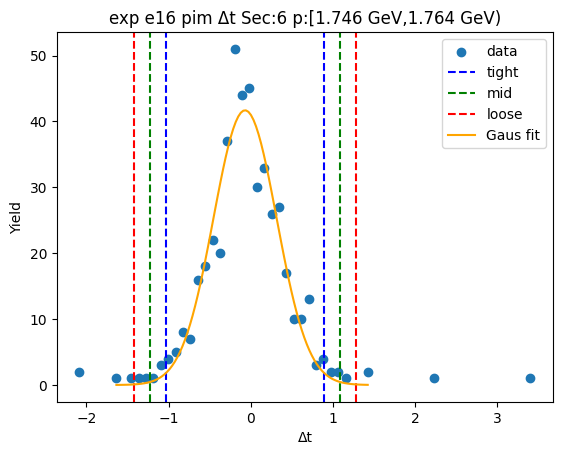

0.9165736985276448 -1.0183948901971023
1.1100705574001195 -1.2118917490695769
1.3035674162725943 -1.4053886079420517


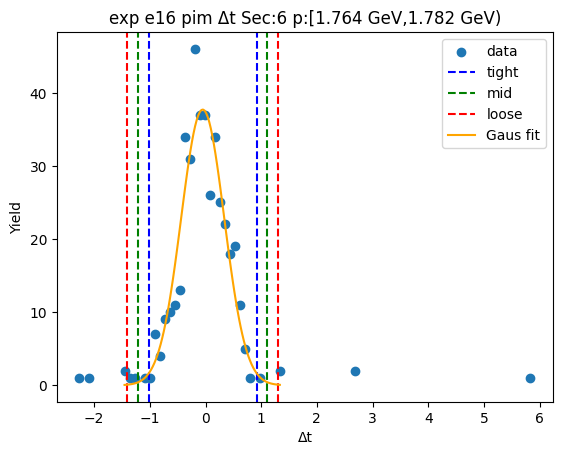

1.0354724624854654 -1.1028255087017476
1.2493022596041867 -1.3166553058204689
1.463132056722908 -1.5304851029391902


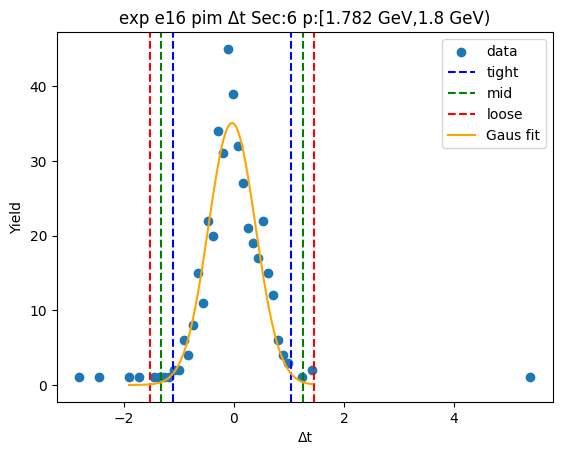

0.8605866958132211 -0.9948336703447294
1.0461287324290163 -1.1803757069605243
1.2316707690448112 -1.3659177435763192


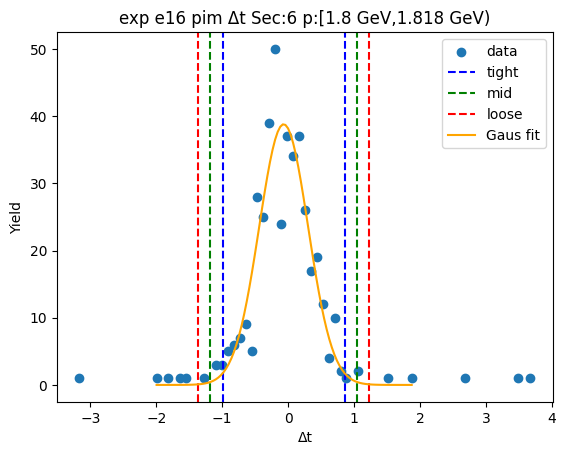

0.9204114970217795 -1.014185755474215
1.113871222271379 -1.2076454807238146
1.3073309475209782 -1.401105205973414


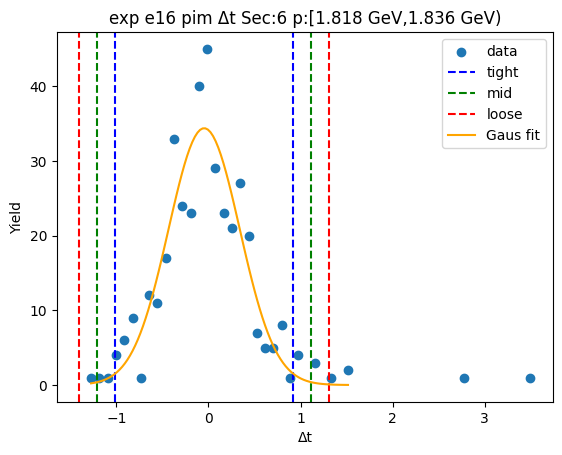

0.952481292423282 -1.051997240220382
1.1529291456876485 -1.2524450934847486
1.353376998952015 -1.4528929467491152


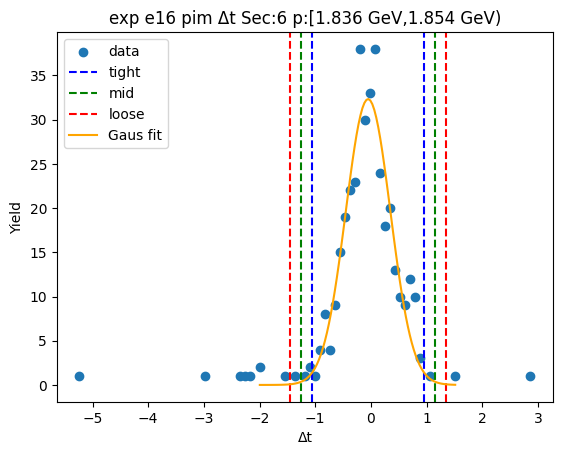

0.9158817872383848 -0.9895049851100631
1.1064204644732298 -1.180043662344908
1.2969591417080746 -1.3705823395797527


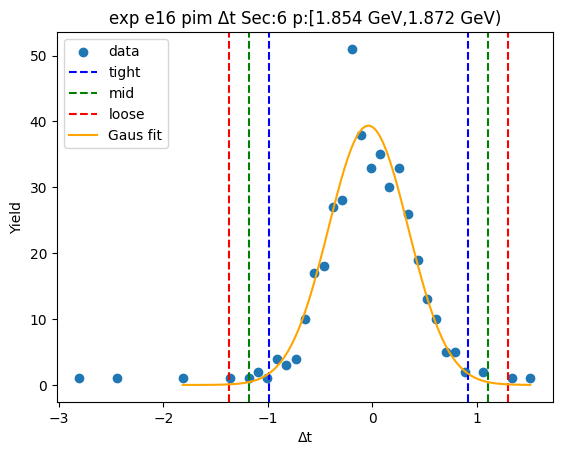

0.8650745237053841 -0.9447290509223998
1.0460548811681623 -1.1257094083851782
1.2270352386309407 -1.3066897658479566


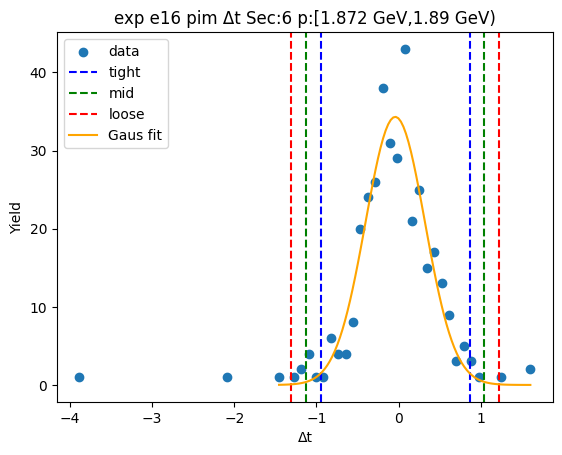

0.8824019614646397 -0.9469534916911899
1.0653375067802227 -1.1298890370067727
1.2482730520958056 -1.3128245823223557


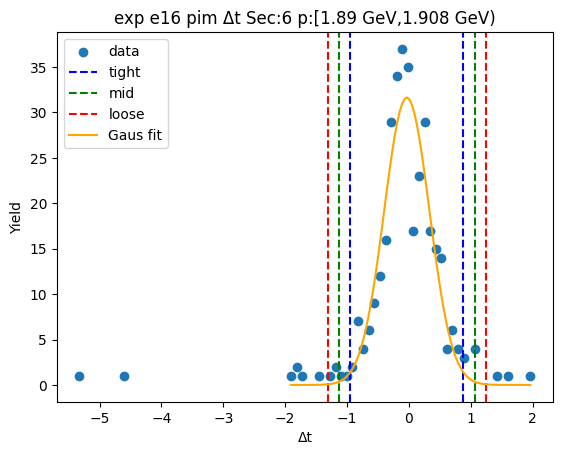

0.7905982637835921 -0.9632268005364059
0.9659807702155918 -1.1386093069684056
1.1413632766475916 -1.3139918134004054


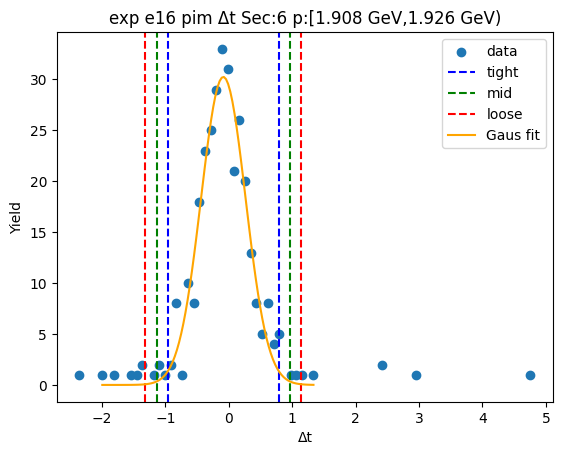

0.8498129665838695 -0.9708729039700722
1.0318815536392636 -1.1529414910254663
1.2139501406946578 -1.3350100780808605


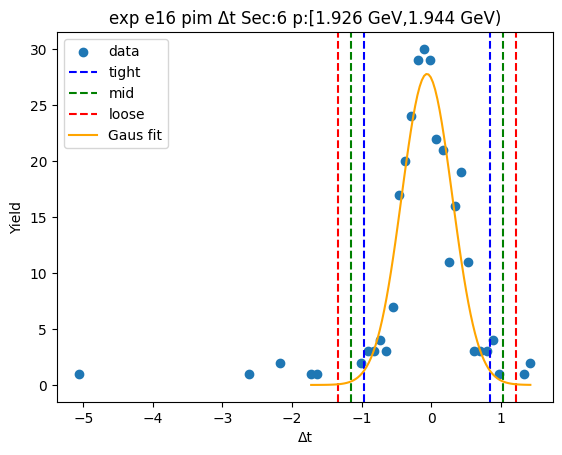

0.9800696261823814 -1.0494068269196126
1.1830172714925806 -1.2523544722298119
1.38596491680278 -1.4553021175400112


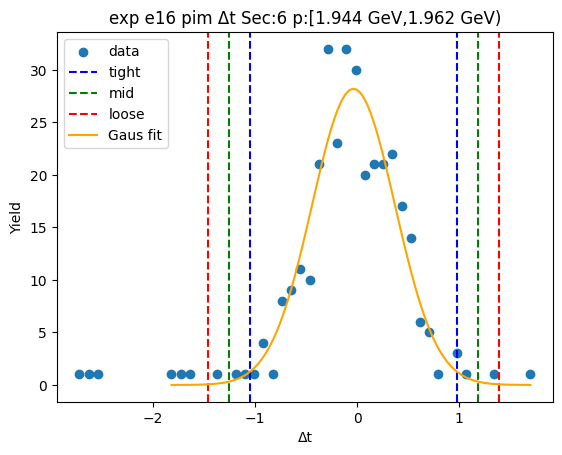

0.8207106811052141 -0.9060787936388766
0.9933896285796231 -1.0787577411132858
1.1660685760540321 -1.2514366885876949


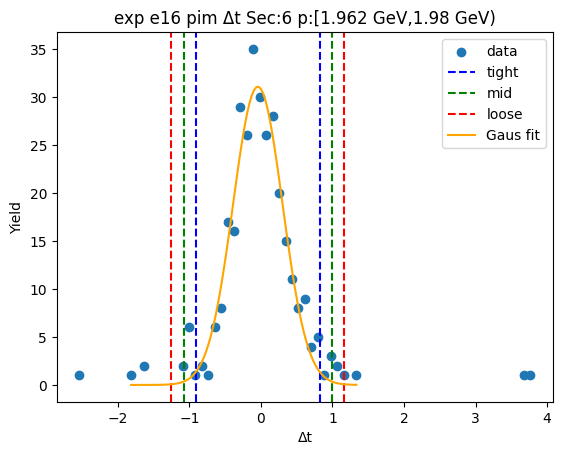

0.9642183162734228 -1.0301239594590688
1.163652543846672 -1.229558187032318
1.363086771419921 -1.428992414605567


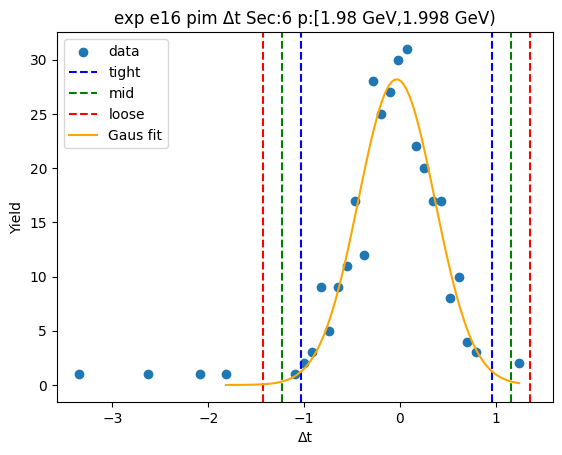

0.9120325902989617 -1.0591212044366336
1.1091479697725213 -1.2562365839101932
1.3062633492460807 -1.4533519633837526


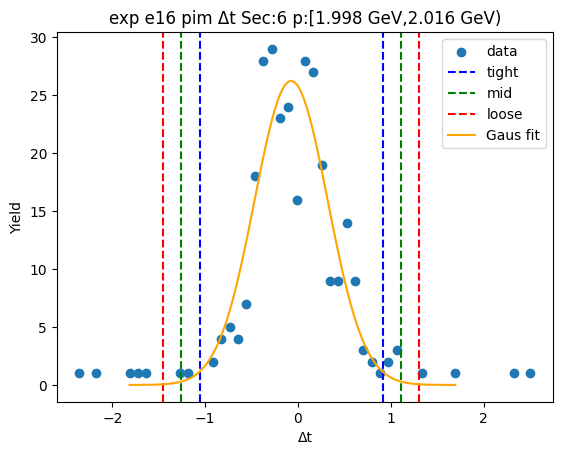

0.8494972913669582 -0.9819514657260765
1.0326421670762616 -1.1650963414353799
1.215787042785565 -1.3482412171446834


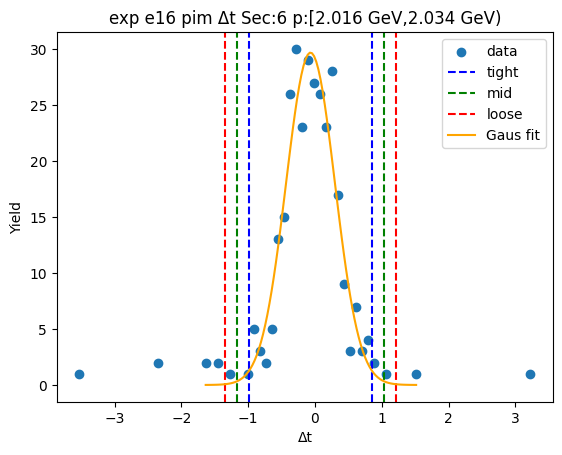

0.8850172798599386 -0.9085594450880811
1.0643749523547408 -1.087917117582883
1.2437326248495426 -1.2672747900776848


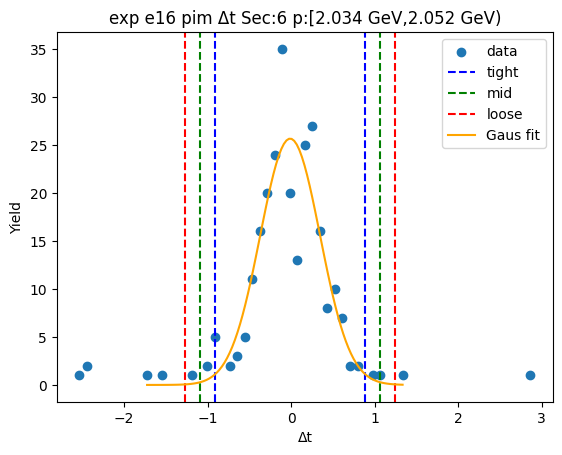

0.8619574221679801 -0.8785285664660706
1.0360060210313853 -1.0525771653294755
1.2100546198947904 -1.2266257641928806


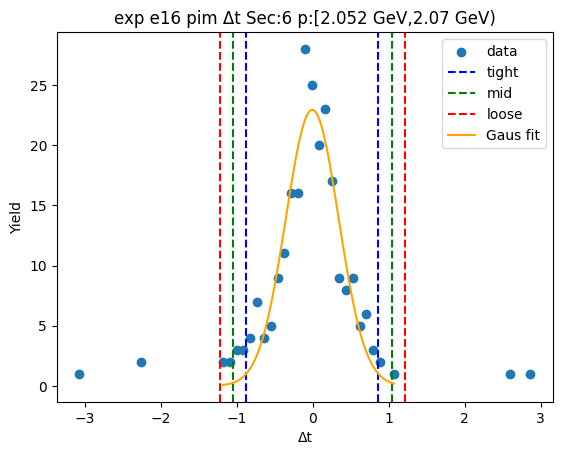

0.9182759948701937 -0.8575673718311729
1.0958603315403306 -1.0351517085013098
1.2734446682104672 -1.2127360451714464


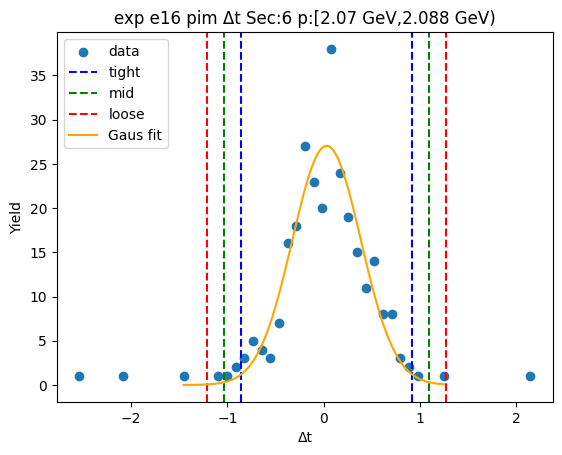

1.1591212548317764 -0.981397132114934
1.3731730935264475 -1.195448970809605
1.5872249322211185 -1.409500809504276


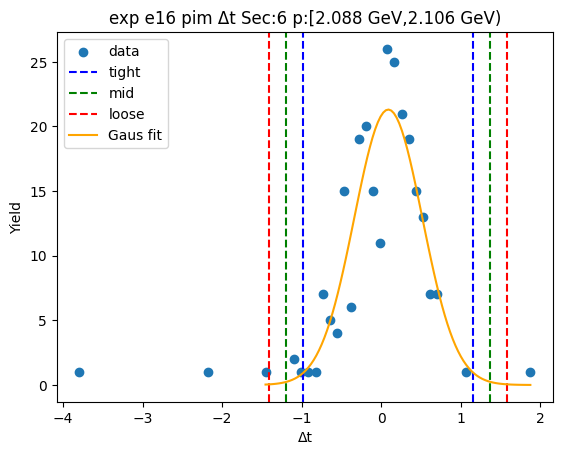

0.9478421604499058 -0.8989152926135092
1.1325179057562476 -1.0835910379198508
1.317193651062589 -1.2682667832261922


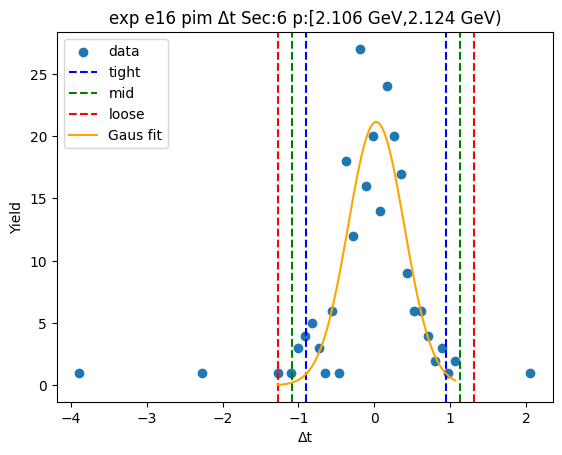

0.9404828599408261 -0.9329886588210721
1.1278300118170161 -1.120335810697262
1.315177163693206 -1.3076829625734518


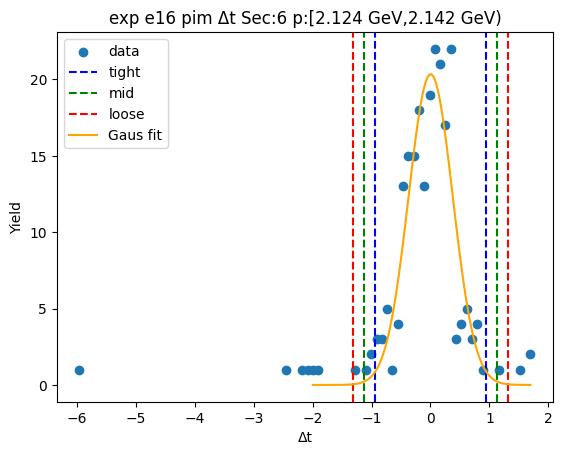

0.8397546015331567 -0.8343734642791514
1.0071674081143875 -1.0017862708603822
1.1745802146956184 -1.169199077441613


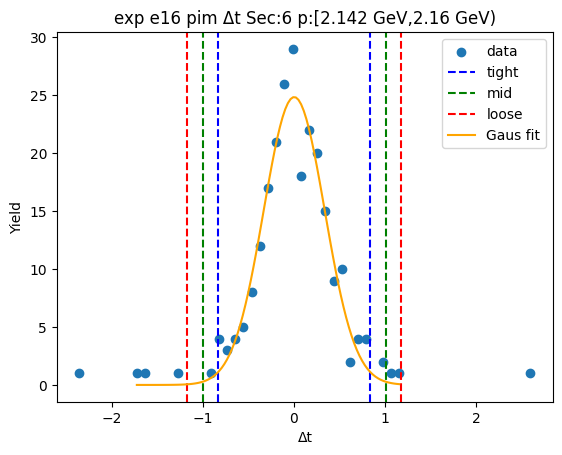

0.9711517408797197 -0.9182607653757648
1.1600929915052682 -1.1072020160013132
1.3490342421308166 -1.2961432666268615


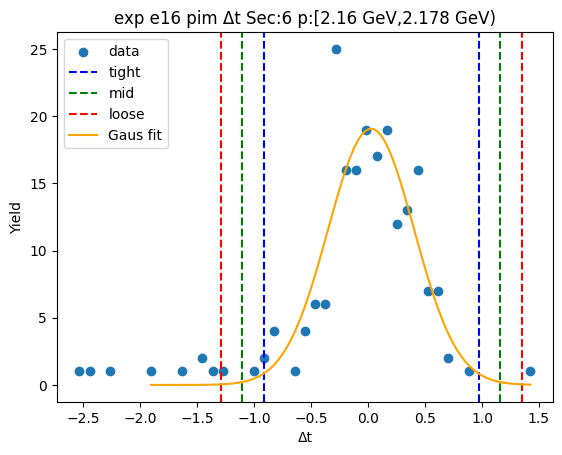

0.8735421300531838 -1.0056082658378789
1.06145716964229 -1.1935233054269851
1.2493722092313964 -1.3814383450160914


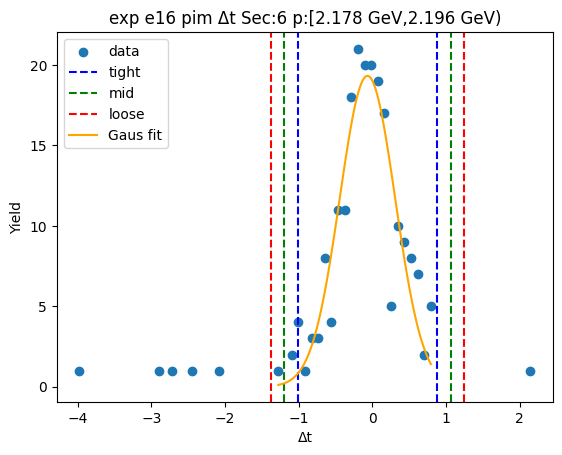

1.0439723496339472 -0.9856396454673227
1.2469335491440743 -1.1886008449774497
1.4498947486542013 -1.3915620444875767


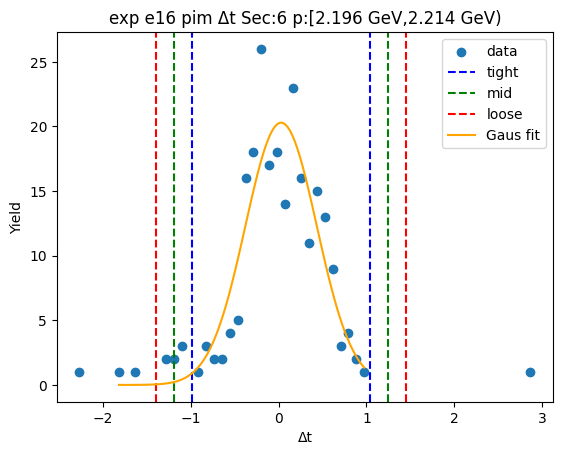

0.8479192402538596 -0.9201991164565844
1.024731075924904 -1.0970109521276286
1.2015429115959484 -1.273822787798673


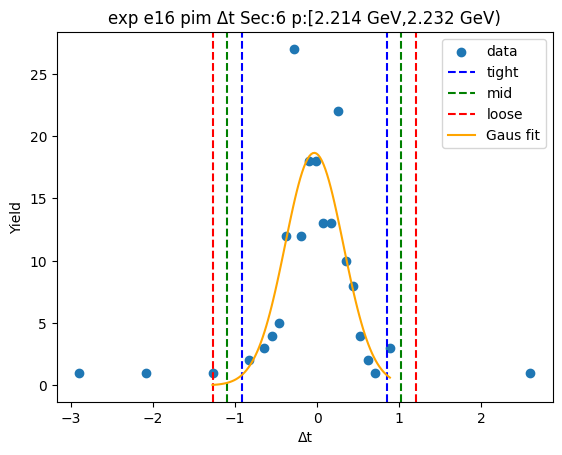

1.112958280048434 -1.104955568811721
1.3347496649344492 -1.3267469536977363
1.5565410498204646 -1.5485383385837517


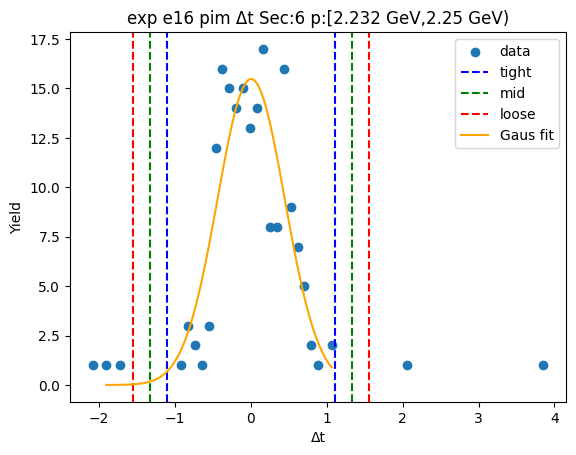

0.8047473418306615 -0.822135532645545
0.9674356292782822 -0.9848238200931656
1.130123916725903 -1.1475121075407864


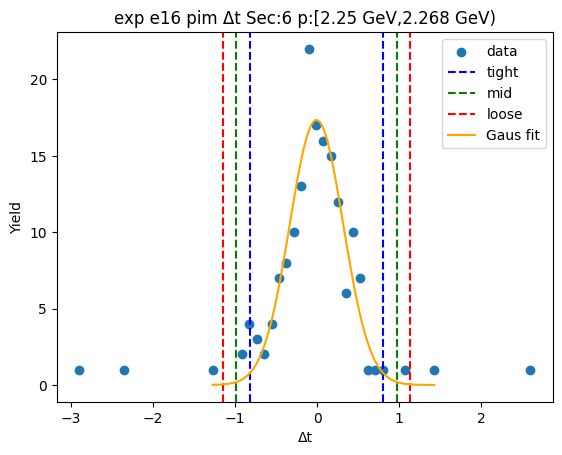

0.7818643582111164 -0.777199387377083
0.9377707327699364 -0.933105761935903
1.0936771073287566 -1.089012136494723


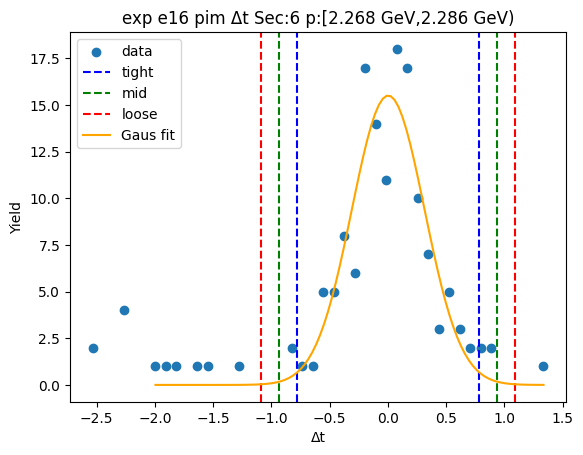

0.8579393759078789 -0.8433102489691034
1.028064338395577 -1.0134352114568017
1.1981893008832754 -1.1835601739445


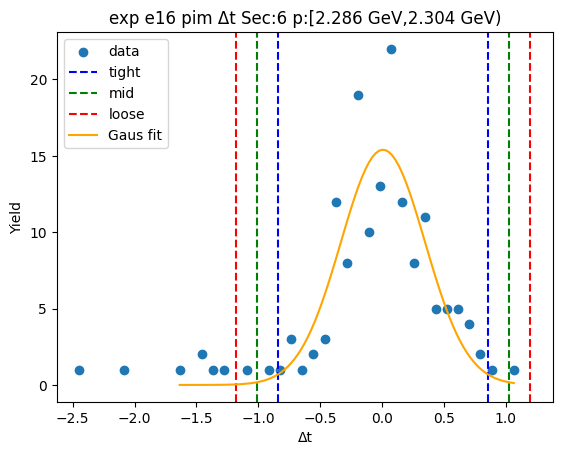

0.9728640174473844 -1.0105766810040158
1.1712080872925246 -1.208920750849156
1.3695521571376645 -1.407264820694296


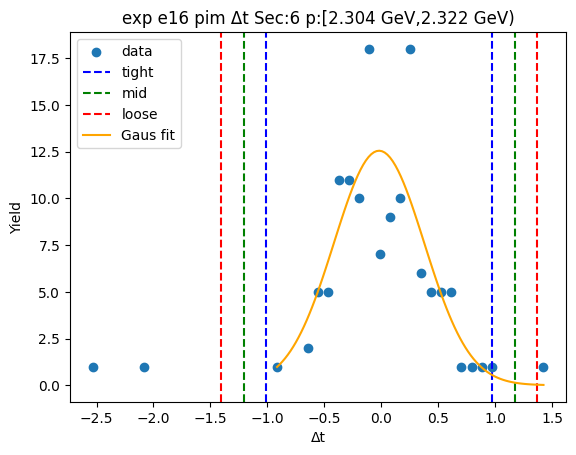

0.7030929260008537 -0.6513615898623059
0.8385383775871698 -0.7868070414486219
0.9739838291734857 -0.9222524930349378


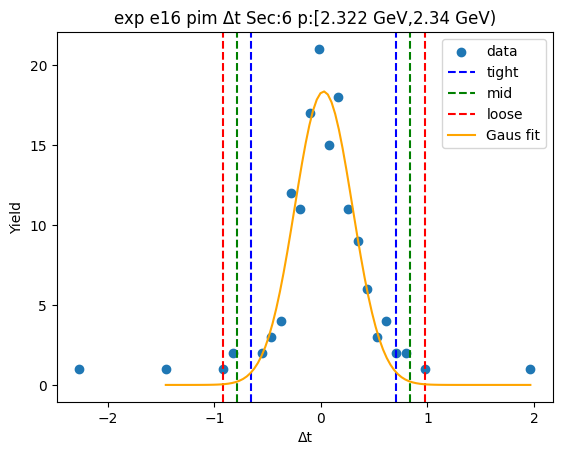

0.9127999053977968 -0.900578315256214
1.094137727463198 -1.081916137321615
1.2754755495285988 -1.2632539593870162


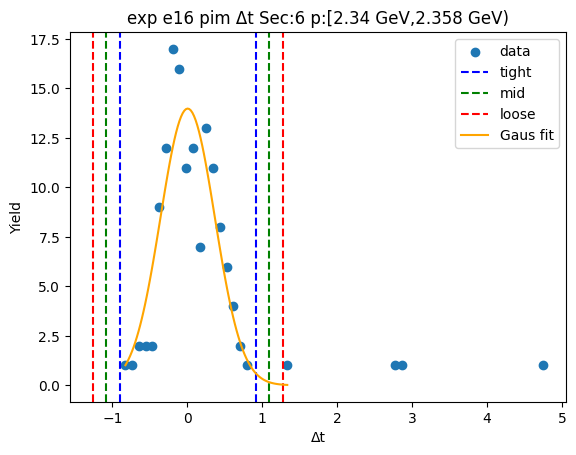

1.0257671061623976 -0.9393418333734025
1.2222780001159776 -1.1358527273269825
1.4187888940695577 -1.3323636212805625


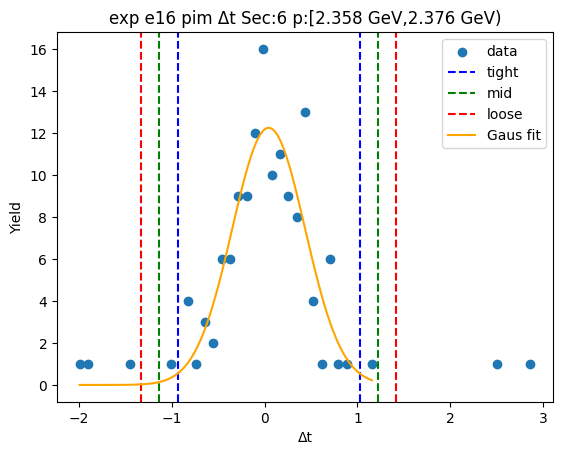

1.1832167068922814 -1.0377292272662748
1.405311300308137 -1.2598238206821304
1.6274058937239926 -1.481918414097986


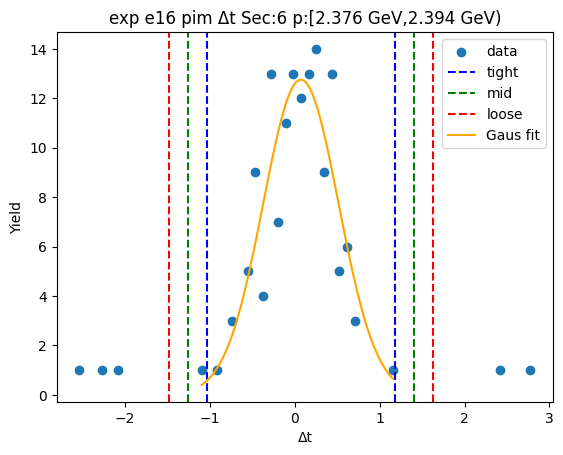

In [20]:
#Initial Guesses for Gaussian Fit
a1=30
m1=0.01
s1=1.5
initial_pars1=[27856.22, 0.01855, 0.8616]

initial_pars2 = [30000,-6.0,1.0]

inital_pars3 = []

tmp_par1 = np.zeros(3)
tmp_par2 = np.zeros(6)

#par_bound_low = [0.0,0.0,0.0]
#par_bound_top = [inf,inf,inf]

fit_pars1 = np.zeros((6,len(x),6))
err1 = np.zeros((6,len(x),3))
bound_mod=[0.6,]
low_mod = 1.2
norm_mod=1.2
min_p = [0.3,0.3,0.3,0.3,0.3,0.3]
mid_p = 4.0
p_cutoff = 2.4

num_sigma1 = [2.5,3,3.5]
bounds1 = np.zeros((6,2,3,len(x)))
sigma1= np.zeros((6,2,3,len(x)))

g1_pars = np.zeros((6,len(x),3))
g2_pars = np.zeros((6,len(x),3))

for sec in range(6):
    for i in range(3):
        tmp_par1[i] = initial_pars1[i]
        for j in range(2):
            if j ==0:
                tmp_par2[i+j*3]= initial_pars1[i]
            elif j ==1:
                tmp_par2[i+j*3]= initial_pars2[i]
    for xbin in range(len(x)):
        if fit_y[sec][xbin].sum()>15 and x[xbin]>min_p[sec] and x[xbin]<p_cutoff:
            #Set the amplitude guess to the maximum yield value
            initial_pars1[0] = np.amax(fit_y[sec][xbin])
            plt.scatter(fit_x[sec][xbin],fit_y[sec][xbin],label="data")
            #Initial Fitting
            #Set Fit Range
            if x[xbin]<mid_p:  
                #fit_x1 = Bounds_on_Y(fit_x[sec][xbin],initial_pars1[1]-norm_mod*initial_pars1[2],initial_pars1[1]+norm_mod*initial_pars1[2])
                #fit_y1 = Bounds_on_X_From_Y(fit_y[sec][xbin],fit_x[sec][xbin],initial_pars1[1]-norm_mod*initial_pars1[2],initial_pars1[1]+norm_mod*initial_pars1[2])
                fit_x1 = Bounds_on_Y(fit_x[sec][xbin],-2.0,2.0)
                fit_y1 = Bounds_on_X_From_Y(fit_y[sec][xbin],fit_x[sec][xbin],-2.0,2.0)
                cont_x1 = np.linspace(fit_x1[0],fit_x1[len(fit_x1)-1],100)
                try:
                    pars1 = op.curve_fit(Gaus,fit_x1,fit_y1,p0=tmp_par1,maxfev=5000)
                    for i in range(3):
                        fit_pars1[sec][xbin][i]=pars1[0][i]
                        tmp_par1[i]=pars1[0][i]
                        tmp_par2[i]=pars1[0][i]
                        err1[sec][xbin][i]=np.sqrt(pars1[1][i][i])
                        bounds1[sec][0][i][xbin] = pars1[0][1] - num_sigma1[i]*pars1[0][2]
                        bounds1[sec][1][i][xbin] = pars1[0][1] + num_sigma1[i]*pars1[0][2]
                        sigma1[sec][0][i][xbin] = pars1[1][1][1] - num_sigma1[i]*pars1[1][2][2]
                        sigma1[sec][1][i][xbin] = pars1[1][1][1] + num_sigma1[i]*pars1[1][2][2]
                        plt.axvline(x=bounds1[sec][0][i][xbin],label=cut_name[i],color=cut_cols[i],linestyle='dashed')
                        plt.axvline(x=bounds1[sec][1][i][xbin],color=cut_cols[i],linestyle='dashed')
                        print(bounds1[sec][0][i][xbin],bounds1[sec][1][i][xbin])
                    plt.plot(cont_x1,Gaus(cont_x1,*pars1[0]),color='orange',label='Gaus fit')
                except RuntimeError:
                    print("Runtime Error")
                except ValueError:
                    print("Value Error")
            else:
                #fit_x1 = Bounds_on_Y(fit_x[sec][xbin],initial_pars1[1]-low_mod*initial_pars1[2],initial_pars1[1]+norm_mod*initial_pars1[2])
                #fit_y1 = Bounds_on_X_From_Y(fit_y[sec][xbin],fit_x[sec][xbin],initial_pars1[1]-low_mod*initial_pars1[2],initial_pars1[1]+norm_mod*initial_pars1[2])
                fit_x2 = Bounds_on_Y(fit_x[sec][xbin],-6.0,2.0)
                fit_y2 = Bounds_on_X_From_Y(fit_y[sec][xbin],fit_x2[sec][xbin],-6.0,2.0)
                cont_x2 = np.linspace(fit_x2[0],fit_x2[len(fit_x2)-1],100)
                plt.plot(cont_x2,Gaus2(cont_x2,*tmp_par2),color='r',label='Inital 2Gaus fit')
                try:
                    pars2 = op.curve_fit(Gaus2,fit_x2,fit_y2,p0=tmp_par2,maxfev=5000)
                    for i in range(3):
                        fit_pars1[sec][xbin][i]=pars2[0][i]
                        g1_pars[sec][xbin][i] = pars2[0][i]
                        g2_pars[sec][xbin][i] = pars2[0][i+3]
                        err1[sec][xbin][i]=np.sqrt(pars2[1][i][i])
                        bounds1[sec][0][i][xbin] = pars2[0][1] - num_sigma1[i]*pars2[0][2]
                        bounds1[sec][1][i][xbin] = pars2[0][1] + num_sigma1[i]*pars2[0][2]
                        sigma1[sec][0][i][xbin] = pars2[1][1][1] - num_sigma1[i]*pars2[1][2][2]
                        sigma1[sec][1][i][xbin] = pars2[1][1][1] + num_sigma1[i]*pars2[1][2][2]
                        plt.axvline(x=bounds1[sec][0][i][xbin],label=cut_name[i],color=cut_cols[i],linestyle='dashed')
                        plt.axvline(x=bounds1[sec][1][i][xbin],color=cut_cols[i],linestyle='dashed')
                        print(bounds1[sec][0][i][xbin],bounds1[sec][1][i][xbin])
                        for j in range(2):
                            tmp_par2[i+j*3]= pars2[0][i+j*3]
                    plt.plot(cont_x2,Gaus2(cont_x2,*pars2[0]),color='orange',label='2Gaus fit')
                    plt.plot(cont_x2,Gaus(cont_x2,*g1_pars[0][xbin]),color='c',label='Proton fit')
                    plt.plot(cont_x2,Gaus(cont_x2,*g2_pars[0][xbin]),color='m',label='\u03C0+ fit')
                except RuntimeError:
                    print("Runtime Error")
                except ValueError:
                    print("Value Error")
            
            
            #if np.sqrt(pars1[1][1][1])/pars1[0][1] < 0.1:
            
            
           
            plot_title="{} {} {} \u0394t Sec:{} p:[{} GeV,{} GeV)".format(sim,run,species,sec+1,Pbin_low(xbin),Pbin_top(xbin))
            plt.title(plot_title)
            plt.xlabel(yname)
            plt.ylabel("Yield")
            plt.legend()
            plt.show()

In [21]:

for sec in range(6):
    for cut in range(3):
        for xbin in range(len(x)):
            bounds1[sec][0][cut][xbin] = fit_pars1[sec][xbin][1]-num_sigma1[cut]*fit_pars1[sec][xbin][2]
            sigma1[sec][0][cut][xbin] = err1[sec][xbin][1]+num_sigma1[cut]*err1[sec][xbin][2]
            bounds1[sec][1][cut][xbin] = fit_pars1[sec][xbin][1]+num_sigma1[cut]*fit_pars1[sec][xbin][2]
            sigma1[sec][1][cut][xbin] = err1[sec][xbin][1]+num_sigma1[cut]*err1[sec][xbin][2]

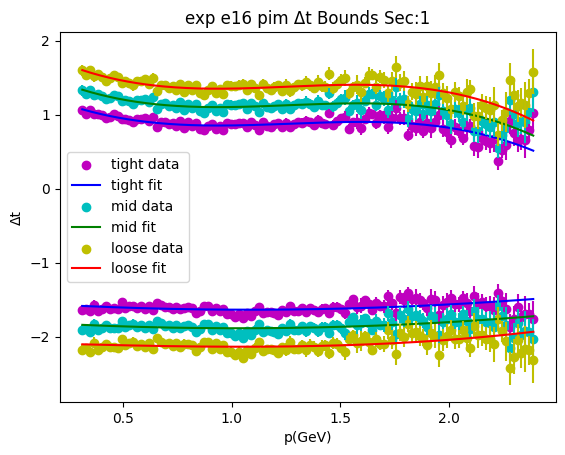

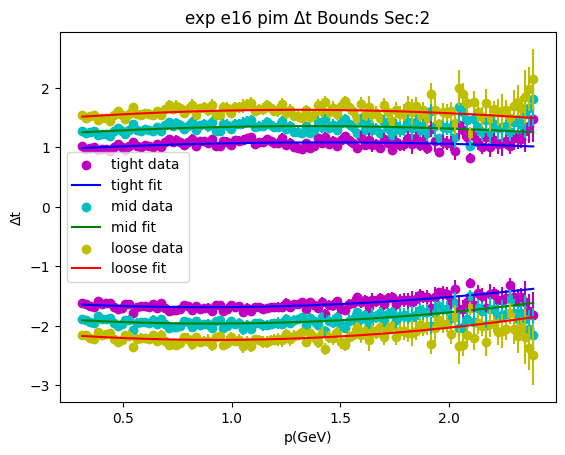

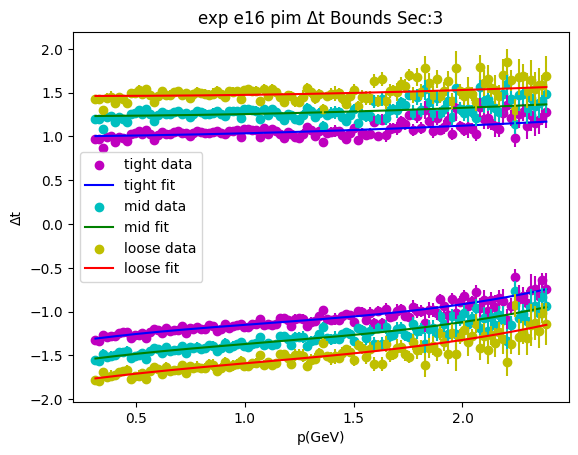

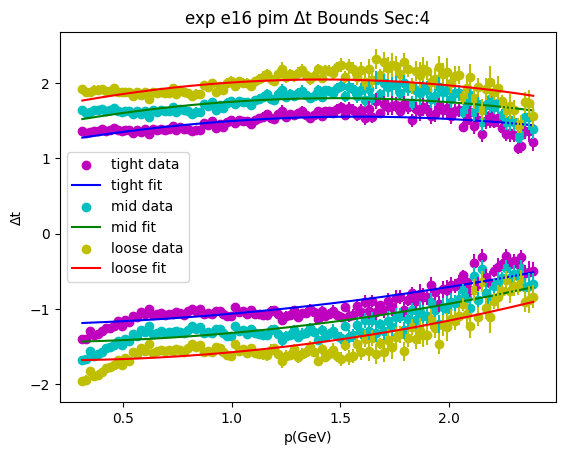

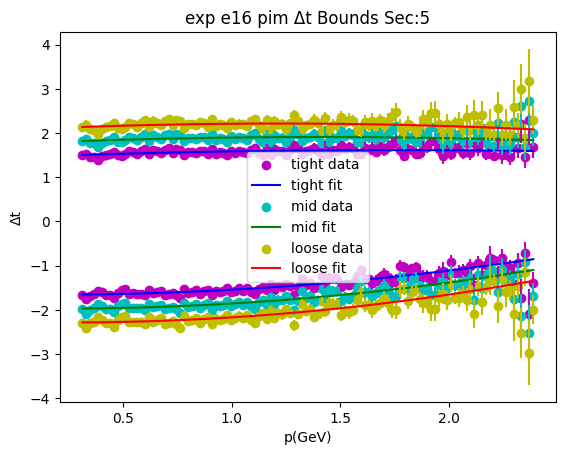

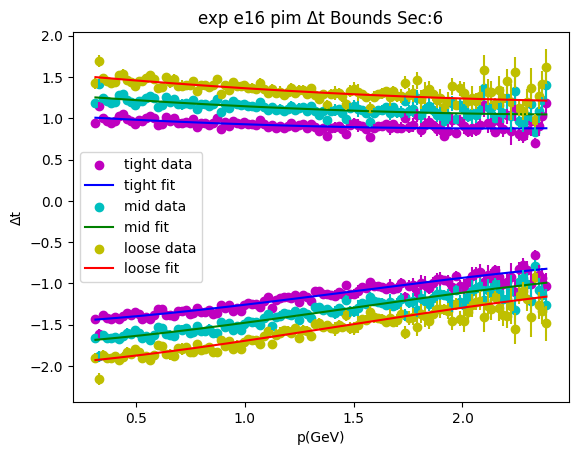

In [22]:
l0=0.0
l1=0.5
l2=-0.2
l3=0.2
initial_low_par2=[l0,l1,l2,l3]
t0=0.0
t1=0.5
t2=-0.2
t3=-0.2
initial_top_par2=[t0,t1,t2,t3]

low_par_fit= np.zeros((6,3,4))
top_par_fit = np.zeros((6,3,4))

cut_cols = ['b','g','r']
cut_name= ["tight","mid","loose"]
data_cols = ['m',"c",'y']

par_bou = [[[-np.inf,-np.inf,-np.inf,0.0],[np.inf,np.inf,np.inf,np.inf]],
           [[-np.inf,-np.inf,-np.inf,-np.inf],[np.inf,np.inf,np.inf,0.0]]]

for sec in range(6):
    for cut in range(3):
        plt.scatter(Remove_Zeros_X(x,bounds1[sec][0][cut]),Remove_Zeros(bounds1[sec][0][cut]),label="{} data".format(cut_name[cut]),color=data_cols[cut])
        plt.scatter(Remove_Zeros_X(x,bounds1[sec][1][cut]),Remove_Zeros(bounds1[sec][1][cut]),color=data_cols[cut])
        plt.errorbar(Remove_Zeros_X(x,bounds1[sec][0][cut]),Remove_Zeros(bounds1[sec][0][cut]),yerr=Remove_Zeros_X(sigma1[sec][0][cut],bounds1[sec][0][cut]),fmt='',linestyle='',color=data_cols[cut])
        plt.errorbar(Remove_Zeros_X(x,bounds1[sec][1][cut]),Remove_Zeros(bounds1[sec][1][cut]),yerr=Remove_Zeros_X(sigma1[sec][1][cut],bounds1[sec][1][cut]),fmt='',linestyle='',color=data_cols[cut])
        #Fit with 3rd order Polynomial 
        par_low1=op.curve_fit(Poly3,Remove_Zeros_X(x,bounds1[sec][0][cut]),Remove_Zeros(bounds1[sec][0][cut]),p0=initial_low_par2,sigma=Remove_Zeros_X(sigma1[sec][0][cut],bounds1[sec][0][cut]),bounds=par_bou[0],maxfev=5000)
        par_top1=op.curve_fit(Poly3,Remove_Zeros_X(x,bounds1[sec][1][cut]),Remove_Zeros(bounds1[sec][1][cut]),p0=initial_top_par2,sigma=Remove_Zeros_X(sigma1[sec][1][cut],bounds1[sec][1][cut]),bounds=par_bou[1],maxfev=5000)
        for i in range(4):
            low_par_fit[sec][cut][i] = par_low1[0][i]
            top_par_fit[sec][cut][i] = par_top1[0][i]
        cont_x_low = np.linspace(Remove_Zeros_X(x,bounds1[sec][0][cut])[0],Remove_Zeros_X(x,bounds1[sec][0][cut])[len(Remove_Zeros_X(x,bounds1[sec][0][cut]))-1],200)
        cont_x_top = np.linspace(Remove_Zeros_X(x,bounds1[sec][1][cut])[0],Remove_Zeros_X(x,bounds1[sec][1][cut])[len(Remove_Zeros_X(x,bounds1[sec][1][cut]))-1],200)
        plt.plot(cont_x_low,Poly3(cont_x_low,*low_par_fit[sec][cut]),color=cut_cols[cut],label="{} fit".format(cut_name[cut]))
        plt.plot(cont_x_top,Poly3(cont_x_top,*top_par_fit[sec][cut]),color=cut_cols[cut])
    plot_title="{} {} {} \u0394t Bounds Sec:{}".format(sim,run,species,sec+1)
    plt.title(plot_title)
    plt.xlabel(xname)
    plt.ylabel(yname)
    plt.legend()
    plt.show()

In [23]:
#Stuff to make it so I can plot a 2d Histogram with data in the format I have
#Would be a lot easier if I had uproot 4 working 
dumb_x= np.zeros((6,len(xbins)*len(ybins)))
dumb_y= np.zeros((6,len(xbins)*len(ybins)))
dense2 = np.zeros((6,len(xbins)*len(ybins)))
for sec in range(6):
    for i in range(len(xbins)):
        for j in range(len(ybins)):
            dumb_x[sec][i+j*len(xbins)]+=xbins[i]
            dumb_y[sec][i+j*len(xbins)]+=ybins[j]
            dense2[sec][i+j*len(xbins)]+=zvals_xy[sec][i][j]

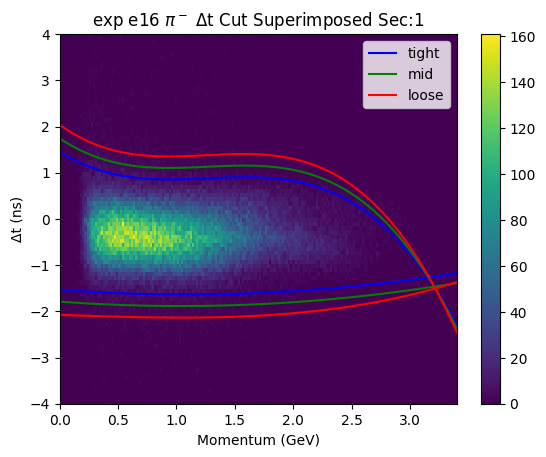

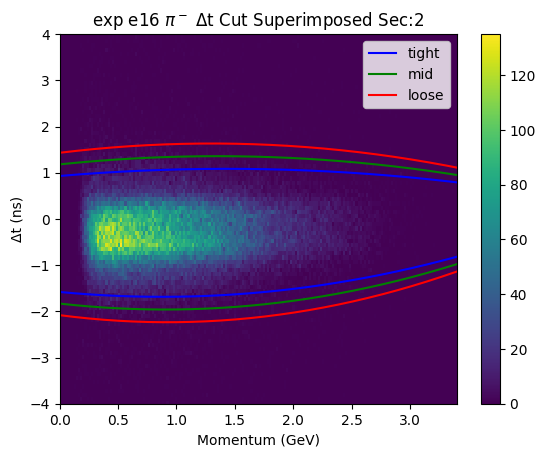

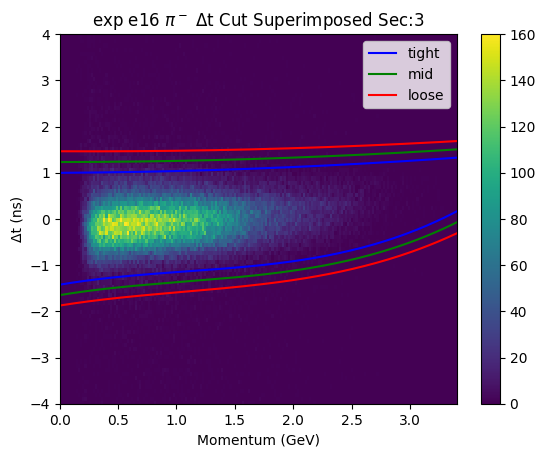

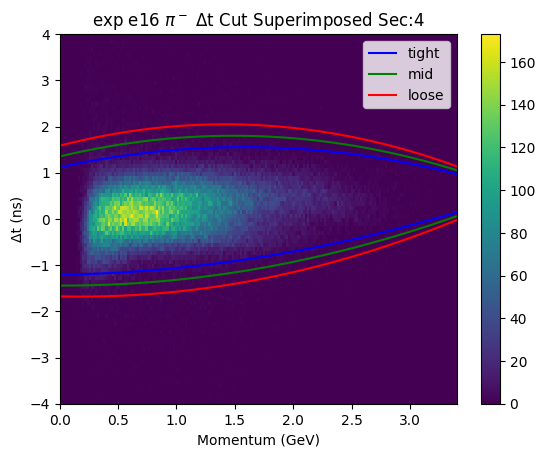

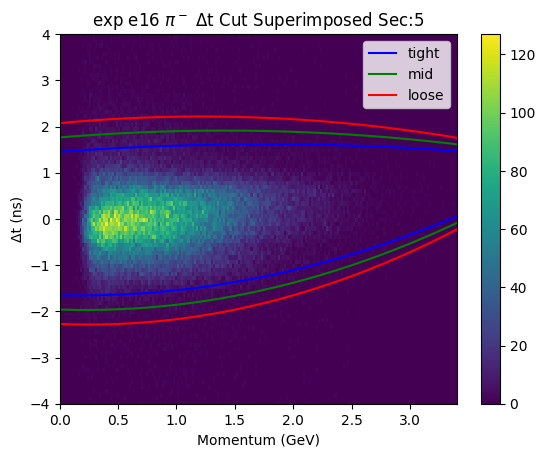

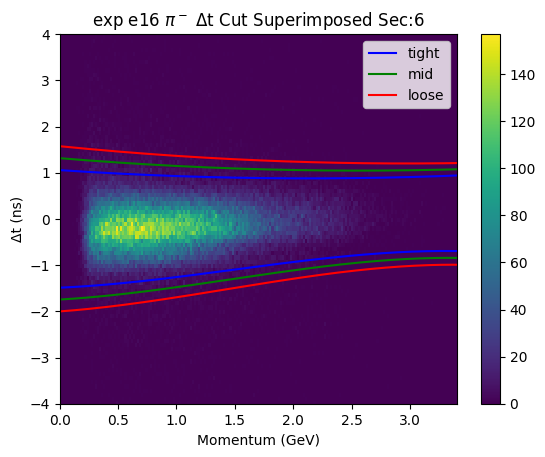

In [31]:
for sec in range(6):
    #plt.hist2d(dumb_x[sec], dumb_y[sec], bins=(len(xbins), len(ybins)), weights=dense2[sec])
    plt.pcolor(x,y,z_yx[sec])
    for cut in range(3):
        #plt.scatter(Remove_Zeros_X(x,bounds1[sec][0][cut]),Remove_Zeros(bounds1[sec][0][cut]),color=data_cols[cut])
        #plt.scatter(Remove_Zeros_X(x,bounds1[sec][1][cut]),Remove_Zeros(bounds1[sec][1][cut]),color=data_cols[cut])
        cont_x_low2 = np.linspace(0.0,5.0,200)
        cont_x_top2 = np.linspace(0.0,5.0,200)
        plt.plot(cont_x_low2,Poly3(cont_x_low2,*low_par_fit[sec][cut]),color=cut_cols[cut],label=cut_name[cut])
        plt.plot(cont_x_top2,Poly3(cont_x_top2,*top_par_fit[sec][cut]),color=cut_cols[cut])
        #cont_x_low = np.linspace(Remove_Zeros_X(sf_x,sf_bounds1[sec][0][cut])[0],Remove_Zeros_X(sf_x,sf_bounds1[sec][0][cut])[len(Remove_Zeros_X(sf_x,sf_bounds1[sec][0][cut]))-1],200)
        #cont_x_top = np.linspace(Remove_Zeros_X(sf_x,sf_bounds1[sec][1][cut])[0],Remove_Zeros_X(sf_x,sf_bounds1[sec][1][cut])[len(Remove_Zeros_X(sf_x,sf_bounds1[sec][1][cut]))-1],200)
        #plt.plot(cont_x_low,Poly3(cont_x_low,*low_par_fit[sec][cut]),color='y')
        #plt.plot(cont_x_top,Poly3(cont_x_top,*top_par_fit[sec][cut]),color='y')
    plt.title("{} {} {} \u0394t Cut Superimposed Sec:{}".format(sim,run,Particle[3],sec+1))
    plt.xlabel("Momentum (GeV)")
    plt.ylabel("\u0394t (ns)")
    plt.ylim([-4,4])
    plt.xlim([0.0,3.4])
    plt.legend()
    plt.colorbar()
    plt.show()
    
    

In [25]:
print(cut_perf+" "+species+" Cut Parameters for ",num_sigma1," sigma cut using 3rd order Polynomial")
print("Lower Bound in order of increasing exponent")
for sec in range(6):
    for cut in range(3):
        for par in range(4):
            if par==0:
                if cut==0:
                    if sec==0:
                        #print("{\t{\t{",low_par_fit[sec][cut][par],end=",")
                        print("{\t{\t{",low_par_fit[4][cut][par],end=",")
                    else:
                        #print("\t{\t{",low_par_fit[sec][cut][par],end=",")
                        print("\t{\t{",low_par_fit[4][cut][par],end=",")
                else:
                    #print("\t\t{",low_par_fit[sec][cut][par],end=",")
                    print("\t\t{",low_par_fit[4][cut][par],end=",")
            else:
                if par==3:
                    if cut == 2:
                        if sec == 5:
                            #print(low_par_fit[sec][cut][par],"}}}")
                            print(low_par_fit[4][cut][par],"}}}")
                        else:
                            print(low_par_fit[4][cut][par],"}},")
                            #print(low_par_fit[sec][cut][par],"}},")
                    else:
                        #print(low_par_fit[sec][cut][par],"},")
                        print(low_par_fit[4][cut][par],"},")
                else:
                    #print(low_par_fit[sec][cut][par],end=",")
                    print(low_par_fit[4][cut][par],end=",")
print("Upper Bound in order of increasing exponent")
for sec in range(6):
    for cut in range(3):
        for par in range(4):
            if par==0:
                if cut==0:
                    if sec==0:
                        #print("{\t{\t{",top_par_fit[sec][cut][par],end=",")
                        print("{\t{\t{",top_par_fit[4][cut][par],end=",")
                    else:
                        #print("\t{\t{",top_par_fit[sec][cut][par],end=",")
                        print("\t{\t{",top_par_fit[4][cut][par],end=",")
                else:
                    #print("\t\t{",top_par_fit[sec][cut][par],end=",")
                    print("\t\t{",top_par_fit[4][cut][par],end=",")
            else:
                if par==3:
                    if cut == 2:
                        if sec == 5:
                            #print(top_par_fit[sec][cut][par],"}}}")
                            print(top_par_fit[4][cut][par],"}}}")
                        else:
                            #print(top_par_fit[sec][cut][par],"}},")
                            print(top_par_fit[4][cut][par],"}},")
                    else:
                        #print(top_par_fit[sec][cut][par],"},")
                        print(top_par_fit[4][cut][par],"},")
                else:
                    #print(top_par_fit[sec][cut][par],end=",")
                    print(top_par_fit[4][cut][par],end=",")
#print(low_par_fit)
#print(top_par_fit)

delta pim Cut Parameters for  [2.5, 3, 3.5]  sigma cut using 3rd order Polynomial
Lower Bound in order of increasing exponent
{	{	{ -1.651517306343511,-0.056877254157555554,0.16399327650715734,3.1705897502642906e-26 },
		{ -1.9618749963805246,-0.08157829514888607,0.18591095242895864,2.4439794367960793e-24 },
		{ -2.2722320084654344,-0.10628271711160354,0.20783198037120032,1.6847544580624105e-25 }},
	{	{ -1.651517306343511,-0.056877254157555554,0.16399327650715734,3.1705897502642906e-26 },
		{ -1.9618749963805246,-0.08157829514888607,0.18591095242895864,2.4439794367960793e-24 },
		{ -2.2722320084654344,-0.10628271711160354,0.20783198037120032,1.6847544580624105e-25 }},
	{	{ -1.651517306343511,-0.056877254157555554,0.16399327650715734,3.1705897502642906e-26 },
		{ -1.9618749963805246,-0.08157829514888607,0.18591095242895864,2.4439794367960793e-24 },
		{ -2.2722320084654344,-0.10628271711160354,0.20783198037120032,1.6847544580624105e-25 }},
	{	{ -1.651517306343511,-0.056877254157555554,0.